In [1]:
#ipynb config
import sys
sys.path.append('..')
%load_ext autoreload
%autoreload 2

In [2]:
from sklearn.model_selection import train_test_split
from models.digit_trigger import DigitTrigger
from utils.visualizer import Visualizer
from IPython.display import SVG, display
from sklearn.metrics import precision_recall_curve

import numpy as np
import matplotlib.pyplot as plt

import os
import time
import pydot
import pickle
import sklearn
import lasagne
import itertools

plt.style.use('ggplot')

%matplotlib inline

WARNING (theano.gof.compilelock): Overriding existing lock by dead process '3395' (I am process '4174')
ERROR (theano.sandbox.cuda): Failed to compile cuda_ndarray.cu: libcublas.so.7.5: cannot open shared object file: No such file or directory
WARNING (theano.sandbox.cuda): CUDA is installed, but device gpu0 is not available  (error: cuda unavailable)


In [3]:
def iterate_minibatches(inputs, targets, batch_size):
    indices = np.arange(len(inputs))
    np.random.shuffle(indices)
    
    for start_idx in range(0, len(inputs) - batch_size + 1, batch_size):
        excerpt = indices[start_idx:start_idx + batch_size]

        yield inputs[excerpt], targets[excerpt]


def learn(nn,
          dataset,
          watches=['obj',
                   'recall',
                   'precision',
                   'accuracy',
                   'loss',
                   'sub_loss'],
          num_epochs=100,
          batch_size=50):
    '''
        num_epochs - amount of passes through the data
        batch_size - number of samples processed at each function call
        dataset - [X_train, X_val, y_train, y_val]
    '''
    %matplotlib notebook
    
    X_train, X_val, y_train, y_val = dataset
    metrics_template = dict()
    
    metrics_sample = nn.evaluate(X_val[:2], y_val[:2])
    
    for metric_name, _ in metrics_sample.items():
        if metric_name == 'complexity_parts':
            metrics_template[metric_name] = [0] * len(metrics_sample[metric_name])
        else:
            metrics_template[metric_name] = 0
        
    visualizer = Visualizer(num_epochs,
                            metrics_template,
                            watches=watches)
    
    for epoch in range(num_epochs):
        # In each epoch, we do a full pass over the training data:
        start_time = time.time()
        
        train_measurements = dict(metrics_template)
        train_batches = 0

        for batch in iterate_minibatches(X_train, y_train, batch_size):
            inputs, targets = batch
            
            for metric_name, metric in nn.train(inputs, targets).items():
                if metric_name == 'complexity_parts':
                    for j in range(len(metrics_template[metric_name])):
                        train_measurements[metric_name][j] += metric[j]
                else: 
                    train_measurements[metric_name] += metric

            train_batches += 1
            
        for metric_name, metric in train_measurements.items():
            if metric_name == 'complexity_parts':
                for j in range(len(metrics_template[metric_name])):
                    train_measurements[metric_name][j] = metric[j] / train_batches
            else: 
                train_measurements[metric_name] = metric / train_batches

        # And a full pass over the validation data:
        val_measurements = dict(metrics_template)
        val_batches = 0

        for batch in iterate_minibatches(X_val, y_val, batch_size):
            inputs, targets = batch
            
            for metric_name, metric in nn.evaluate(inputs, targets).items():
                if metric_name == 'complexity_parts':
                    for j in range(len(metrics_template[metric_name])):
                        val_measurements[metric_name][j] += metric[j]
                else: 
                    val_measurements[metric_name] += metric

            val_batches += 1
            
        for metric_name, metric in val_measurements.items():
            if metric_name == 'complexity_parts':
                for j in range(len(metrics_template[metric_name])):
                    val_measurements[metric_name][j] = metric[j] / val_batches
            else: 
                val_measurements[metric_name] = metric / val_batches

        print('Epoch {} of {} took {:.3f}s'.format(epoch + 1, num_epochs, time.time() - start_time))
        visualizer.watch(train_measurements, val_measurements)
    visualizer.finish()

In [4]:
import cPickle

with open('../data/small_ds') as f:
    X_y_digits = cPickle.load(f)
    
with np.load('../weights/digits_params/shareds.npz') as f:
    shareds = [f['arr_%d' % i] for i in range(len(f.files))]

In [5]:
network = DigitTrigger(img_shape=(64, 128),
                       learning_rate=1e-3,
                       c=1e-1,
                       c_complexity=1e-3,
                       c_sub_objs=[1e-4, 1e-3, 1e-2],
                       c_sub_obj_cs=[1e-4, 1e-3, 1e-2],
                       mul=True,
                       pool_sizes=[2, 2, 2],
                       num_filters=[8, 16, 32],
                       filter_sizes=[3, 3, 3],
                       l2_c=1e-4)

/home/apanin/anaconda/lib/python2.7/site-packages/lasagne/layers/pool.py:266: UserWarning: DEPRECATION: the 'ds' parameter is not going to exist anymore as it is going to be replaced by the parameter 'ws'.
  mode=self.mode,
/home/apanin/anaconda/lib/python2.7/site-packages/lasagne/layers/pool.py:266: UserWarning: DEPRECATION: the 'st' parameter is not going to exist anymore as it is going to be replaced by the parameter 'stride'.
  mode=self.mode,
/home/apanin/anaconda/lib/python2.7/site-packages/lasagne/layers/pool.py:266: UserWarning: DEPRECATION: the 'padding' parameter is not going to exist anymore as it is going to be replaced by the parameter 'pad'.
  mode=self.mode,
WARNING (theano.configdefaults): install mkl with `conda install mkl-service`: No module named mkl


In [6]:
import theano
get_target = theano.function([network.targets], lasagne.layers.get_output(network.target_pool_layers[-1]))

In [7]:
def iterate_minibatches(inputs, targets, batchsize):
    assert len(inputs) == len(targets)

    for start_idx in range(0, len(inputs) - batchsize + 1, batchsize):
        excerpt = slice(start_idx, start_idx + batchsize)
        yield inputs[excerpt], targets[excerpt]
    
    
def objective(x, predictor, thr, l, train=False):
    if train:
        make_new_point(x)
        
    precision, complexity = predictor(x)
        
    return complexity


def build_predictor(network, dataset):
    def f(x):
        predictions = []
        target = []

        for x, y in iterate_minibatches(dataset[1], dataset[-1], 1000):
            predictions.append(network.predict(x))
            target.append(get_target(y))

        predictions = np.vstack(predictions)
        target = np.vstack(target)

        precision, recall, thr = precision_recall_curve(target.ravel().astype(np.int64),
                                                        predictions.ravel())

        precision_095 =  precision[np.max(np.where(recall >= 0.95))]

        return precision_095, network.evaluate(dataset[1], dataset[-1])['total_complexity']
    
    return f


def make_new_point(x, dataset, num_epochs=20, use_pretrained=True):
    if os.path.exists(os.path.join('../weights/digits', ','.join([str(i) for i in x]) + '.npz')):
        network.load('../weights/digits', ','.join([str(i) for i in x]))
        print('known point')
    else:
        if use_pretrained:
            network.load('../weights', 'digits_pretrained')

            for j in range(len(shareds)):
                network.opt_shareds[j].set_value(shareds[j])

        network.c_sub_objs.set_value(x[3:])
        network.c_sub_obj_cs.set_value(x[:3])

        learn(network,
              dataset,
              watches=['obj',
                       'recall',
                       'precision',
                       'accuracy',
                       'loss',
                       'sub_loss',
                       'total_complexity',
                       'complexity_parts'],
              num_epochs=num_epochs,
              batch_size=50)

        network.save('../weights/digits', ','.join([str(i) for i in x]))

0.43392023947
0.0940269037548
0.0940205178005
0.0940127351285
0.0940127306518


/home/apanin/anaconda/lib/python2.7/site-packages/IPython/kernel/__init__.py:13: ShimWarning: The `IPython.kernel` package has been deprecated. You should import from ipykernel or jupyter_client instead.
  "You should import from ipykernel or jupyter_client instead.", ShimWarning)


<IPython.core.display.Javascript object>


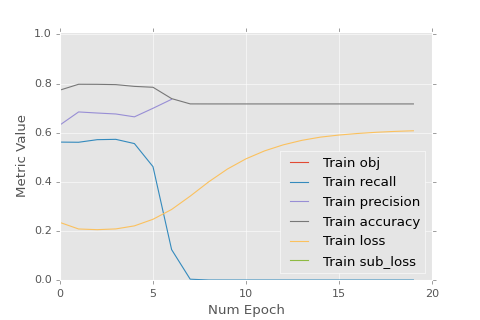

<IPython.core.display.Javascript object>


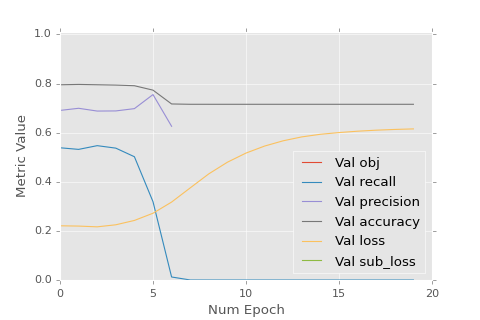

<IPython.core.display.Javascript object>


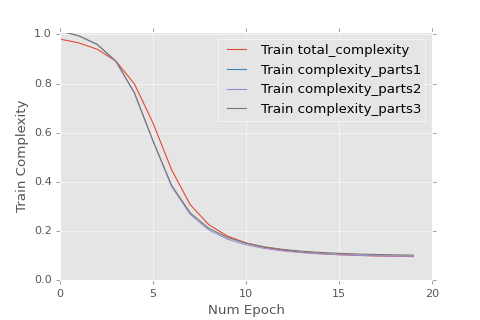

<IPython.core.display.Javascript object>


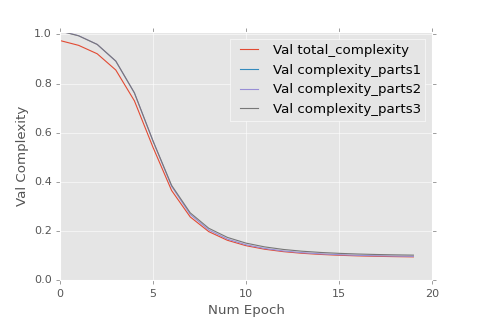

Epoch 1 of 20 took 8.658s


/home/apanin/anaconda/lib/python2.7/site-packages/matplotlib/backends/backend_webagg_core.py:210: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  buff.shape = (renderer.height, renderer.width)


Epoch 2 of 20 took 8.850s
Epoch 3 of 20 took 8.307s
Epoch 4 of 20 took 8.692s
Epoch 5 of 20 took 8.552s
Epoch 6 of 20 took 8.657s
Epoch 7 of 20 took 8.784s
Epoch 8 of 20 took 8.523s
Epoch 9 of 20 took 8.752s
Epoch 10 of 20 took 8.591s
Epoch 11 of 20 took 8.483s
Epoch 12 of 20 took 8.820s
Epoch 13 of 20 took 8.533s
Epoch 14 of 20 took 8.556s
Epoch 15 of 20 took 8.530s
Epoch 16 of 20 took 8.495s
Epoch 17 of 20 took 8.783s
Epoch 18 of 20 took 8.448s
Epoch 19 of 20 took 8.811s
Epoch 20 of 20 took 8.496s


<IPython.core.display.Javascript object>


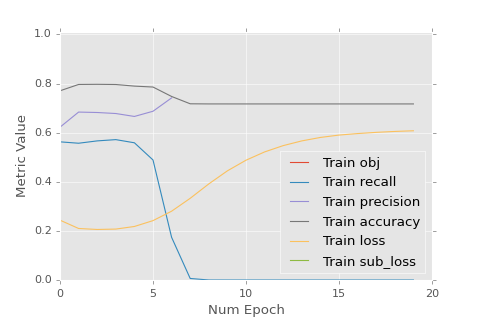

<IPython.core.display.Javascript object>


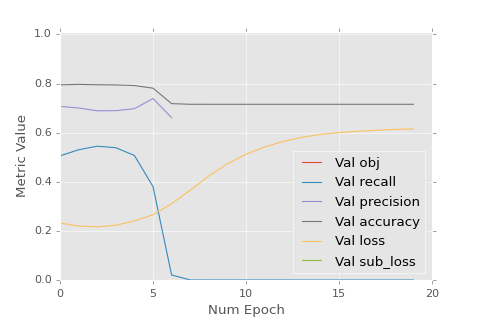

<IPython.core.display.Javascript object>


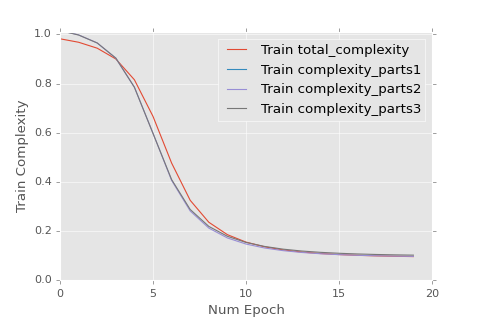

<IPython.core.display.Javascript object>


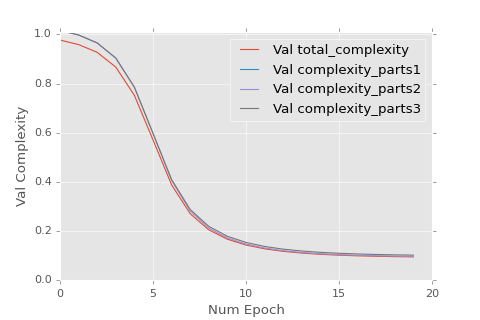

Epoch 1 of 20 took 8.610s
Epoch 2 of 20 took 8.777s
Epoch 3 of 20 took 8.293s
Epoch 4 of 20 took 8.736s
Epoch 5 of 20 took 8.466s
Epoch 6 of 20 took 8.731s
Epoch 7 of 20 took 8.340s
Epoch 8 of 20 took 8.780s
Epoch 9 of 20 took 8.986s
Epoch 10 of 20 took 8.632s
Epoch 11 of 20 took 8.811s
Epoch 12 of 20 took 8.787s
Epoch 13 of 20 took 8.641s
Epoch 14 of 20 took 8.859s
Epoch 15 of 20 took 8.791s
Epoch 16 of 20 took 8.865s
Epoch 17 of 20 took 8.675s
Epoch 18 of 20 took 8.771s
Epoch 19 of 20 took 8.692s
Epoch 20 of 20 took 8.751s


<IPython.core.display.Javascript object>


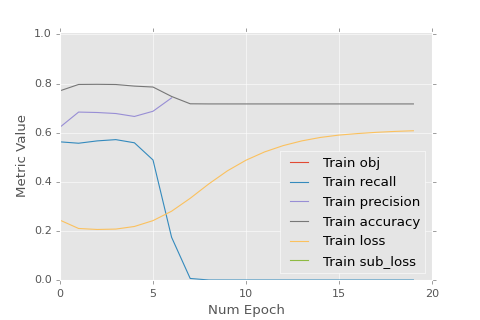

<IPython.core.display.Javascript object>


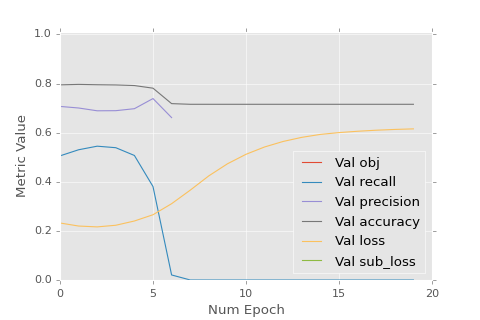

<IPython.core.display.Javascript object>


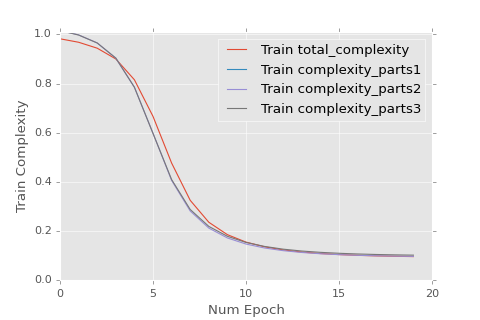

<IPython.core.display.Javascript object>


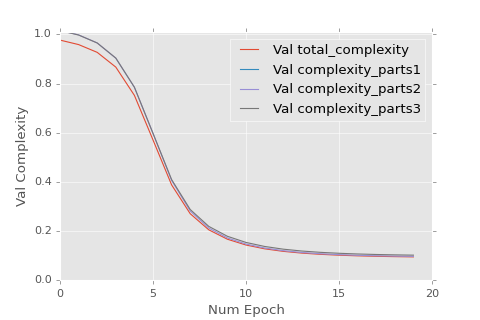

Epoch 1 of 20 took 8.764s
Epoch 2 of 20 took 8.412s
Epoch 3 of 20 took 8.805s
Epoch 4 of 20 took 8.429s
Epoch 5 of 20 took 8.606s
Epoch 6 of 20 took 8.685s
Epoch 7 of 20 took 8.608s
Epoch 8 of 20 took 8.823s
Epoch 9 of 20 took 8.621s
Epoch 10 of 20 took 8.546s
Epoch 11 of 20 took 8.766s
Epoch 12 of 20 took 8.403s
Epoch 13 of 20 took 8.766s
Epoch 14 of 20 took 8.347s
Epoch 15 of 20 took 8.699s
Epoch 16 of 20 took 8.670s
Epoch 17 of 20 took 8.584s
Epoch 18 of 20 took 8.879s
Epoch 19 of 20 took 8.271s
Epoch 20 of 20 took 8.622s


<IPython.core.display.Javascript object>


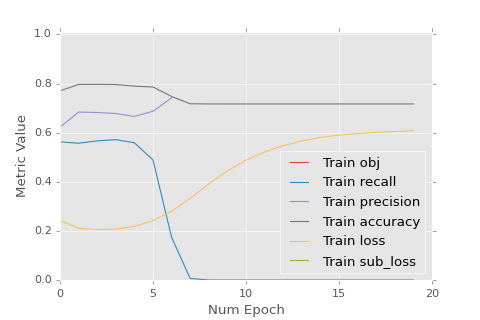

<IPython.core.display.Javascript object>


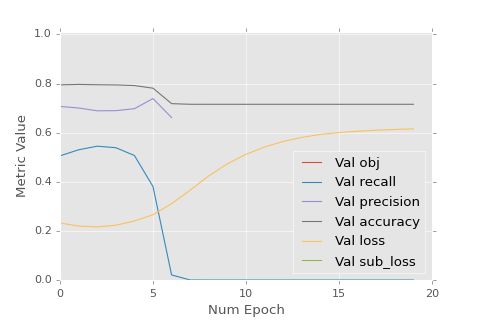

<IPython.core.display.Javascript object>


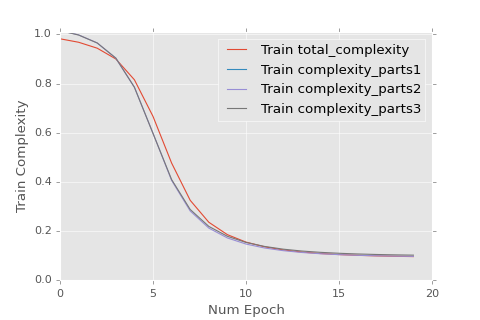

<IPython.core.display.Javascript object>


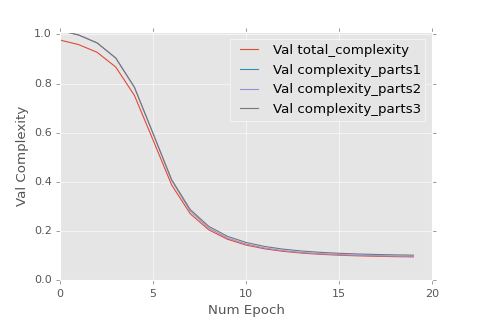

Epoch 1 of 20 took 8.333s
Epoch 2 of 20 took 8.675s
Epoch 3 of 20 took 9.049s
Epoch 4 of 20 took 8.610s
Epoch 5 of 20 took 8.618s
Epoch 6 of 20 took 8.470s
Epoch 7 of 20 took 8.489s
Epoch 8 of 20 took 8.690s
Epoch 9 of 20 took 8.397s
Epoch 10 of 20 took 8.613s
Epoch 11 of 20 took 8.498s
Epoch 12 of 20 took 8.643s
Epoch 13 of 20 took 8.339s
Epoch 14 of 20 took 8.527s
Epoch 15 of 20 took 8.745s
Epoch 16 of 20 took 8.371s
Epoch 17 of 20 took 8.681s
Epoch 18 of 20 took 8.731s
Epoch 19 of 20 took 8.629s
Epoch 20 of 20 took 8.722s


<IPython.core.display.Javascript object>


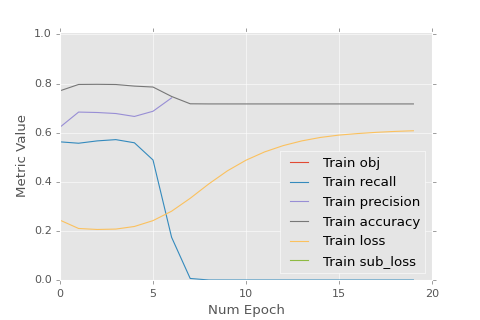

<IPython.core.display.Javascript object>


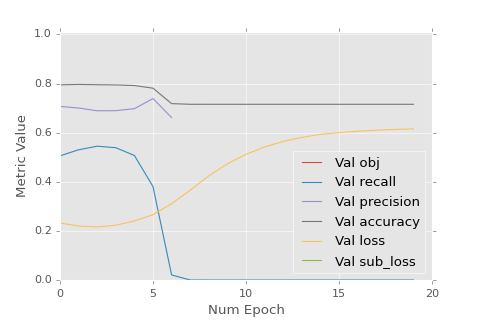

<IPython.core.display.Javascript object>


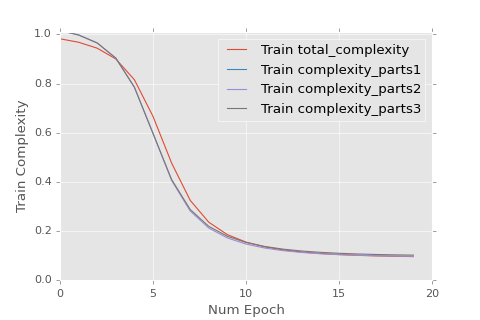

<IPython.core.display.Javascript object>


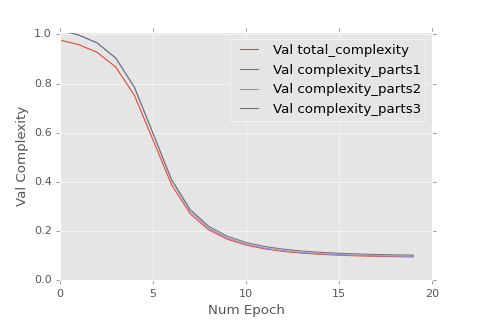

Epoch 1 of 20 took 8.319s
Epoch 2 of 20 took 8.818s
Epoch 3 of 20 took 8.345s
Epoch 4 of 20 took 8.408s
Epoch 5 of 20 took 8.591s
Epoch 6 of 20 took 8.587s
Epoch 7 of 20 took 8.986s
Epoch 8 of 20 took 8.667s
Epoch 9 of 20 took 8.858s
Epoch 10 of 20 took 8.945s
Epoch 11 of 20 took 8.648s
Epoch 12 of 20 took 9.006s
Epoch 13 of 20 took 8.216s
Epoch 14 of 20 took 8.428s
Epoch 15 of 20 took 8.470s
Epoch 16 of 20 took 8.533s
Epoch 17 of 20 took 8.575s
Epoch 18 of 20 took 8.157s
Epoch 19 of 20 took 8.406s
Epoch 20 of 20 took 8.715s


<IPython.core.display.Javascript object>


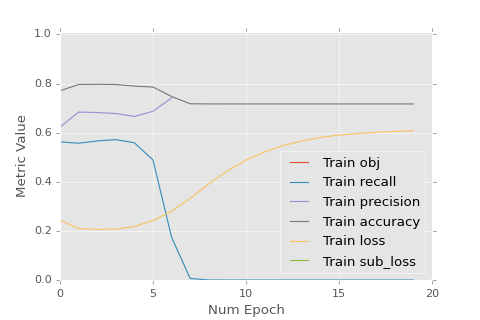

<IPython.core.display.Javascript object>


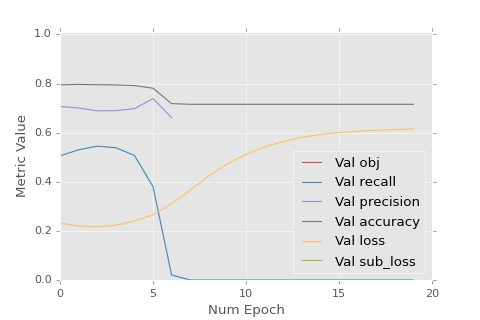

<IPython.core.display.Javascript object>


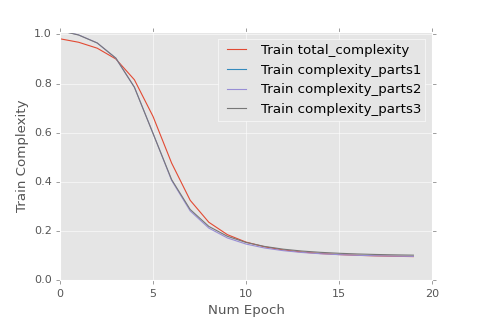

<IPython.core.display.Javascript object>


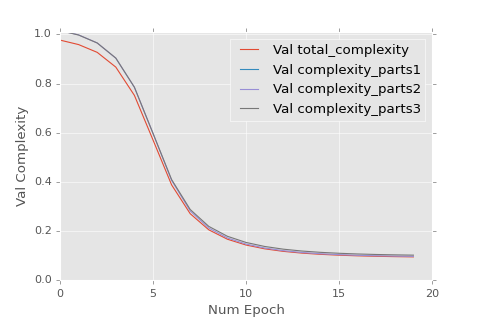

Epoch 1 of 20 took 8.356s
Epoch 2 of 20 took 8.679s
Epoch 3 of 20 took 8.310s
Epoch 4 of 20 took 8.549s
Epoch 5 of 20 took 8.533s
Epoch 6 of 20 took 8.851s
Epoch 7 of 20 took 8.877s
Epoch 8 of 20 took 8.311s
Epoch 9 of 20 took 8.742s
Epoch 10 of 20 took 8.425s
Epoch 11 of 20 took 8.658s
Epoch 12 of 20 took 8.792s
Epoch 13 of 20 took 8.627s
Epoch 14 of 20 took 8.702s
Epoch 15 of 20 took 8.408s
Epoch 16 of 20 took 8.431s
Epoch 17 of 20 took 8.721s
Epoch 18 of 20 took 8.686s
Epoch 19 of 20 took 9.065s
Epoch 20 of 20 took 8.352s


<IPython.core.display.Javascript object>


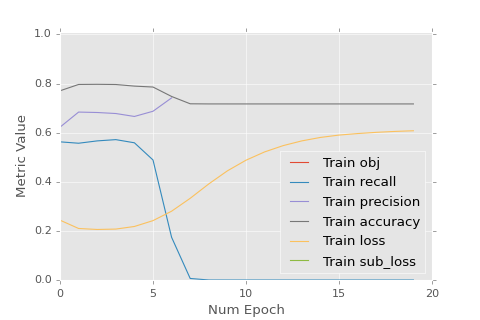

<IPython.core.display.Javascript object>


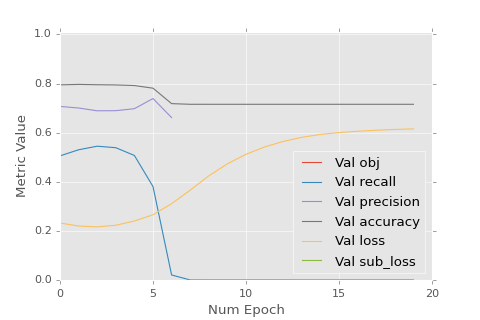

<IPython.core.display.Javascript object>


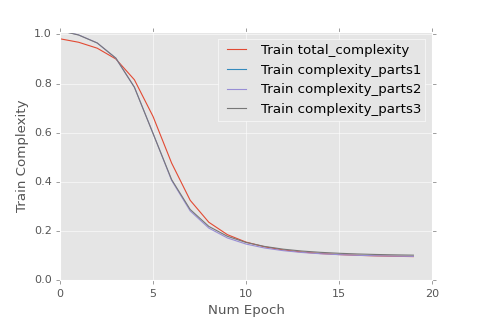

<IPython.core.display.Javascript object>


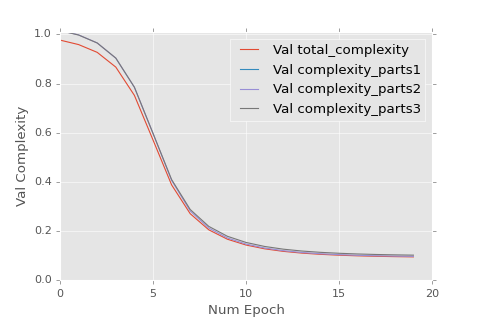

Epoch 1 of 20 took 8.733s
Epoch 2 of 20 took 8.783s
Epoch 3 of 20 took 8.683s
Epoch 4 of 20 took 8.866s
Epoch 5 of 20 took 8.691s
Epoch 6 of 20 took 8.672s
Epoch 7 of 20 took 8.393s
Epoch 8 of 20 took 8.643s
Epoch 9 of 20 took 8.598s
Epoch 10 of 20 took 8.508s
Epoch 11 of 20 took 8.882s
Epoch 12 of 20 took 8.604s
Epoch 13 of 20 took 8.653s
Epoch 14 of 20 took 8.673s
Epoch 15 of 20 took 8.453s
Epoch 16 of 20 took 8.920s
Epoch 17 of 20 took 8.537s
Epoch 18 of 20 took 8.791s
Epoch 19 of 20 took 8.509s
Epoch 20 of 20 took 8.399s


<IPython.core.display.Javascript object>


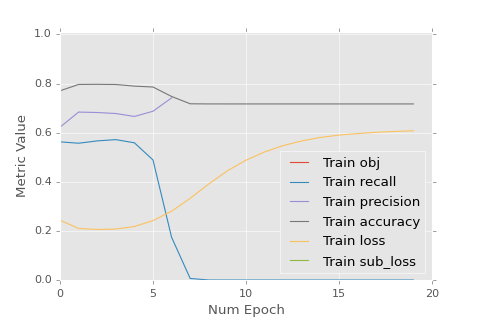

<IPython.core.display.Javascript object>


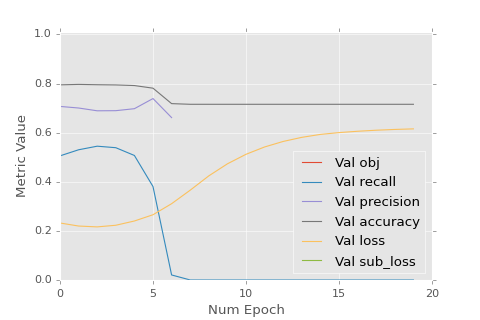

<IPython.core.display.Javascript object>


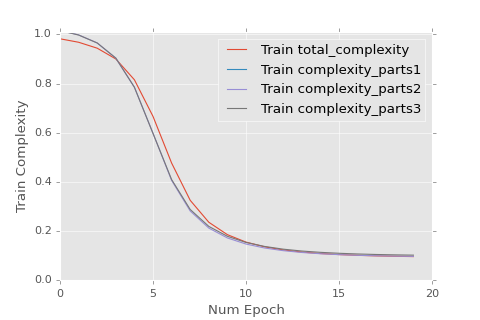

<IPython.core.display.Javascript object>


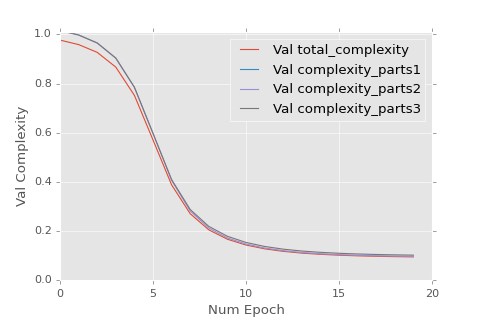

Epoch 1 of 20 took 8.602s
Epoch 2 of 20 took 8.458s
Epoch 3 of 20 took 8.553s
Epoch 4 of 20 took 8.368s
Epoch 5 of 20 took 8.360s
Epoch 6 of 20 took 9.020s
Epoch 7 of 20 took 8.369s
Epoch 8 of 20 took 8.786s
Epoch 9 of 20 took 8.538s
Epoch 10 of 20 took 8.939s
Epoch 11 of 20 took 8.338s
Epoch 12 of 20 took 8.533s
Epoch 13 of 20 took 8.589s
Epoch 14 of 20 took 8.478s
Epoch 15 of 20 took 8.556s
Epoch 16 of 20 took 8.391s
Epoch 17 of 20 took 8.396s
Epoch 18 of 20 took 8.792s
Epoch 19 of 20 took 8.224s
Epoch 20 of 20 took 8.997s


<IPython.core.display.Javascript object>


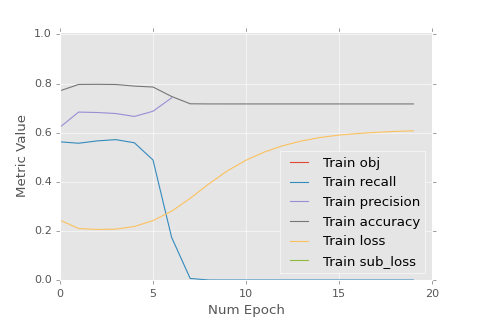

<IPython.core.display.Javascript object>


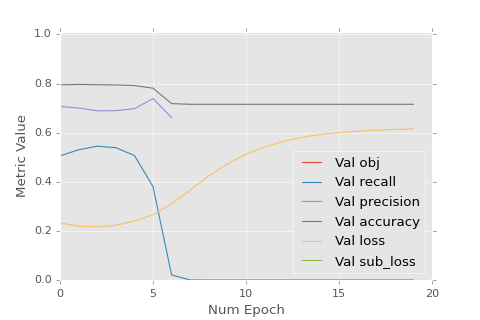

<IPython.core.display.Javascript object>


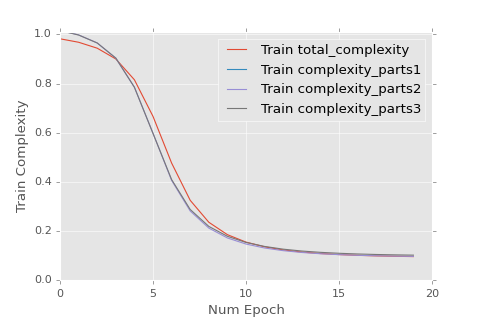

<IPython.core.display.Javascript object>


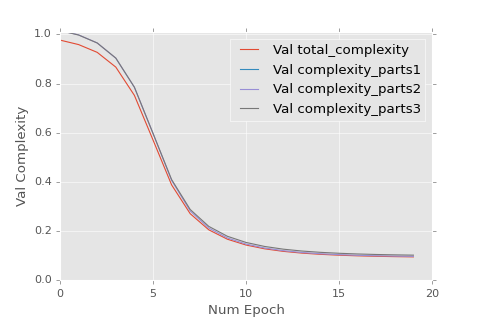

Epoch 1 of 20 took 8.414s
Epoch 2 of 20 took 8.661s
Epoch 3 of 20 took 8.908s
Epoch 4 of 20 took 8.617s
Epoch 5 of 20 took 8.900s
Epoch 6 of 20 took 8.435s
Epoch 7 of 20 took 8.772s
Epoch 8 of 20 took 8.546s
Epoch 9 of 20 took 8.531s
Epoch 10 of 20 took 8.853s
Epoch 11 of 20 took 8.432s
Epoch 12 of 20 took 8.949s
Epoch 13 of 20 took 8.462s
Epoch 14 of 20 took 8.713s
Epoch 15 of 20 took 8.828s
Epoch 16 of 20 took 8.501s
Epoch 17 of 20 took 8.901s
Epoch 18 of 20 took 8.351s
Epoch 19 of 20 took 8.733s
Epoch 20 of 20 took 8.493s


<IPython.core.display.Javascript object>


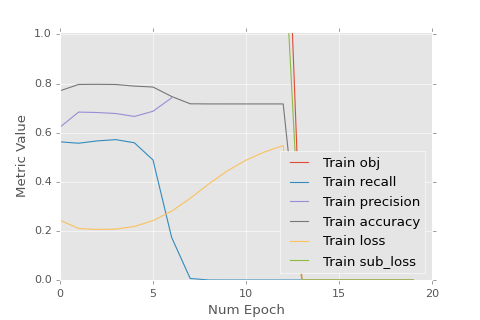

<IPython.core.display.Javascript object>


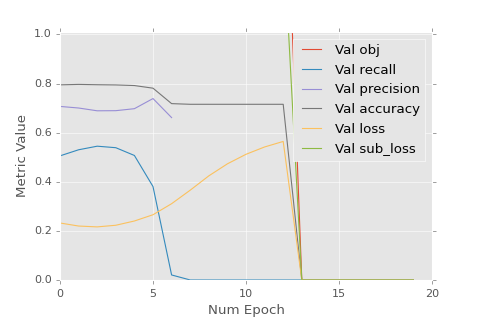

<IPython.core.display.Javascript object>


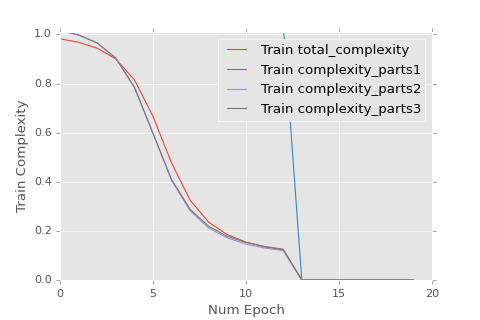

<IPython.core.display.Javascript object>


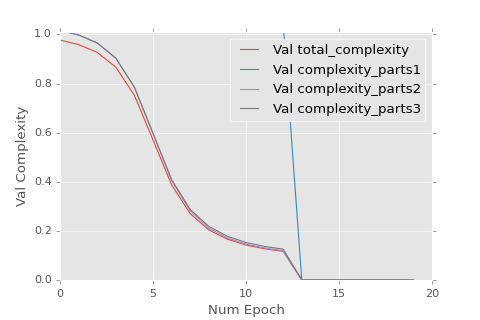

Epoch 1 of 20 took 8.538s
Epoch 2 of 20 took 8.791s
Epoch 3 of 20 took 8.268s
Epoch 4 of 20 took 8.604s
Epoch 5 of 20 took 8.277s
Epoch 6 of 20 took 8.688s
Epoch 7 of 20 took 8.939s
Epoch 8 of 20 took 8.379s
Epoch 9 of 20 took 8.765s
Epoch 10 of 20 took 8.796s
Epoch 11 of 20 took 8.623s
Epoch 12 of 20 took 8.728s
Epoch 13 of 20 took 8.313s


KeyboardInterrupt: 

In [11]:
import scipy as sp

loss = []
thr = 0.3
l = 100
i = 0

while True:
    i += 1
    dataset = []
    targets = []
    min_obj = np.inf
    
    for f in os.listdir('../weights/digits'):
        network.load('../weights/digits', f[:-4])
        point = np.array(list(network.c_sub_obj_cs.get_value()) + list(network.c_sub_objs.get_value()))
        
        predictor = build_predictor(network)
        
        if objective(point, predictor, thr, l) < min_obj:
            min_obj = objective(point, predictor, thr, l)
            print min_obj
            min_point = point
        

    opt = sp.optimize.minimize(objective, min_point, (predictor, thr, l, True), method='powell')
    loss.append(opt['fun'])
    print(opt['x'], opt['fun'])
    make_new_point(opt['x'])
    print(i)

In [2]:
%matplotlib inline

plt.plot(loss)

plt.show()

NameError: name 'plt' is not defined

In [24]:
min_point

array([ 1.90013462,  0.80721925,  3.25083197,  5.45676926, -4.1077016 ,
        0.21195174])

<IPython.core.display.Javascript object>


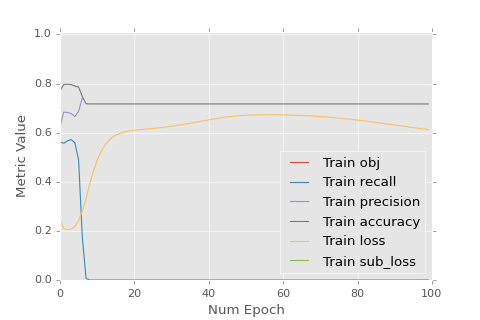

<IPython.core.display.Javascript object>


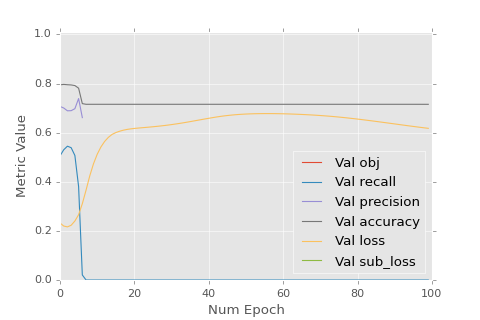

<IPython.core.display.Javascript object>


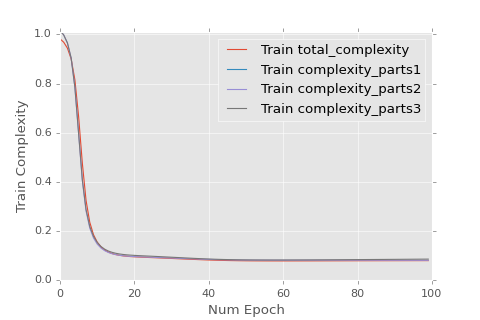

<IPython.core.display.Javascript object>


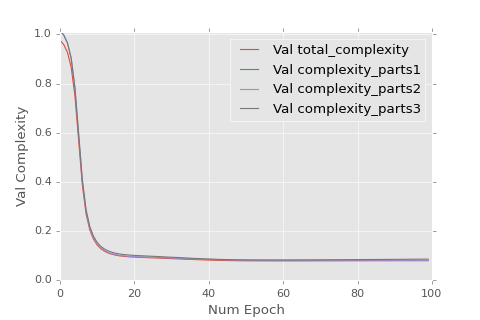

Epoch 1 of 100 took 8.597s
Epoch 2 of 100 took 8.688s
Epoch 3 of 100 took 8.546s
Epoch 4 of 100 took 8.518s
Epoch 5 of 100 took 8.799s
Epoch 6 of 100 took 8.561s
Epoch 7 of 100 took 9.043s
Epoch 8 of 100 took 8.541s
Epoch 9 of 100 took 8.612s
Epoch 10 of 100 took 8.641s
Epoch 11 of 100 took 8.574s
Epoch 12 of 100 took 8.940s
Epoch 13 of 100 took 8.488s
Epoch 14 of 100 took 8.888s
Epoch 15 of 100 took 8.442s
Epoch 16 of 100 took 8.722s
Epoch 17 of 100 took 8.754s
Epoch 18 of 100 took 8.491s
Epoch 19 of 100 took 8.607s
Epoch 20 of 100 took 8.697s
Epoch 21 of 100 took 8.622s
Epoch 22 of 100 took 9.015s
Epoch 23 of 100 took 8.422s
Epoch 24 of 100 took 8.765s
Epoch 25 of 100 took 8.611s
Epoch 26 of 100 took 8.449s
Epoch 27 of 100 took 8.960s
Epoch 28 of 100 took 8.363s
Epoch 29 of 100 took 8.831s
Epoch 30 of 100 took 8.453s
Epoch 31 of 100 took 8.632s
Epoch 32 of 100 took 8.663s
Epoch 33 of 100 took 8.580s
Epoch 34 of 100 took 8.629s
Epoch 35 of 100 took 8.732s
Epoch 36 of 100 took 8.469s
E

In [28]:
make_new_point(min_point, 100)

In [17]:
%matplotlib notebook

# Network to model $R^6$ -> $R^2$

In [8]:
import lasagne
import theano.tensor as T
from lasagne.layers import InputLayer, DenseLayer
from lasagne.nonlinearities import linear, sigmoid, elu

In [9]:
input_X = T.matrix('input')

c_pr_estimator = InputLayer((None, 6), input_X)
c_pr_estimator = DenseLayer(c_pr_estimator, 100, nonlinearity=sigmoid)
c_pr_estimator = DenseLayer(c_pr_estimator, 2, nonlinearity=sigmoid)

In [ ]:
targets = T.matrix('output')

prediction = lasagne.layers.get_output(c_pr_estimator)

obj = lasagne.objectives.squared_error(prediction, targets).mean()
params = lasagne.layers.get_all_params(c_pr_estimator)
updates = lasagne.updates.adadelta(obj, params)

train = theano.function([input_X, targets], obj, updates=updates)
predict = theano.function([input_X], prediction)

In [ ]:
dataset = []
labels = []

for i, f in enumerate(os.listdir('../weights/digits')):
    network.load('../weights/digits', f[:-4])
    point = np.array(list(network.c_sub_obj_cs.get_value()) + list(network.c_sub_objs.get_value()))

    predictor = build_predictor(network, X_y_digits)
    
    dataset.append(point)
    labels.append(predictor(point))
    
    if i % 100 == 0:
        print i

0


In [ ]:
dataset = np.asarray(dataset, dtype=np.float32)
labels = np.asarray(labels, dtype=np.float32)

In [ ]:
X_y = train_test_split(dataset, labels)

In [ ]:
for i in range(1000):
    train(X_y[0], X_y[-2])

In [238]:
thr = 0.9
l = 100

opt = sp.optimize.minimize(objective, np.random.rand(6), (predictor, thr, l), method='COBYLA', constraints=constraints)
print(opt['x'])
print(opt['fun'])

[-0.29936768 -0.29936768 -0.29936768 -0.29936768 -0.29936768  1.29936768]
0.945401310921


In [232]:
constraints = []
def ineq1(x):
    return predict([np.array(x, dtype=np.float32)])[0, 0] - thr
def ineq2(x):
    return 1 - x[0]
def ineq3(x):
    return x[0]
def ineq4(x):
    return 1 - x[1]
def ineq5(x):
    return x[1]
def ineq6(x):
    return 1 - x[2]
def ineq7(x):
    return x[2]
def ineq8(x):
    return 1 - x[3]
def ineq9(x):
    return x[3]
def ineq10(x):
    return 1 - x[4]
def ineq11(x):
    return x[4]
def ineq12(x):
    return 1 - x[5]
def ineq13(x):
    return x[5]

constraints.append({'type': 'ineq', 'fun': ineq1})
constraints.append({'type': 'ineq', 'fun': ineq2})
constraints.append({'type': 'ineq', 'fun': ineq3})
constraints.append({'type': 'ineq', 'fun': ineq4})
constraints.append({'type': 'ineq', 'fun': ineq5})
constraints.append({'type': 'ineq', 'fun': ineq6})
constraints.append({'type': 'ineq', 'fun': ineq7})
constraints.append({'type': 'ineq', 'fun': ineq8})
constraints.append({'type': 'ineq', 'fun': ineq9})
constraints.append({'type': 'ineq', 'fun': ineq10})
constraints.append({'type': 'ineq', 'fun': ineq11})
constraints.append({'type': 'ineq', 'fun': ineq12})
constraints.append({'type': 'ineq', 'fun': ineq13})

# SGD on proxy

In [41]:
point = theano.shared(np.random.random((1, 6)).astype(np.float32))
prediction = lasagne.layers.get_output(c_pr_estimator)
complexity = prediction[:, 0]
precision_95 = prediction[:, 1]
thr = theano.shared(0.3)
l = 100

obj = (complexity + theano.tensor.switch(precision_95 > thr, precision_95, l * (thr - precision_95))).mean()

updates = lasagne.updates.adadelta(T.grad(obj, [input_X]), [point])
train_fun = theano.function([input_X], obj, updates = updates)

<IPython.core.display.Javascript object>


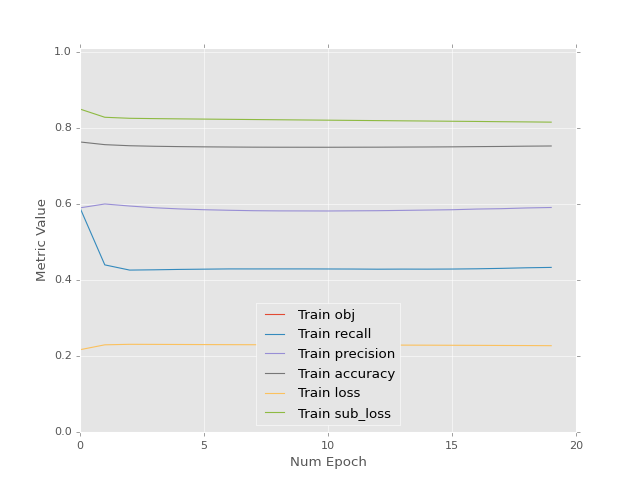

<IPython.core.display.Javascript object>


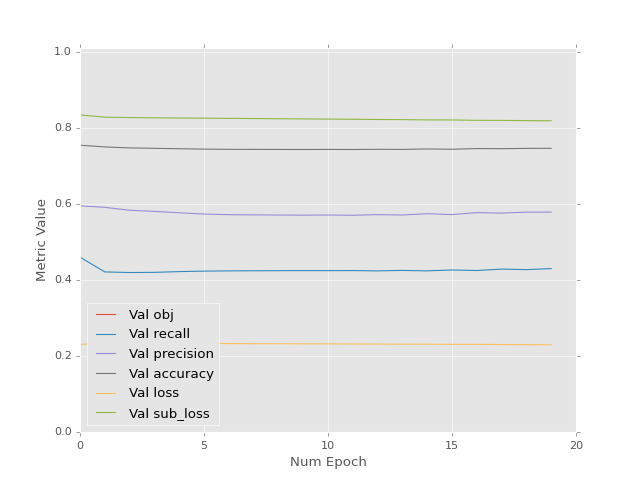

<IPython.core.display.Javascript object>


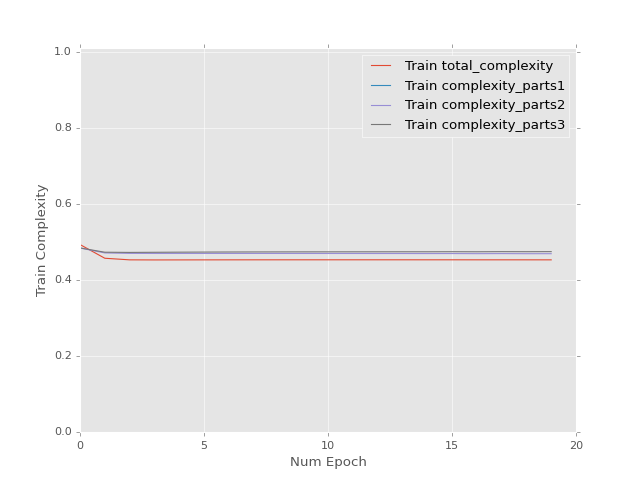

<IPython.core.display.Javascript object>


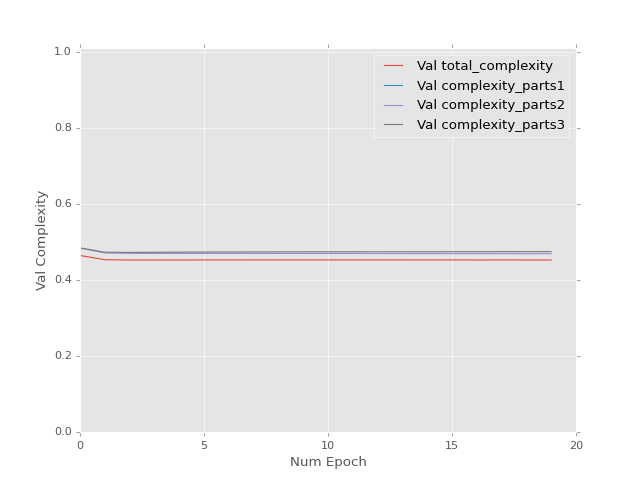

Epoch 1 of 20 took 6.060s
Epoch 2 of 20 took 5.605s
Epoch 3 of 20 took 5.782s
Epoch 4 of 20 took 5.727s
Epoch 5 of 20 took 5.894s
Epoch 6 of 20 took 5.826s
Epoch 7 of 20 took 5.876s
Epoch 8 of 20 took 5.542s
Epoch 9 of 20 took 6.013s
Epoch 10 of 20 took 5.631s
Epoch 11 of 20 took 6.073s
Epoch 12 of 20 took 5.876s
Epoch 13 of 20 took 5.770s
Epoch 14 of 20 took 5.660s
Epoch 15 of 20 took 5.901s
Epoch 16 of 20 took 5.780s
Epoch 17 of 20 took 5.906s
Epoch 18 of 20 took 5.951s
Epoch 19 of 20 took 5.646s
Epoch 20 of 20 took 5.903s
inf [[ 0.88652468  0.09069339  0.23322752  0.94098836  0.18938799  0.9368943 ]]


<IPython.core.display.Javascript object>


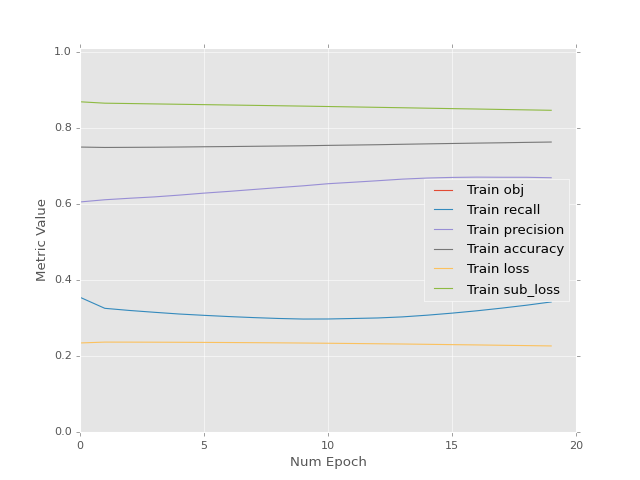

<IPython.core.display.Javascript object>


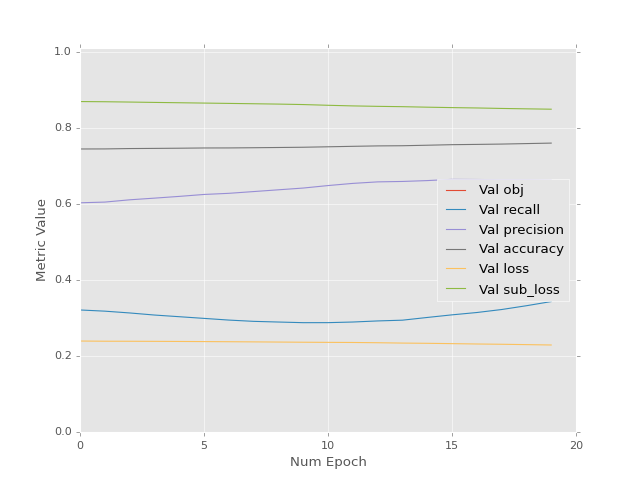

<IPython.core.display.Javascript object>


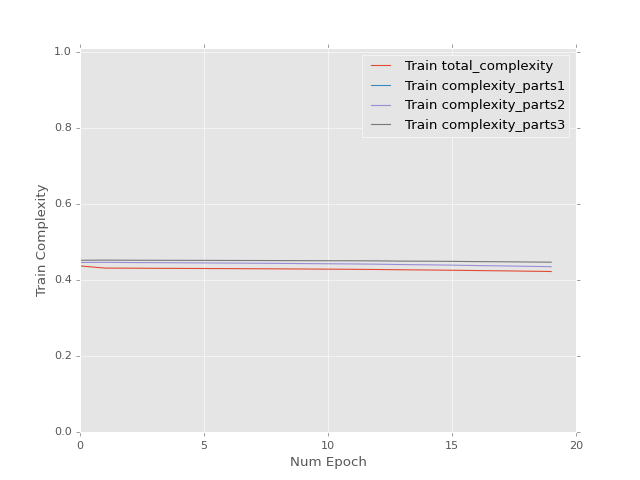

<IPython.core.display.Javascript object>


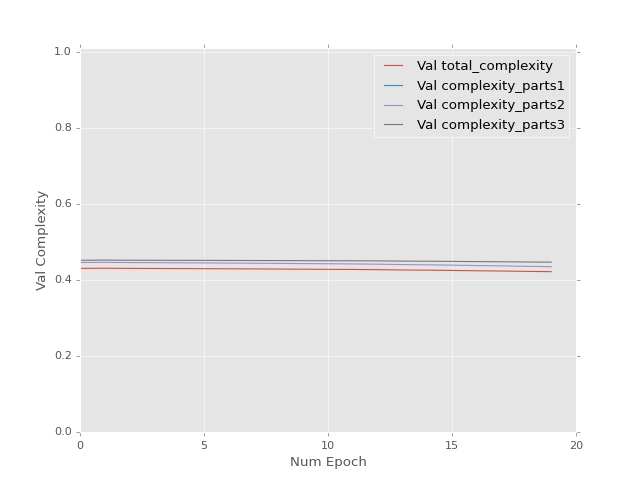

Epoch 1 of 20 took 5.538s
Epoch 2 of 20 took 5.446s
Epoch 3 of 20 took 5.551s
Epoch 4 of 20 took 5.957s
Epoch 5 of 20 took 5.931s
Epoch 6 of 20 took 5.496s
Epoch 7 of 20 took 5.873s
Epoch 8 of 20 took 5.991s
Epoch 9 of 20 took 5.672s
Epoch 10 of 20 took 5.673s
Epoch 11 of 20 took 5.808s
Epoch 12 of 20 took 5.665s
Epoch 13 of 20 took 5.784s
Epoch 14 of 20 took 5.987s
Epoch 15 of 20 took 5.951s
Epoch 16 of 20 took 5.961s
Epoch 17 of 20 took 5.722s
Epoch 18 of 20 took 5.824s
Epoch 19 of 20 took 5.819s
Epoch 20 of 20 took 6.063s
0.915313601494 [[ 0.93265581  0.13681293  0.27805269  0.98710066  0.23548427  0.89074796]]


<IPython.core.display.Javascript object>


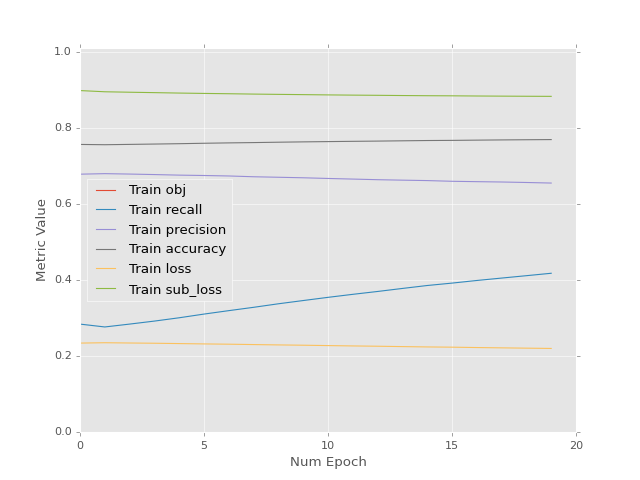

<IPython.core.display.Javascript object>


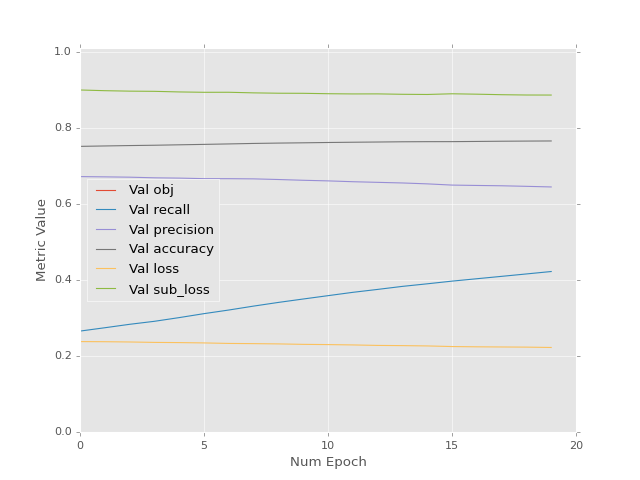

<IPython.core.display.Javascript object>


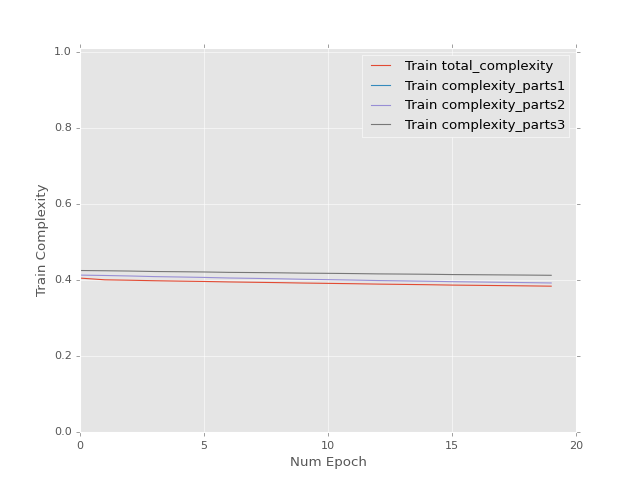

<IPython.core.display.Javascript object>


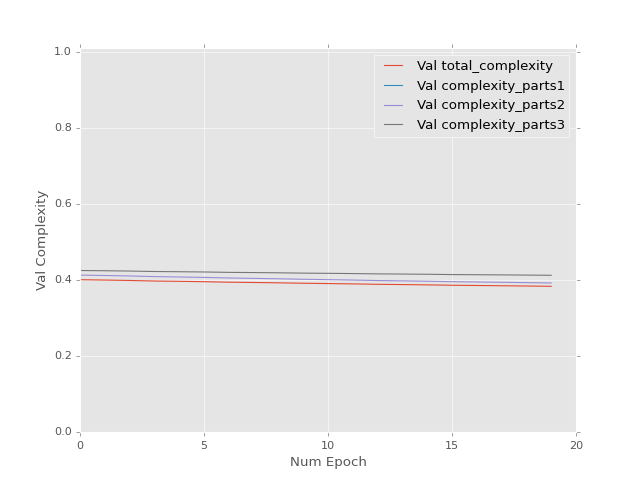

Epoch 1 of 20 took 6.007s
Epoch 2 of 20 took 5.770s
Epoch 3 of 20 took 6.095s
Epoch 4 of 20 took 6.074s
Epoch 5 of 20 took 5.720s
Epoch 6 of 20 took 5.819s
Epoch 7 of 20 took 5.860s
Epoch 8 of 20 took 6.069s
Epoch 9 of 20 took 5.977s
Epoch 10 of 20 took 5.884s
Epoch 11 of 20 took 5.843s
Epoch 12 of 20 took 5.942s
Epoch 13 of 20 took 5.847s
Epoch 14 of 20 took 5.791s
Epoch 15 of 20 took 5.835s
Epoch 16 of 20 took 5.789s
Epoch 17 of 20 took 5.663s
Epoch 18 of 20 took 6.220s
Epoch 19 of 20 took 6.134s
Epoch 20 of 20 took 6.005s
0.871121793985 [[ 0.97988749  0.1840468   0.32358825  1.0342139   0.28255242  0.84338742]]


<IPython.core.display.Javascript object>


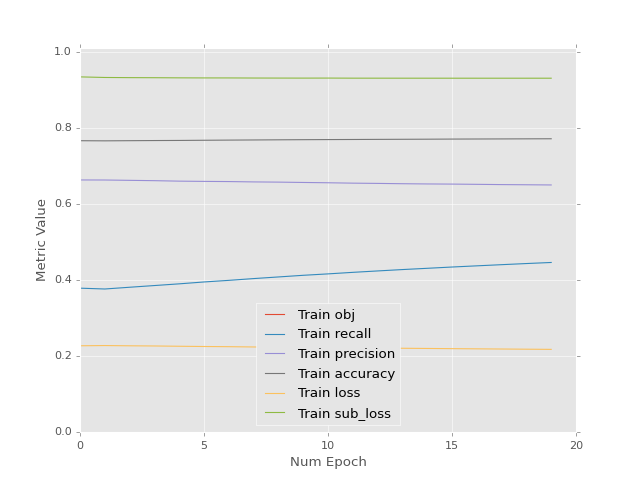

<IPython.core.display.Javascript object>


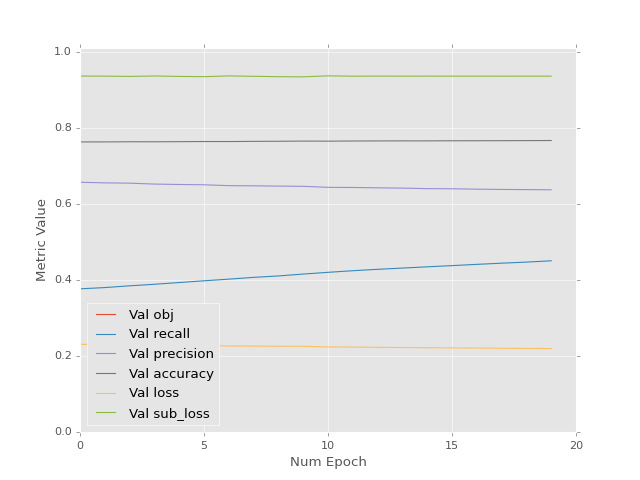

<IPython.core.display.Javascript object>


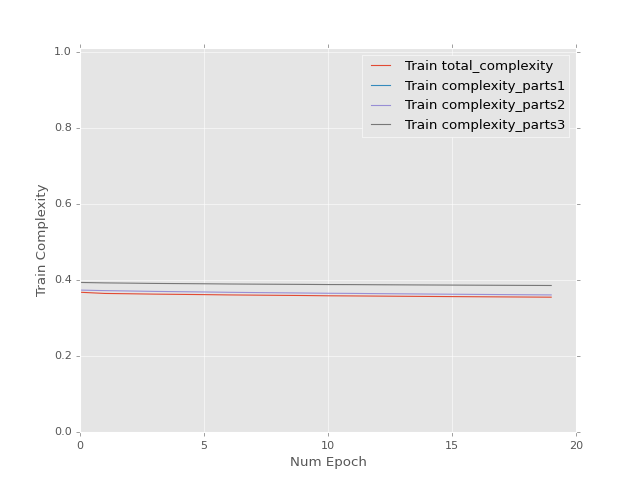

<IPython.core.display.Javascript object>


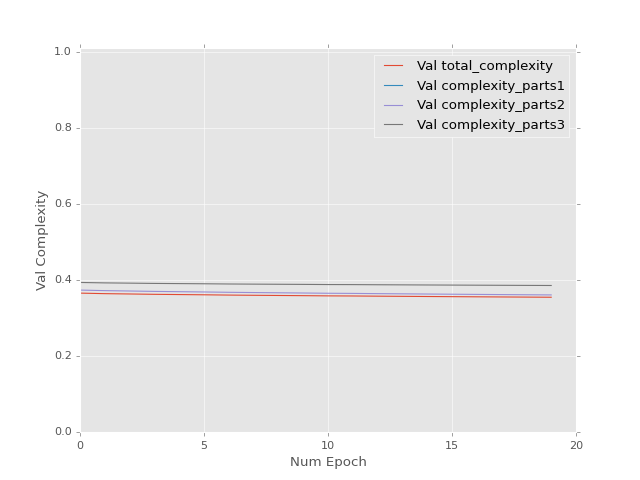

Epoch 1 of 20 took 5.908s
Epoch 2 of 20 took 5.575s
Epoch 3 of 20 took 6.122s
Epoch 4 of 20 took 5.719s
Epoch 5 of 20 took 5.505s
Epoch 6 of 20 took 5.724s
Epoch 7 of 20 took 5.920s
Epoch 8 of 20 took 6.044s
Epoch 9 of 20 took 5.921s
Epoch 10 of 20 took 5.928s
Epoch 11 of 20 took 5.756s
Epoch 12 of 20 took 5.874s
Epoch 13 of 20 took 6.038s
Epoch 14 of 20 took 5.741s
Epoch 15 of 20 took 5.895s
Epoch 16 of 20 took 6.087s
Epoch 17 of 20 took 6.111s
Epoch 18 of 20 took 5.888s
Epoch 19 of 20 took 5.512s
Epoch 20 of 20 took 6.000s
0.827927231789 [[ 1.02704179  0.23123883  0.36880139  1.08104837  0.32925257  0.7962172 ]]


<IPython.core.display.Javascript object>


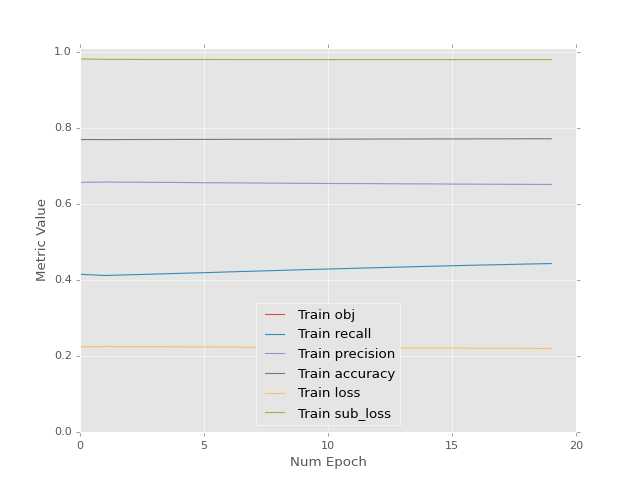

<IPython.core.display.Javascript object>


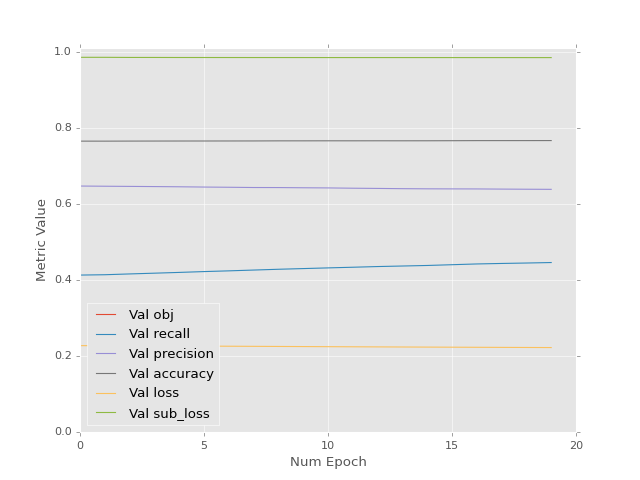

<IPython.core.display.Javascript object>


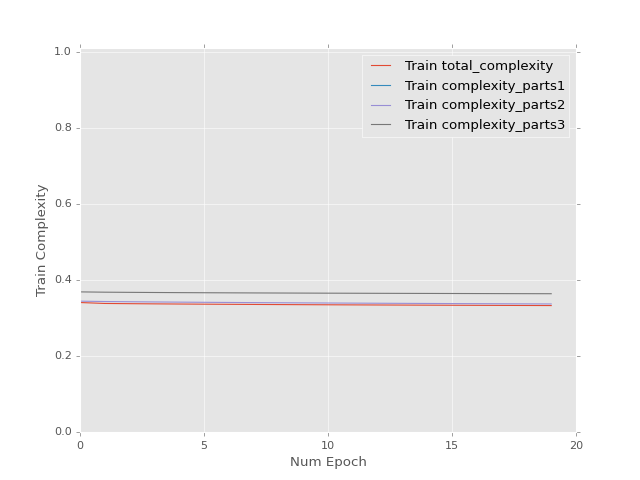

<IPython.core.display.Javascript object>


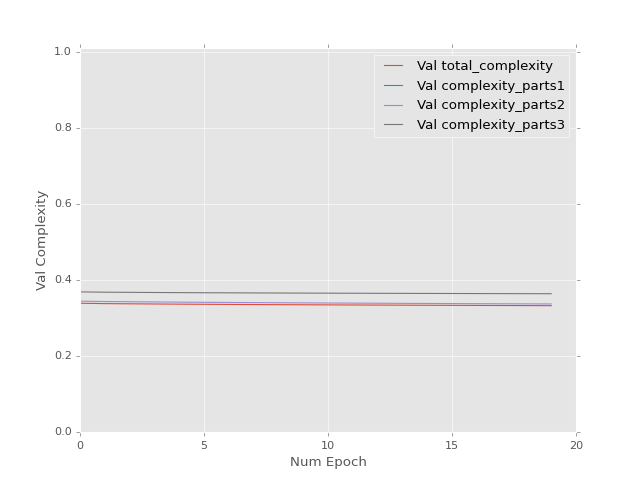

Epoch 1 of 20 took 5.856s
Epoch 2 of 20 took 5.638s
Epoch 3 of 20 took 5.894s
Epoch 4 of 20 took 5.597s
Epoch 5 of 20 took 5.679s
Epoch 6 of 20 took 5.573s
Epoch 7 of 20 took 5.898s
Epoch 8 of 20 took 5.601s
Epoch 9 of 20 took 5.764s
Epoch 10 of 20 took 5.871s
Epoch 11 of 20 took 5.812s
Epoch 12 of 20 took 5.613s
Epoch 13 of 20 took 5.813s
Epoch 14 of 20 took 5.947s
Epoch 15 of 20 took 5.855s
Epoch 16 of 20 took 5.933s
Epoch 17 of 20 took 5.856s
Epoch 18 of 20 took 5.758s
Epoch 19 of 20 took 5.649s
Epoch 20 of 20 took 5.664s
0.786893814802 [[ 1.07347119  0.27776039  0.41320342  1.12686849  0.37479073  0.75012326]]


<IPython.core.display.Javascript object>


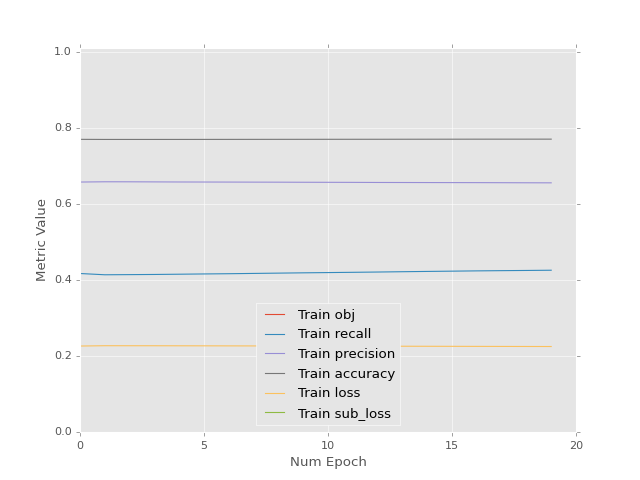

<IPython.core.display.Javascript object>


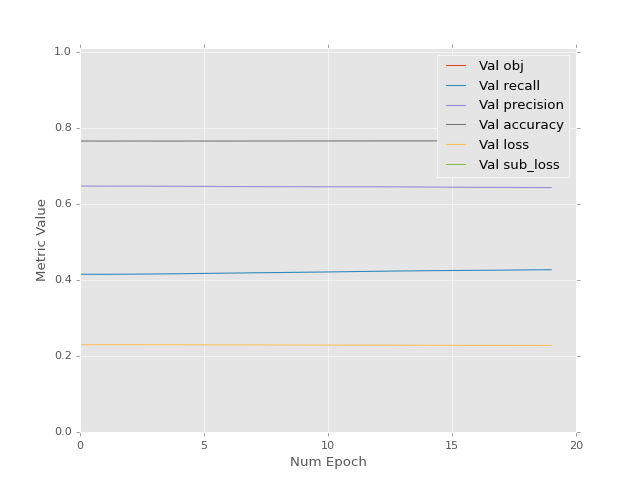

<IPython.core.display.Javascript object>


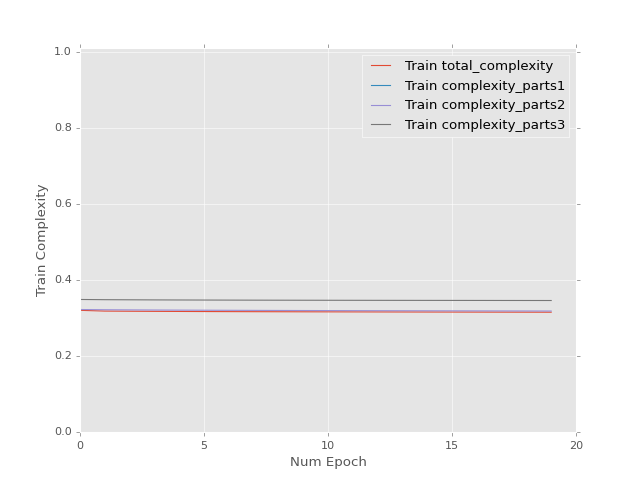

<IPython.core.display.Javascript object>


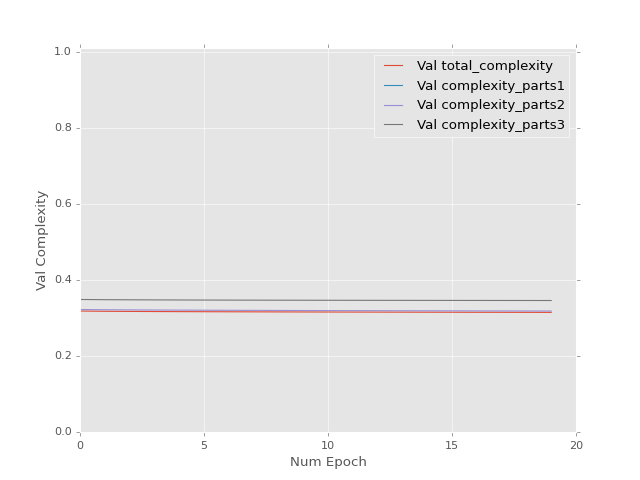

Epoch 1 of 20 took 5.473s
Epoch 2 of 20 took 5.912s
Epoch 3 of 20 took 5.615s
Epoch 4 of 20 took 5.712s
Epoch 5 of 20 took 5.608s
Epoch 6 of 20 took 6.021s
Epoch 7 of 20 took 5.761s
Epoch 8 of 20 took 5.635s
Epoch 9 of 20 took 5.475s
Epoch 10 of 20 took 5.483s
Epoch 11 of 20 took 5.456s
Epoch 12 of 20 took 5.909s
Epoch 13 of 20 took 5.726s
Epoch 14 of 20 took 5.522s
Epoch 15 of 20 took 5.827s
Epoch 16 of 20 took 5.668s
Epoch 17 of 20 took 5.929s
Epoch 18 of 20 took 5.765s
Epoch 19 of 20 took 5.916s
Epoch 20 of 20 took 5.704s
0.748756229877 [[ 1.11872089  0.3231712   0.45648909  1.17115378  0.41859797  0.70576519]]


<IPython.core.display.Javascript object>


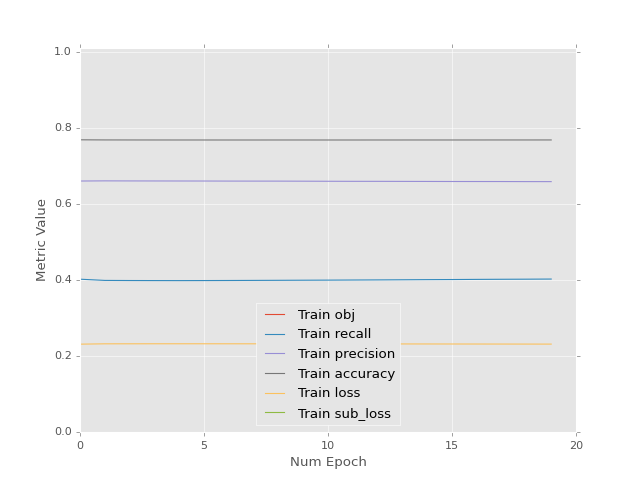

<IPython.core.display.Javascript object>


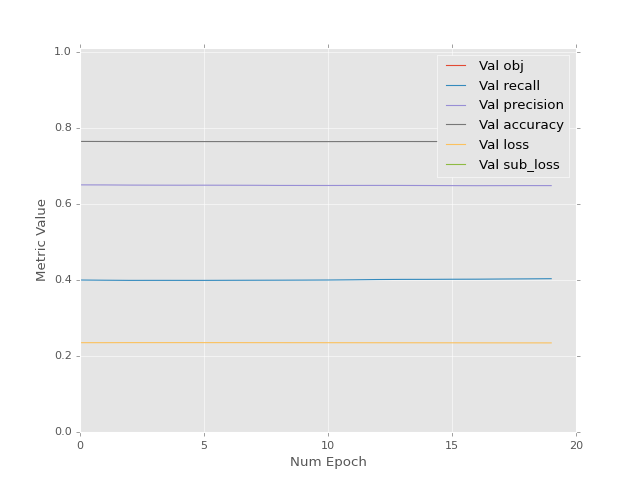

<IPython.core.display.Javascript object>


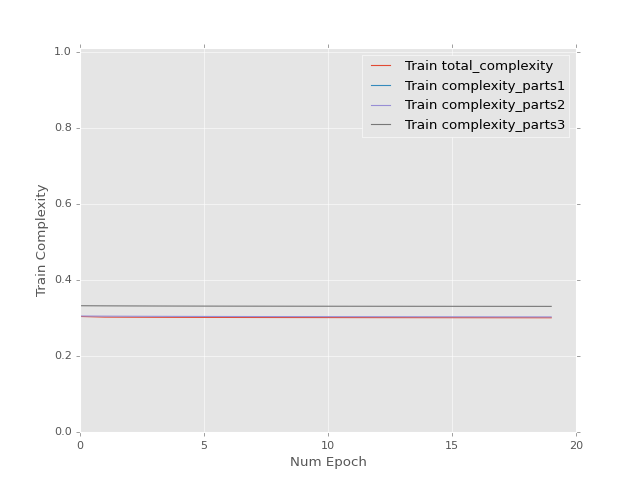

<IPython.core.display.Javascript object>


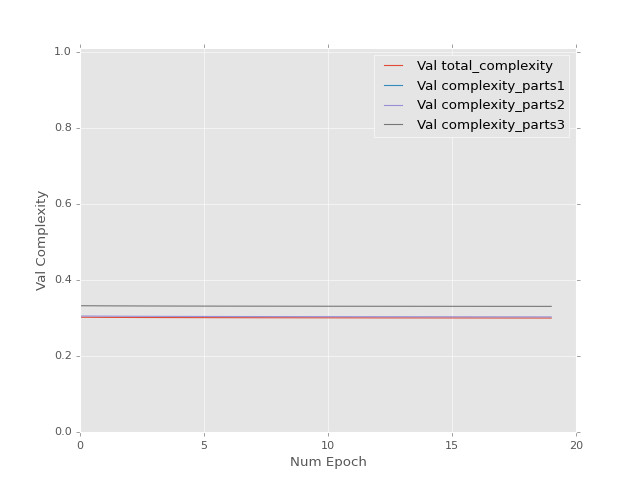

Epoch 1 of 20 took 6.055s
Epoch 2 of 20 took 6.127s
Epoch 3 of 20 took 5.915s
Epoch 4 of 20 took 5.871s
Epoch 5 of 20 took 6.051s
Epoch 6 of 20 took 5.879s
Epoch 7 of 20 took 5.918s
Epoch 8 of 20 took 5.651s
Epoch 9 of 20 took 5.987s
Epoch 10 of 20 took 5.808s
Epoch 11 of 20 took 5.886s
Epoch 12 of 20 took 5.926s
Epoch 13 of 20 took 5.936s
Epoch 14 of 20 took 5.828s
Epoch 15 of 20 took 5.915s
Epoch 16 of 20 took 5.908s
Epoch 17 of 20 took 5.738s
Epoch 18 of 20 took 5.441s
Epoch 19 of 20 took 5.887s
Epoch 20 of 20 took 5.524s
0.713915318251 [[ 1.16249371  0.36718214  0.49848595  1.2135644   0.46029913  0.66359687]]


<IPython.core.display.Javascript object>


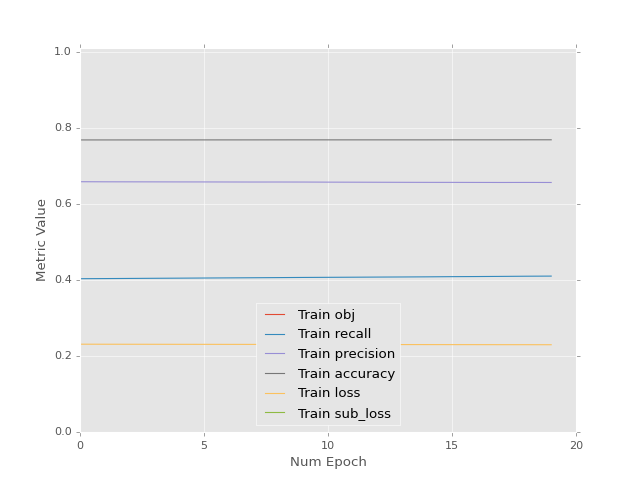

<IPython.core.display.Javascript object>


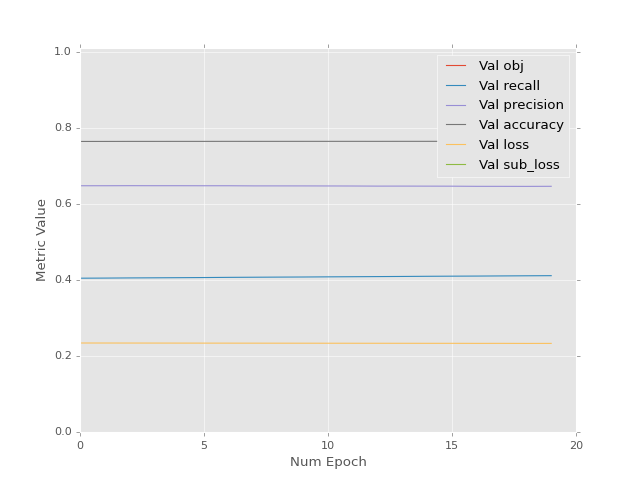

<IPython.core.display.Javascript object>


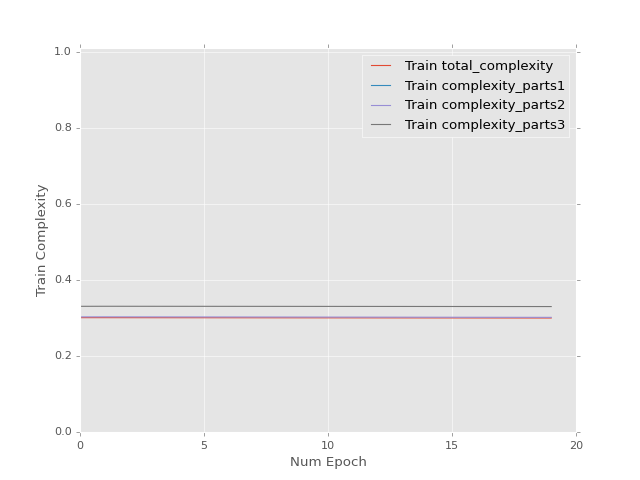

<IPython.core.display.Javascript object>


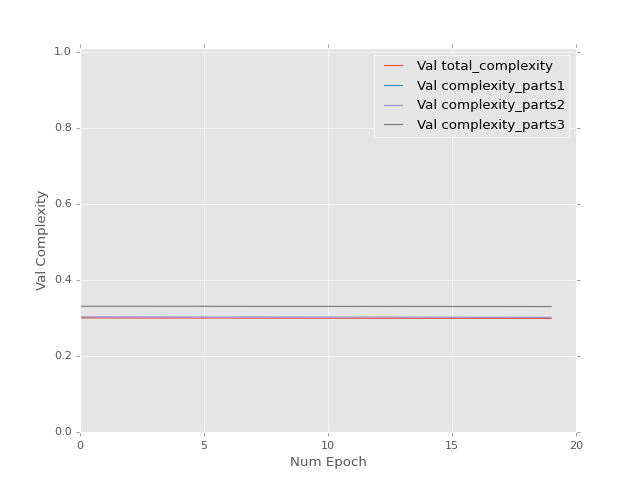

Epoch 1 of 20 took 5.590s
Epoch 2 of 20 took 5.857s
Epoch 3 of 20 took 5.429s
Epoch 4 of 20 took 5.613s
Epoch 5 of 20 took 5.782s
Epoch 6 of 20 took 5.484s
Epoch 7 of 20 took 5.691s
Epoch 8 of 20 took 5.715s
Epoch 9 of 20 took 5.514s
Epoch 10 of 20 took 5.528s
Epoch 11 of 20 took 5.432s
Epoch 12 of 20 took 5.918s
Epoch 13 of 20 took 5.437s
Epoch 14 of 20 took 5.837s
Epoch 15 of 20 took 5.915s
Epoch 16 of 20 took 5.661s
Epoch 17 of 20 took 5.668s
Epoch 18 of 20 took 5.764s
Epoch 19 of 20 took 6.014s
Epoch 20 of 20 took 5.773s
0.71198195219 [[ 1.1612978   0.36616138  0.49853405  1.21178985  0.45823744  0.66584963]]


<IPython.core.display.Javascript object>


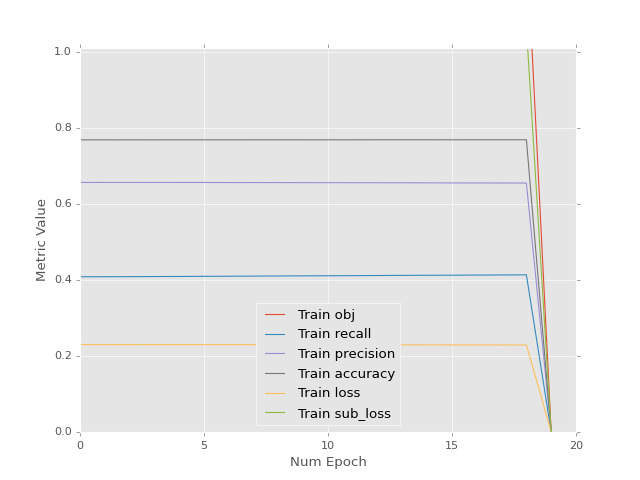

<IPython.core.display.Javascript object>


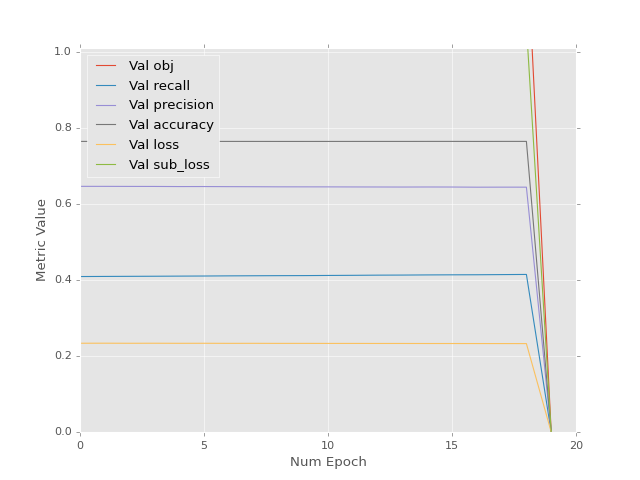

<IPython.core.display.Javascript object>


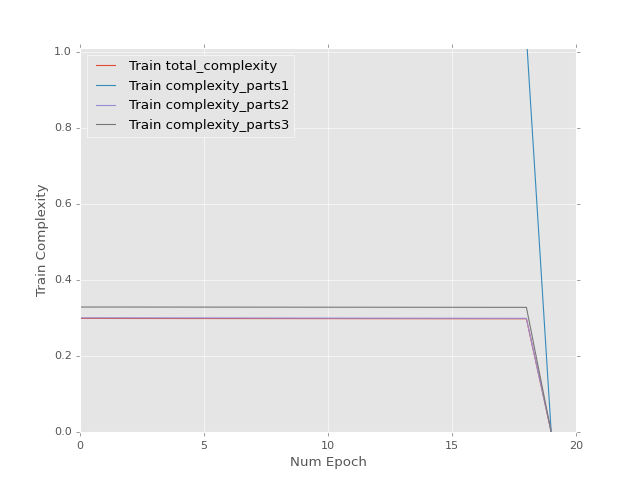

<IPython.core.display.Javascript object>


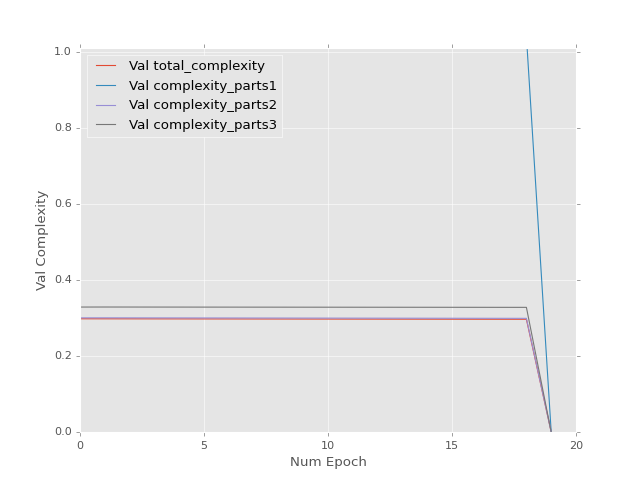

Epoch 1 of 20 took 5.436s
Epoch 2 of 20 took 5.434s
Epoch 3 of 20 took 5.534s
Epoch 4 of 20 took 5.950s
Epoch 5 of 20 took 5.821s
Epoch 6 of 20 took 5.475s
Epoch 7 of 20 took 5.661s
Epoch 8 of 20 took 5.569s
Epoch 9 of 20 took 5.667s
Epoch 10 of 20 took 5.461s
Epoch 11 of 20 took 5.433s
Epoch 12 of 20 took 5.672s
Epoch 13 of 20 took 5.491s
Epoch 14 of 20 took 5.949s
Epoch 15 of 20 took 5.783s
Epoch 16 of 20 took 5.613s
Epoch 17 of 20 took 5.699s
Epoch 18 of 20 took 5.622s
Epoch 19 of 20 took 6.000s
Epoch 20 of 20 took 5.722s
0.709383457899 [[ 1.16491008  0.37003669  0.50426787  1.21466947  0.46078968  0.66357565]]


<IPython.core.display.Javascript object>


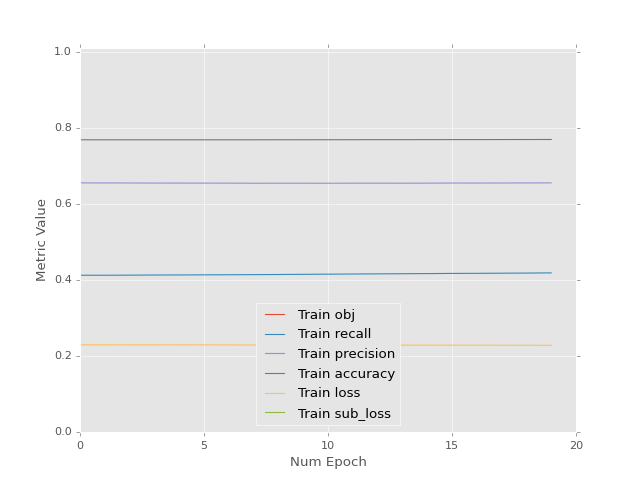

<IPython.core.display.Javascript object>


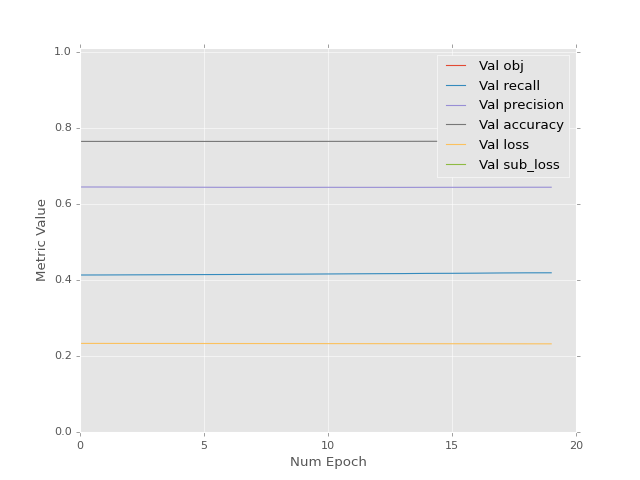

<IPython.core.display.Javascript object>


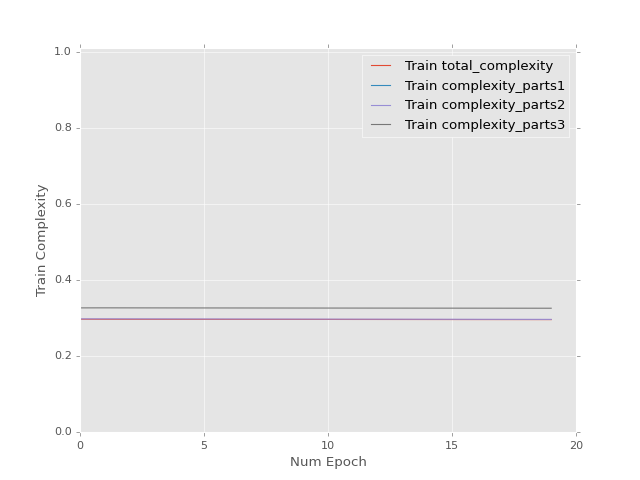

<IPython.core.display.Javascript object>


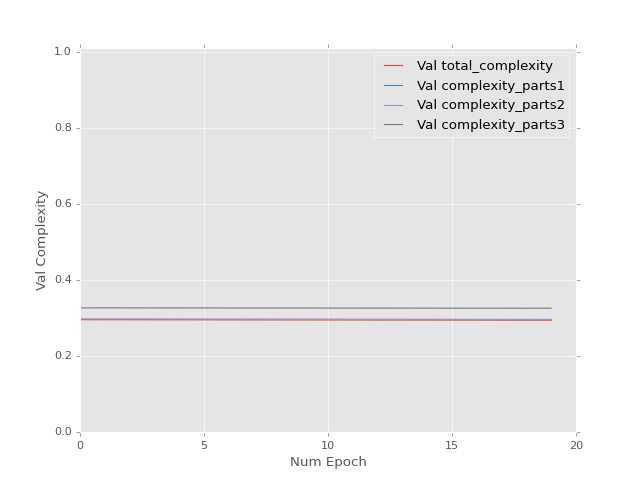

Epoch 1 of 20 took 5.741s
Epoch 2 of 20 took 5.675s
Epoch 3 of 20 took 5.842s
Epoch 4 of 20 took 5.848s
Epoch 5 of 20 took 5.481s
Epoch 6 of 20 took 5.667s
Epoch 7 of 20 took 5.936s
Epoch 8 of 20 took 5.469s
Epoch 9 of 20 took 5.894s
Epoch 10 of 20 took 5.919s
Epoch 11 of 20 took 5.739s
Epoch 12 of 20 took 5.818s
Epoch 13 of 20 took 5.581s
Epoch 14 of 20 took 5.655s
Epoch 15 of 20 took 5.521s
Epoch 16 of 20 took 5.696s
Epoch 17 of 20 took 5.927s
Epoch 18 of 20 took 5.741s
Epoch 19 of 20 took 6.153s
Epoch 20 of 20 took 5.842s
0.706774175167 [[ 1.16855669  0.37394968  0.5100596   1.21757507  0.46336406  0.66128433]]


<IPython.core.display.Javascript object>


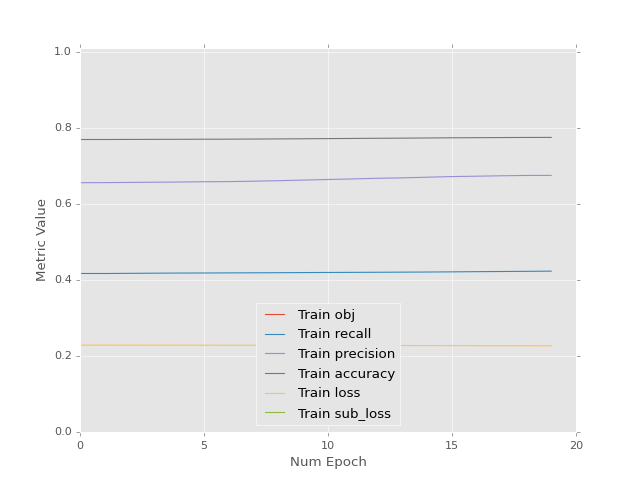

<IPython.core.display.Javascript object>


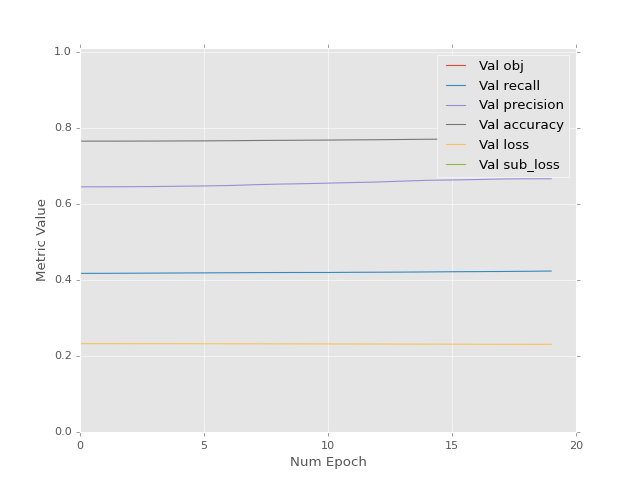

<IPython.core.display.Javascript object>


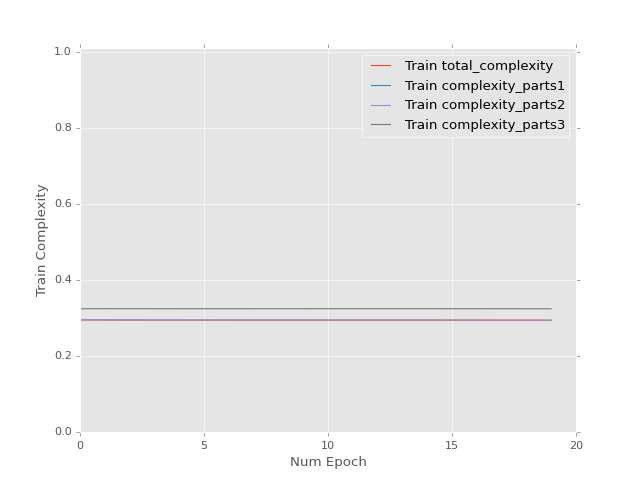

<IPython.core.display.Javascript object>


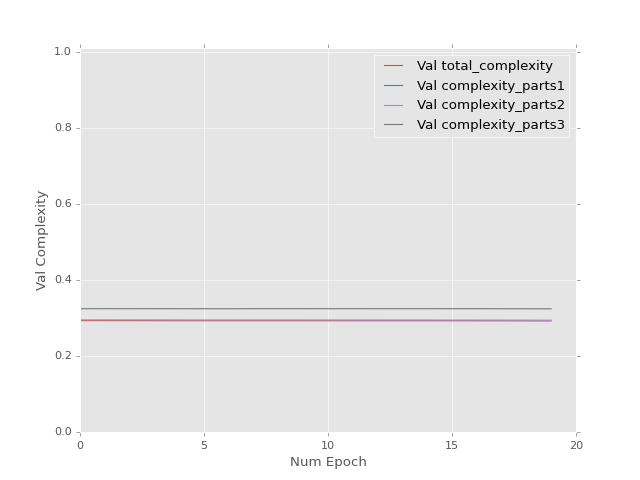

Epoch 1 of 20 took 5.477s
Epoch 2 of 20 took 5.671s
Epoch 3 of 20 took 5.807s
Epoch 4 of 20 took 5.779s
Epoch 5 of 20 took 5.764s
Epoch 6 of 20 took 5.841s
Epoch 7 of 20 took 5.827s
Epoch 8 of 20 took 5.826s
Epoch 9 of 20 took 5.602s
Epoch 10 of 20 took 5.434s
Epoch 11 of 20 took 5.526s
Epoch 12 of 20 took 5.573s
Epoch 13 of 20 took 5.485s
Epoch 14 of 20 took 5.636s
Epoch 15 of 20 took 5.771s
Epoch 16 of 20 took 5.824s
Epoch 17 of 20 took 5.960s
Epoch 18 of 20 took 5.614s
Epoch 19 of 20 took 5.730s
Epoch 20 of 20 took 5.789s
0.70413467288 [[ 1.17226815  0.3779324   0.51595938  1.22053182  0.46598327  0.65895587]]


<IPython.core.display.Javascript object>


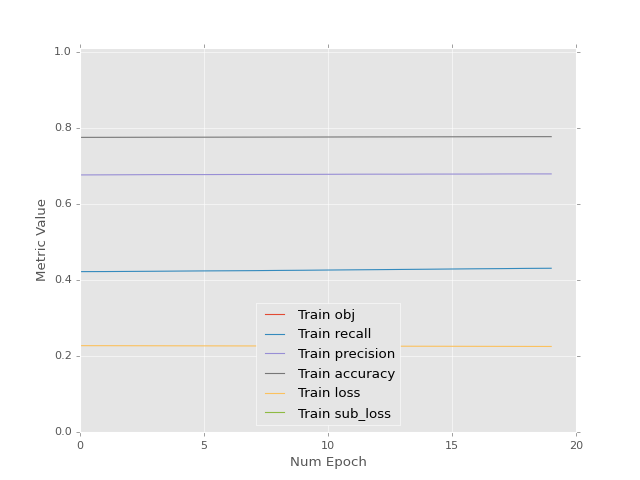

<IPython.core.display.Javascript object>


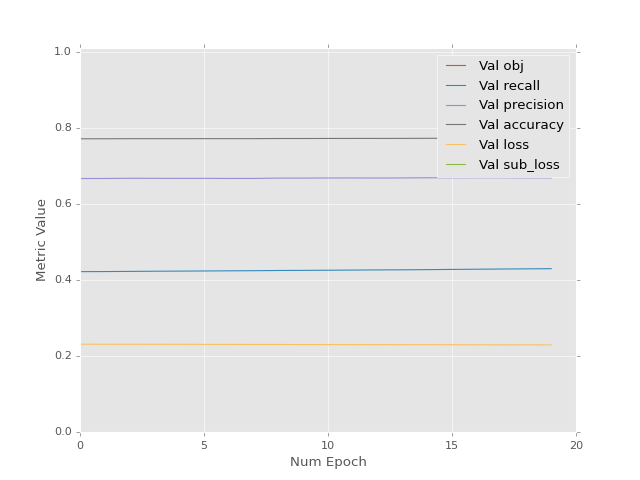

<IPython.core.display.Javascript object>


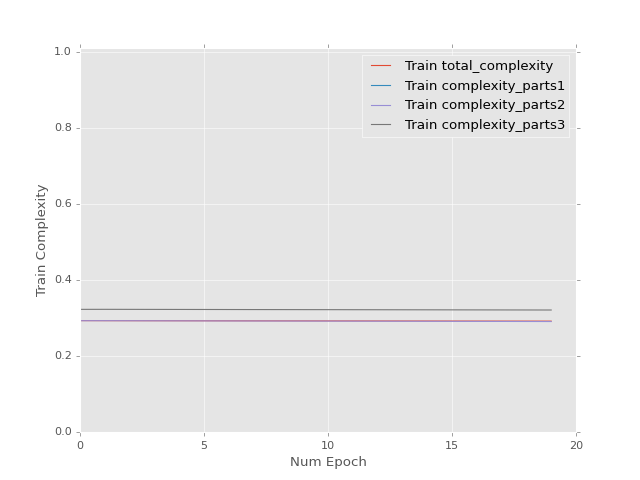

<IPython.core.display.Javascript object>


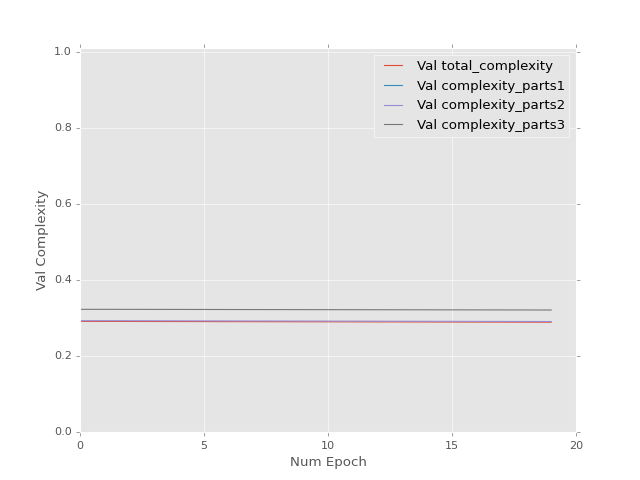

Epoch 1 of 20 took 5.819s
Epoch 2 of 20 took 5.911s
Epoch 3 of 20 took 5.527s
Epoch 4 of 20 took 5.451s
Epoch 5 of 20 took 5.667s
Epoch 6 of 20 took 5.445s
Epoch 7 of 20 took 5.446s
Epoch 8 of 20 took 5.840s
Epoch 9 of 20 took 5.440s
Epoch 10 of 20 took 5.968s
Epoch 11 of 20 took 5.619s
Epoch 12 of 20 took 5.583s
Epoch 13 of 20 took 5.845s
Epoch 14 of 20 took 5.850s
Epoch 15 of 20 took 5.817s
Epoch 16 of 20 took 5.533s
Epoch 17 of 20 took 5.551s
Epoch 18 of 20 took 5.461s
Epoch 19 of 20 took 5.429s
Epoch 20 of 20 took 5.781s
0.701433300972 [[ 1.17609167  0.38203529  0.52204394  1.22357881  0.46868289  0.65655893]]


<IPython.core.display.Javascript object>


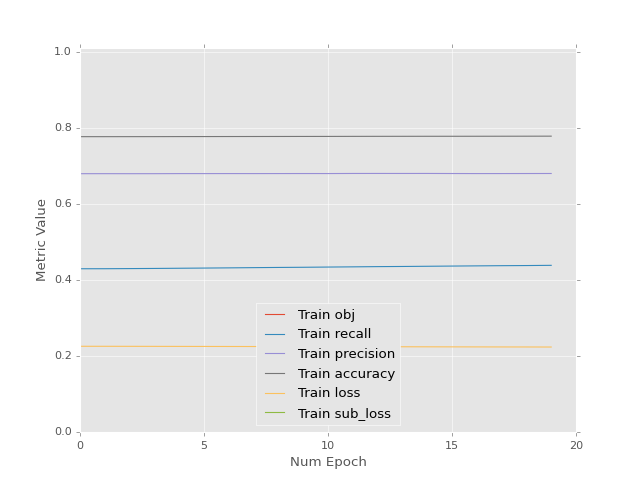

<IPython.core.display.Javascript object>


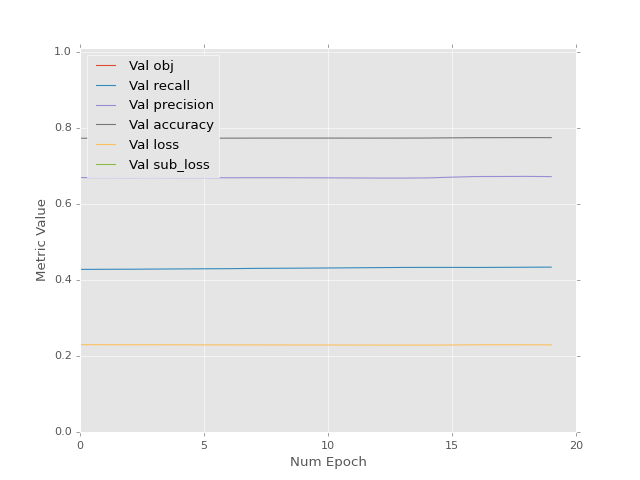

<IPython.core.display.Javascript object>


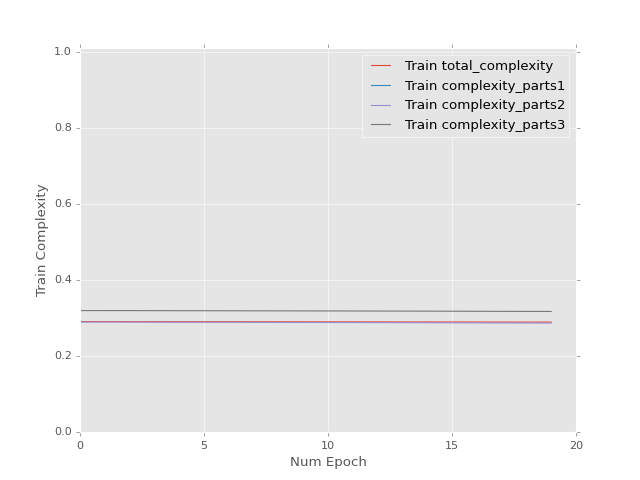

<IPython.core.display.Javascript object>


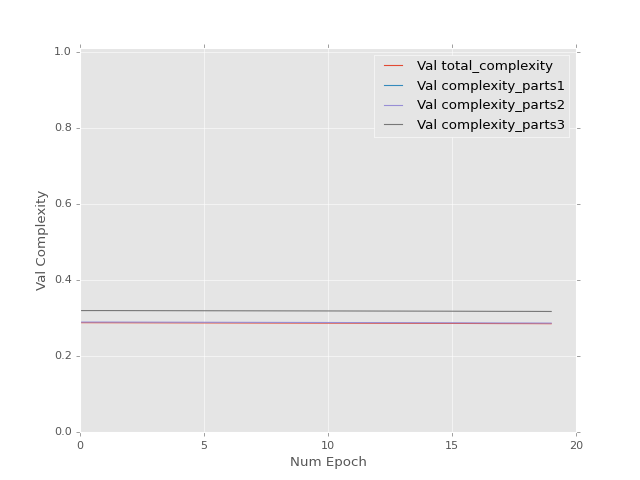

Epoch 1 of 20 took 5.675s
Epoch 2 of 20 took 5.866s
Epoch 3 of 20 took 5.676s
Epoch 4 of 20 took 5.448s
Epoch 5 of 20 took 5.579s
Epoch 6 of 20 took 5.795s
Epoch 7 of 20 took 5.791s
Epoch 8 of 20 took 5.634s
Epoch 9 of 20 took 5.838s
Epoch 10 of 20 took 5.687s
Epoch 11 of 20 took 5.695s
Epoch 12 of 20 took 6.012s
Epoch 13 of 20 took 5.470s
Epoch 14 of 20 took 5.425s
Epoch 15 of 20 took 5.896s
Epoch 16 of 20 took 5.569s
Epoch 17 of 20 took 5.714s
Epoch 18 of 20 took 5.840s
Epoch 19 of 20 took 5.577s
Epoch 20 of 20 took 5.431s
0.698621034622 [[ 1.18009901  0.38633451  0.52842438  1.22677612  0.47151682  0.65404648]]


<IPython.core.display.Javascript object>


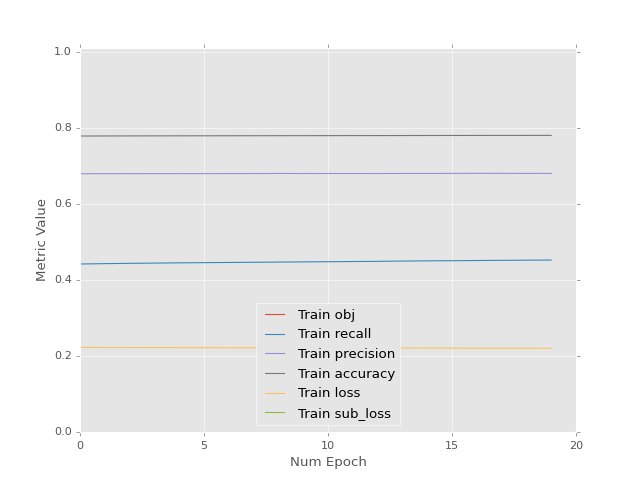

<IPython.core.display.Javascript object>


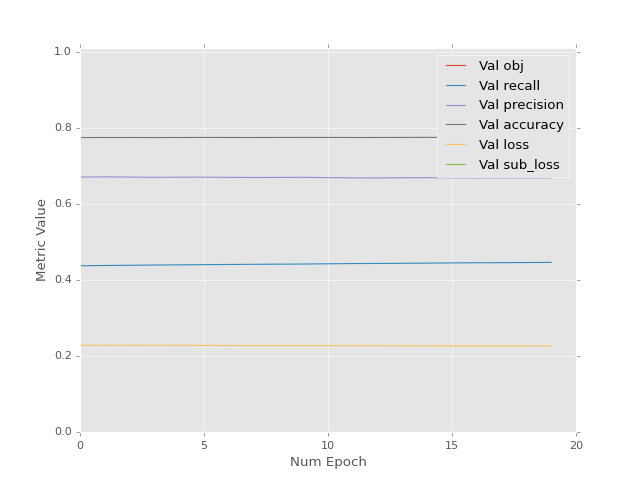

<IPython.core.display.Javascript object>


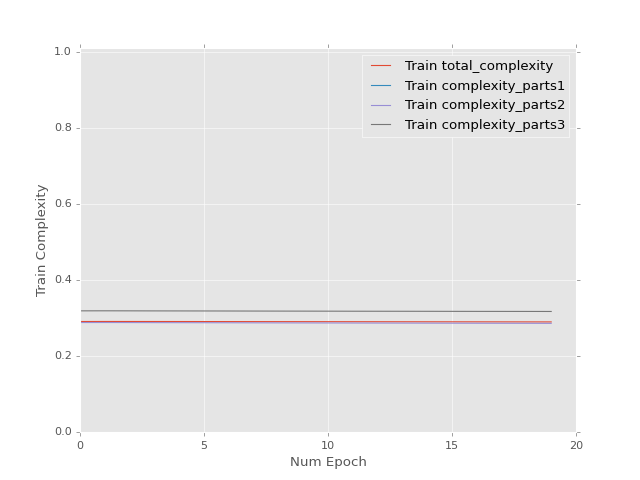

<IPython.core.display.Javascript object>


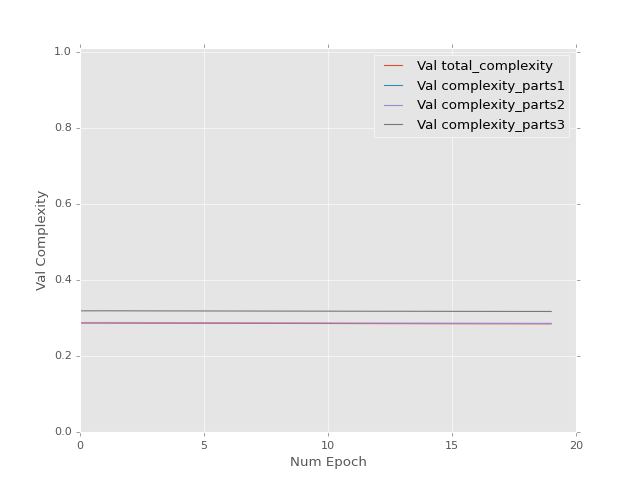

Epoch 1 of 20 took 5.653s
Epoch 2 of 20 took 5.690s
Epoch 3 of 20 took 5.423s
Epoch 4 of 20 took 5.724s
Epoch 5 of 20 took 5.429s
Epoch 6 of 20 took 5.675s
Epoch 7 of 20 took 5.635s
Epoch 8 of 20 took 5.439s
Epoch 9 of 20 took 5.466s
Epoch 10 of 20 took 5.430s
Epoch 11 of 20 took 5.641s
Epoch 12 of 20 took 5.695s
Epoch 13 of 20 took 5.855s
Epoch 14 of 20 took 5.882s
Epoch 15 of 20 took 6.129s
Epoch 16 of 20 took 5.688s
Epoch 17 of 20 took 6.125s
Epoch 18 of 20 took 5.842s
Epoch 19 of 20 took 5.849s
Epoch 20 of 20 took 5.790s
0.703312337399 [[ 1.17372215  0.3800295   0.52298933  1.22026598  0.4649502   0.66077191]]


<IPython.core.display.Javascript object>


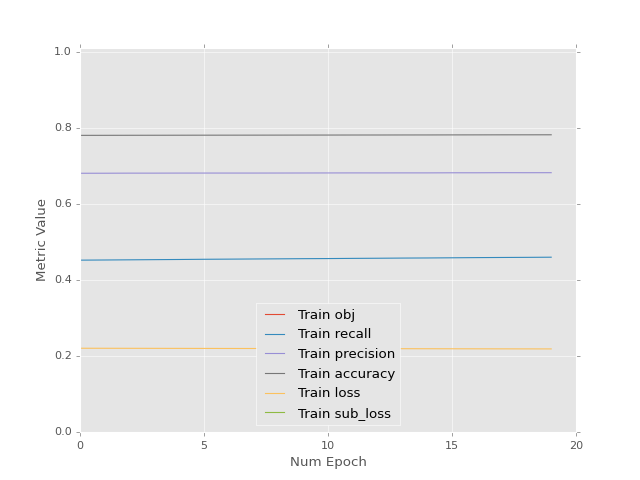

<IPython.core.display.Javascript object>


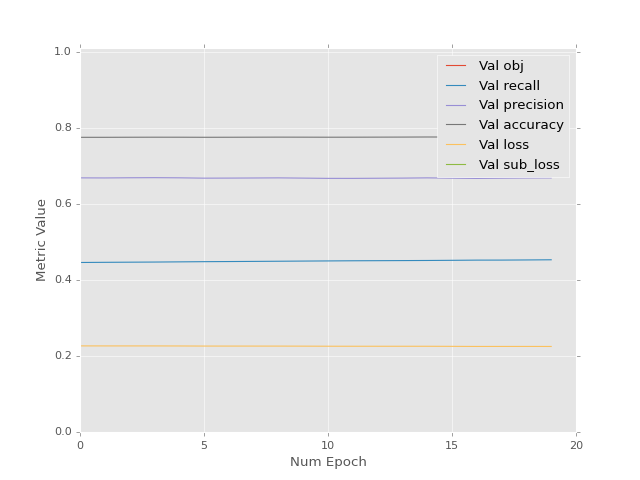

<IPython.core.display.Javascript object>


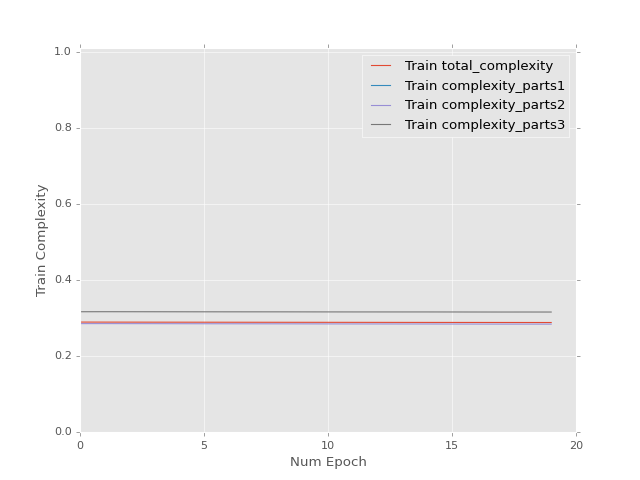

<IPython.core.display.Javascript object>


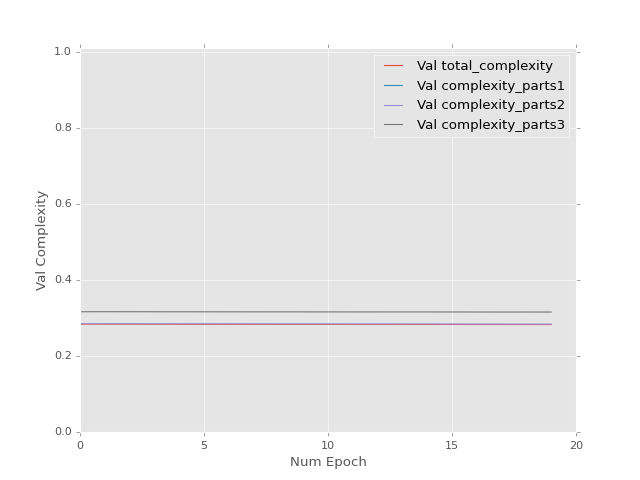

Epoch 1 of 20 took 6.018s
Epoch 2 of 20 took 5.646s
Epoch 3 of 20 took 5.719s
Epoch 4 of 20 took 5.951s
Epoch 5 of 20 took 5.745s
Epoch 6 of 20 took 5.816s
Epoch 7 of 20 took 5.700s
Epoch 8 of 20 took 5.705s
Epoch 9 of 20 took 5.688s
Epoch 10 of 20 took 5.698s
Epoch 11 of 20 took 5.738s
Epoch 12 of 20 took 5.706s
Epoch 13 of 20 took 5.780s
Epoch 14 of 20 took 5.735s
Epoch 15 of 20 took 5.835s
Epoch 16 of 20 took 5.780s
Epoch 17 of 20 took 5.718s
Epoch 18 of 20 took 5.857s
Epoch 19 of 20 took 5.729s
Epoch 20 of 20 took 5.701s
0.702253252268 [[ 1.17519903  0.38161835  0.52542585  1.22144353  0.46599323  0.65985006]]


<IPython.core.display.Javascript object>


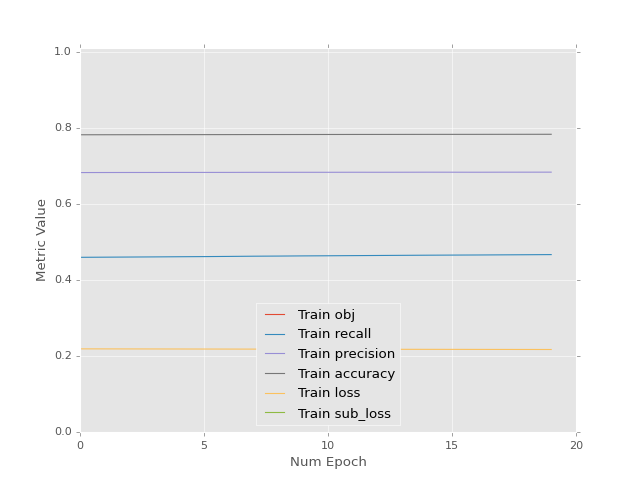

<IPython.core.display.Javascript object>


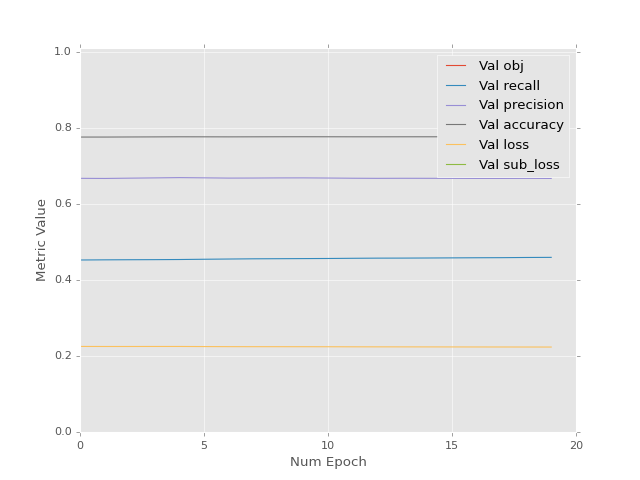

<IPython.core.display.Javascript object>


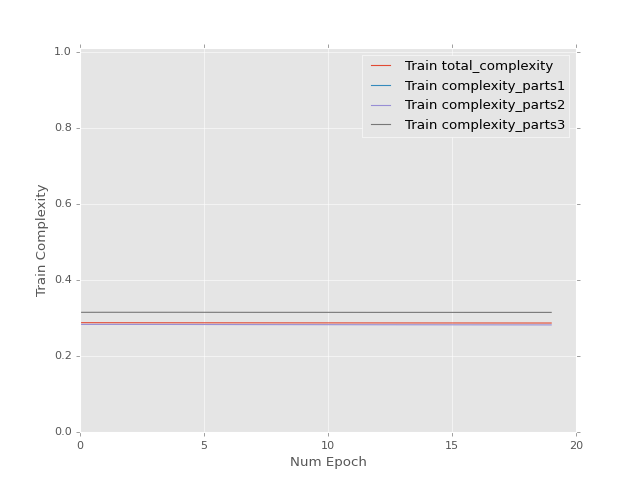

<IPython.core.display.Javascript object>


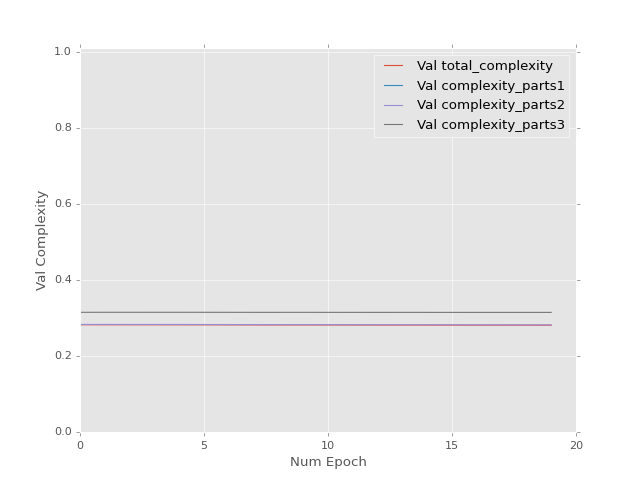

Epoch 1 of 20 took 5.827s
Epoch 2 of 20 took 5.991s
Epoch 3 of 20 took 5.805s
Epoch 4 of 20 took 5.763s
Epoch 5 of 20 took 5.950s
Epoch 6 of 20 took 5.847s
Epoch 7 of 20 took 6.117s
Epoch 8 of 20 took 5.815s
Epoch 9 of 20 took 5.779s
Epoch 10 of 20 took 5.839s
Epoch 11 of 20 took 5.698s
Epoch 12 of 20 took 5.703s
Epoch 13 of 20 took 5.801s
Epoch 14 of 20 took 5.923s
Epoch 15 of 20 took 5.862s
Epoch 16 of 20 took 5.790s
Epoch 17 of 20 took 5.712s
Epoch 18 of 20 took 5.707s
Epoch 19 of 20 took 5.741s
Epoch 20 of 20 took 5.838s
0.701114356518 [[ 1.17679822  0.38333756  0.52805954  1.22272158  0.46712676  0.65884954]]


<IPython.core.display.Javascript object>


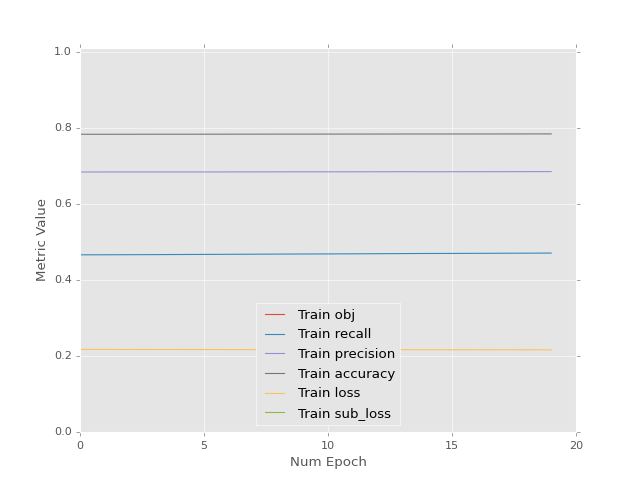

<IPython.core.display.Javascript object>


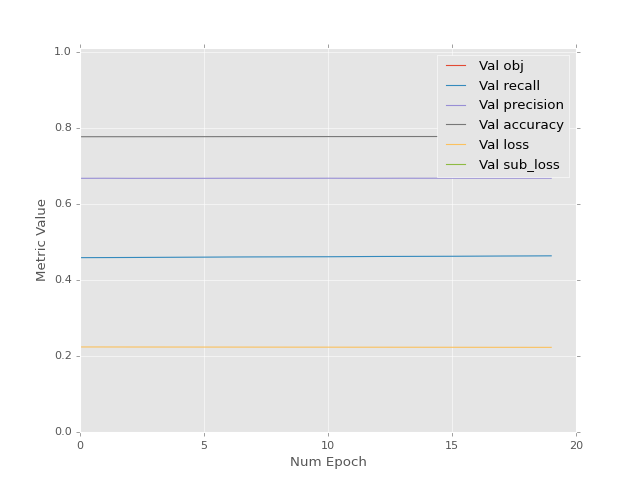

<IPython.core.display.Javascript object>


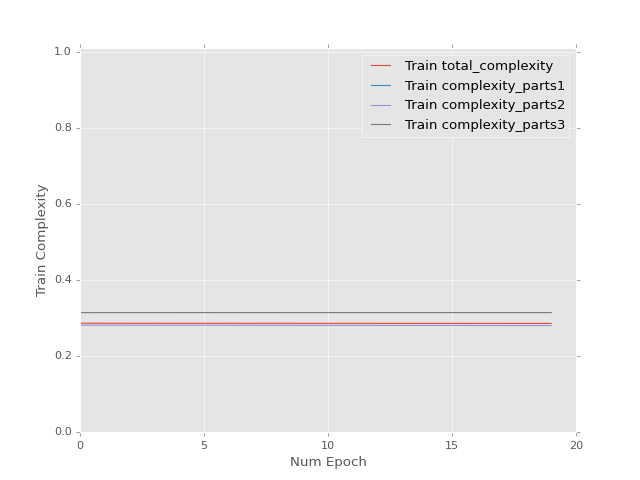

<IPython.core.display.Javascript object>


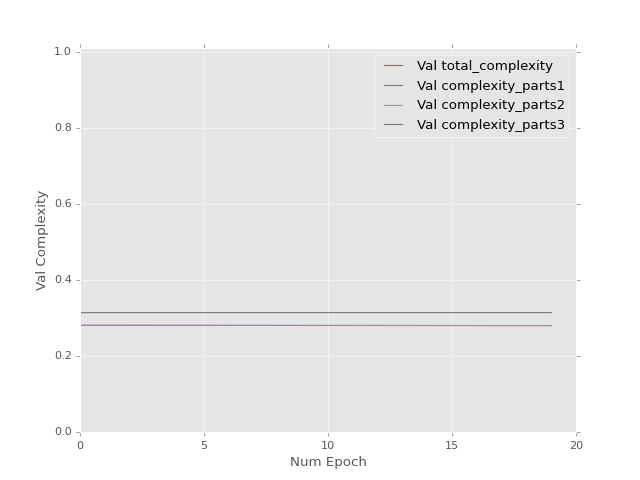

Epoch 1 of 20 took 5.819s
Epoch 2 of 20 took 5.813s
Epoch 3 of 20 took 5.815s
Epoch 4 of 20 took 5.735s
Epoch 5 of 20 took 5.923s
Epoch 6 of 20 took 6.018s
Epoch 7 of 20 took 5.879s
Epoch 8 of 20 took 5.986s
Epoch 9 of 20 took 5.732s
Epoch 10 of 20 took 6.040s
Epoch 11 of 20 took 5.883s
Epoch 12 of 20 took 5.901s
Epoch 13 of 20 took 5.833s
Epoch 14 of 20 took 5.711s
Epoch 15 of 20 took 5.719s
Epoch 16 of 20 took 5.797s
Epoch 17 of 20 took 5.747s
Epoch 18 of 20 took 5.764s
Epoch 19 of 20 took 5.825s
Epoch 20 of 20 took 5.907s
0.699851334095 [[ 1.17858171  0.38525361  0.53098923  1.22415161  0.46839663  0.65772998]]


<IPython.core.display.Javascript object>


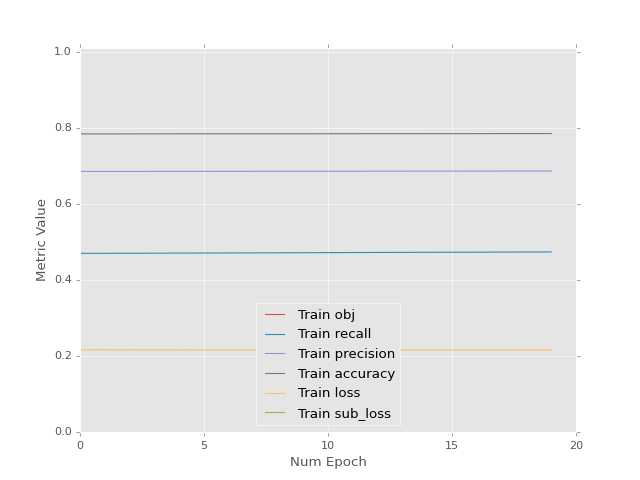

<IPython.core.display.Javascript object>


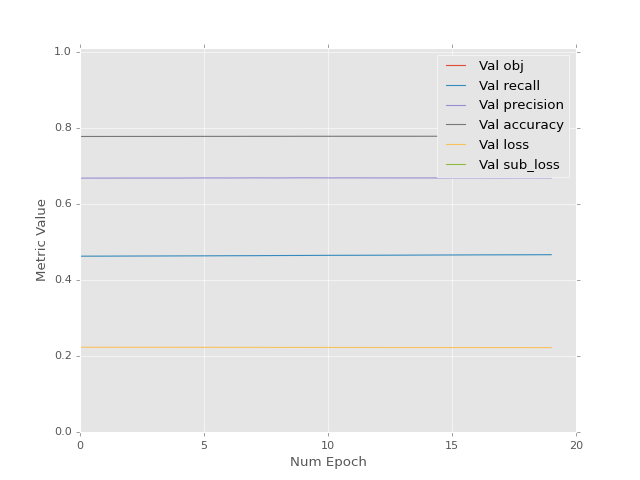

<IPython.core.display.Javascript object>


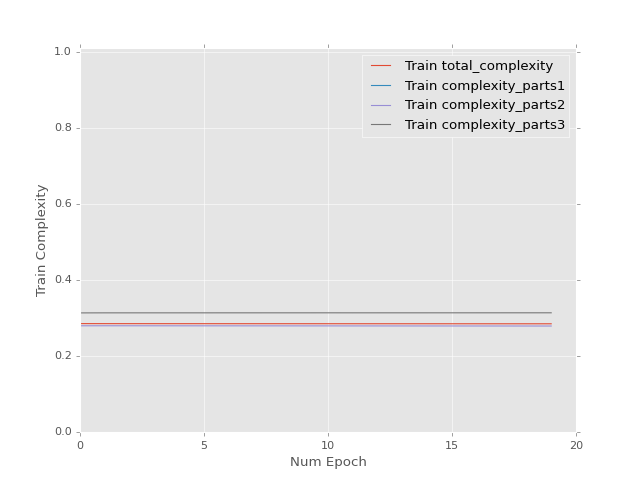

<IPython.core.display.Javascript object>


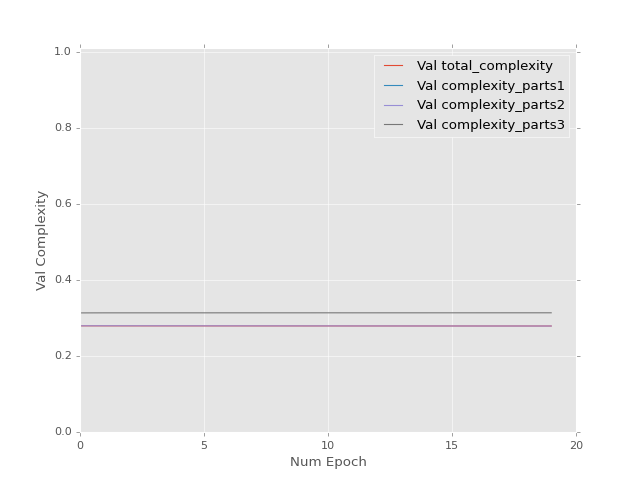

Epoch 1 of 20 took 6.009s
Epoch 2 of 20 took 5.991s
Epoch 3 of 20 took 6.061s
Epoch 4 of 20 took 5.837s
Epoch 5 of 20 took 5.876s
Epoch 6 of 20 took 5.987s
Epoch 7 of 20 took 5.808s
Epoch 8 of 20 took 5.790s
Epoch 9 of 20 took 5.848s
Epoch 10 of 20 took 5.808s
Epoch 11 of 20 took 5.705s
Epoch 12 of 20 took 5.744s
Epoch 13 of 20 took 5.824s
Epoch 14 of 20 took 5.710s
Epoch 15 of 20 took 5.718s
Epoch 16 of 20 took 5.824s
Epoch 17 of 20 took 5.845s
Epoch 18 of 20 took 5.867s
Epoch 19 of 20 took 5.710s
Epoch 20 of 20 took 5.825s
0.698409587145 [[ 1.18063378  0.38745618  0.53434497  1.22580254  0.46986479  0.65643734]]


<IPython.core.display.Javascript object>


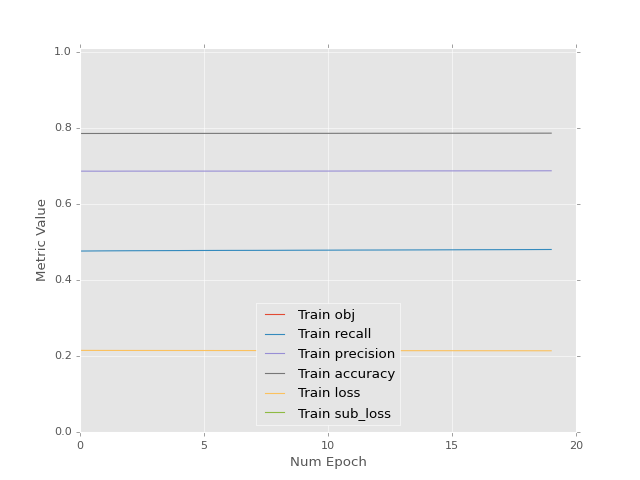

<IPython.core.display.Javascript object>


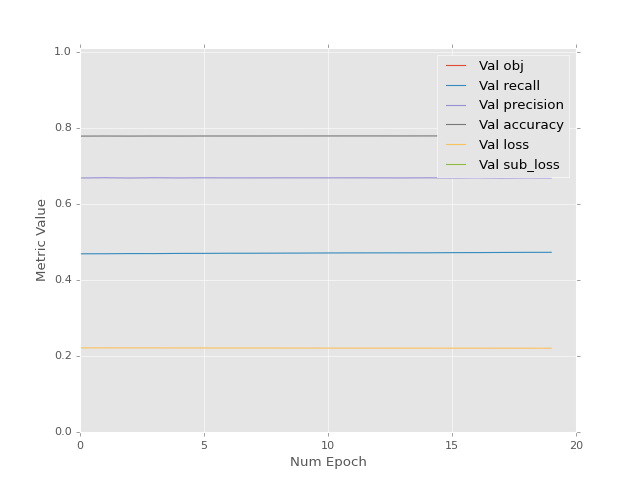

<IPython.core.display.Javascript object>


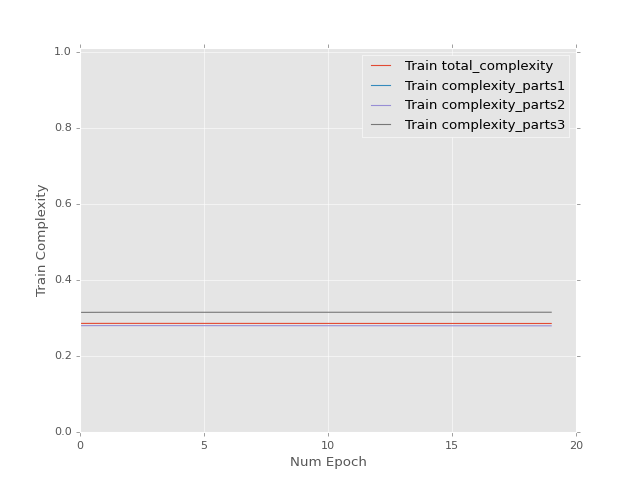

<IPython.core.display.Javascript object>


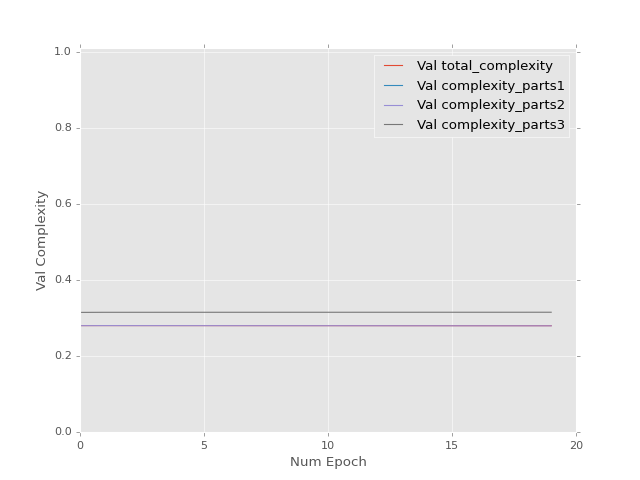

Epoch 1 of 20 took 5.775s
Epoch 2 of 20 took 5.993s
Epoch 3 of 20 took 5.885s
Epoch 4 of 20 took 5.854s
Epoch 5 of 20 took 5.895s
Epoch 6 of 20 took 5.927s
Epoch 7 of 20 took 5.741s
Epoch 8 of 20 took 5.952s
Epoch 9 of 20 took 5.886s
Epoch 10 of 20 took 6.093s
Epoch 11 of 20 took 5.657s
Epoch 12 of 20 took 5.804s
Epoch 13 of 20 took 6.057s
Epoch 14 of 20 took 5.736s
Epoch 15 of 20 took 5.714s
Epoch 16 of 20 took 5.838s
Epoch 17 of 20 took 5.767s
Epoch 18 of 20 took 5.851s
Epoch 19 of 20 took 5.753s
Epoch 20 of 20 took 5.717s
0.701557397842 [[ 1.17640865  0.38328549  0.53065813  1.22144783  0.46544915  0.66093749]]


<IPython.core.display.Javascript object>


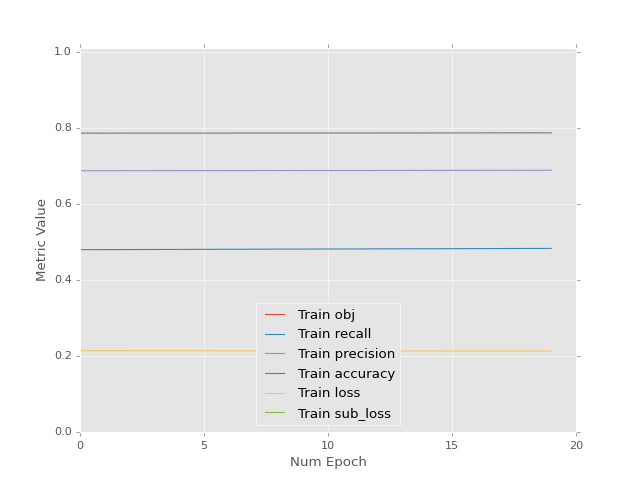

<IPython.core.display.Javascript object>


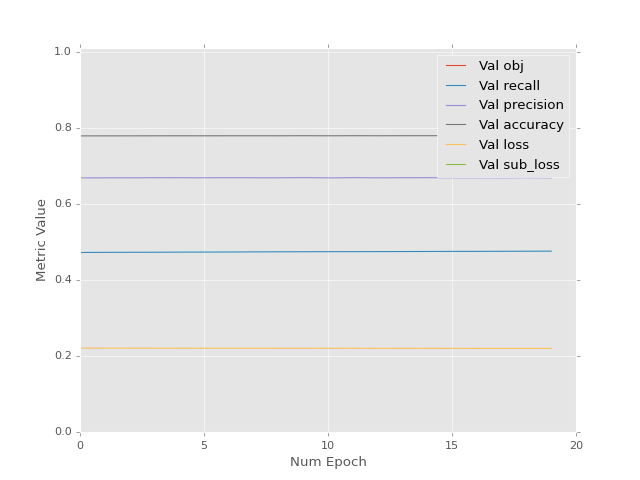

<IPython.core.display.Javascript object>


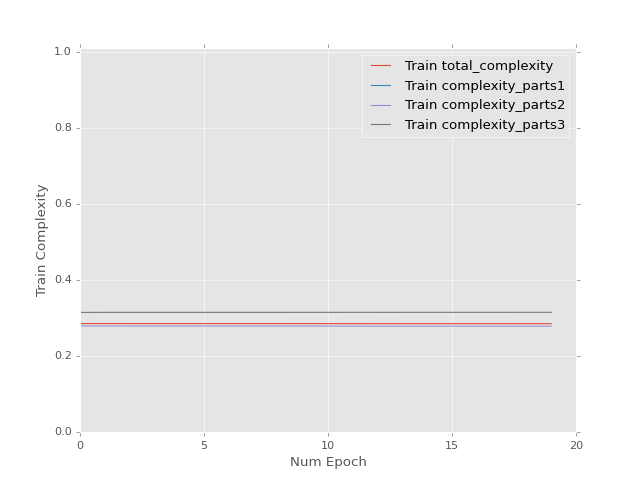

<IPython.core.display.Javascript object>


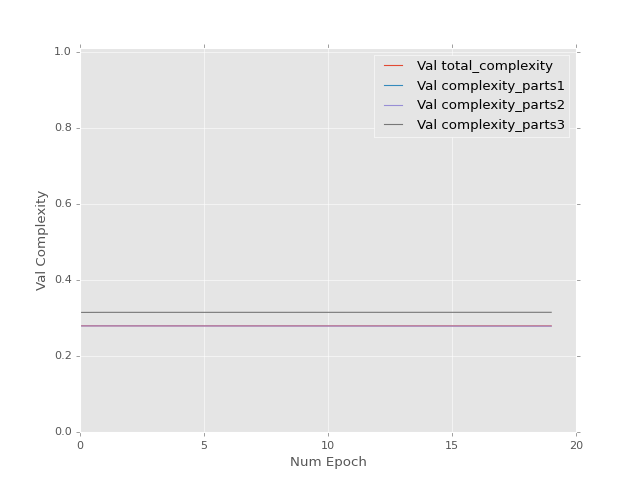

Epoch 1 of 20 took 5.926s
Epoch 2 of 20 took 5.942s
Epoch 3 of 20 took 5.923s
Epoch 4 of 20 took 5.702s
Epoch 5 of 20 took 5.678s
Epoch 6 of 20 took 5.904s
Epoch 7 of 20 took 5.876s
Epoch 8 of 20 took 5.866s
Epoch 9 of 20 took 5.785s
Epoch 10 of 20 took 5.786s
Epoch 11 of 20 took 5.961s
Epoch 12 of 20 took 5.856s
Epoch 13 of 20 took 5.775s
Epoch 14 of 20 took 5.810s
Epoch 15 of 20 took 5.783s
Epoch 16 of 20 took 5.723s
Epoch 17 of 20 took 5.973s
Epoch 18 of 20 took 5.746s
Epoch 19 of 20 took 5.772s
Epoch 20 of 20 took 5.955s
0.700809001923 [[ 1.17744792  0.38440213  0.53237629  1.22228575  0.46619478  0.66028178]]


<IPython.core.display.Javascript object>


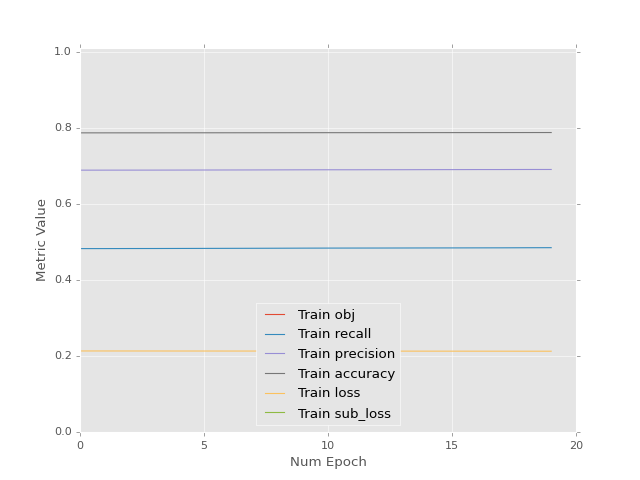

<IPython.core.display.Javascript object>


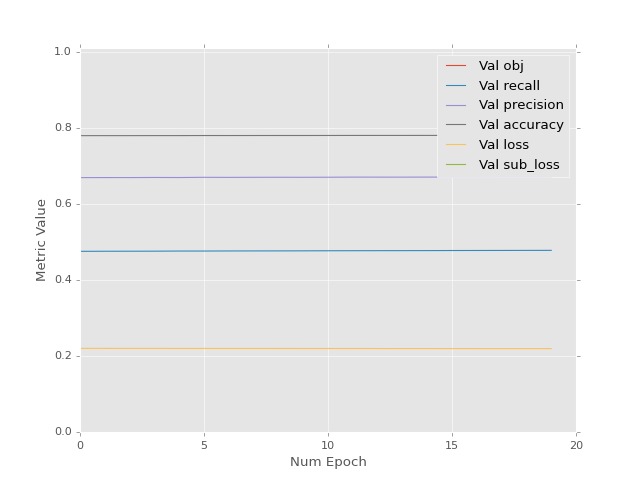

<IPython.core.display.Javascript object>


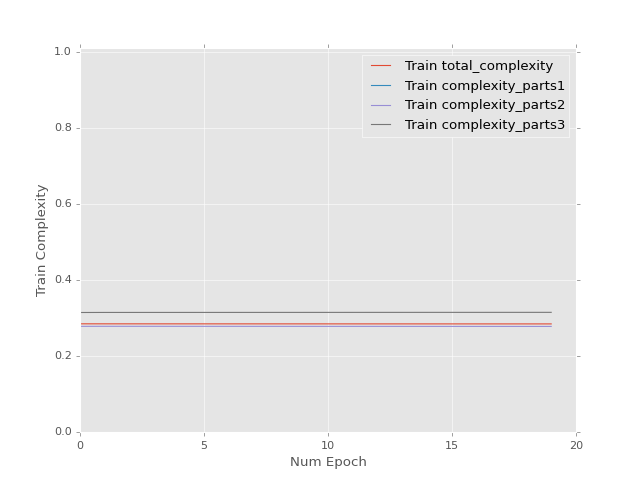

<IPython.core.display.Javascript object>


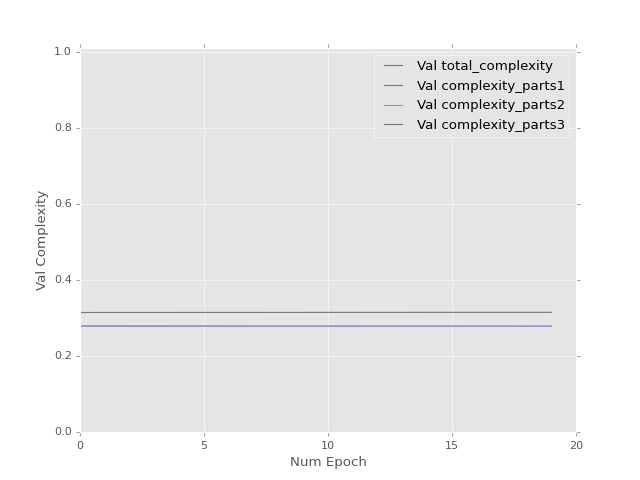

Epoch 1 of 20 took 5.901s
Epoch 2 of 20 took 5.896s
Epoch 3 of 20 took 5.692s
Epoch 4 of 20 took 6.014s
Epoch 5 of 20 took 6.029s
Epoch 6 of 20 took 5.954s
Epoch 7 of 20 took 5.923s
Epoch 8 of 20 took 5.957s
Epoch 9 of 20 took 6.034s
Epoch 10 of 20 took 5.711s
Epoch 11 of 20 took 5.834s
Epoch 12 of 20 took 5.990s
Epoch 13 of 20 took 5.878s
Epoch 14 of 20 took 5.929s
Epoch 15 of 20 took 5.970s
Epoch 16 of 20 took 5.973s
Epoch 17 of 20 took 5.586s
Epoch 18 of 20 took 5.990s
Epoch 19 of 20 took 5.888s
Epoch 20 of 20 took 5.872s
0.699950188398 [[ 1.17865109  0.3856943   0.53435624  1.22325778  0.46706045  0.65952104]]


<IPython.core.display.Javascript object>


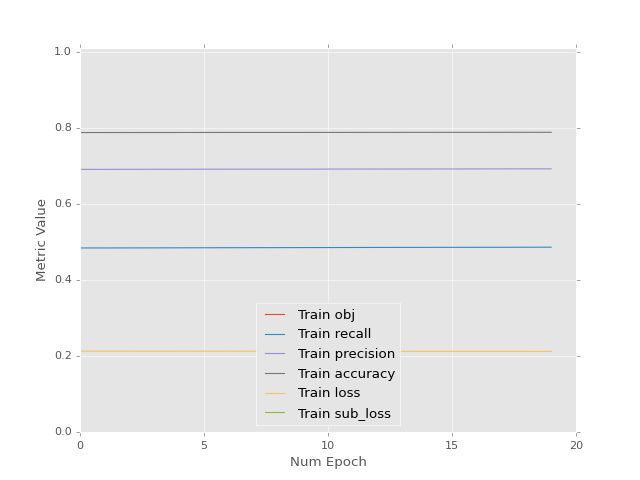

<IPython.core.display.Javascript object>


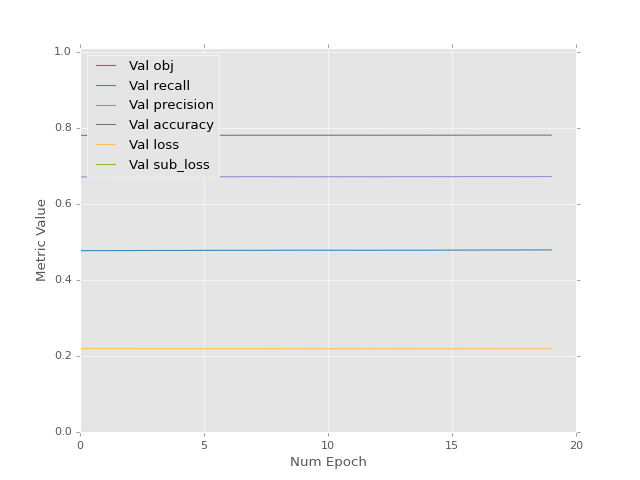

<IPython.core.display.Javascript object>


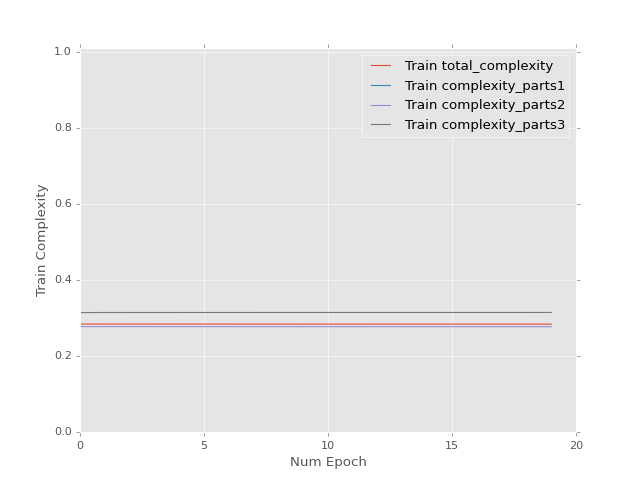

<IPython.core.display.Javascript object>


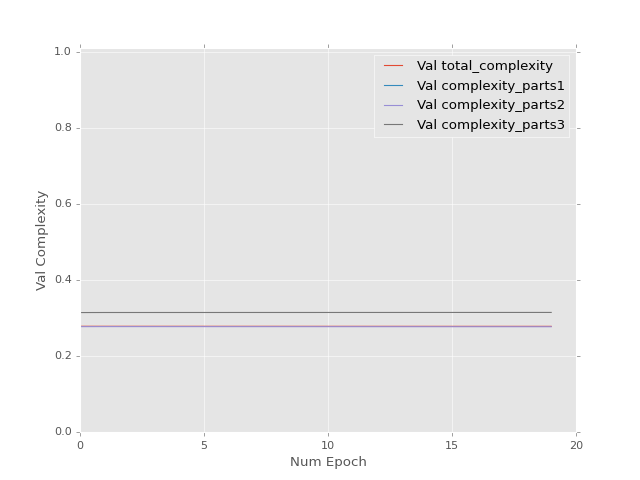

Epoch 1 of 20 took 5.439s
Epoch 2 of 20 took 5.835s
Epoch 3 of 20 took 5.834s
Epoch 4 of 20 took 5.928s
Epoch 5 of 20 took 5.940s
Epoch 6 of 20 took 5.926s
Epoch 7 of 20 took 5.941s
Epoch 8 of 20 took 5.998s
Epoch 9 of 20 took 5.833s
Epoch 10 of 20 took 5.745s
Epoch 11 of 20 took 5.774s
Epoch 12 of 20 took 5.914s
Epoch 13 of 20 took 5.745s
Epoch 14 of 20 took 5.868s
Epoch 15 of 20 took 5.945s
Epoch 16 of 20 took 5.800s
Epoch 17 of 20 took 5.847s
Epoch 18 of 20 took 5.881s
Epoch 19 of 20 took 5.647s
Epoch 20 of 20 took 5.885s
0.69893604517 [[ 1.18008554  0.38723373  0.53670353  1.22441888  0.468095    0.65861249]]


<IPython.core.display.Javascript object>


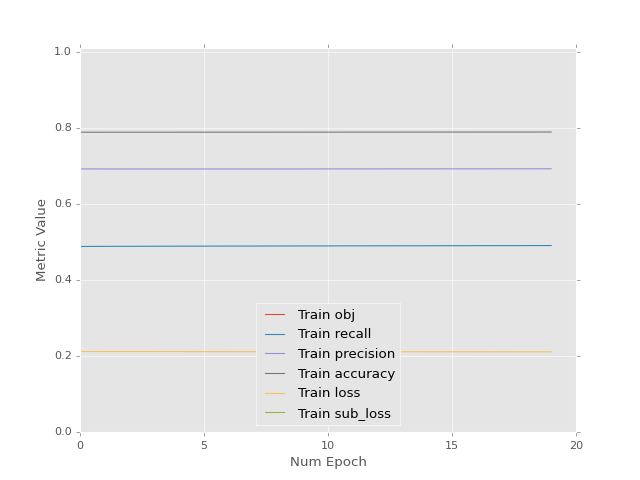

<IPython.core.display.Javascript object>


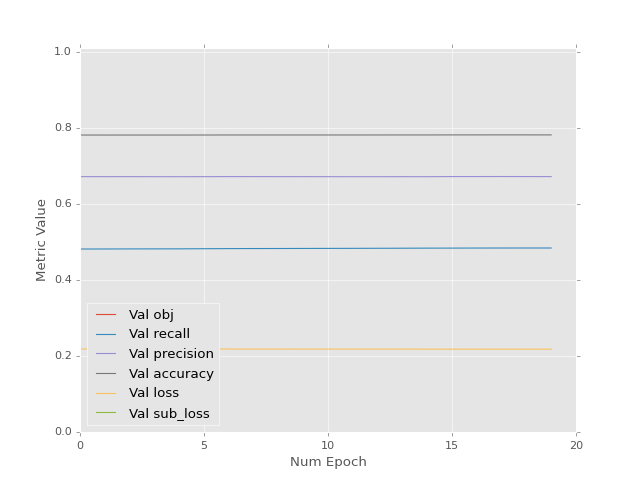

<IPython.core.display.Javascript object>


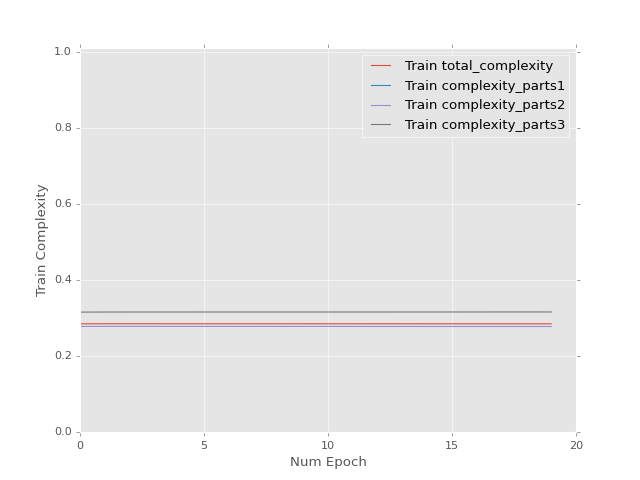

<IPython.core.display.Javascript object>


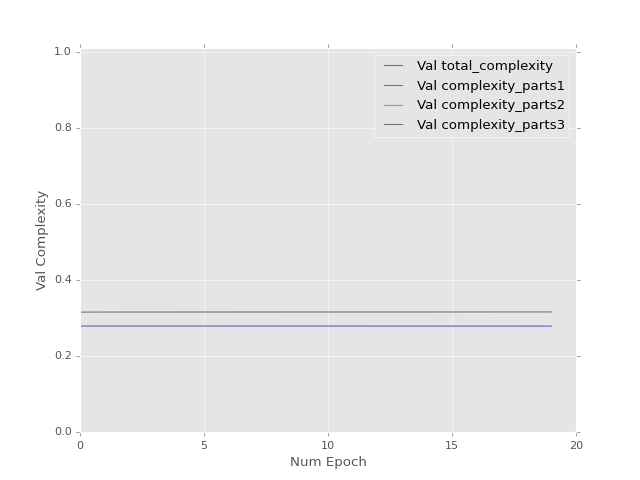

Epoch 1 of 20 took 5.955s
Epoch 2 of 20 took 5.934s
Epoch 3 of 20 took 5.888s
Epoch 4 of 20 took 5.865s
Epoch 5 of 20 took 5.642s
Epoch 6 of 20 took 5.845s
Epoch 7 of 20 took 5.900s
Epoch 8 of 20 took 5.806s
Epoch 9 of 20 took 5.722s
Epoch 10 of 20 took 5.938s
Epoch 11 of 20 took 5.870s
Epoch 12 of 20 took 5.723s
Epoch 13 of 20 took 5.951s
Epoch 14 of 20 took 5.863s
Epoch 15 of 20 took 5.912s
Epoch 16 of 20 took 5.846s
Epoch 17 of 20 took 5.978s
Epoch 18 of 20 took 5.755s
Epoch 19 of 20 took 5.916s
Epoch 20 of 20 took 5.886s
0.701526582241 [[ 1.17667592  0.38390717  0.53401208  1.22079551  0.46437082  0.66244292]]


<IPython.core.display.Javascript object>


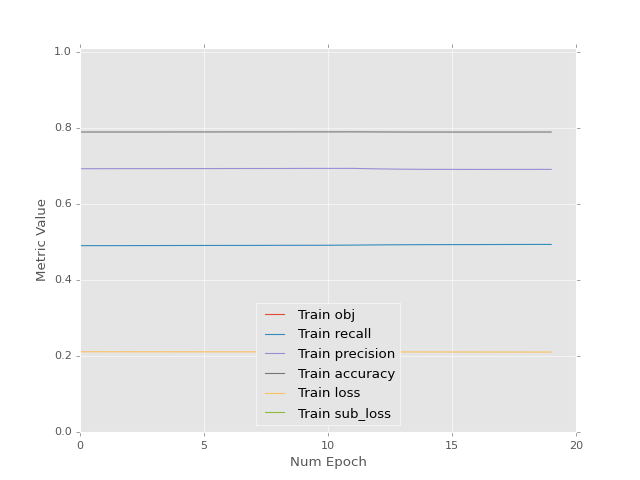

<IPython.core.display.Javascript object>


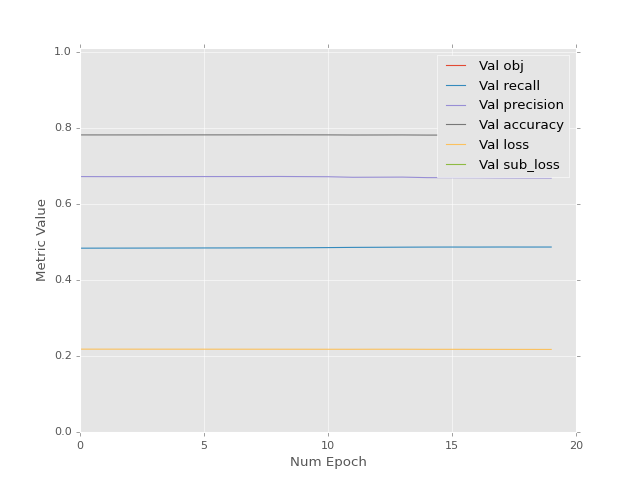

<IPython.core.display.Javascript object>


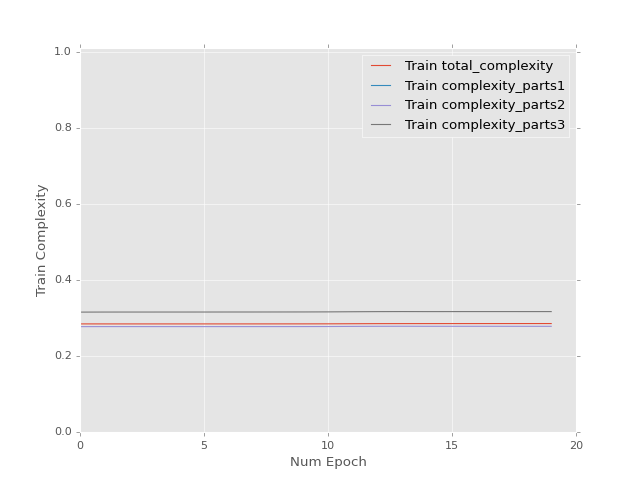

<IPython.core.display.Javascript object>


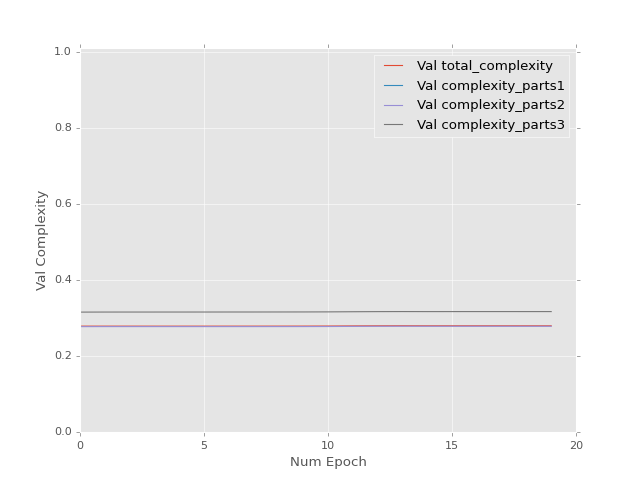

Epoch 1 of 20 took 5.644s
Epoch 2 of 20 took 5.702s
Epoch 3 of 20 took 6.166s
Epoch 4 of 20 took 5.727s
Epoch 5 of 20 took 5.761s
Epoch 6 of 20 took 5.768s
Epoch 7 of 20 took 5.907s
Epoch 8 of 20 took 5.871s
Epoch 9 of 20 took 6.004s
Epoch 10 of 20 took 5.954s
Epoch 11 of 20 took 5.806s
Epoch 12 of 20 took 5.909s
Epoch 13 of 20 took 5.885s
Epoch 14 of 20 took 5.523s
Epoch 15 of 20 took 5.639s
Epoch 16 of 20 took 5.600s
Epoch 17 of 20 took 5.591s
Epoch 18 of 20 took 5.447s
Epoch 19 of 20 took 5.830s
Epoch 20 of 20 took 5.842s
0.700885593891 [[ 1.177562    0.38485897  0.53546637  1.22151363  0.46501064  0.66188127]]


<IPython.core.display.Javascript object>


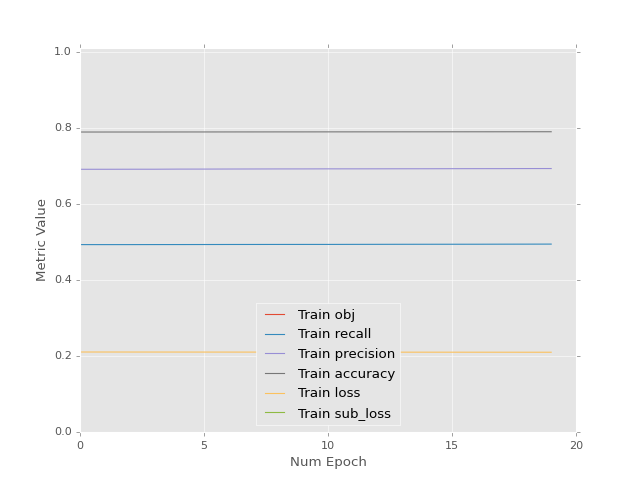

<IPython.core.display.Javascript object>


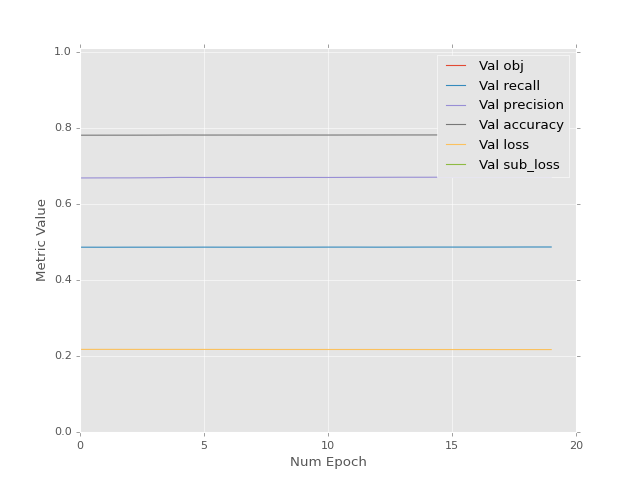

<IPython.core.display.Javascript object>


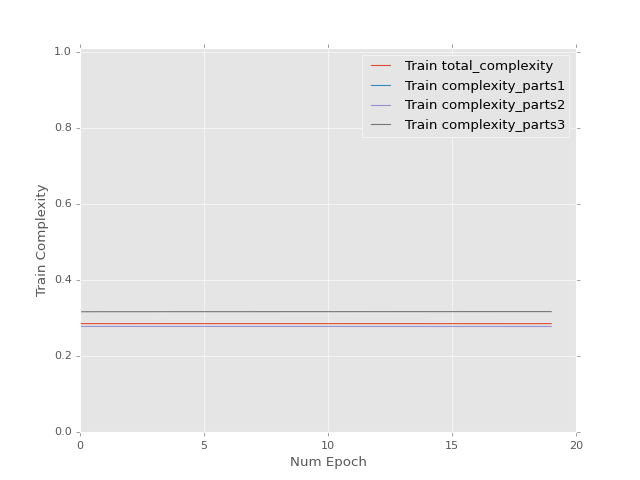

<IPython.core.display.Javascript object>


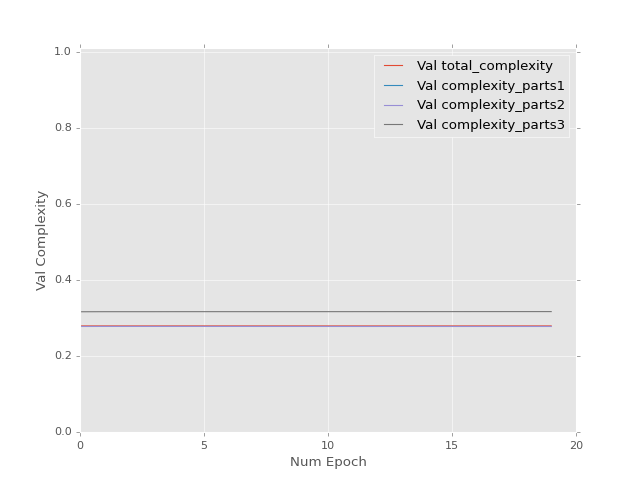

Epoch 1 of 20 took 5.613s
Epoch 2 of 20 took 5.768s
Epoch 3 of 20 took 5.656s
Epoch 4 of 20 took 5.688s
Epoch 5 of 20 took 5.439s
Epoch 6 of 20 took 5.452s
Epoch 7 of 20 took 6.057s
Epoch 8 of 20 took 5.948s
Epoch 9 of 20 took 5.881s
Epoch 10 of 20 took 5.705s
Epoch 11 of 20 took 5.827s
Epoch 12 of 20 took 6.060s
Epoch 13 of 20 took 5.449s
Epoch 14 of 20 took 5.785s
Epoch 15 of 20 took 5.754s
Epoch 16 of 20 took 5.517s
Epoch 17 of 20 took 5.449s
Epoch 18 of 20 took 6.013s
Epoch 19 of 20 took 5.953s
Epoch 20 of 20 took 5.824s
0.700147330761 [[ 1.17859352  0.38596651  0.53715211  1.22235012  0.46575612  0.66122717]]


<IPython.core.display.Javascript object>


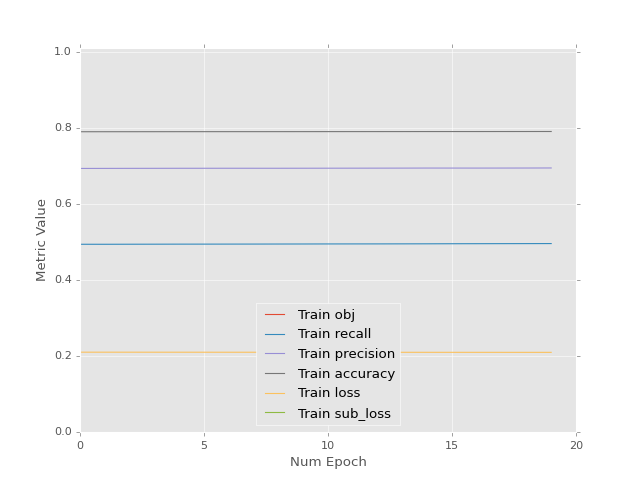

<IPython.core.display.Javascript object>


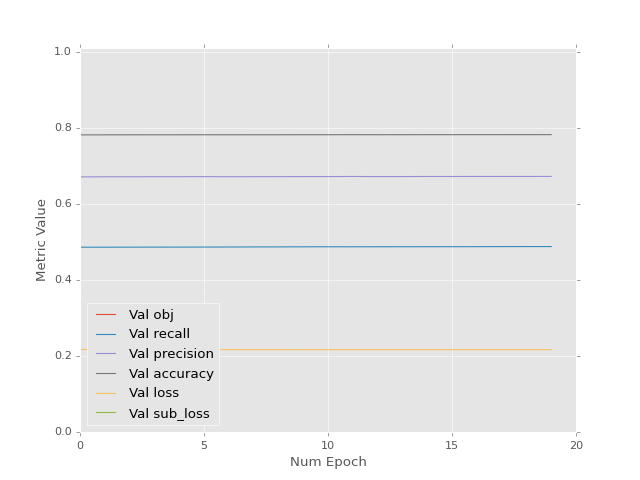

<IPython.core.display.Javascript object>


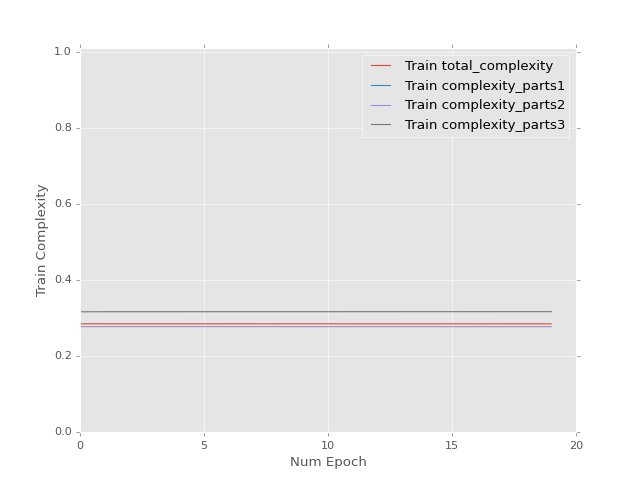

<IPython.core.display.Javascript object>


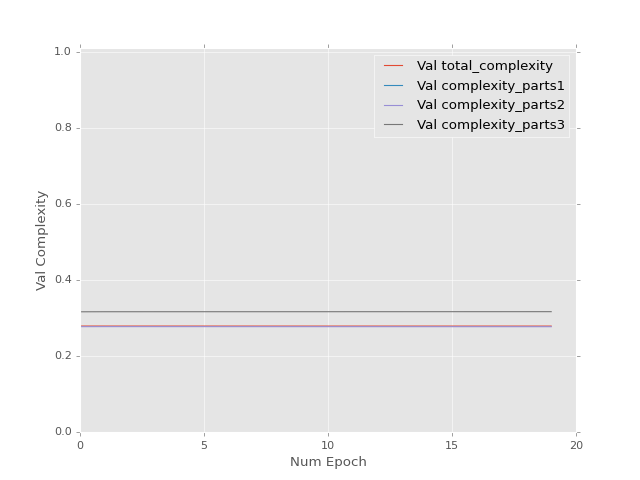

Epoch 1 of 20 took 5.738s
Epoch 2 of 20 took 5.711s
Epoch 3 of 20 took 5.870s
Epoch 4 of 20 took 5.687s
Epoch 5 of 20 took 5.820s
Epoch 6 of 20 took 5.451s
Epoch 7 of 20 took 5.779s
Epoch 8 of 20 took 5.980s
Epoch 9 of 20 took 5.669s
Epoch 10 of 20 took 5.761s
Epoch 11 of 20 took 5.684s
Epoch 12 of 20 took 5.579s
Epoch 13 of 20 took 6.018s
Epoch 14 of 20 took 5.858s
Epoch 15 of 20 took 6.038s
Epoch 16 of 20 took 5.891s
Epoch 17 of 20 took 5.773s
Epoch 18 of 20 took 5.824s
Epoch 19 of 20 took 6.036s
Epoch 20 of 20 took 5.799s
0.699271410704 [[ 1.179829    0.38729268  0.5391618   1.22335267  0.46664992  0.66044331]]


<IPython.core.display.Javascript object>


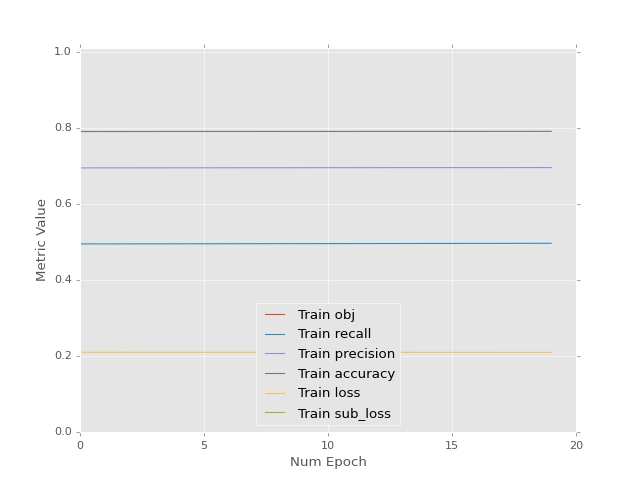

<IPython.core.display.Javascript object>


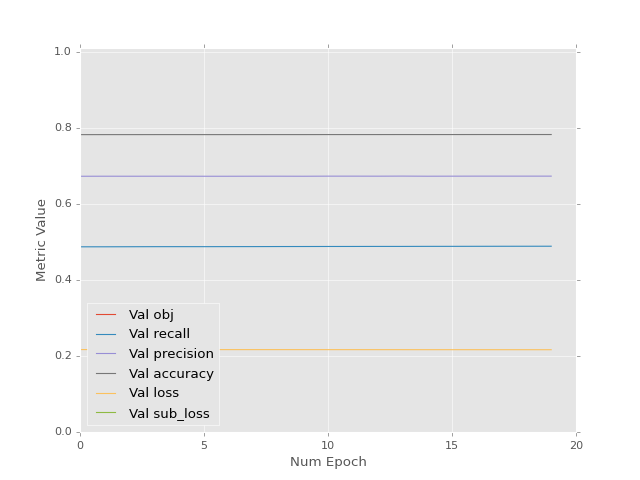

<IPython.core.display.Javascript object>


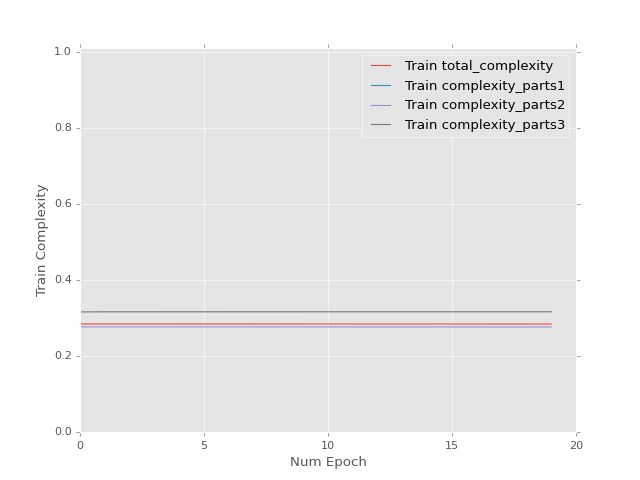

<IPython.core.display.Javascript object>


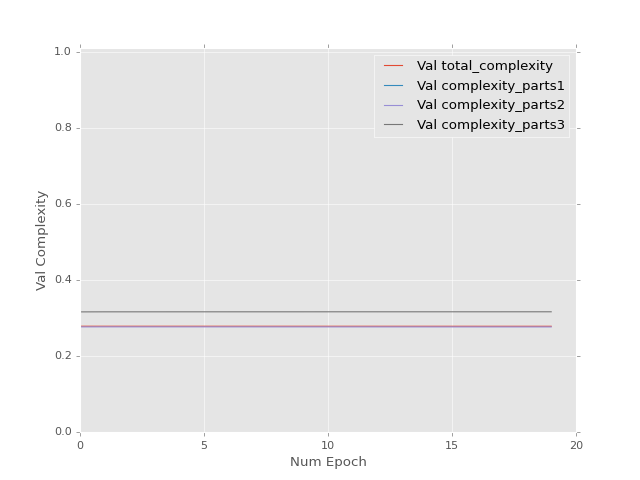

Epoch 1 of 20 took 6.104s
Epoch 2 of 20 took 5.674s
Epoch 3 of 20 took 5.768s
Epoch 4 of 20 took 5.513s
Epoch 5 of 20 took 5.573s
Epoch 6 of 20 took 5.989s
Epoch 7 of 20 took 5.926s
Epoch 8 of 20 took 5.965s
Epoch 9 of 20 took 6.004s
Epoch 10 of 20 took 5.821s
Epoch 11 of 20 took 5.723s
Epoch 12 of 20 took 5.436s
Epoch 13 of 20 took 5.447s
Epoch 14 of 20 took 5.899s
Epoch 15 of 20 took 5.959s
Epoch 16 of 20 took 5.871s
Epoch 17 of 20 took 6.079s
Epoch 18 of 20 took 5.624s
Epoch 19 of 20 took 5.744s
Epoch 20 of 20 took 5.570s
0.698207765818 [[ 1.18134248  0.38891676  0.54161078  1.22458196  0.46774596  0.65948254]]


<IPython.core.display.Javascript object>


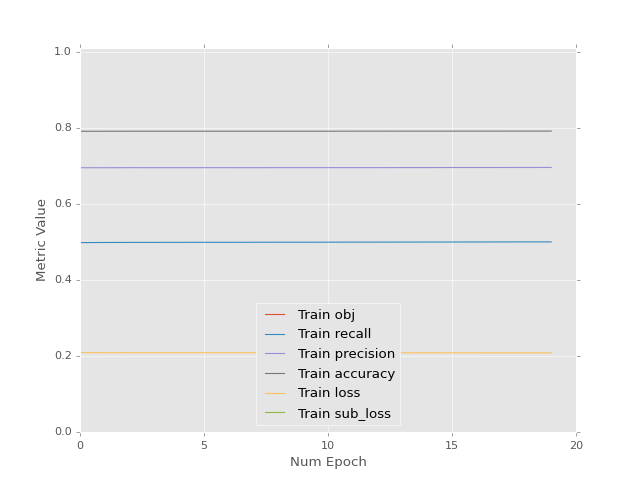

<IPython.core.display.Javascript object>


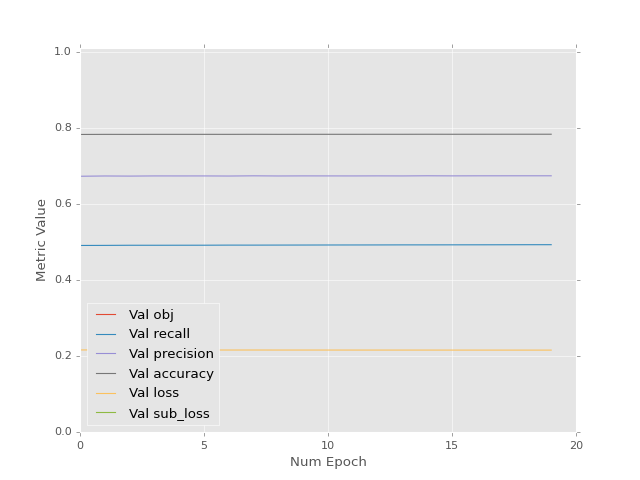

<IPython.core.display.Javascript object>


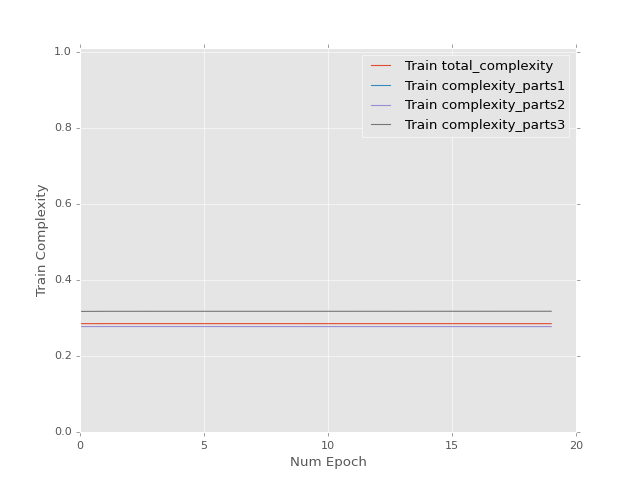

<IPython.core.display.Javascript object>


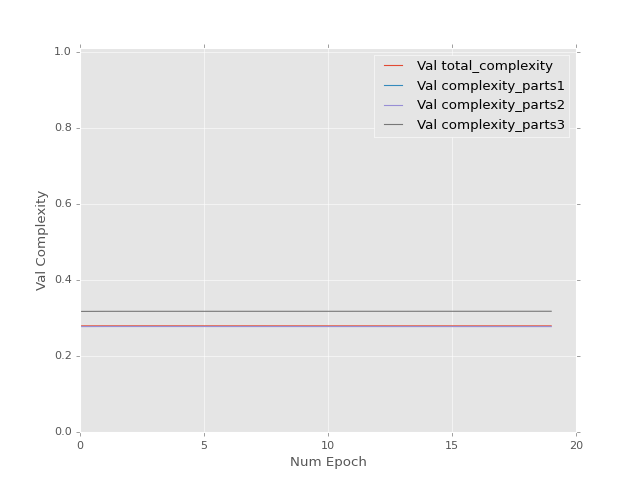

Epoch 1 of 20 took 5.624s
Epoch 2 of 20 took 5.755s
Epoch 3 of 20 took 5.499s
Epoch 4 of 20 took 5.625s
Epoch 5 of 20 took 5.899s
Epoch 6 of 20 took 5.681s
Epoch 7 of 20 took 6.208s
Epoch 8 of 20 took 5.716s
Epoch 9 of 20 took 5.615s
Epoch 10 of 20 took 6.130s
Epoch 11 of 20 took 5.774s
Epoch 12 of 20 took 5.471s
Epoch 13 of 20 took 6.028s
Epoch 14 of 20 took 6.020s
Epoch 15 of 20 took 5.908s
Epoch 16 of 20 took 5.735s
Epoch 17 of 20 took 5.606s
Epoch 18 of 20 took 5.801s
Epoch 19 of 20 took 5.618s
Epoch 20 of 20 took 5.719s
0.701067954302 [[ 1.17753768  0.3851622   0.53821313  1.22065198  0.46375519  0.66353446]]


<IPython.core.display.Javascript object>


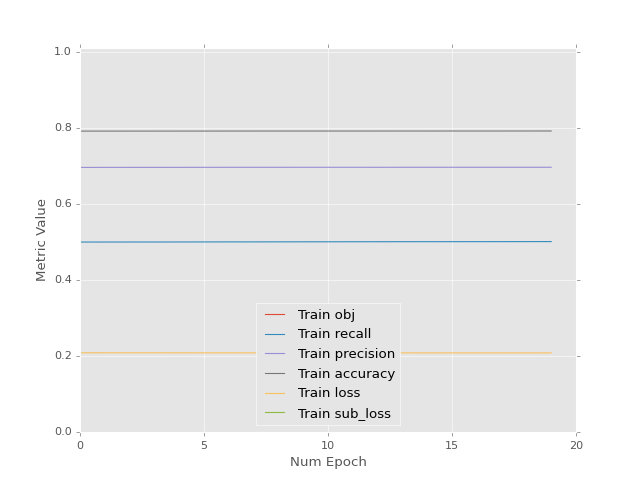

<IPython.core.display.Javascript object>


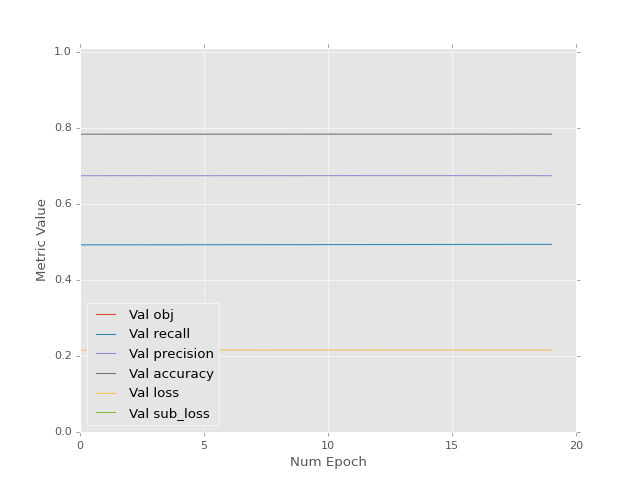

<IPython.core.display.Javascript object>


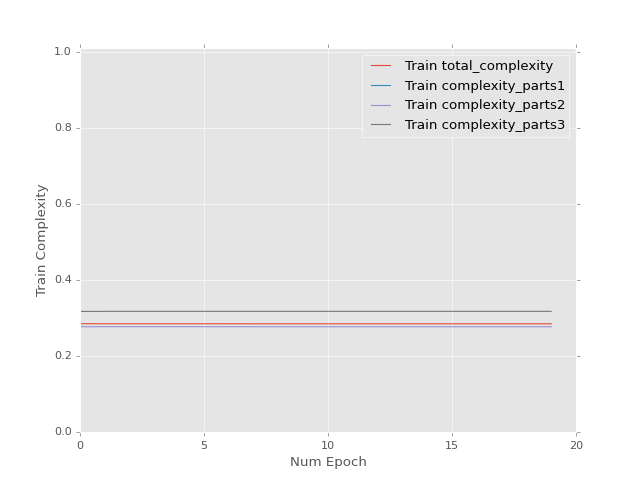

<IPython.core.display.Javascript object>


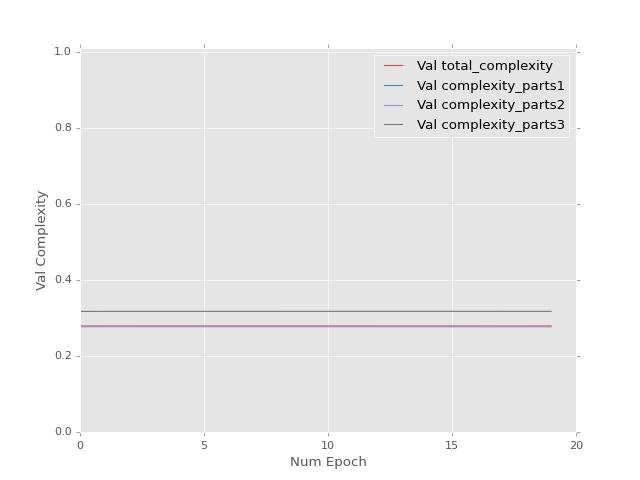

Epoch 1 of 20 took 5.788s
Epoch 2 of 20 took 5.665s
Epoch 3 of 20 took 5.806s
Epoch 4 of 20 took 5.467s
Epoch 5 of 20 took 5.495s
Epoch 6 of 20 took 5.443s
Epoch 7 of 20 took 5.887s
Epoch 8 of 20 took 5.485s
Epoch 9 of 20 took 5.745s
Epoch 10 of 20 took 5.657s
Epoch 11 of 20 took 5.679s
Epoch 12 of 20 took 5.638s
Epoch 13 of 20 took 6.018s
Epoch 14 of 20 took 5.904s
Epoch 15 of 20 took 5.821s
Epoch 16 of 20 took 5.838s
Epoch 17 of 20 took 5.517s
Epoch 18 of 20 took 5.595s
Epoch 19 of 20 took 6.053s
Epoch 20 of 20 took 5.548s
0.700387120247 [[ 1.17848587  0.38618103  0.53975075  1.22142255  0.46444154  0.66293275]]


<IPython.core.display.Javascript object>


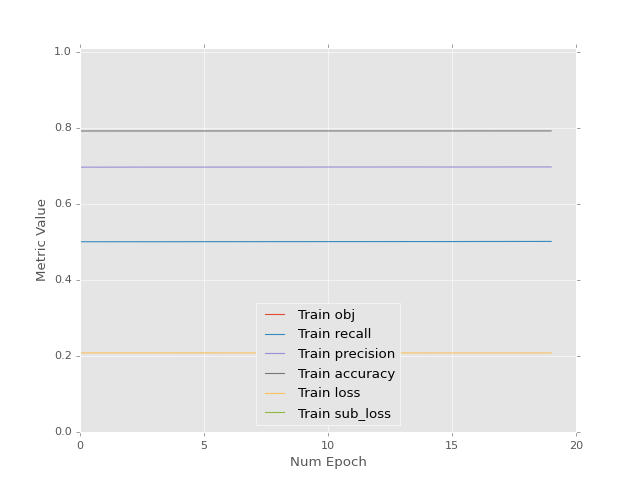

<IPython.core.display.Javascript object>


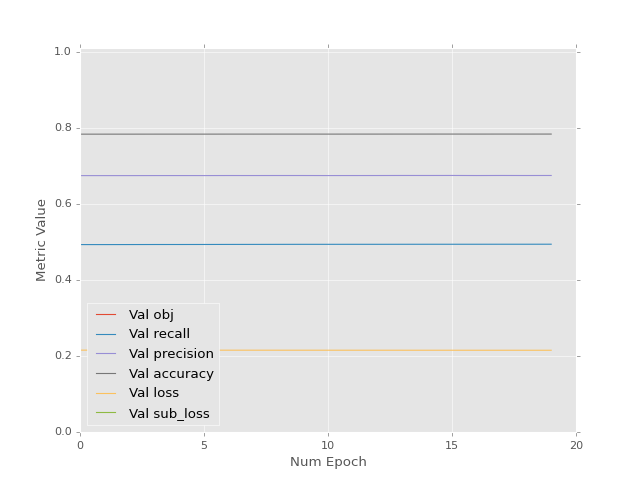

<IPython.core.display.Javascript object>


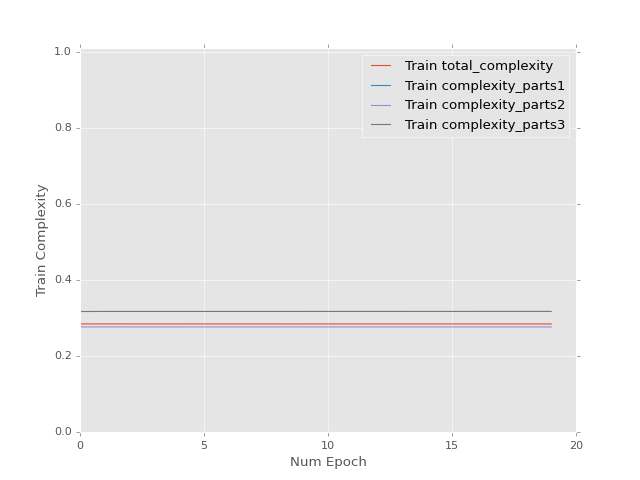

<IPython.core.display.Javascript object>


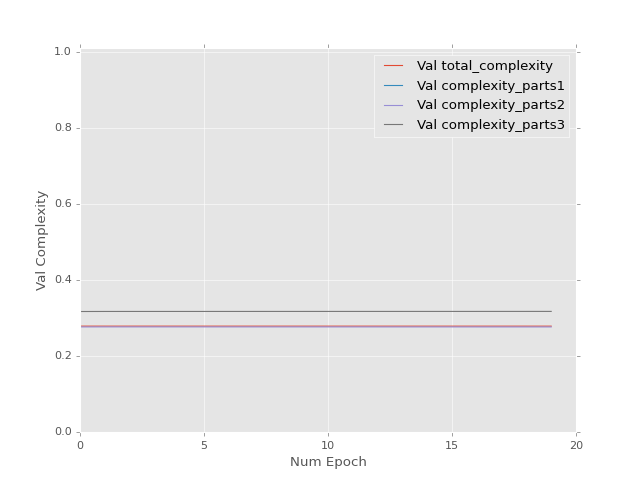

Epoch 1 of 20 took 5.483s
Epoch 2 of 20 took 5.496s
Epoch 3 of 20 took 5.910s
Epoch 4 of 20 took 5.747s
Epoch 5 of 20 took 5.834s
Epoch 6 of 20 took 5.656s
Epoch 7 of 20 took 5.866s
Epoch 8 of 20 took 5.883s
Epoch 9 of 20 took 5.952s
Epoch 10 of 20 took 5.706s
Epoch 11 of 20 took 5.446s
Epoch 12 of 20 took 5.976s
Epoch 13 of 20 took 5.929s
Epoch 14 of 20 took 5.808s
Epoch 15 of 20 took 5.489s
Epoch 16 of 20 took 5.793s
Epoch 17 of 20 took 5.786s
Epoch 18 of 20 took 5.906s
Epoch 19 of 20 took 5.907s
Epoch 20 of 20 took 6.007s
0.69958460331 [[ 1.17961454  0.3873933   0.54157341  1.22233975  0.46525875  0.6622166 ]]


<IPython.core.display.Javascript object>


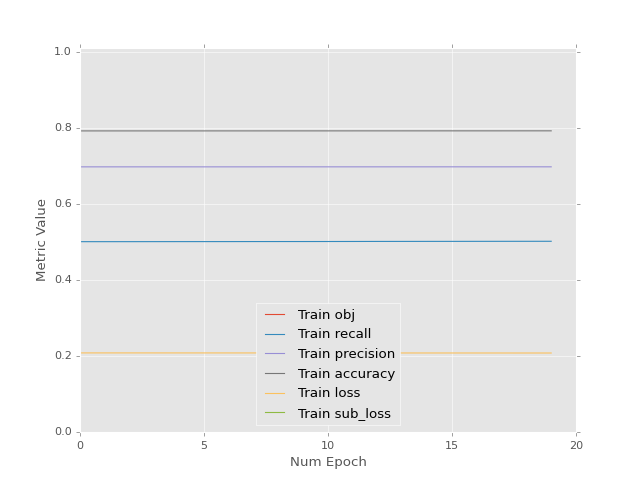

<IPython.core.display.Javascript object>


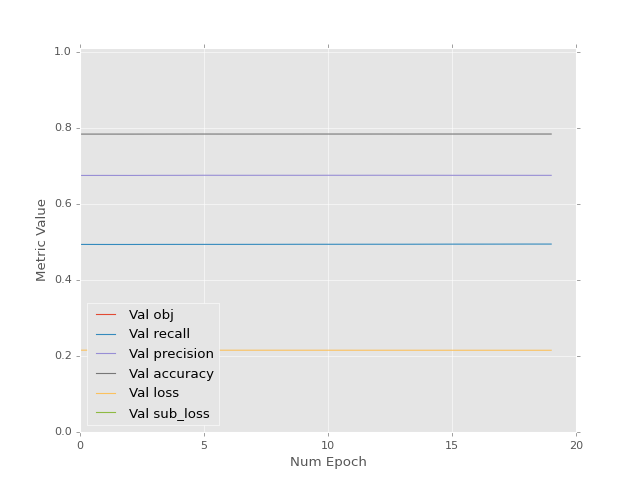

<IPython.core.display.Javascript object>


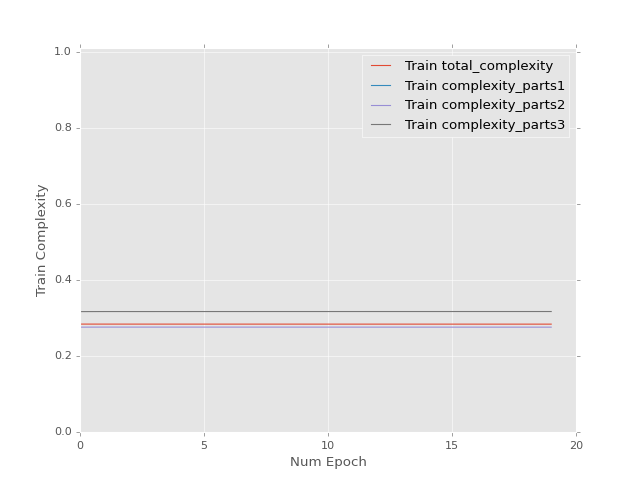

<IPython.core.display.Javascript object>


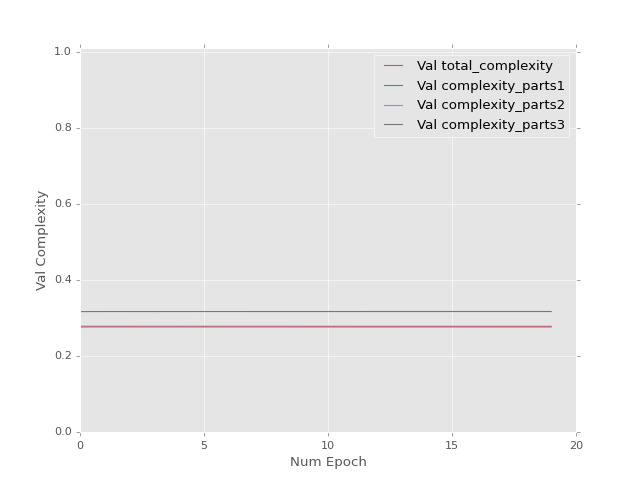

Epoch 1 of 20 took 5.634s
Epoch 2 of 20 took 5.437s
Epoch 3 of 20 took 6.114s
Epoch 4 of 20 took 5.702s
Epoch 5 of 20 took 5.652s
Epoch 6 of 20 took 5.718s
Epoch 7 of 20 took 5.910s
Epoch 8 of 20 took 5.824s
Epoch 9 of 20 took 5.869s
Epoch 10 of 20 took 5.974s
Epoch 11 of 20 took 5.901s
Epoch 12 of 20 took 5.695s
Epoch 13 of 20 took 5.832s
Epoch 14 of 20 took 5.647s
Epoch 15 of 20 took 5.807s
Epoch 16 of 20 took 5.842s
Epoch 17 of 20 took 6.042s
Epoch 18 of 20 took 5.971s
Epoch 19 of 20 took 5.708s
Epoch 20 of 20 took 5.731s
0.698614746332 [[ 1.18099093  0.3888711   0.54378575  1.22345853  0.46625575  0.66134322]]


<IPython.core.display.Javascript object>


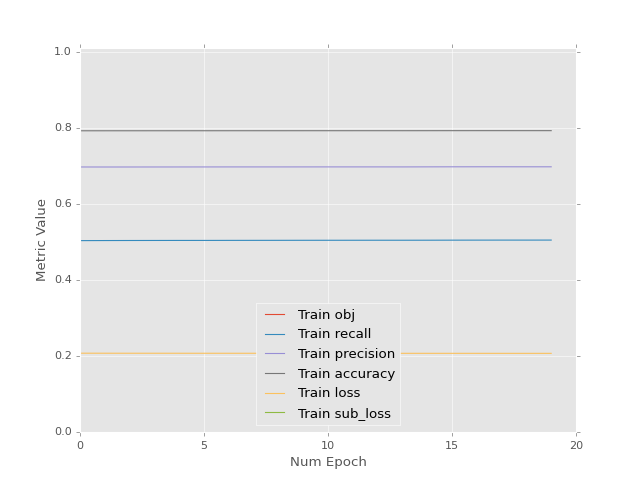

<IPython.core.display.Javascript object>


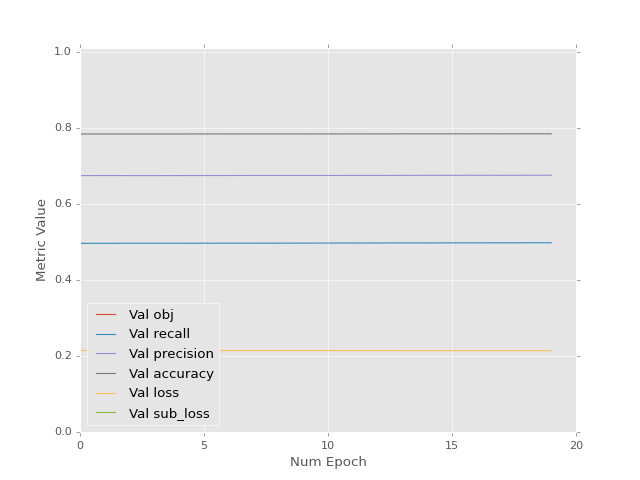

<IPython.core.display.Javascript object>


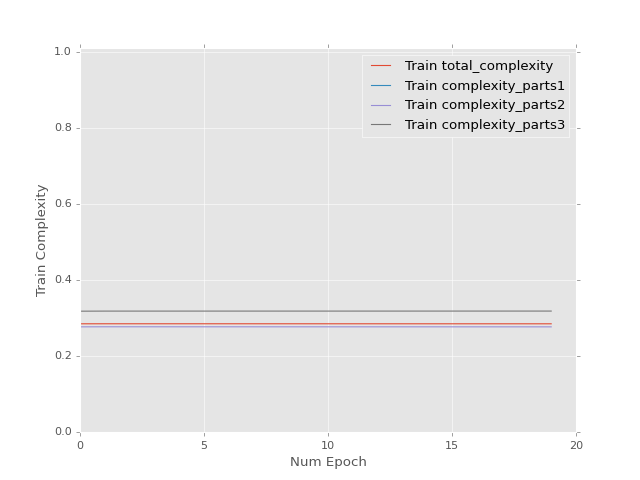

<IPython.core.display.Javascript object>


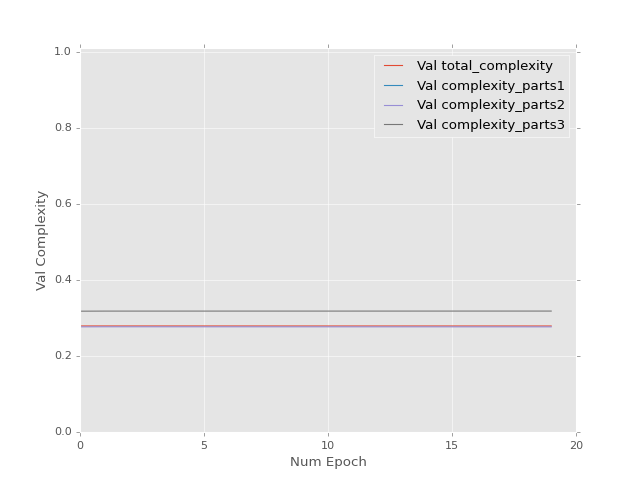

Epoch 1 of 20 took 5.786s
Epoch 2 of 20 took 5.731s
Epoch 3 of 20 took 5.978s
Epoch 4 of 20 took 5.627s
Epoch 5 of 20 took 5.741s
Epoch 6 of 20 took 5.619s
Epoch 7 of 20 took 5.932s
Epoch 8 of 20 took 5.824s
Epoch 9 of 20 took 5.822s
Epoch 10 of 20 took 5.949s
Epoch 11 of 20 took 5.644s
Epoch 12 of 20 took 5.889s
Epoch 13 of 20 took 5.608s
Epoch 14 of 20 took 5.795s
Epoch 15 of 20 took 5.905s
Epoch 16 of 20 took 5.850s
Epoch 17 of 20 took 5.817s
Epoch 18 of 20 took 5.630s
Epoch 19 of 20 took 5.661s
Epoch 20 of 20 took 5.666s
0.701318204403 [[ 1.1774224   0.38536915  0.54074687  1.21972299  0.46243948  0.66524059]]


<IPython.core.display.Javascript object>


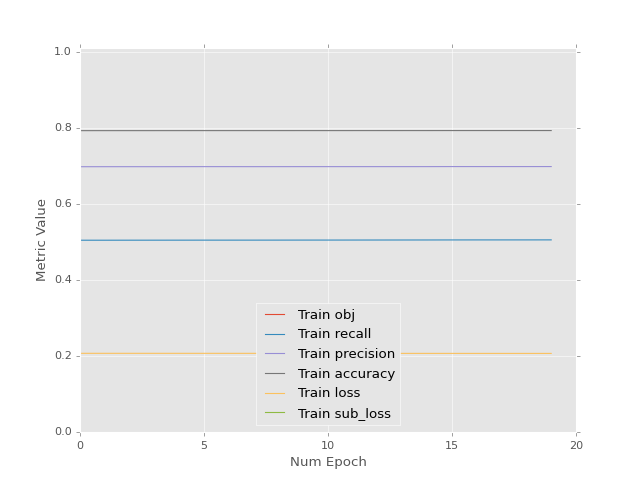

<IPython.core.display.Javascript object>


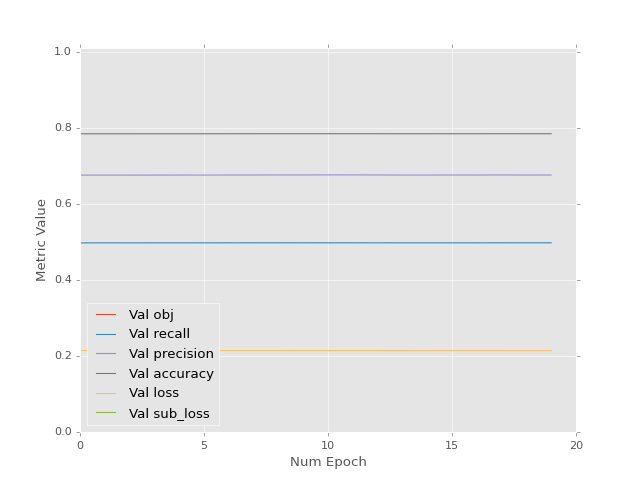

<IPython.core.display.Javascript object>


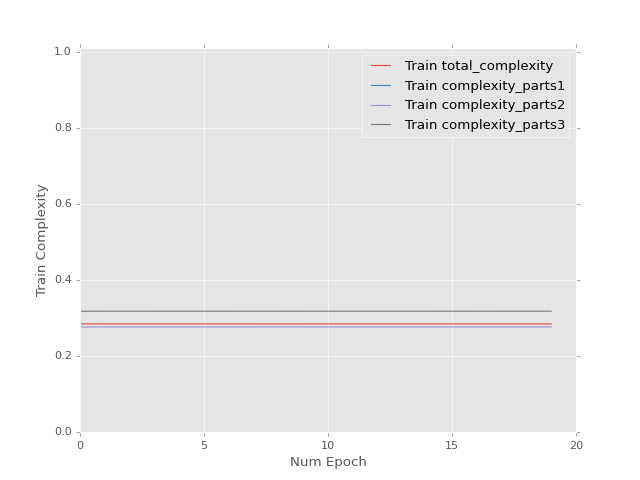

<IPython.core.display.Javascript object>


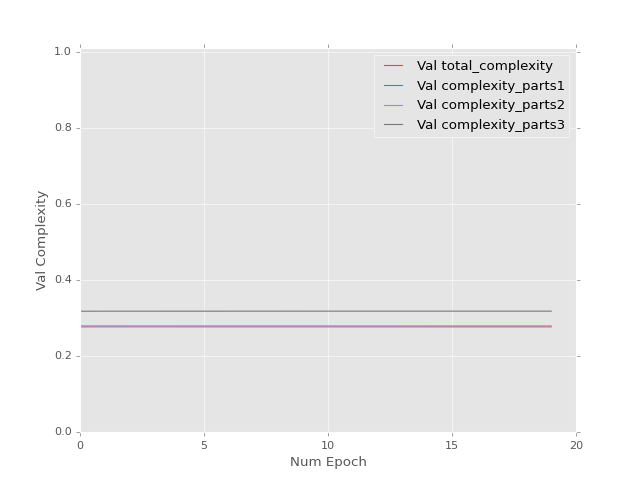

Epoch 1 of 20 took 5.692s
Epoch 2 of 20 took 5.799s
Epoch 3 of 20 took 5.902s
Epoch 4 of 20 took 5.829s
Epoch 5 of 20 took 5.524s
Epoch 6 of 20 took 5.986s
Epoch 7 of 20 took 5.438s
Epoch 8 of 20 took 5.592s
Epoch 9 of 20 took 5.996s
Epoch 10 of 20 took 5.521s
Epoch 11 of 20 took 5.717s
Epoch 12 of 20 took 5.757s
Epoch 13 of 20 took 6.120s
Epoch 14 of 20 took 5.677s
Epoch 15 of 20 took 6.051s
Epoch 16 of 20 took 5.891s
Epoch 17 of 20 took 5.532s
Epoch 18 of 20 took 5.845s
Epoch 19 of 20 took 5.470s
Epoch 20 of 20 took 5.599s
0.700670868158 [[ 1.17832184  0.38633612  0.54219586  1.22045398  0.46309066  0.66467011]]


<IPython.core.display.Javascript object>


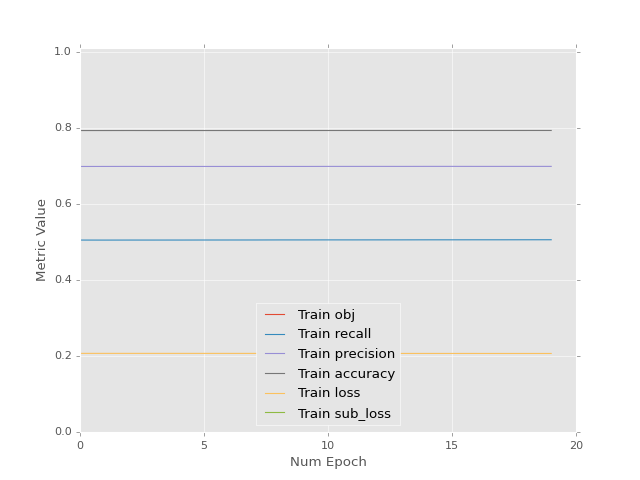

<IPython.core.display.Javascript object>


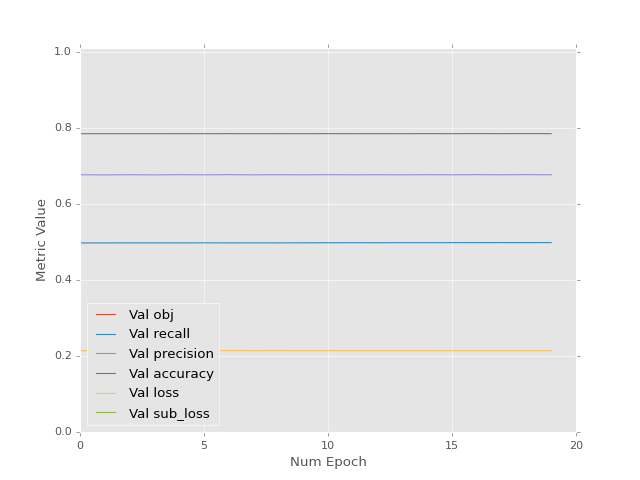

<IPython.core.display.Javascript object>


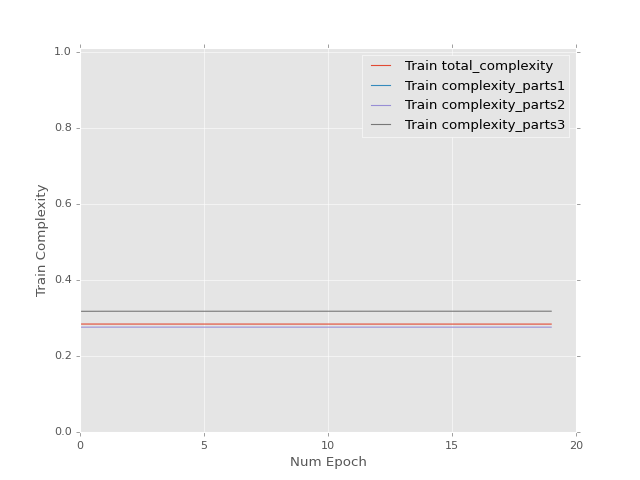

<IPython.core.display.Javascript object>


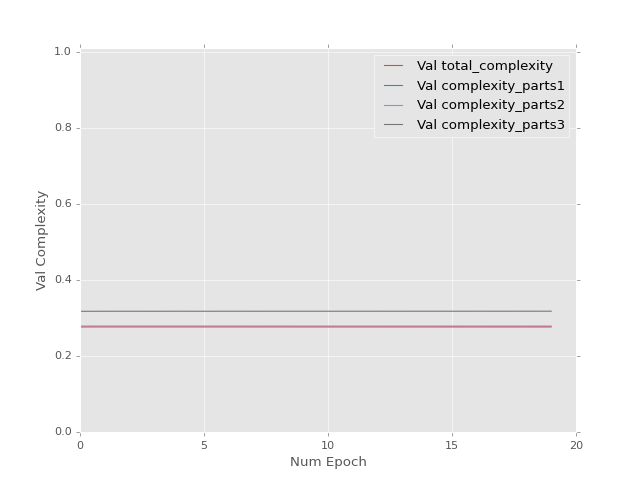

Epoch 1 of 20 took 5.881s
Epoch 2 of 20 took 6.096s
Epoch 3 of 20 took 5.674s
Epoch 4 of 20 took 5.871s
Epoch 5 of 20 took 6.061s
Epoch 6 of 20 took 5.957s
Epoch 7 of 20 took 5.678s
Epoch 8 of 20 took 5.621s
Epoch 9 of 20 took 5.839s
Epoch 10 of 20 took 5.841s
Epoch 11 of 20 took 6.118s
Epoch 12 of 20 took 5.977s
Epoch 13 of 20 took 5.860s
Epoch 14 of 20 took 5.917s
Epoch 15 of 20 took 6.011s
Epoch 16 of 20 took 5.751s
Epoch 17 of 20 took 5.909s
Epoch 18 of 20 took 5.721s
Epoch 19 of 20 took 5.821s
Epoch 20 of 20 took 5.808s
0.69991388917 [[ 1.17938387  0.38747796  0.54390091  1.22131777  0.46385986  0.66399658]]


<IPython.core.display.Javascript object>


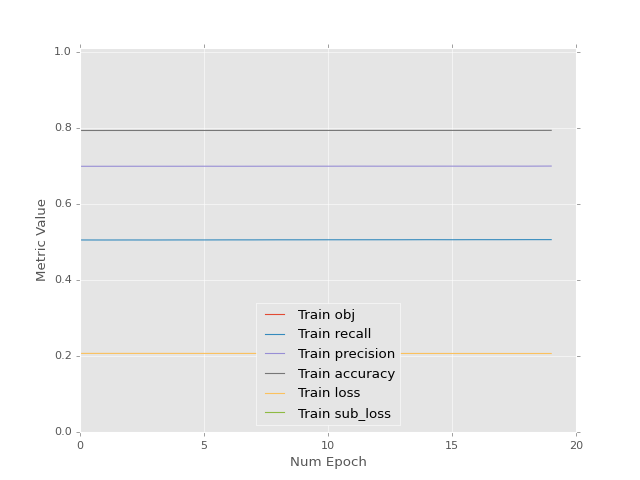

<IPython.core.display.Javascript object>


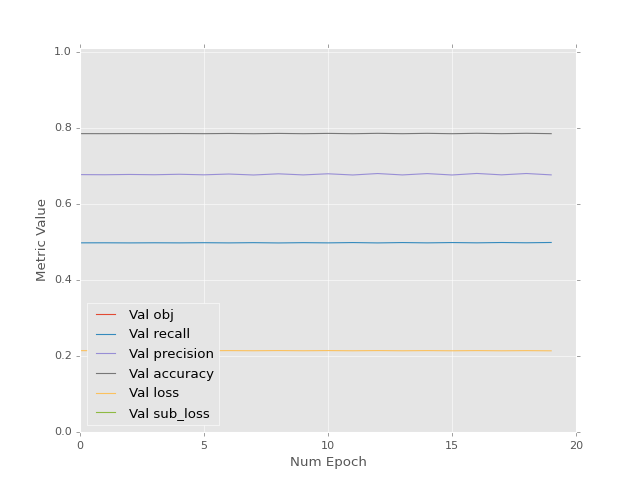

<IPython.core.display.Javascript object>


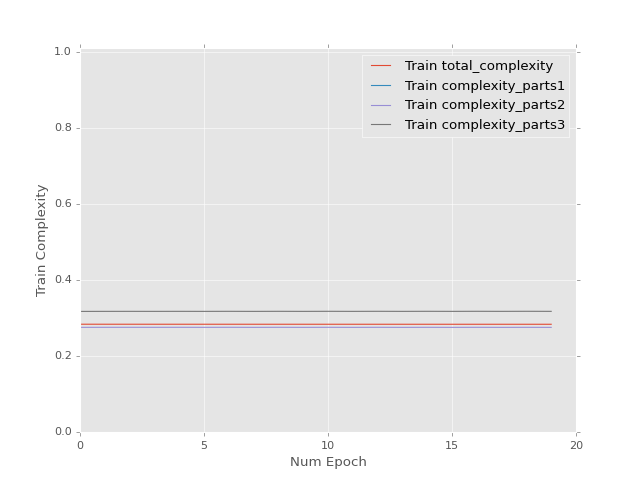

<IPython.core.display.Javascript object>


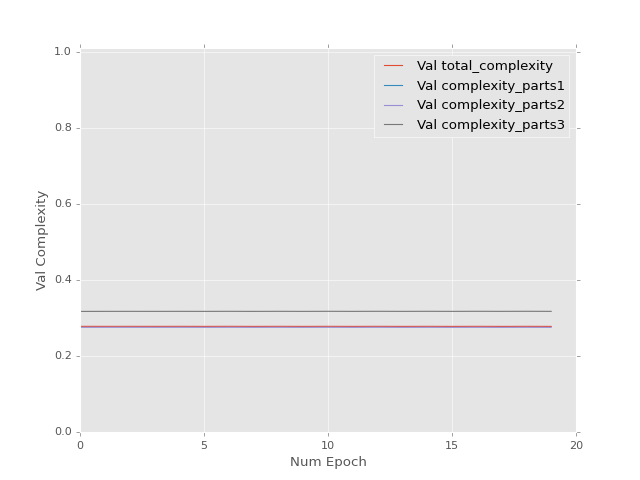

Epoch 1 of 20 took 5.608s
Epoch 2 of 20 took 5.820s
Epoch 3 of 20 took 5.621s
Epoch 4 of 20 took 5.805s
Epoch 5 of 20 took 5.810s
Epoch 6 of 20 took 5.656s
Epoch 7 of 20 took 5.647s
Epoch 8 of 20 took 5.918s
Epoch 9 of 20 took 5.721s
Epoch 10 of 20 took 5.734s
Epoch 11 of 20 took 5.645s
Epoch 12 of 20 took 5.723s
Epoch 13 of 20 took 5.432s
Epoch 14 of 20 took 5.763s
Epoch 15 of 20 took 5.935s
Epoch 16 of 20 took 5.506s
Epoch 17 of 20 took 5.631s
Epoch 18 of 20 took 5.853s
Epoch 19 of 20 took 5.547s
Epoch 20 of 20 took 6.011s
0.699004620314 [[ 1.18067133  0.38886166  0.54595941  1.22236502  0.46479261  0.66318029]]


<IPython.core.display.Javascript object>


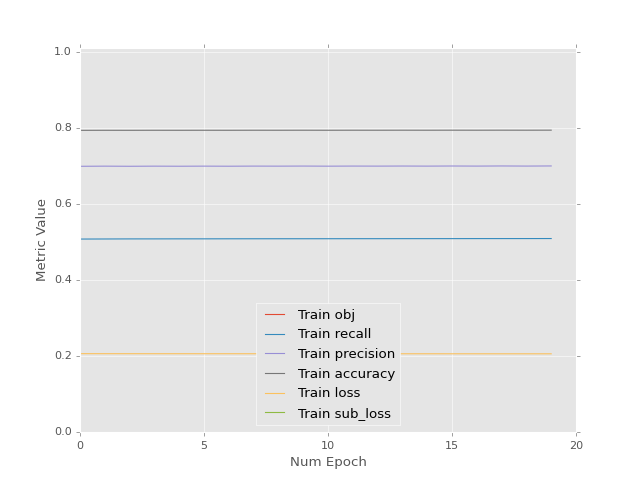

<IPython.core.display.Javascript object>


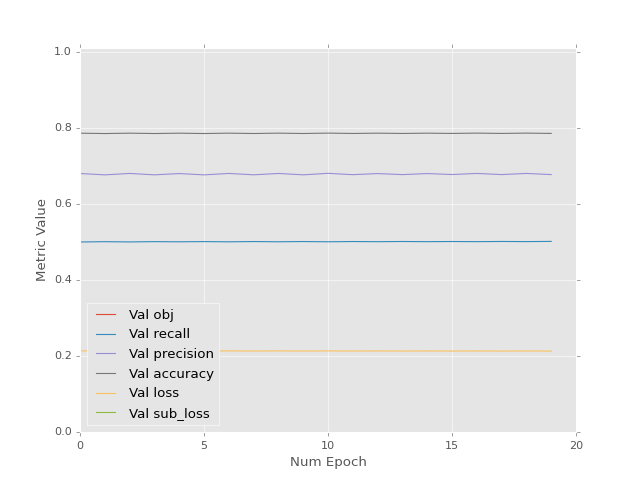

<IPython.core.display.Javascript object>


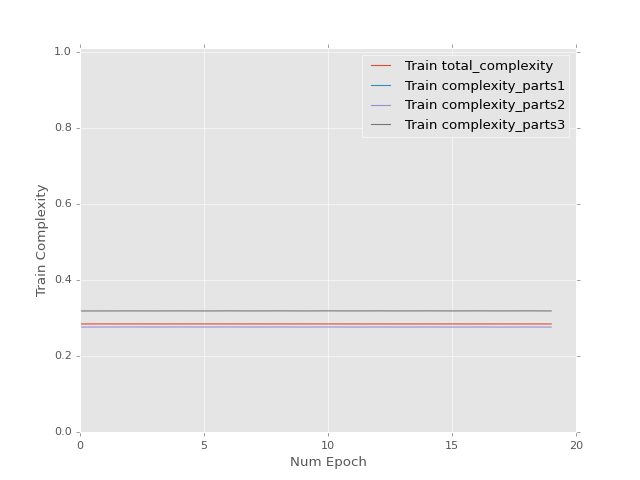

<IPython.core.display.Javascript object>


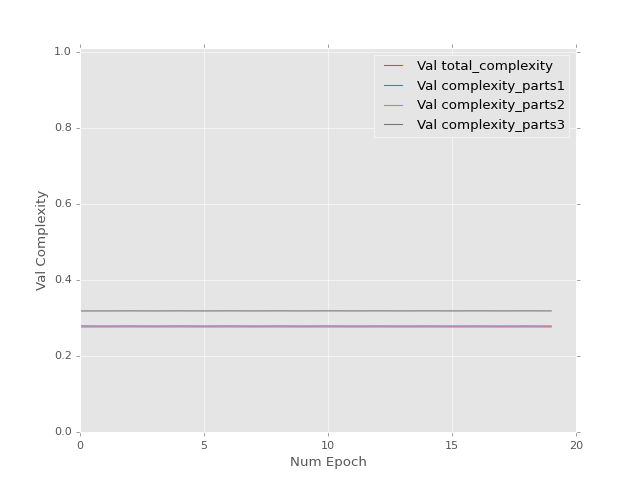

Epoch 1 of 20 took 5.752s
Epoch 2 of 20 took 5.851s
Epoch 3 of 20 took 5.695s
Epoch 4 of 20 took 5.812s
Epoch 5 of 20 took 5.862s
Epoch 6 of 20 took 5.873s
Epoch 7 of 20 took 5.897s
Epoch 8 of 20 took 5.793s
Epoch 9 of 20 took 5.744s
Epoch 10 of 20 took 5.991s
Epoch 11 of 20 took 5.797s
Epoch 12 of 20 took 5.651s
Epoch 13 of 20 took 6.016s
Epoch 14 of 20 took 5.975s
Epoch 15 of 20 took 5.729s
Epoch 16 of 20 took 5.647s
Epoch 17 of 20 took 5.997s
Epoch 18 of 20 took 5.664s
Epoch 19 of 20 took 5.661s
Epoch 20 of 20 took 5.727s
0.701514750719 [[ 1.17738569  0.38566366  0.54335588  1.21886098  0.46118265  0.66689724]]


<IPython.core.display.Javascript object>


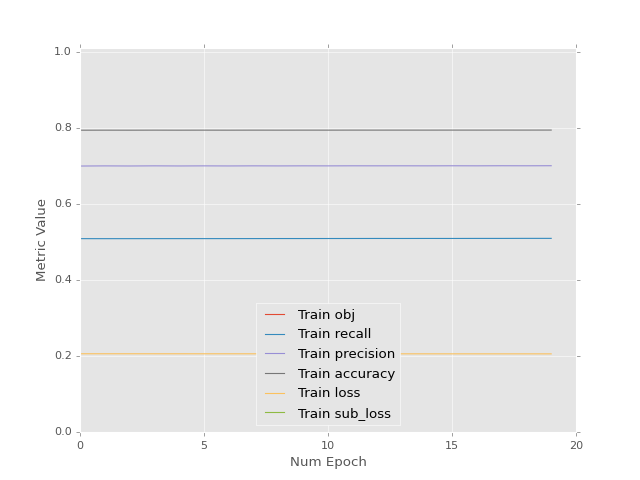

<IPython.core.display.Javascript object>


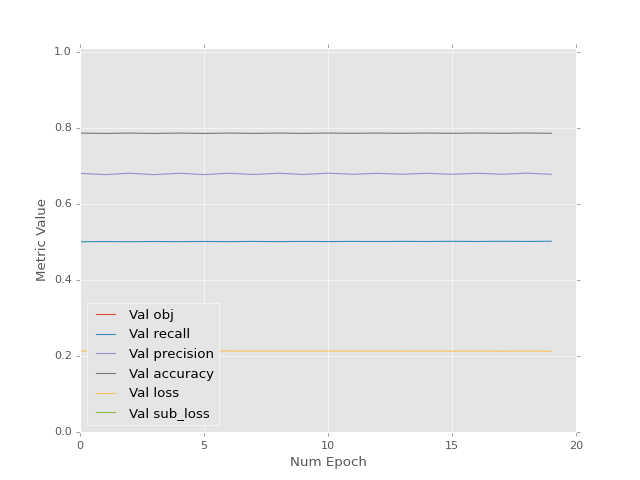

<IPython.core.display.Javascript object>


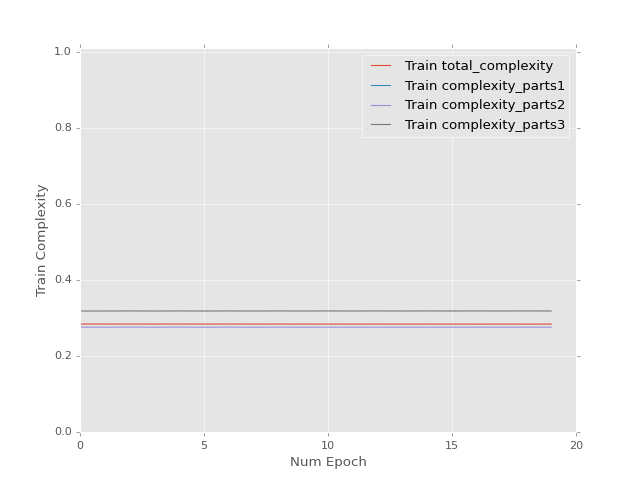

<IPython.core.display.Javascript object>


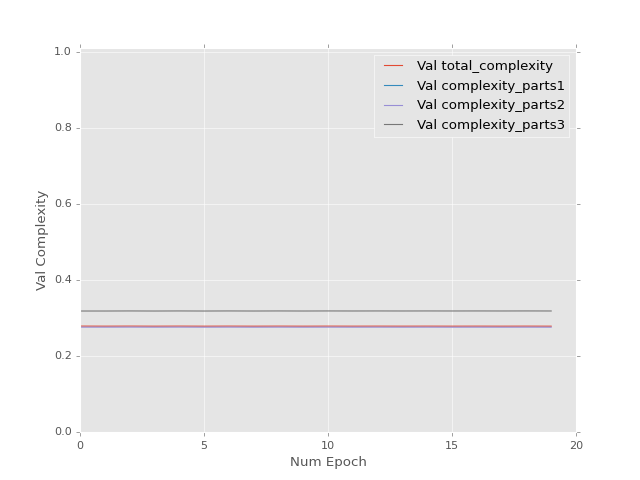

Epoch 1 of 20 took 6.070s
Epoch 2 of 20 took 5.545s
Epoch 3 of 20 took 5.867s
Epoch 4 of 20 took 5.880s
Epoch 5 of 20 took 5.721s
Epoch 6 of 20 took 5.537s
Epoch 7 of 20 took 5.593s
Epoch 8 of 20 took 5.583s
Epoch 9 of 20 took 5.663s
Epoch 10 of 20 took 5.437s
Epoch 11 of 20 took 5.741s
Epoch 12 of 20 took 5.760s
Epoch 13 of 20 took 5.660s
Epoch 14 of 20 took 5.912s
Epoch 15 of 20 took 5.548s
Epoch 16 of 20 took 5.434s
Epoch 17 of 20 took 5.911s
Epoch 18 of 20 took 5.689s
Epoch 19 of 20 took 5.871s
Epoch 20 of 20 took 5.864s
0.700902462006 [[ 1.17823422  0.3865768   0.54471594  1.21955109  0.46179688  0.66635972]]


<IPython.core.display.Javascript object>


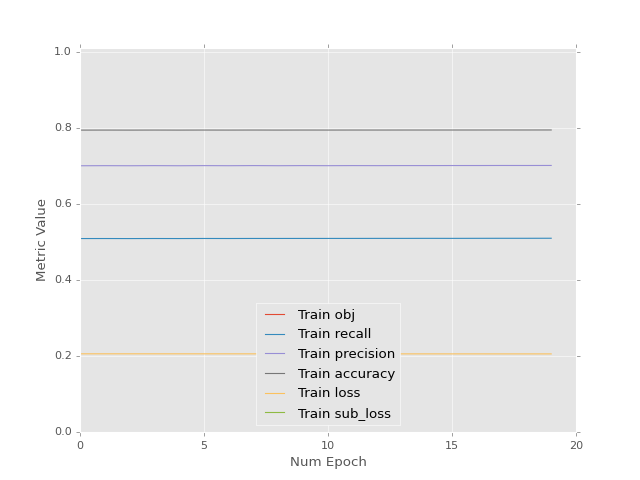

<IPython.core.display.Javascript object>


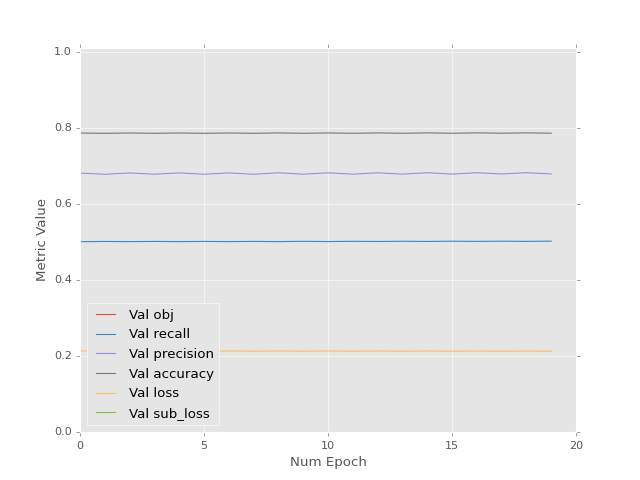

<IPython.core.display.Javascript object>


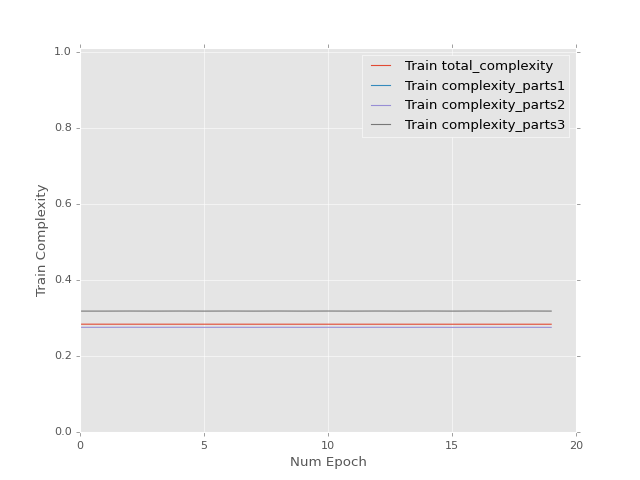

<IPython.core.display.Javascript object>


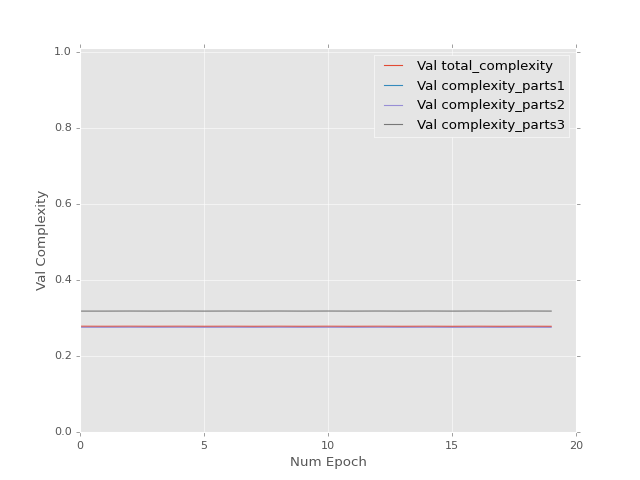

Epoch 1 of 20 took 5.516s
Epoch 2 of 20 took 5.866s
Epoch 3 of 20 took 5.911s
Epoch 4 of 20 took 5.685s
Epoch 5 of 20 took 5.586s
Epoch 6 of 20 took 5.875s
Epoch 7 of 20 took 5.497s
Epoch 8 of 20 took 5.468s
Epoch 9 of 20 took 5.724s
Epoch 10 of 20 took 5.769s
Epoch 11 of 20 took 5.908s
Epoch 12 of 20 took 5.670s
Epoch 13 of 20 took 5.757s
Epoch 14 of 20 took 5.860s
Epoch 15 of 20 took 5.457s
Epoch 16 of 20 took 5.803s
Epoch 17 of 20 took 6.076s
Epoch 18 of 20 took 5.495s
Epoch 19 of 20 took 5.920s
Epoch 20 of 20 took 5.886s
0.700194150209 [[ 1.17922521  0.38764283  0.54629874  1.22035718  0.46251425  0.66573226]]


<IPython.core.display.Javascript object>


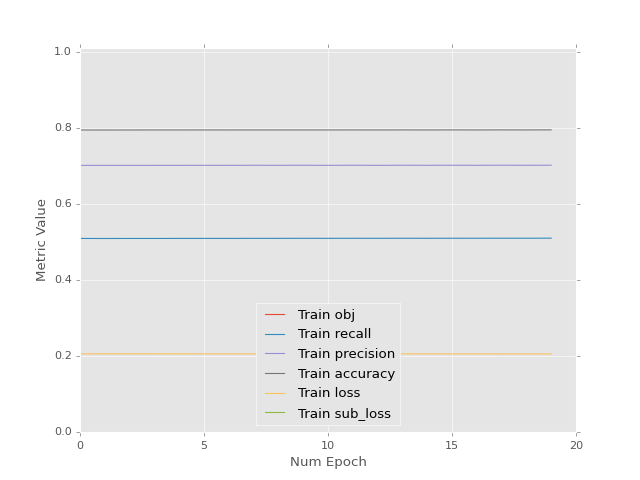

<IPython.core.display.Javascript object>


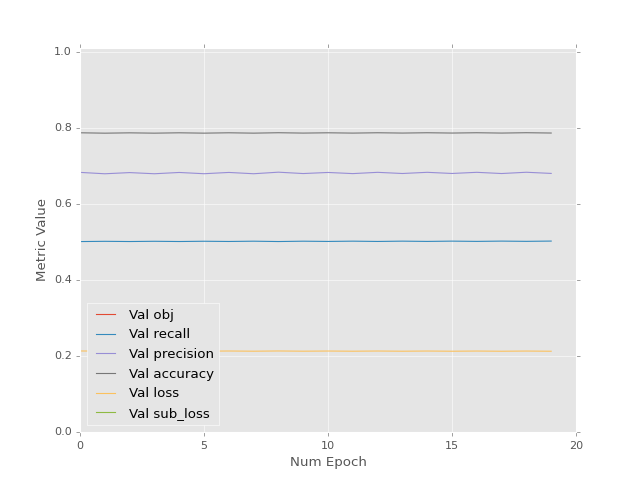

<IPython.core.display.Javascript object>


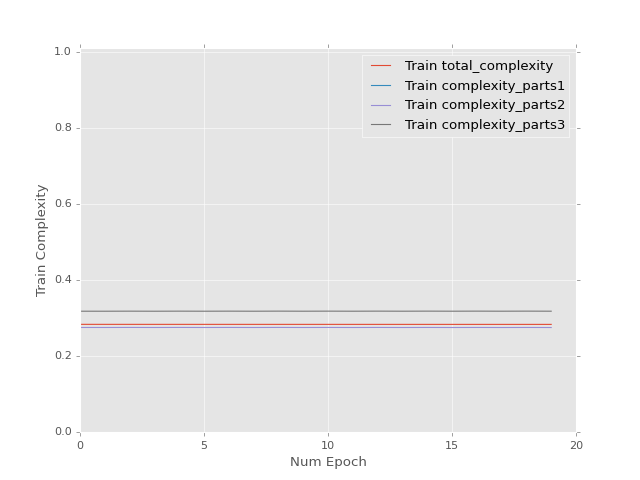

<IPython.core.display.Javascript object>


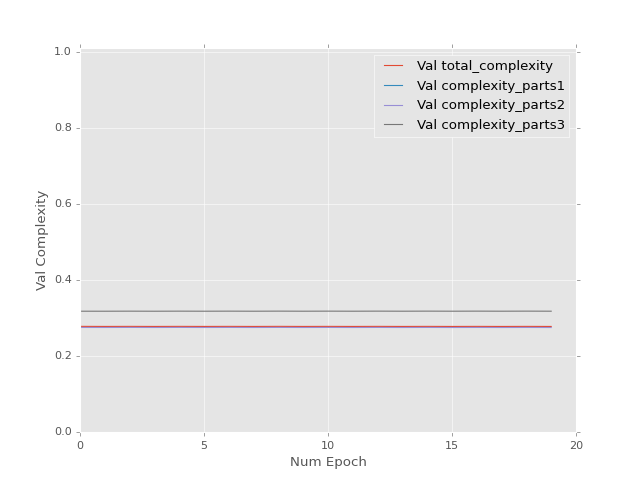

Epoch 1 of 20 took 5.655s
Epoch 2 of 20 took 5.523s
Epoch 3 of 20 took 5.797s
Epoch 4 of 20 took 5.497s
Epoch 5 of 20 took 6.004s
Epoch 6 of 20 took 5.914s
Epoch 7 of 20 took 5.796s
Epoch 8 of 20 took 6.042s
Epoch 9 of 20 took 5.522s
Epoch 10 of 20 took 5.571s
Epoch 11 of 20 took 5.688s
Epoch 12 of 20 took 5.616s
Epoch 13 of 20 took 5.992s
Epoch 14 of 20 took 5.764s
Epoch 15 of 20 took 5.859s
Epoch 16 of 20 took 5.566s
Epoch 17 of 20 took 5.821s
Epoch 18 of 20 took 5.433s
Epoch 19 of 20 took 5.780s
Epoch 20 of 20 took 5.646s
0.699351251125 [[ 1.18041515  0.3889229   0.54819256  1.22132552  0.46337608  0.6649788 ]]


<IPython.core.display.Javascript object>


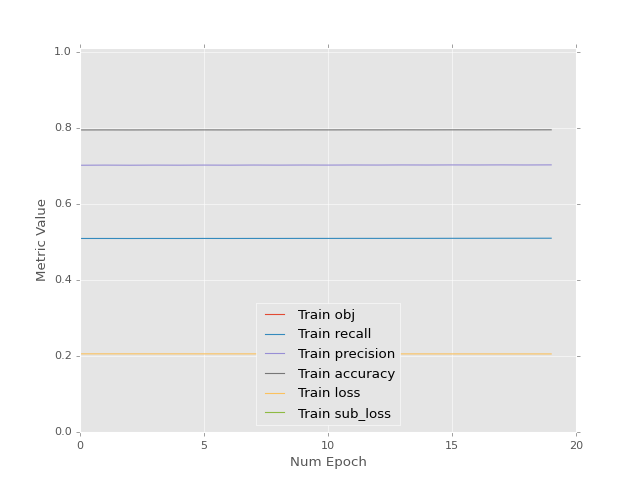

<IPython.core.display.Javascript object>


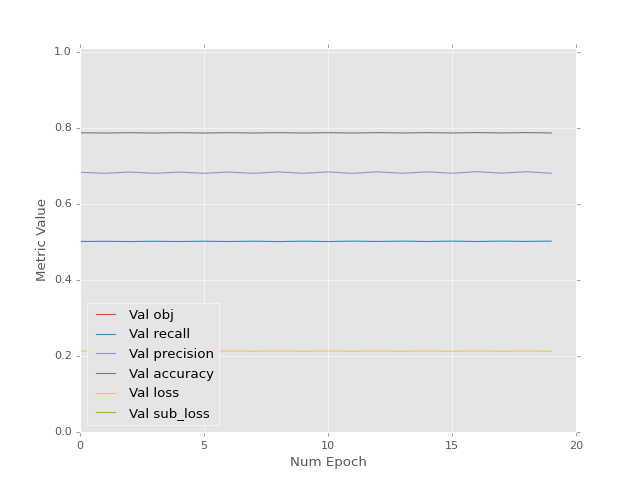

<IPython.core.display.Javascript object>


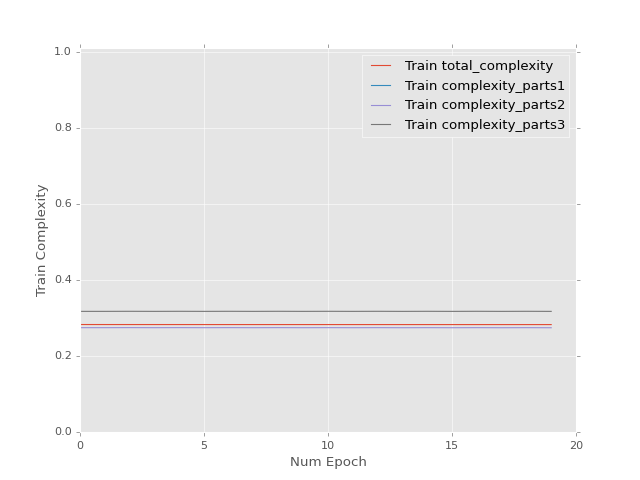

<IPython.core.display.Javascript object>


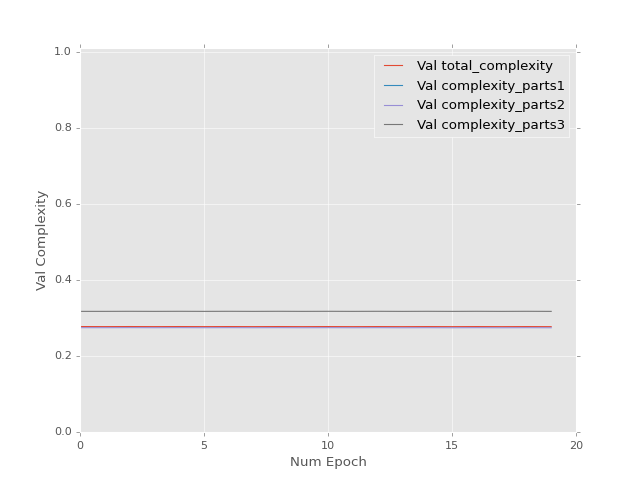

Epoch 1 of 20 took 5.658s
Epoch 2 of 20 took 5.640s
Epoch 3 of 20 took 5.812s
Epoch 4 of 20 took 5.426s
Epoch 5 of 20 took 5.429s
Epoch 6 of 20 took 5.443s
Epoch 7 of 20 took 5.709s
Epoch 8 of 20 took 5.439s
Epoch 9 of 20 took 5.800s
Epoch 10 of 20 took 5.900s
Epoch 11 of 20 took 5.656s
Epoch 12 of 20 took 6.040s
Epoch 13 of 20 took 5.635s
Epoch 14 of 20 took 6.029s
Epoch 15 of 20 took 5.825s
Epoch 16 of 20 took 5.464s
Epoch 17 of 20 took 5.682s
Epoch 18 of 20 took 5.810s
Epoch 19 of 20 took 6.047s
Epoch 20 of 20 took 5.476s
0.698325246572 [[ 1.18187606  0.39049405  0.55050731  1.22251499  0.46443459  0.66405368]]


<IPython.core.display.Javascript object>


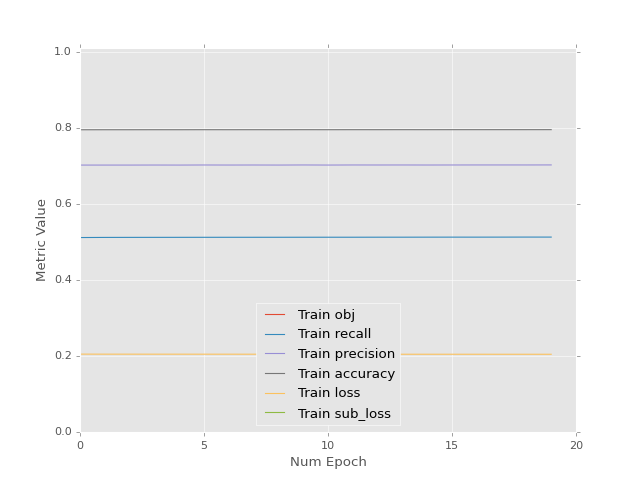

<IPython.core.display.Javascript object>


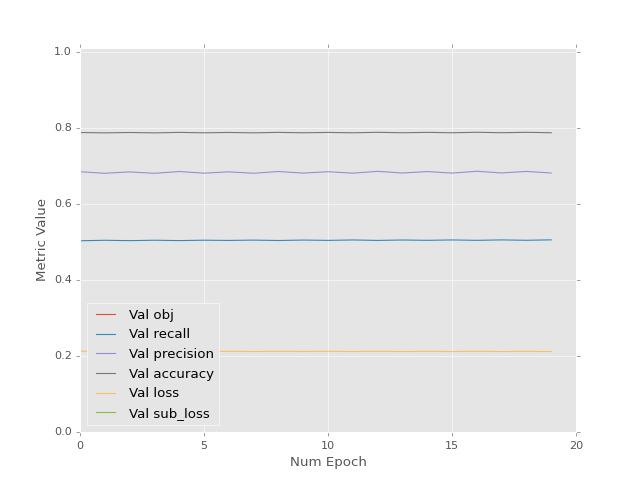

<IPython.core.display.Javascript object>


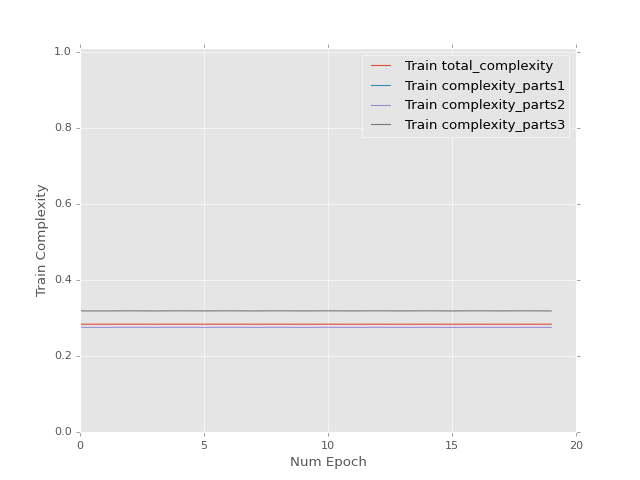

<IPython.core.display.Javascript object>


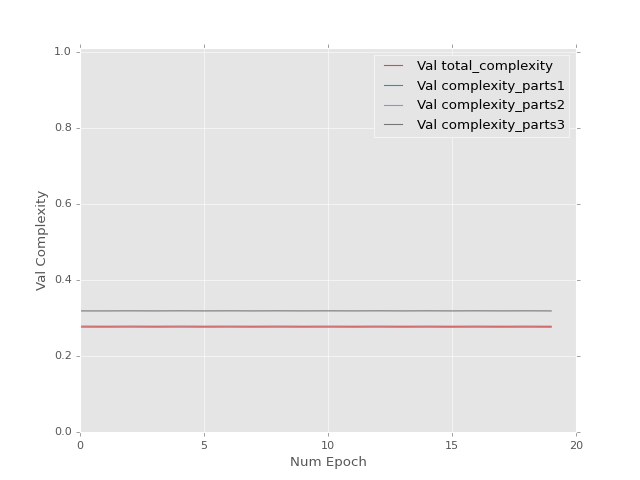

Epoch 1 of 20 took 5.715s
Epoch 2 of 20 took 5.484s
Epoch 3 of 20 took 5.629s
Epoch 4 of 20 took 5.909s
Epoch 5 of 20 took 5.598s
Epoch 6 of 20 took 5.816s
Epoch 7 of 20 took 5.898s
Epoch 8 of 20 took 5.784s
Epoch 9 of 20 took 5.528s
Epoch 10 of 20 took 5.635s
Epoch 11 of 20 took 5.458s
Epoch 12 of 20 took 5.851s
Epoch 13 of 20 took 5.695s
Epoch 14 of 20 took 5.860s
Epoch 15 of 20 took 5.438s
Epoch 16 of 20 took 5.716s
Epoch 17 of 20 took 5.441s
Epoch 18 of 20 took 5.663s
Epoch 19 of 20 took 5.435s
Epoch 20 of 20 took 5.895s
0.701174795628 [[ 1.17809474  0.38676503  0.54711246  1.21860778  0.46046475  0.6680854 ]]


<IPython.core.display.Javascript object>


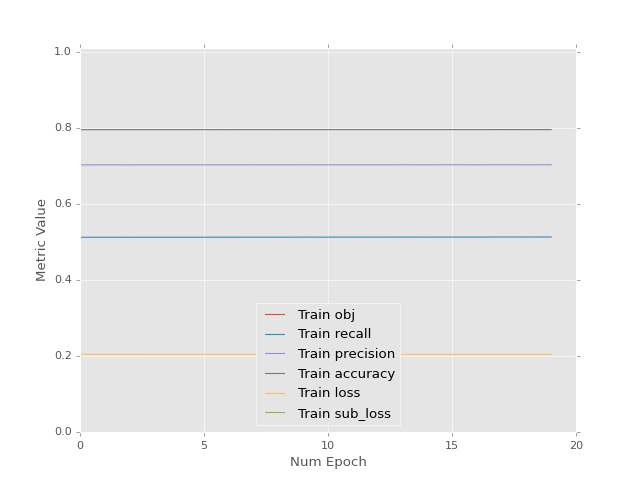

<IPython.core.display.Javascript object>


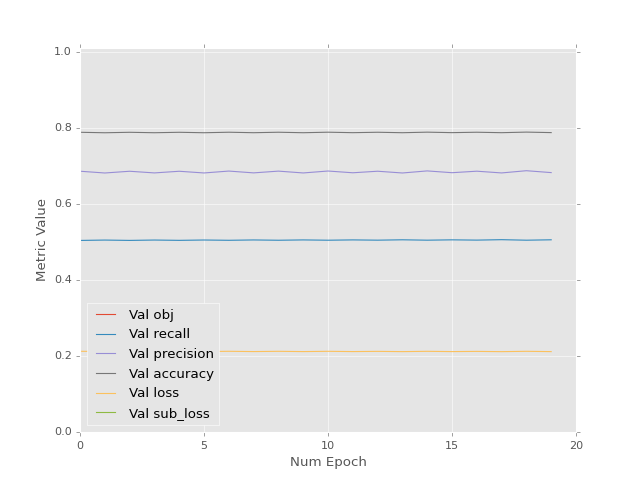

<IPython.core.display.Javascript object>


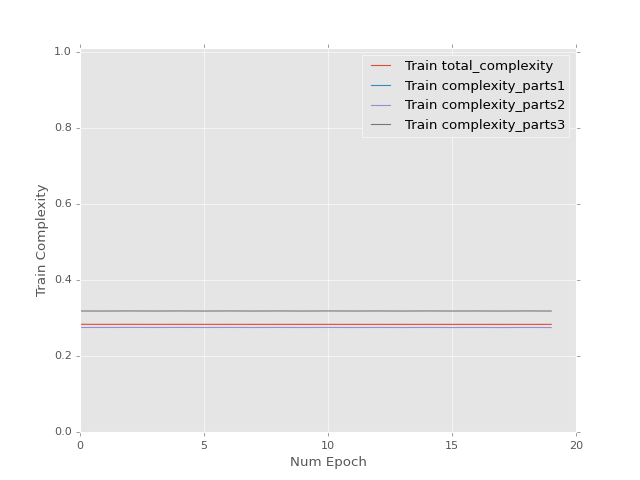

<IPython.core.display.Javascript object>


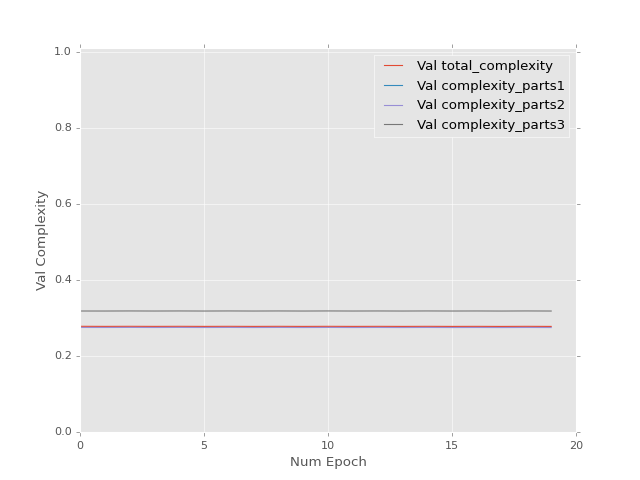

Epoch 1 of 20 took 5.796s
Epoch 2 of 20 took 5.735s
Epoch 3 of 20 took 5.497s
Epoch 4 of 20 took 5.820s
Epoch 5 of 20 took 5.551s
Epoch 6 of 20 took 5.985s
Epoch 7 of 20 took 5.518s
Epoch 8 of 20 took 5.608s
Epoch 9 of 20 took 5.571s
Epoch 10 of 20 took 5.790s
Epoch 11 of 20 took 5.757s
Epoch 12 of 20 took 5.605s
Epoch 13 of 20 took 5.735s
Epoch 14 of 20 took 5.491s
Epoch 15 of 20 took 5.492s
Epoch 16 of 20 took 5.665s
Epoch 17 of 20 took 5.650s
Epoch 18 of 20 took 5.807s
Epoch 19 of 20 took 5.726s
Epoch 20 of 20 took 5.780s
0.700500816107 [[ 1.17903554  0.38777781  0.54860479  1.21937358  0.4611457   0.66749018]]


<IPython.core.display.Javascript object>


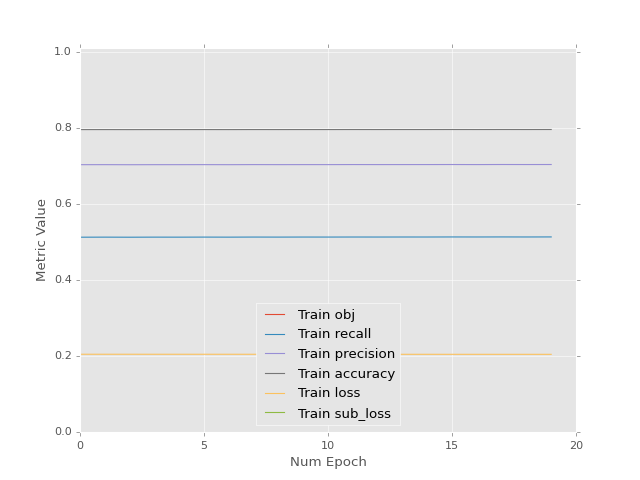

<IPython.core.display.Javascript object>


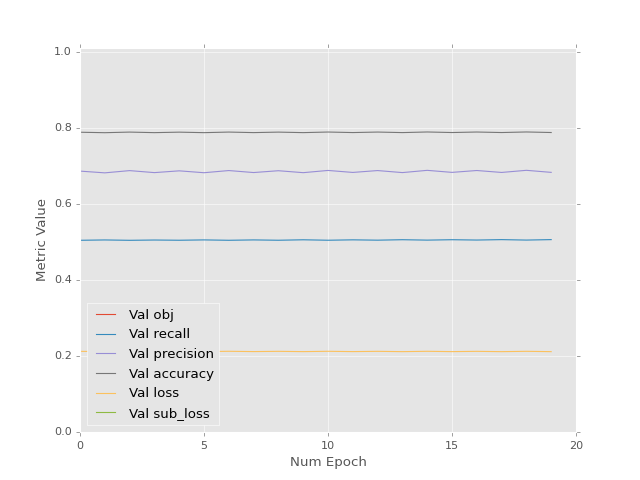

<IPython.core.display.Javascript object>


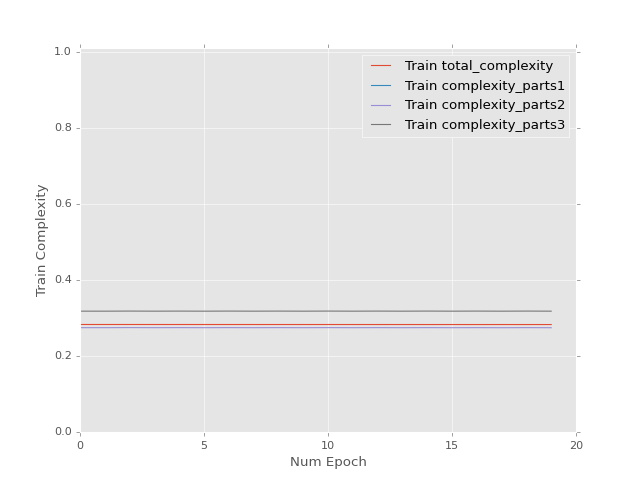

<IPython.core.display.Javascript object>


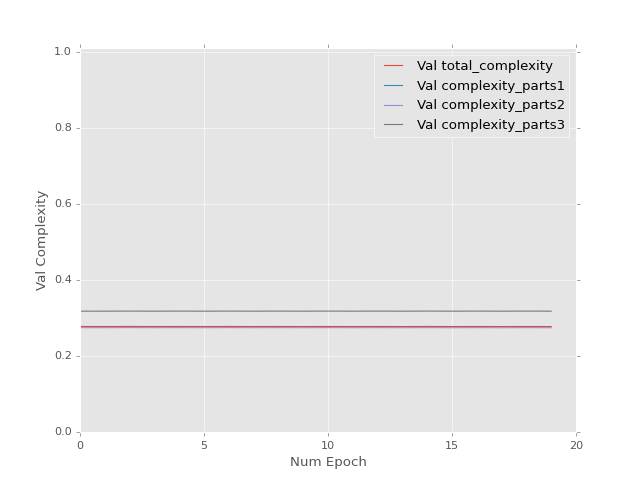

Epoch 1 of 20 took 5.851s
Epoch 2 of 20 took 5.648s
Epoch 3 of 20 took 5.889s
Epoch 4 of 20 took 5.620s
Epoch 5 of 20 took 5.657s
Epoch 6 of 20 took 5.619s
Epoch 7 of 20 took 6.025s
Epoch 8 of 20 took 5.560s
Epoch 9 of 20 took 6.000s
Epoch 10 of 20 took 5.763s
Epoch 11 of 20 took 5.611s
Epoch 12 of 20 took 5.681s
Epoch 13 of 20 took 5.436s
Epoch 14 of 20 took 5.473s
Epoch 15 of 20 took 5.748s
Epoch 16 of 20 took 6.052s
Epoch 17 of 20 took 5.653s
Epoch 18 of 20 took 5.998s
Epoch 19 of 20 took 5.549s
Epoch 20 of 20 took 5.874s
0.699705630541 [[ 1.18015599  0.38898411  0.55037636  1.22028601  0.46195716  0.66678101]]


<IPython.core.display.Javascript object>


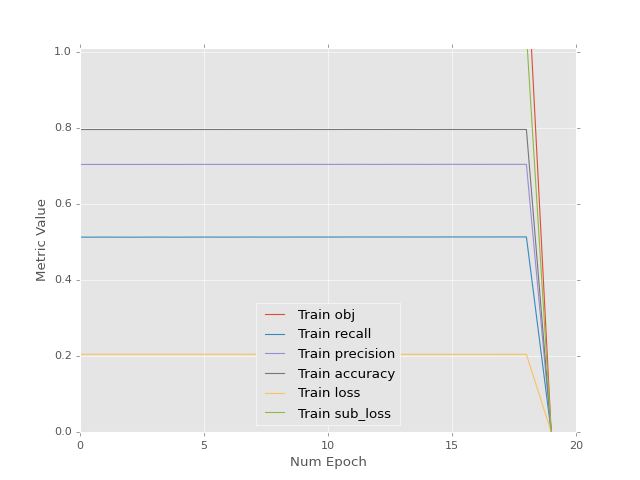

<IPython.core.display.Javascript object>


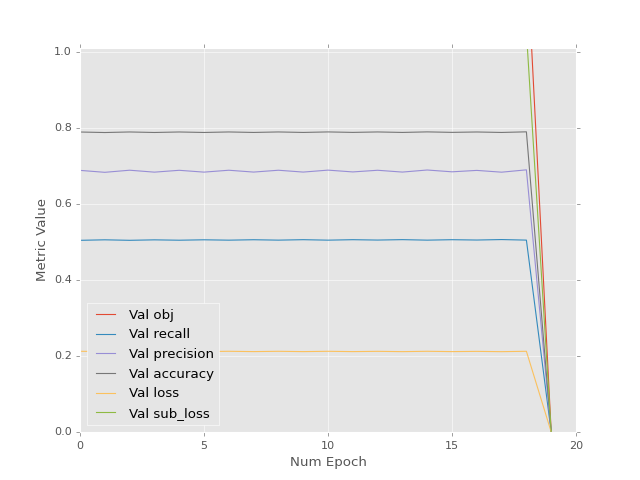

<IPython.core.display.Javascript object>


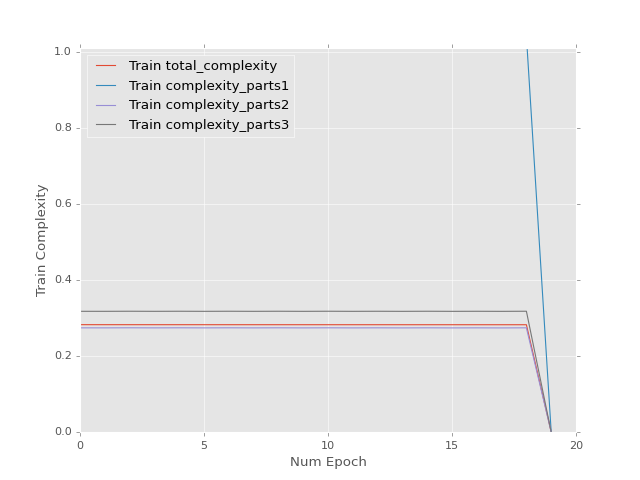

<IPython.core.display.Javascript object>


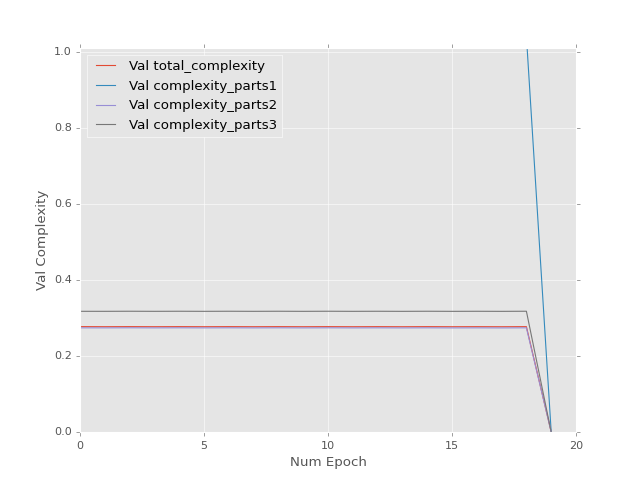

Epoch 1 of 20 took 5.753s
Epoch 2 of 20 took 5.652s
Epoch 3 of 20 took 5.509s
Epoch 4 of 20 took 5.737s
Epoch 5 of 20 took 5.881s
Epoch 6 of 20 took 5.510s
Epoch 7 of 20 took 5.899s
Epoch 8 of 20 took 5.954s
Epoch 9 of 20 took 6.021s
Epoch 10 of 20 took 5.763s
Epoch 11 of 20 took 5.431s
Epoch 12 of 20 took 5.845s
Epoch 13 of 20 took 5.730s
Epoch 14 of 20 took 5.894s
Epoch 15 of 20 took 6.062s
Epoch 16 of 20 took 5.642s
Epoch 17 of 20 took 5.610s
Epoch 18 of 20 took 6.037s
Epoch 19 of 20 took 5.817s
Epoch 20 of 20 took 6.215s
0.698742985725 [[ 1.18152332  0.39045593  0.55252963  1.2213999   0.4629477   0.66591573]]


<IPython.core.display.Javascript object>


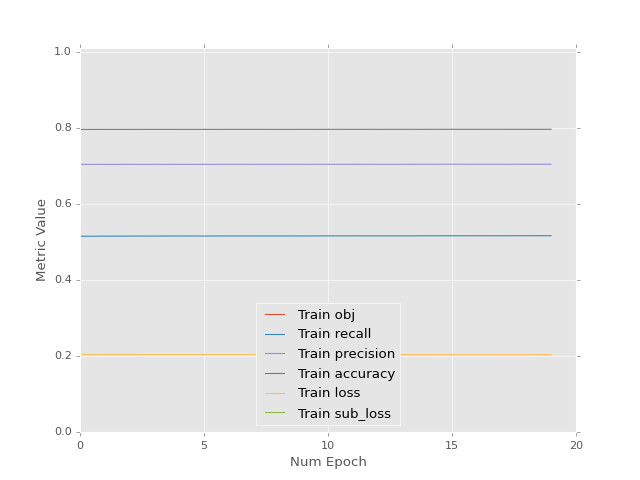

<IPython.core.display.Javascript object>


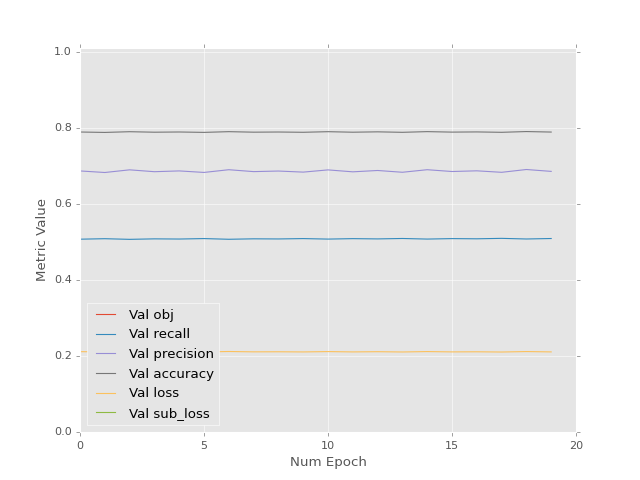

<IPython.core.display.Javascript object>


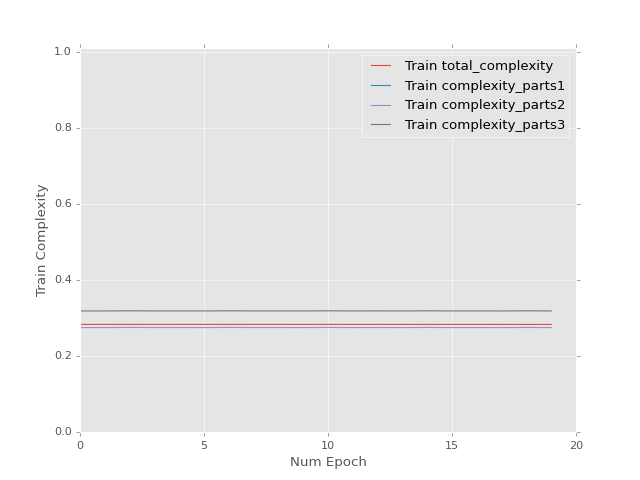

<IPython.core.display.Javascript object>


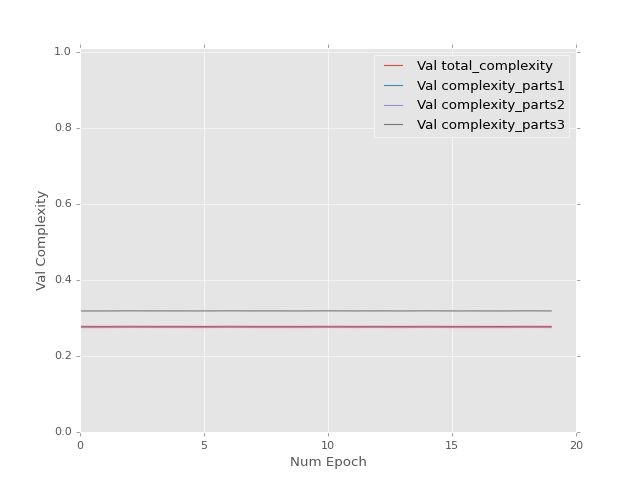

Epoch 1 of 20 took 5.485s
Epoch 2 of 20 took 5.695s
Epoch 3 of 20 took 5.697s
Epoch 4 of 20 took 5.641s
Epoch 5 of 20 took 5.921s
Epoch 6 of 20 took 5.664s
Epoch 7 of 20 took 5.814s
Epoch 8 of 20 took 5.837s
Epoch 9 of 20 took 5.918s
Epoch 10 of 20 took 5.507s
Epoch 11 of 20 took 5.722s
Epoch 12 of 20 took 5.752s
Epoch 13 of 20 took 5.858s
Epoch 14 of 20 took 6.108s
Epoch 15 of 20 took 5.690s
Epoch 16 of 20 took 5.547s
Epoch 17 of 20 took 5.888s
Epoch 18 of 20 took 5.894s
Epoch 19 of 20 took 6.034s
Epoch 20 of 20 took 5.939s
0.701390713453 [[ 1.1780386   0.38704607  0.54959029  1.21773458  0.45919326  0.66975999]]


<IPython.core.display.Javascript object>


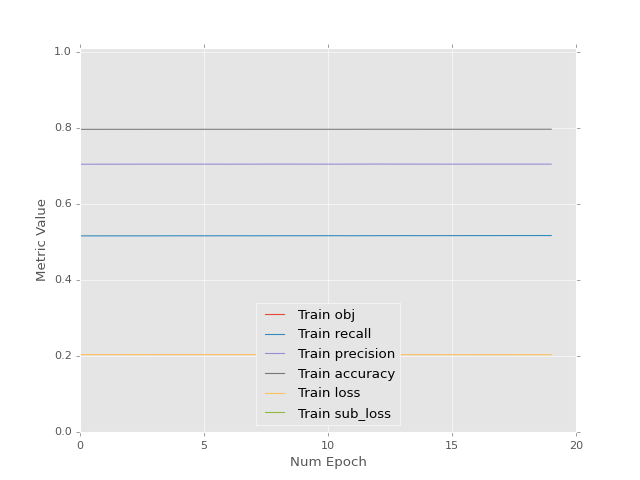

<IPython.core.display.Javascript object>


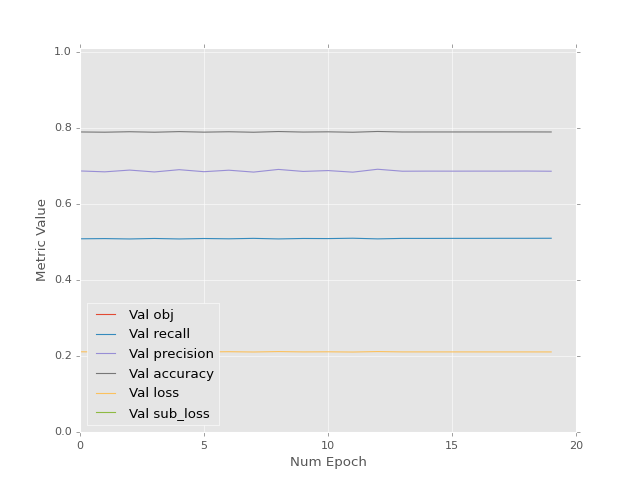

<IPython.core.display.Javascript object>


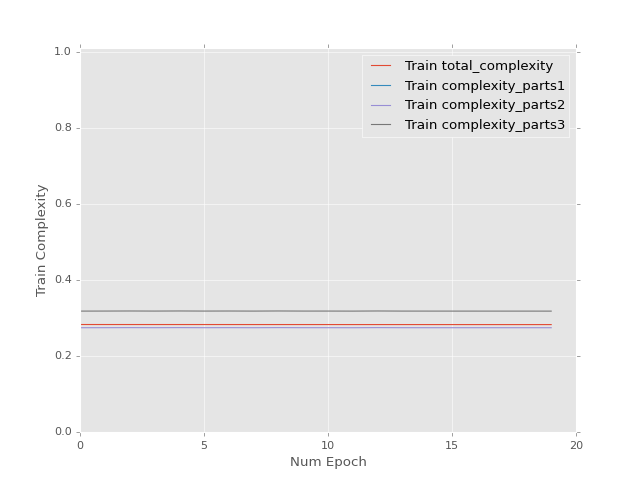

<IPython.core.display.Javascript object>


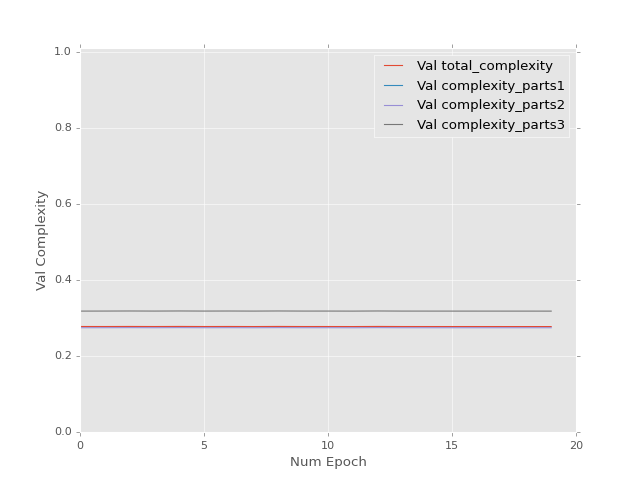

Epoch 1 of 20 took 6.098s
Epoch 2 of 20 took 5.834s
Epoch 3 of 20 took 5.765s
Epoch 4 of 20 took 5.741s
Epoch 5 of 20 took 5.900s
Epoch 6 of 20 took 5.504s
Epoch 7 of 20 took 5.839s
Epoch 8 of 20 took 5.769s
Epoch 9 of 20 took 5.593s
Epoch 10 of 20 took 5.580s
Epoch 11 of 20 took 5.846s
Epoch 12 of 20 took 5.577s
Epoch 13 of 20 took 5.684s
Epoch 14 of 20 took 5.753s
Epoch 15 of 20 took 5.856s
Epoch 16 of 20 took 5.432s
Epoch 17 of 20 took 5.741s
Epoch 18 of 20 took 6.173s
Epoch 19 of 20 took 5.875s
Epoch 20 of 20 took 5.803s
0.700755447149 [[ 1.17892337  0.38799977  0.55098742  1.21845543  0.45983368  0.66920054]]


<IPython.core.display.Javascript object>


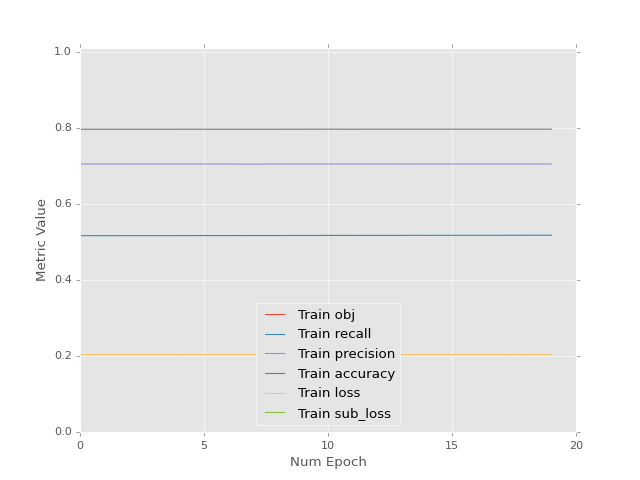

<IPython.core.display.Javascript object>


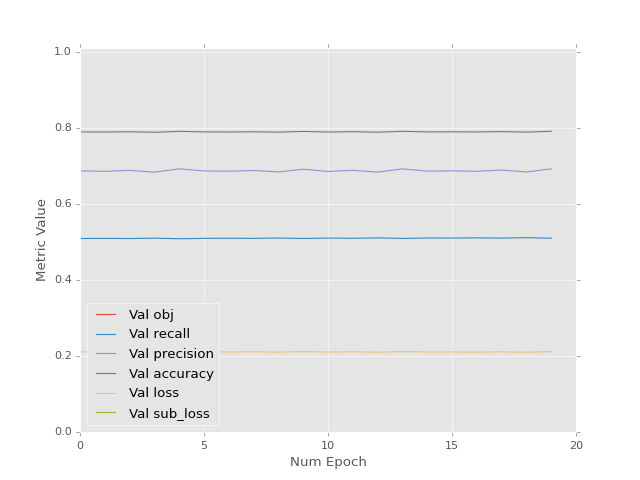

<IPython.core.display.Javascript object>


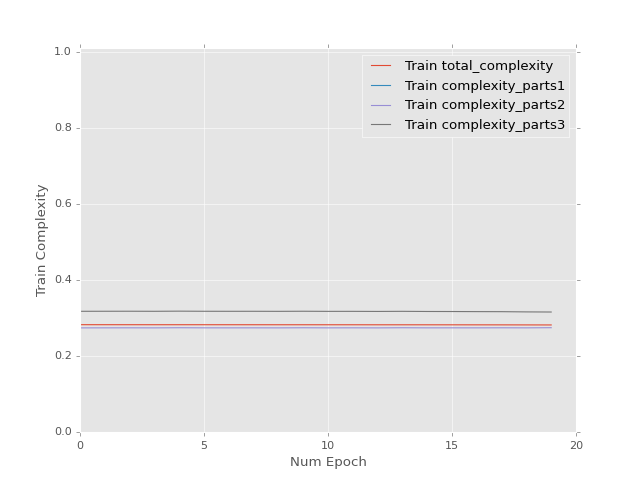

<IPython.core.display.Javascript object>


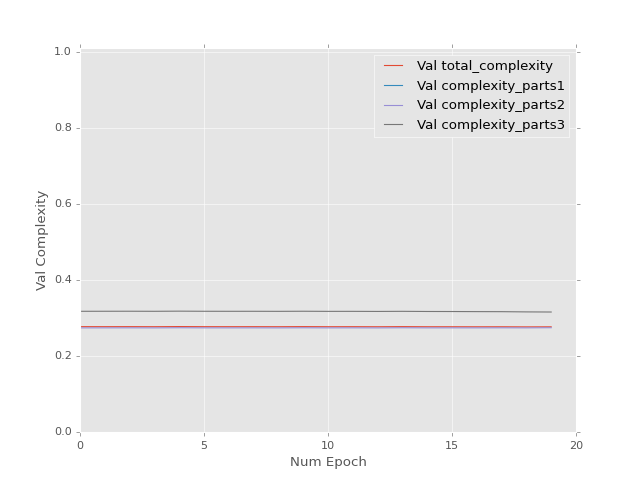

Epoch 1 of 20 took 6.018s
Epoch 2 of 20 took 5.693s
Epoch 3 of 20 took 5.789s
Epoch 4 of 20 took 5.444s
Epoch 5 of 20 took 5.451s
Epoch 6 of 20 took 5.631s
Epoch 7 of 20 took 5.485s
Epoch 8 of 20 took 5.601s
Epoch 9 of 20 took 5.586s
Epoch 10 of 20 took 5.847s
Epoch 11 of 20 took 5.482s
Epoch 12 of 20 took 5.844s
Epoch 13 of 20 took 5.762s
Epoch 14 of 20 took 6.043s
Epoch 15 of 20 took 5.441s
Epoch 16 of 20 took 5.721s
Epoch 17 of 20 took 5.635s
Epoch 18 of 20 took 5.432s
Epoch 19 of 20 took 5.586s
Epoch 20 of 20 took 5.961s
0.700013905764 [[ 1.17996597  0.38912338  0.55262828  1.21930468  0.46058846  0.66854149]]


<IPython.core.display.Javascript object>


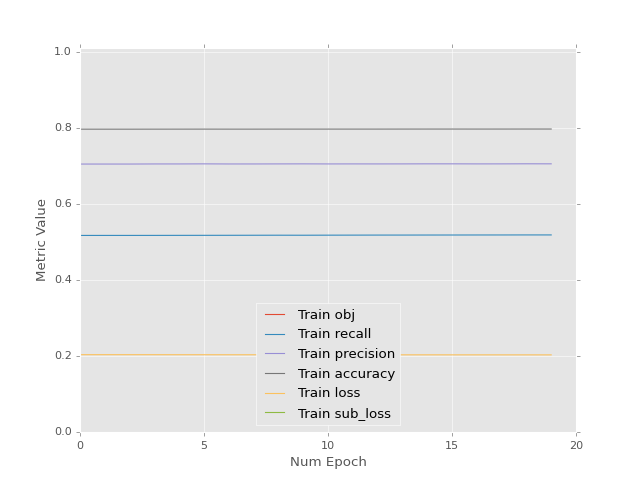

<IPython.core.display.Javascript object>


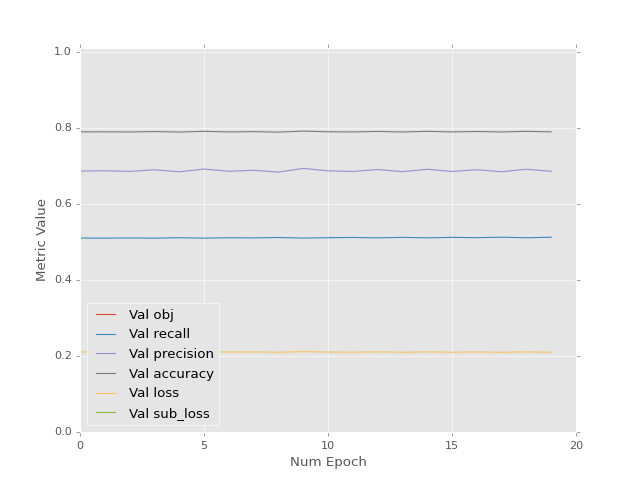

<IPython.core.display.Javascript object>


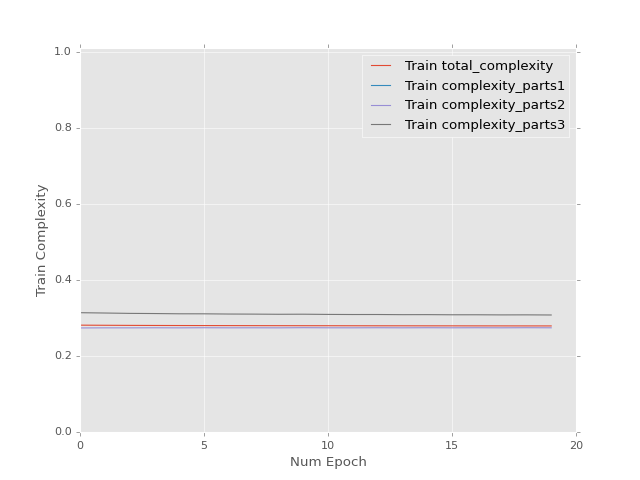

<IPython.core.display.Javascript object>


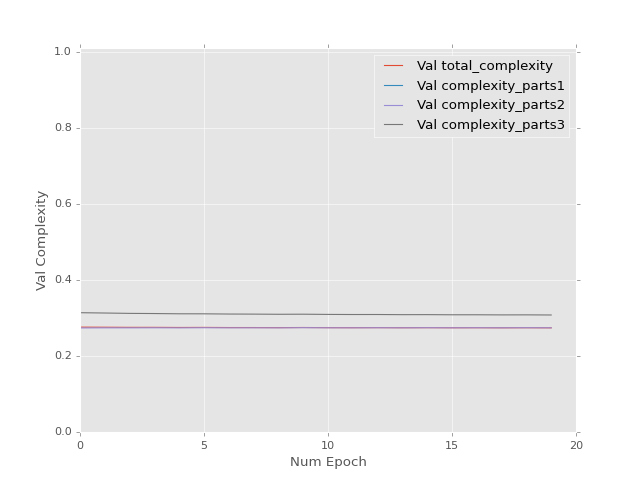

Epoch 1 of 20 took 6.029s
Epoch 2 of 20 took 5.604s
Epoch 3 of 20 took 5.645s
Epoch 4 of 20 took 5.674s
Epoch 5 of 20 took 5.618s
Epoch 6 of 20 took 5.735s
Epoch 7 of 20 took 5.809s
Epoch 8 of 20 took 6.164s
Epoch 9 of 20 took 5.782s
Epoch 10 of 20 took 5.833s
Epoch 11 of 20 took 5.769s
Epoch 12 of 20 took 5.713s
Epoch 13 of 20 took 6.039s
Epoch 14 of 20 took 5.835s
Epoch 15 of 20 took 5.759s
Epoch 16 of 20 took 5.698s
Epoch 17 of 20 took 5.610s
Epoch 18 of 20 took 5.900s
Epoch 19 of 20 took 5.828s
Epoch 20 of 20 took 5.904s
0.699126005173 [[ 1.18122733  0.3904824   0.55460608  1.22033238  0.46150196  0.66774416]]


<IPython.core.display.Javascript object>


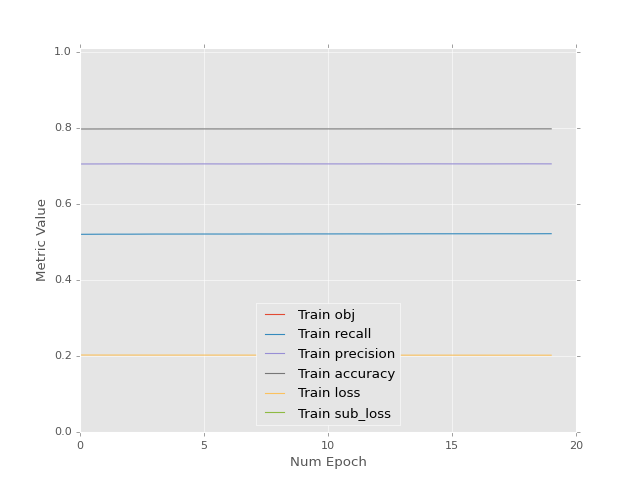

<IPython.core.display.Javascript object>


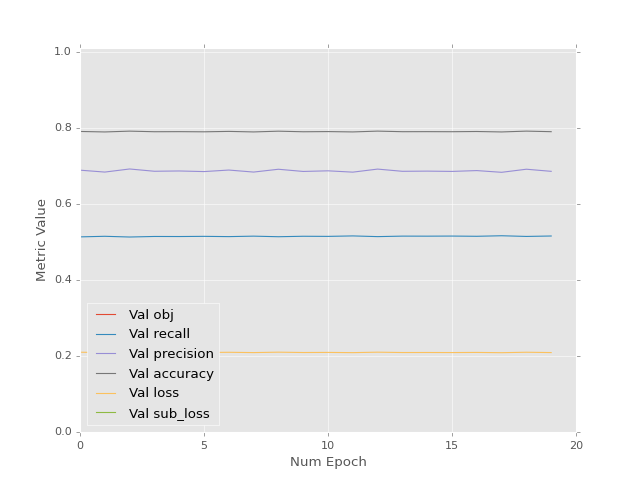

<IPython.core.display.Javascript object>


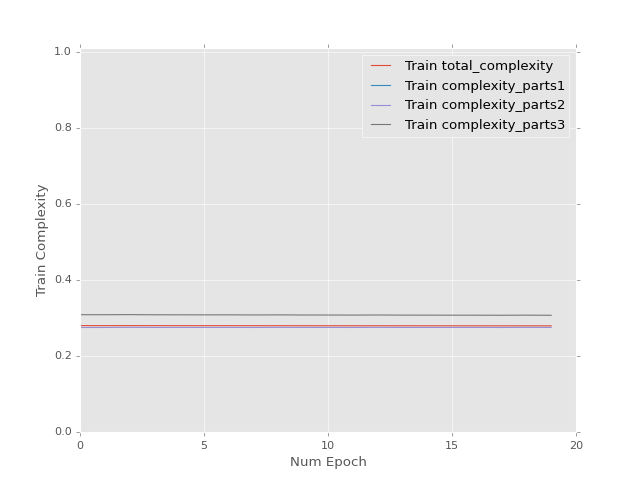

<IPython.core.display.Javascript object>


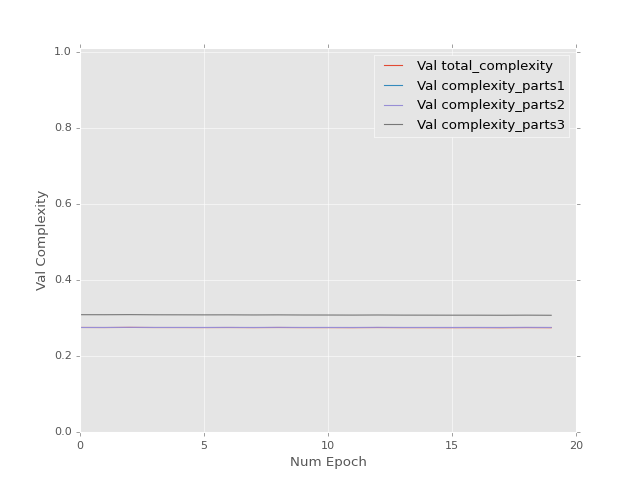

Epoch 1 of 20 took 5.674s
Epoch 2 of 20 took 5.619s
Epoch 3 of 20 took 6.087s
Epoch 4 of 20 took 5.994s
Epoch 5 of 20 took 5.710s
Epoch 6 of 20 took 5.968s
Epoch 7 of 20 took 6.038s
Epoch 8 of 20 took 5.718s
Epoch 9 of 20 took 5.645s
Epoch 10 of 20 took 5.775s
Epoch 11 of 20 took 5.569s
Epoch 12 of 20 took 5.905s
Epoch 13 of 20 took 5.878s
Epoch 14 of 20 took 6.045s
Epoch 15 of 20 took 5.725s
Epoch 16 of 20 took 5.890s
Epoch 17 of 20 took 5.691s
Epoch 18 of 20 took 5.959s
Epoch 19 of 20 took 5.524s
Epoch 20 of 20 took 6.008s
0.701593667269 [[ 1.17800522  0.3873556   0.55206525  1.21688163  0.45793793  0.67142302]]


<IPython.core.display.Javascript object>


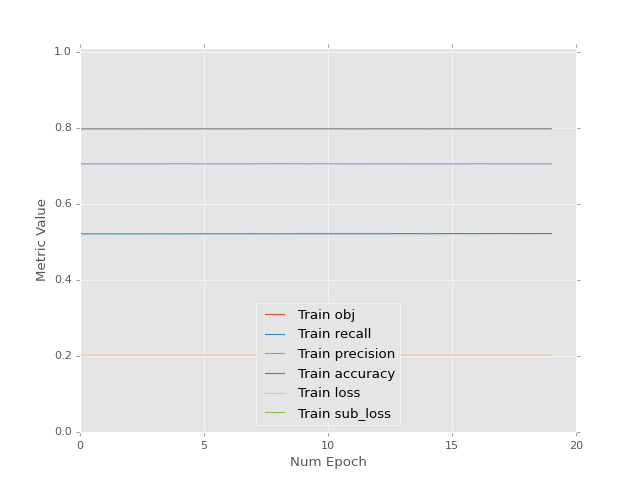

<IPython.core.display.Javascript object>


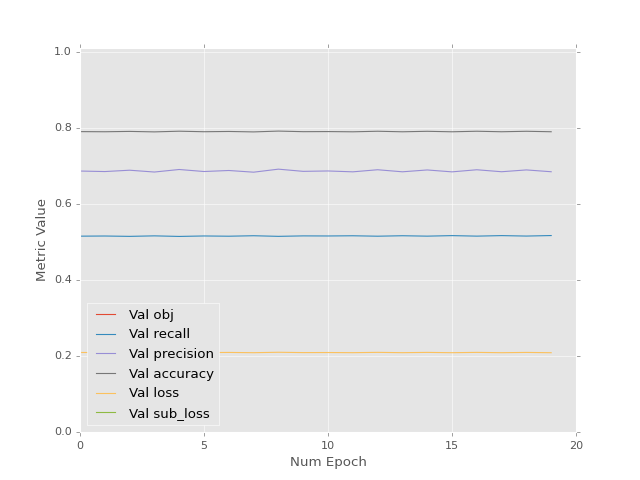

<IPython.core.display.Javascript object>


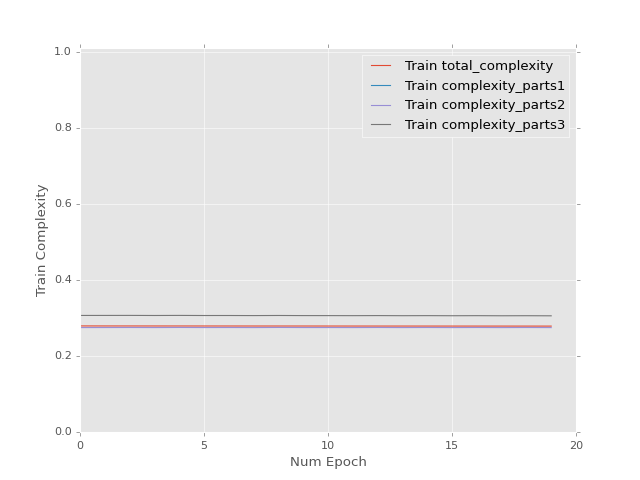

<IPython.core.display.Javascript object>


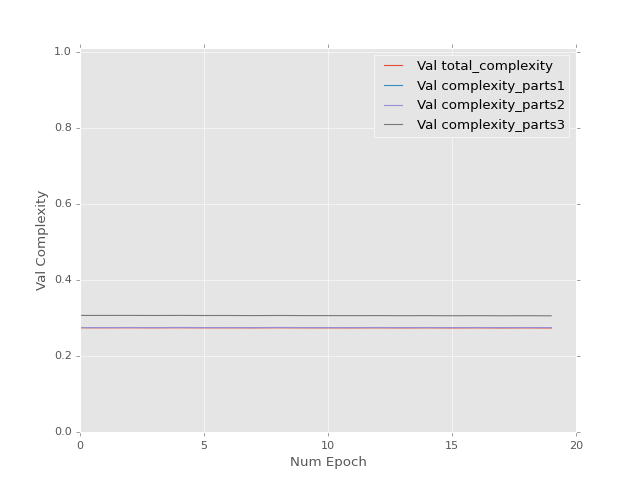

Epoch 1 of 20 took 5.445s
Epoch 2 of 20 took 5.597s
Epoch 3 of 20 took 5.491s
Epoch 4 of 20 took 5.729s
Epoch 5 of 20 took 5.871s
Epoch 6 of 20 took 5.663s
Epoch 7 of 20 took 5.870s
Epoch 8 of 20 took 6.033s
Epoch 9 of 20 took 5.751s
Epoch 10 of 20 took 5.732s
Epoch 11 of 20 took 5.937s
Epoch 12 of 20 took 5.853s
Epoch 13 of 20 took 5.467s
Epoch 14 of 20 took 5.522s
Epoch 15 of 20 took 5.579s
Epoch 16 of 20 took 6.100s
Epoch 17 of 20 took 6.063s
Epoch 18 of 20 took 5.767s
Epoch 19 of 20 took 5.728s
Epoch 20 of 20 took 5.895s
0.700991988182 [[ 1.17884076  0.38825694  0.55337828  1.21756232  0.45854244  0.67089552]]


<IPython.core.display.Javascript object>


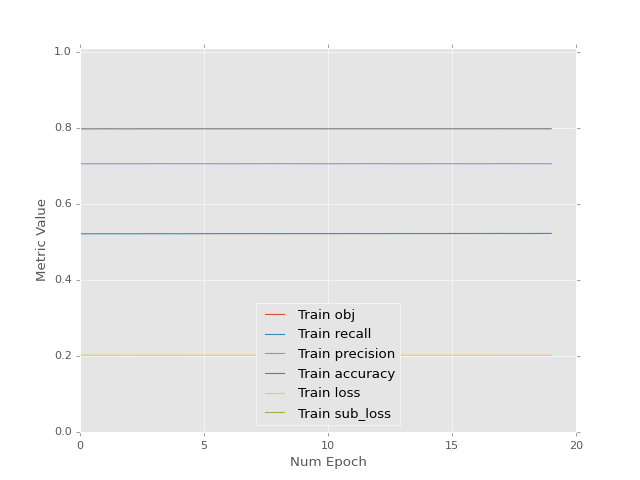

<IPython.core.display.Javascript object>


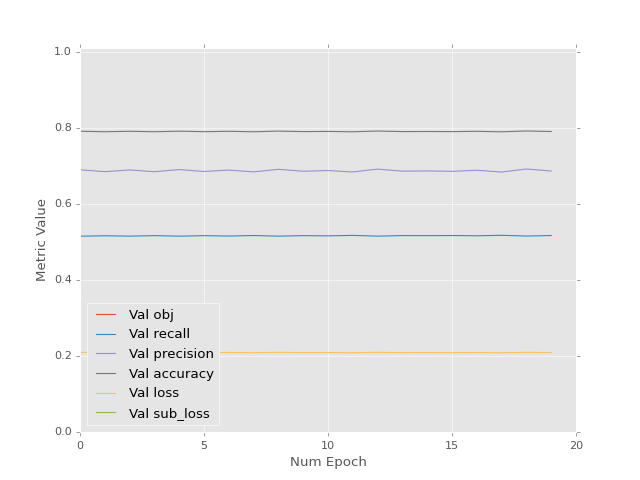

<IPython.core.display.Javascript object>


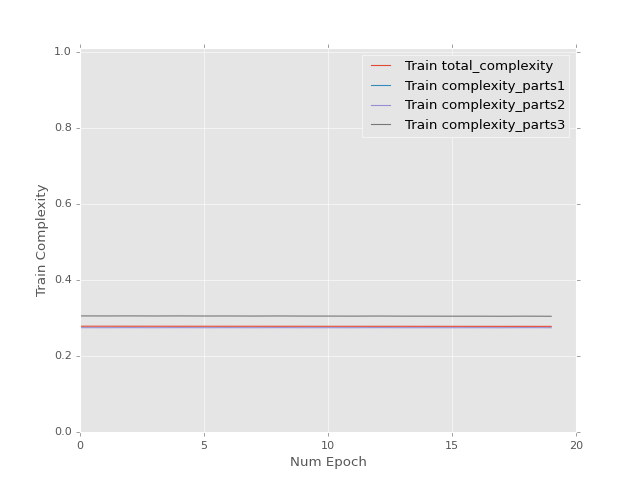

<IPython.core.display.Javascript object>


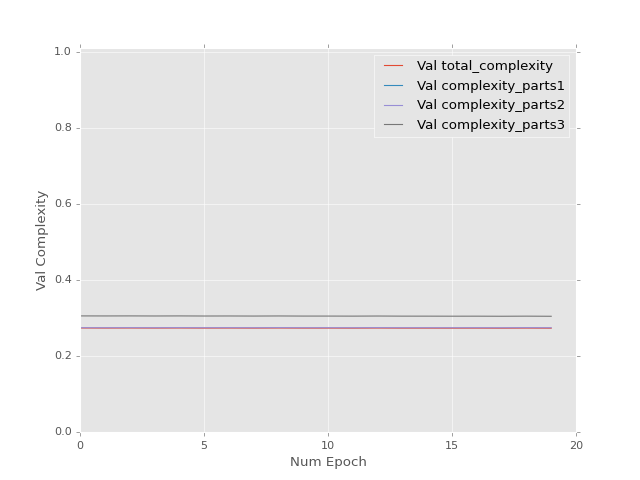

Epoch 1 of 20 took 5.731s
Epoch 2 of 20 took 5.499s
Epoch 3 of 20 took 5.535s
Epoch 4 of 20 took 5.852s
Epoch 5 of 20 took 6.054s
Epoch 6 of 20 took 5.674s
Epoch 7 of 20 took 5.837s
Epoch 8 of 20 took 5.830s
Epoch 9 of 20 took 5.965s
Epoch 10 of 20 took 5.977s
Epoch 11 of 20 took 5.715s
Epoch 12 of 20 took 5.817s
Epoch 13 of 20 took 5.685s
Epoch 14 of 20 took 5.812s
Epoch 15 of 20 took 6.042s
Epoch 16 of 20 took 5.746s
Epoch 17 of 20 took 6.025s
Epoch 18 of 20 took 6.159s
Epoch 19 of 20 took 5.508s
Epoch 20 of 20 took 5.539s
0.700295686722 [[ 1.1798135   0.3893061   0.55490226  1.21835494  0.45924634  0.67028147]]


<IPython.core.display.Javascript object>


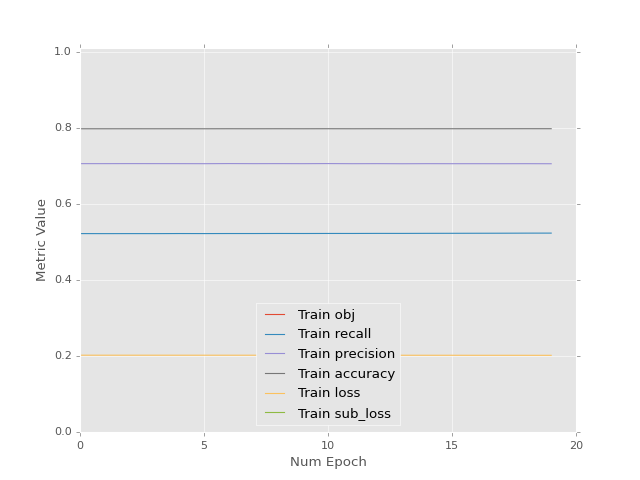

<IPython.core.display.Javascript object>


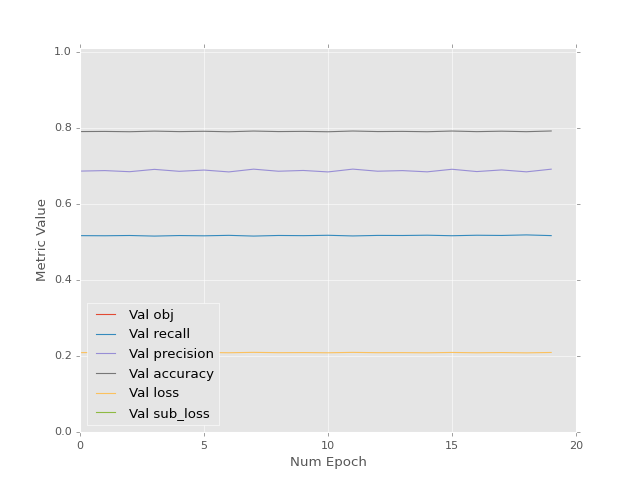

<IPython.core.display.Javascript object>


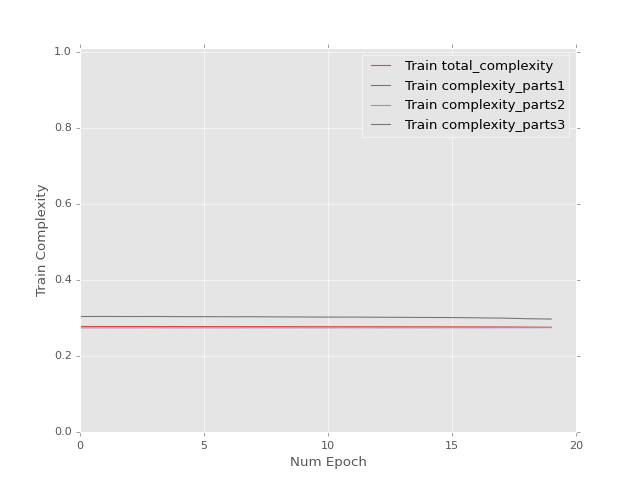

<IPython.core.display.Javascript object>


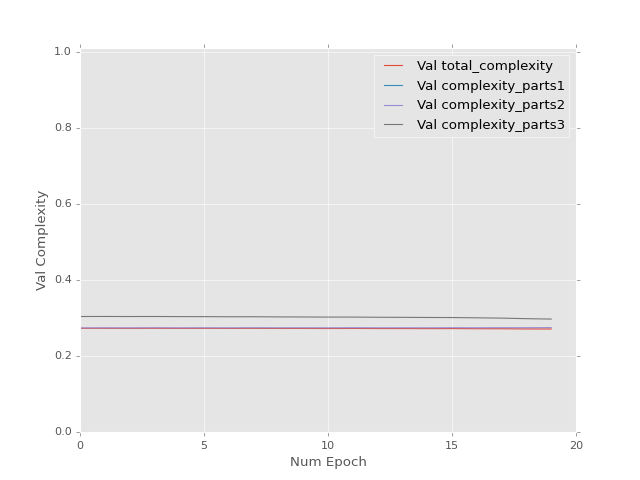

Epoch 1 of 20 took 5.716s
Epoch 2 of 20 took 5.661s
Epoch 3 of 20 took 5.628s
Epoch 4 of 20 took 5.726s
Epoch 5 of 20 took 5.846s
Epoch 6 of 20 took 5.654s
Epoch 7 of 20 took 5.787s
Epoch 8 of 20 took 5.892s
Epoch 9 of 20 took 5.804s
Epoch 10 of 20 took 5.746s
Epoch 11 of 20 took 5.723s
Epoch 12 of 20 took 5.875s
Epoch 13 of 20 took 6.165s
Epoch 14 of 20 took 5.951s
Epoch 15 of 20 took 5.721s
Epoch 16 of 20 took 5.772s
Epoch 17 of 20 took 5.439s
Epoch 18 of 20 took 5.903s
Epoch 19 of 20 took 5.849s
Epoch 20 of 20 took 5.585s
0.699470728636 [[ 1.18097901  0.39056274  0.55672151  1.21930468  0.4600898   0.66954589]]


<IPython.core.display.Javascript object>


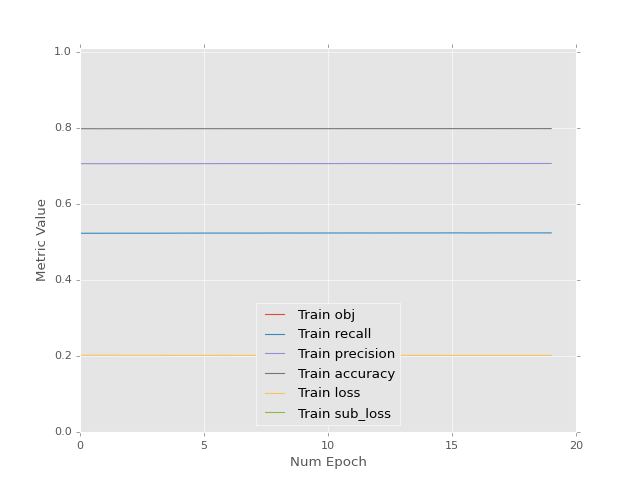

<IPython.core.display.Javascript object>


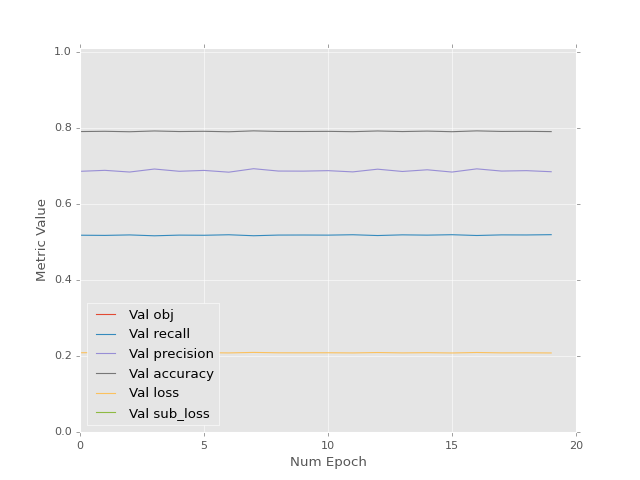

<IPython.core.display.Javascript object>


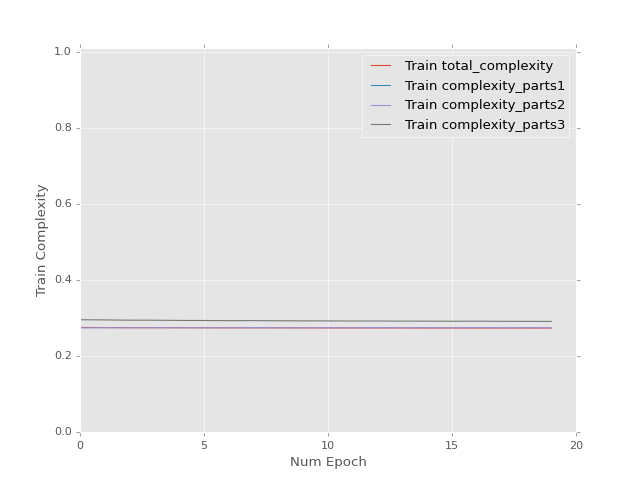

<IPython.core.display.Javascript object>


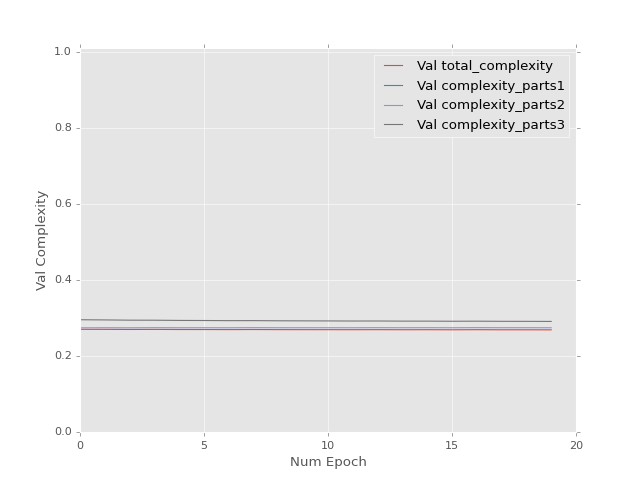

Epoch 1 of 20 took 5.430s
Epoch 2 of 20 took 5.929s
Epoch 3 of 20 took 5.818s
Epoch 4 of 20 took 5.822s
Epoch 5 of 20 took 5.850s
Epoch 6 of 20 took 5.959s
Epoch 7 of 20 took 5.462s
Epoch 8 of 20 took 5.494s
Epoch 9 of 20 took 6.134s
Epoch 10 of 20 took 5.877s
Epoch 11 of 20 took 5.707s
Epoch 12 of 20 took 5.599s
Epoch 13 of 20 took 5.899s
Epoch 14 of 20 took 5.426s
Epoch 15 of 20 took 5.466s
Epoch 16 of 20 took 6.156s
Epoch 17 of 20 took 5.701s
Epoch 18 of 20 took 5.541s
Epoch 19 of 20 took 5.590s
Epoch 20 of 20 took 5.428s
0.698468208313 [[ 1.18240714  0.39210233  0.5589419   1.22046912  0.46112391  0.66864449]]


<IPython.core.display.Javascript object>


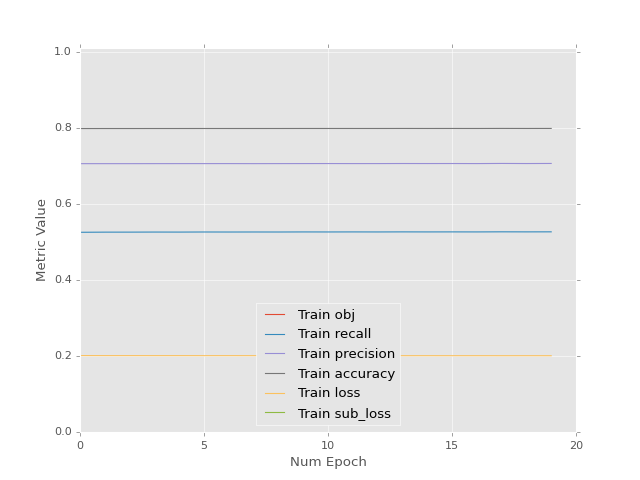

<IPython.core.display.Javascript object>


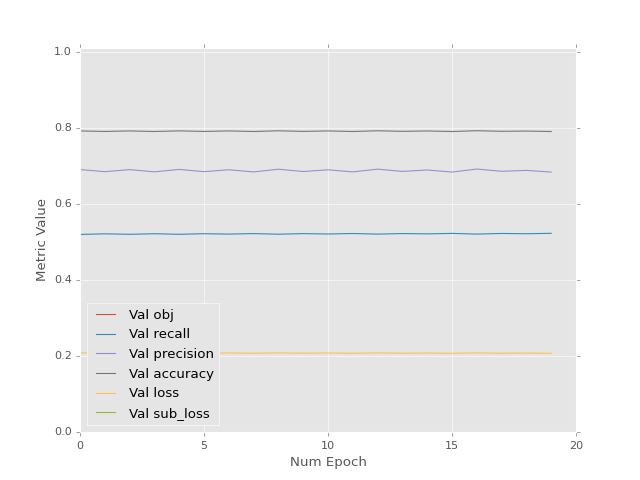

<IPython.core.display.Javascript object>


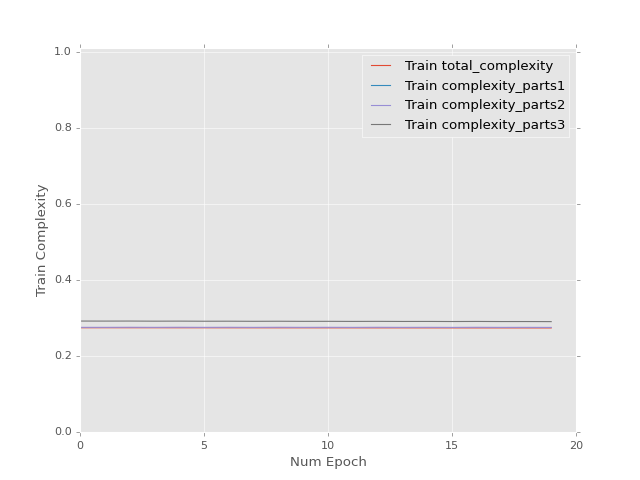

<IPython.core.display.Javascript object>


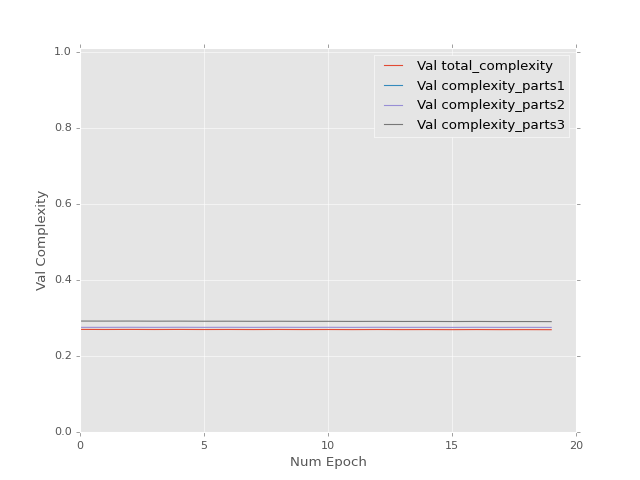

Epoch 1 of 20 took 5.485s
Epoch 2 of 20 took 6.097s
Epoch 3 of 20 took 6.000s
Epoch 4 of 20 took 5.660s
Epoch 5 of 20 took 5.606s
Epoch 6 of 20 took 5.795s
Epoch 7 of 20 took 5.635s
Epoch 8 of 20 took 5.433s
Epoch 9 of 20 took 5.945s
Epoch 10 of 20 took 6.001s
Epoch 11 of 20 took 5.715s
Epoch 12 of 20 took 5.937s
Epoch 13 of 20 took 5.795s
Epoch 14 of 20 took 5.727s
Epoch 15 of 20 took 5.814s
Epoch 16 of 20 took 5.658s
Epoch 17 of 20 took 5.466s
Epoch 18 of 20 took 5.626s
Epoch 19 of 20 took 5.624s
Epoch 20 of 20 took 6.059s
0.701267272234 [[ 1.17869937  0.38845417  0.55564058  1.21662271  0.45720717  0.67263108]]


<IPython.core.display.Javascript object>


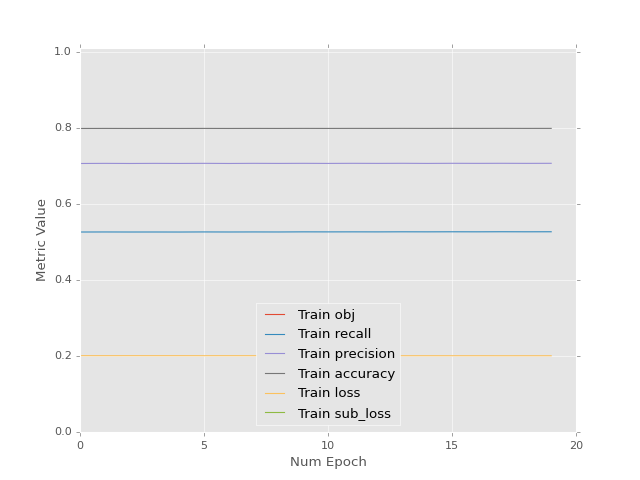

<IPython.core.display.Javascript object>


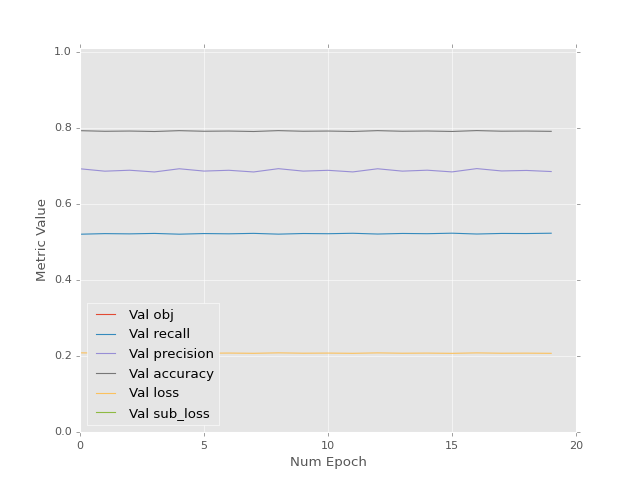

<IPython.core.display.Javascript object>


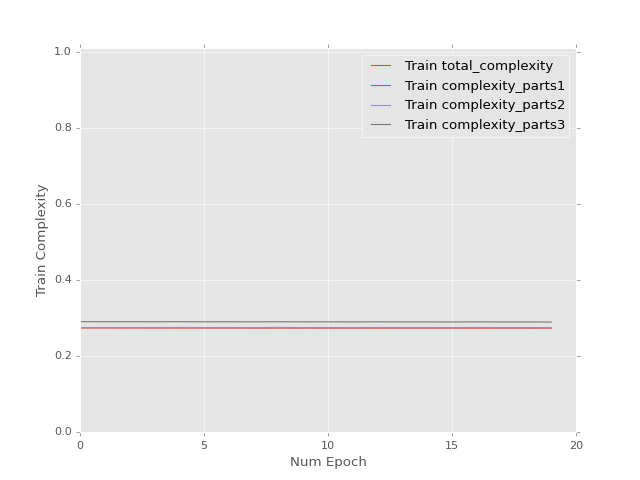

<IPython.core.display.Javascript object>


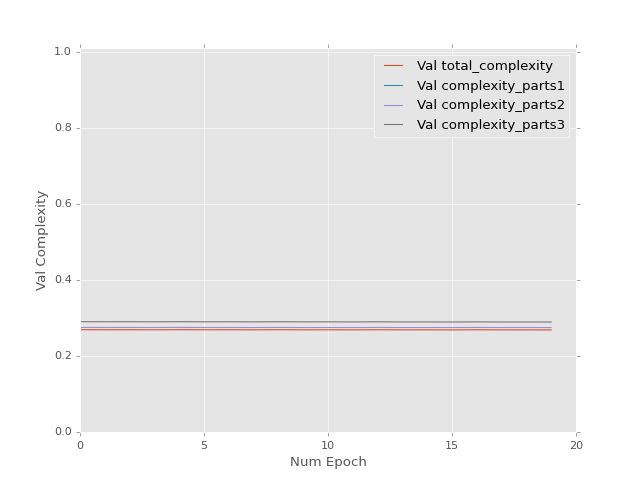

Epoch 1 of 20 took 5.481s
Epoch 2 of 20 took 5.514s
Epoch 3 of 20 took 5.757s
Epoch 4 of 20 took 5.429s
Epoch 5 of 20 took 5.724s
Epoch 6 of 20 took 5.777s
Epoch 7 of 20 took 5.908s
Epoch 8 of 20 took 5.572s
Epoch 9 of 20 took 5.435s
Epoch 10 of 20 took 5.653s
Epoch 11 of 20 took 5.613s
Epoch 12 of 20 took 5.876s
Epoch 13 of 20 took 5.678s
Epoch 14 of 20 took 5.984s
Epoch 15 of 20 took 5.632s
Epoch 16 of 20 took 5.938s
Epoch 17 of 20 took 6.044s
Epoch 18 of 20 took 5.447s
Epoch 19 of 20 took 5.775s
Epoch 20 of 20 took 5.802s
0.700603455305 [[ 1.17962348  0.38945183  0.55707932  1.21737635  0.45787594  0.67204797]]


<IPython.core.display.Javascript object>


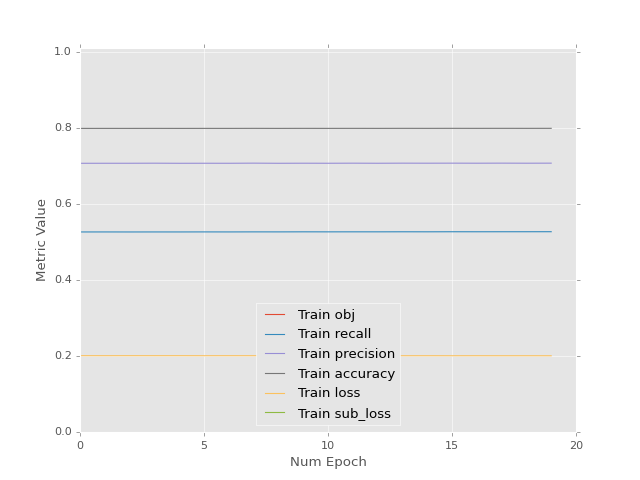

<IPython.core.display.Javascript object>


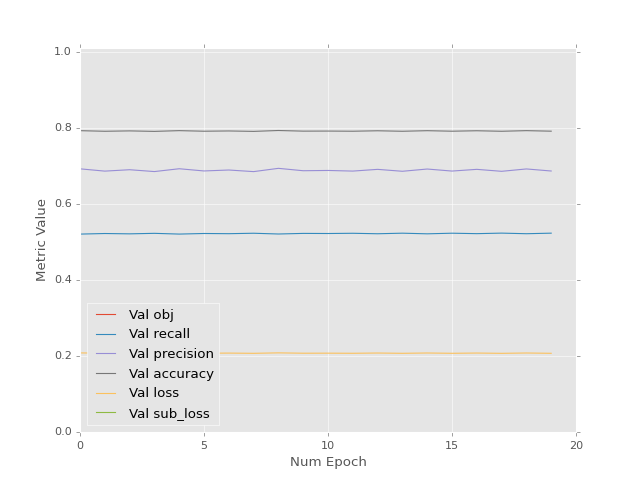

<IPython.core.display.Javascript object>


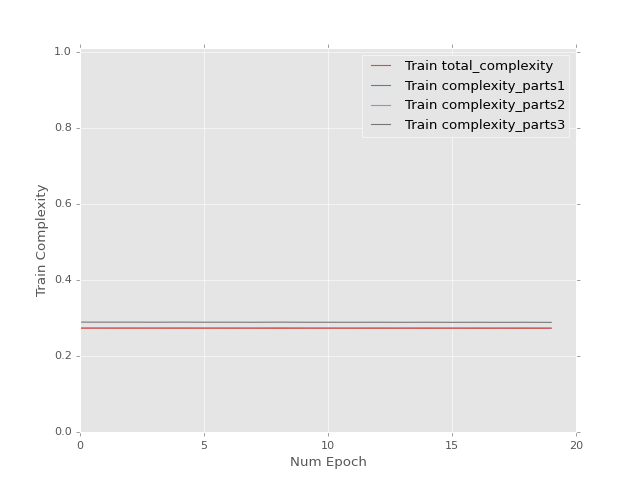

<IPython.core.display.Javascript object>


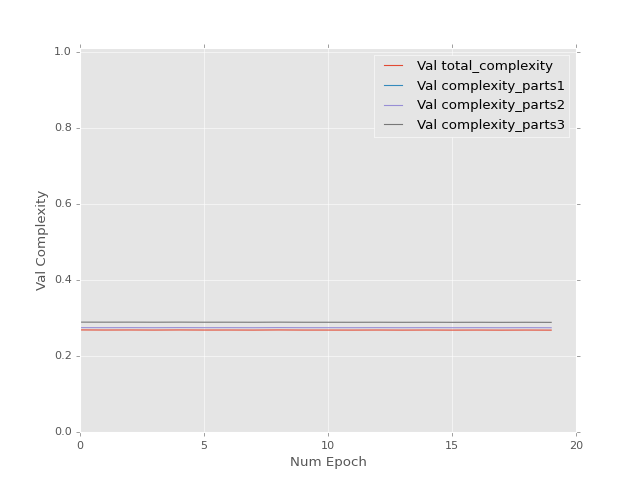

Epoch 1 of 20 took 5.862s
Epoch 2 of 20 took 5.922s
Epoch 3 of 20 took 5.689s
Epoch 4 of 20 took 5.738s
Epoch 5 of 20 took 5.601s
Epoch 6 of 20 took 5.639s
Epoch 7 of 20 took 5.644s
Epoch 8 of 20 took 5.522s
Epoch 9 of 20 took 5.478s
Epoch 10 of 20 took 5.644s
Epoch 11 of 20 took 5.631s
Epoch 12 of 20 took 5.878s
Epoch 13 of 20 took 5.996s
Epoch 14 of 20 took 5.723s
Epoch 15 of 20 took 5.811s
Epoch 16 of 20 took 5.803s
Epoch 17 of 20 took 5.715s
Epoch 18 of 20 took 5.734s
Epoch 19 of 20 took 6.012s
Epoch 20 of 20 took 5.658s
0.699821591377 [[ 1.18072128  0.39063692  0.55878305  1.21827185  0.45867068  0.67135525]]


<IPython.core.display.Javascript object>


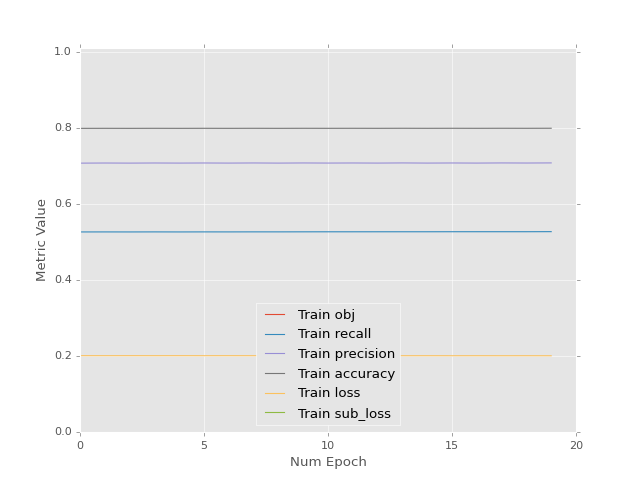

<IPython.core.display.Javascript object>


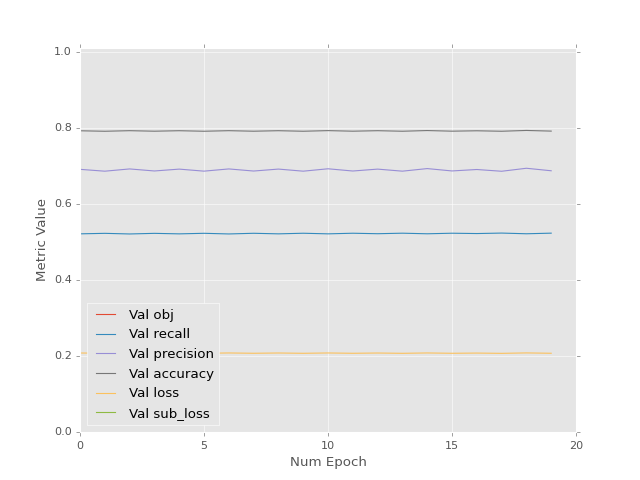

<IPython.core.display.Javascript object>


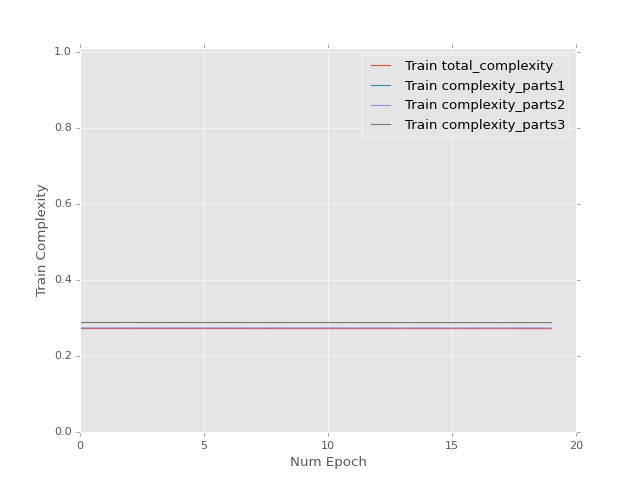

<IPython.core.display.Javascript object>


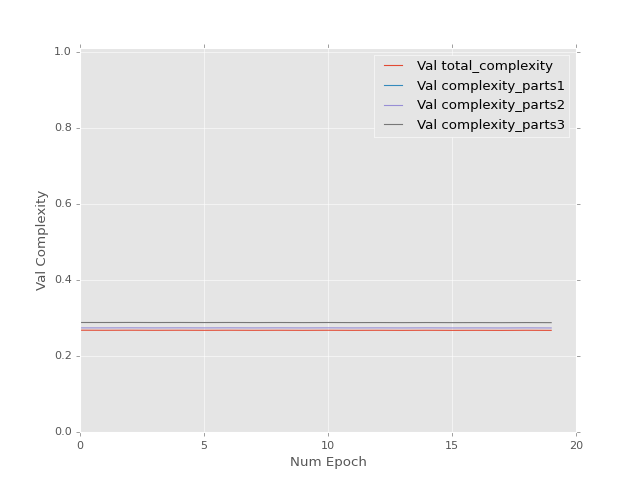

Epoch 1 of 20 took 5.898s
Epoch 2 of 20 took 5.452s
Epoch 3 of 20 took 5.562s
Epoch 4 of 20 took 5.818s
Epoch 5 of 20 took 5.432s
Epoch 6 of 20 took 5.443s
Epoch 7 of 20 took 5.439s
Epoch 8 of 20 took 5.609s
Epoch 9 of 20 took 5.569s
Epoch 10 of 20 took 5.863s
Epoch 11 of 20 took 5.437s
Epoch 12 of 20 took 5.893s
Epoch 13 of 20 took 5.511s
Epoch 14 of 20 took 5.726s
Epoch 15 of 20 took 5.823s
Epoch 16 of 20 took 5.646s
Epoch 17 of 20 took 5.915s
Epoch 18 of 20 took 5.643s
Epoch 19 of 20 took 5.656s
Epoch 20 of 20 took 5.500s
0.698878198862 [[ 1.18205822  0.39207977  0.56085008  1.21936262  0.45963883  0.67051172]]


<IPython.core.display.Javascript object>


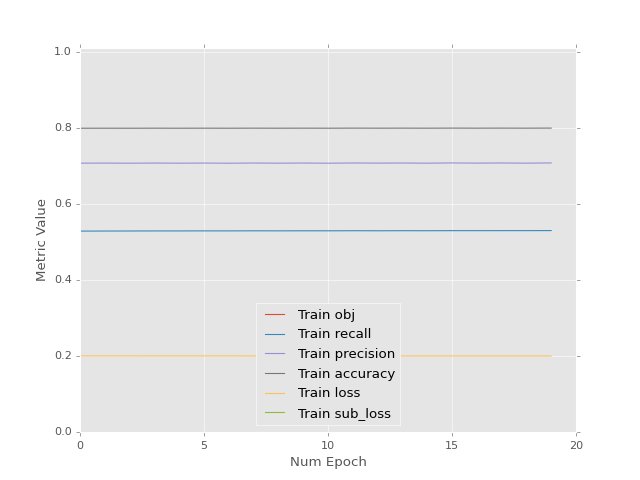

<IPython.core.display.Javascript object>


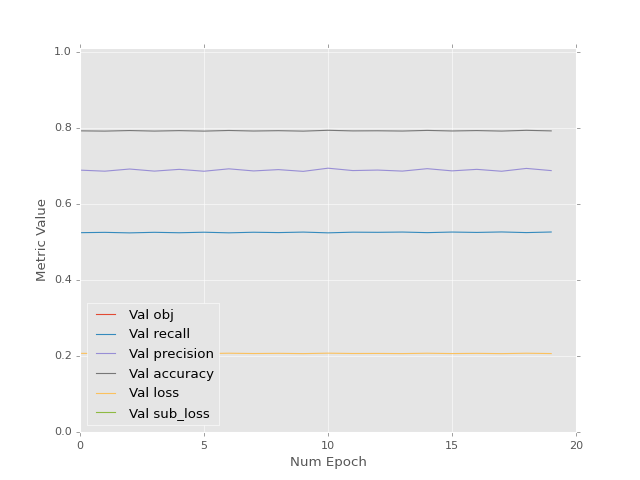

<IPython.core.display.Javascript object>


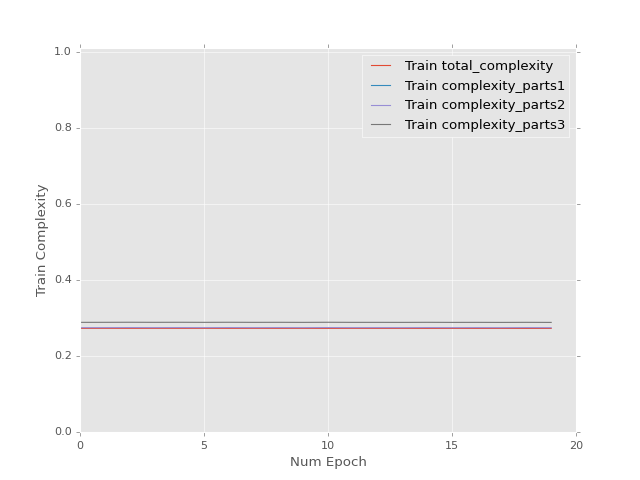

<IPython.core.display.Javascript object>


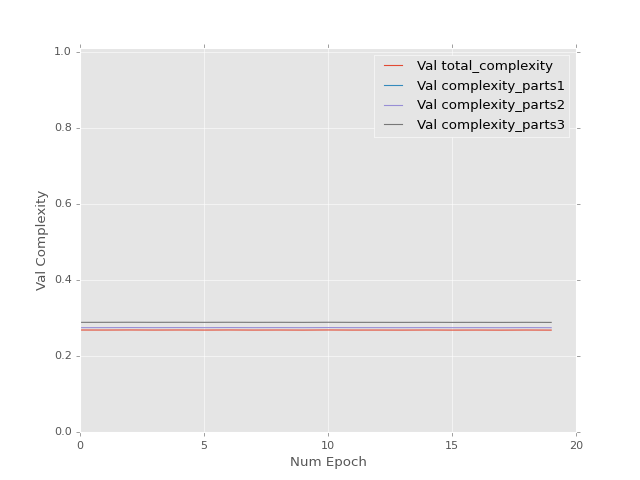

Epoch 1 of 20 took 5.686s
Epoch 2 of 20 took 5.677s
Epoch 3 of 20 took 5.436s
Epoch 4 of 20 took 6.005s
Epoch 5 of 20 took 5.616s
Epoch 6 of 20 took 5.998s
Epoch 7 of 20 took 5.885s
Epoch 8 of 20 took 5.759s
Epoch 9 of 20 took 5.809s
Epoch 10 of 20 took 5.797s
Epoch 11 of 20 took 5.967s
Epoch 12 of 20 took 5.746s
Epoch 13 of 20 took 5.780s
Epoch 14 of 20 took 5.678s
Epoch 15 of 20 took 5.465s
Epoch 16 of 20 took 5.512s
Epoch 17 of 20 took 5.437s
Epoch 18 of 20 took 5.770s
Epoch 19 of 20 took 5.720s
Epoch 20 of 20 took 5.827s
0.70147973299 [[ 1.17864013  0.38874438  0.5579856   1.2157532   0.4559325   0.67431581]]


<IPython.core.display.Javascript object>


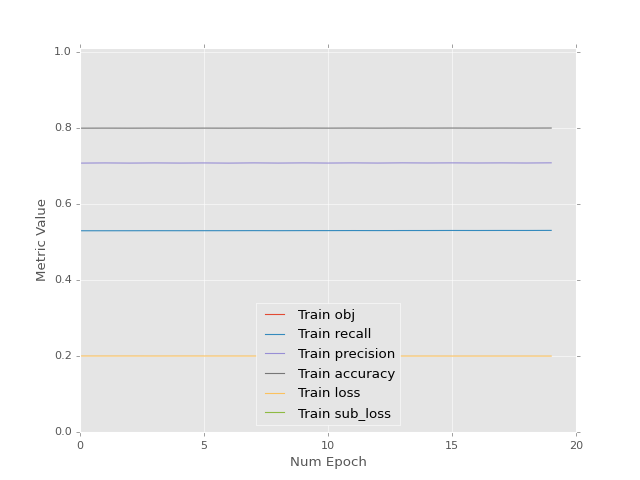

<IPython.core.display.Javascript object>


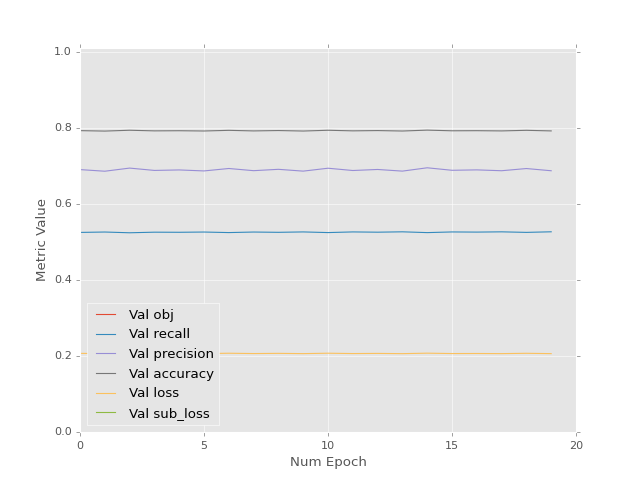

<IPython.core.display.Javascript object>


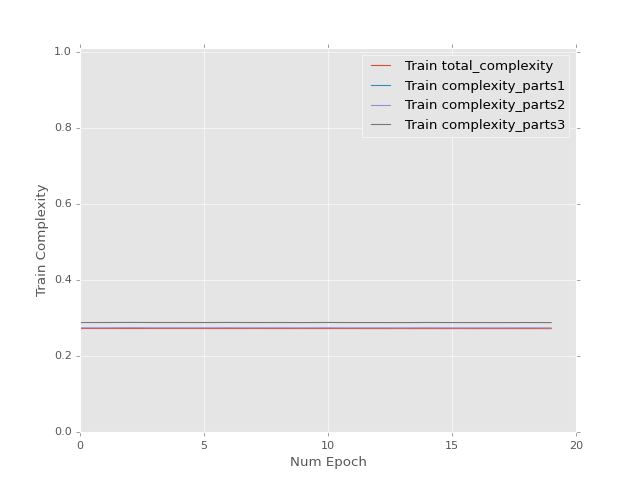

<IPython.core.display.Javascript object>


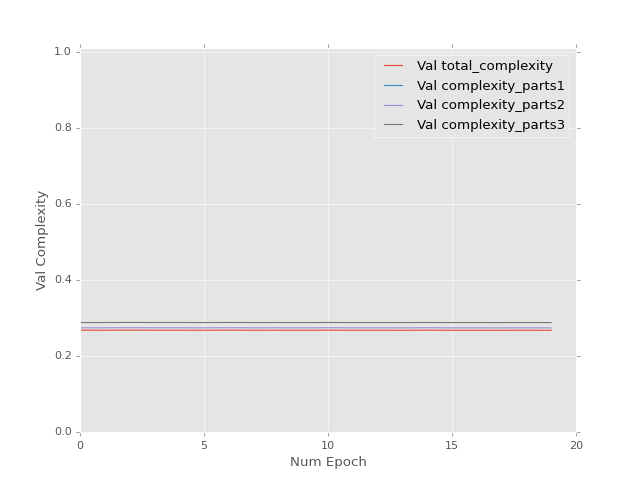

Epoch 1 of 20 took 5.431s
Epoch 2 of 20 took 5.732s
Epoch 3 of 20 took 5.897s
Epoch 4 of 20 took 5.654s
Epoch 5 of 20 took 5.502s
Epoch 6 of 20 took 5.477s
Epoch 7 of 20 took 5.961s
Epoch 8 of 20 took 5.746s
Epoch 9 of 20 took 5.769s
Epoch 10 of 20 took 5.519s
Epoch 11 of 20 took 6.029s
Epoch 12 of 20 took 5.692s
Epoch 13 of 20 took 5.911s
Epoch 14 of 20 took 5.704s
Epoch 15 of 20 took 5.757s
Epoch 16 of 20 took 5.834s
Epoch 17 of 20 took 5.615s
Epoch 18 of 20 took 5.654s
Epoch 19 of 20 took 5.789s
Epoch 20 of 20 took 5.558s
0.700852036476 [[ 1.17951047  0.38968506  0.55933458  1.21646345  0.45656225  0.67376715]]


<IPython.core.display.Javascript object>


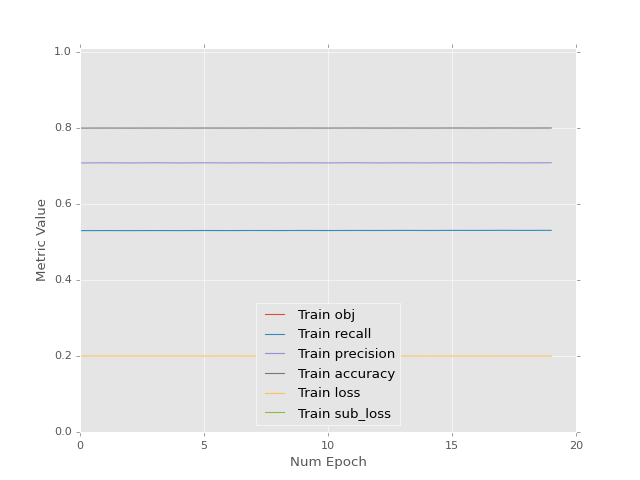

<IPython.core.display.Javascript object>


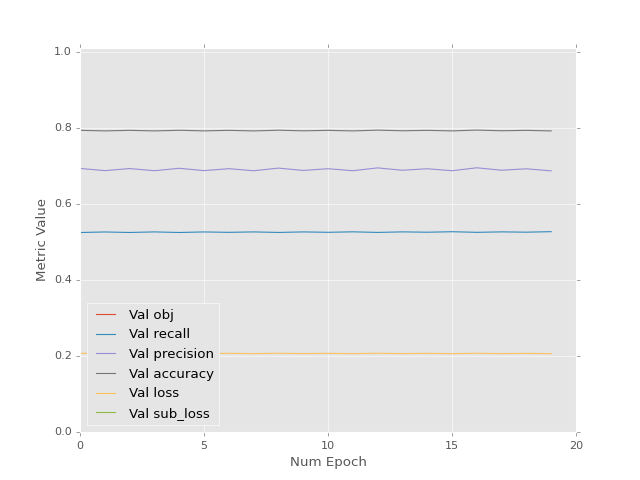

<IPython.core.display.Javascript object>


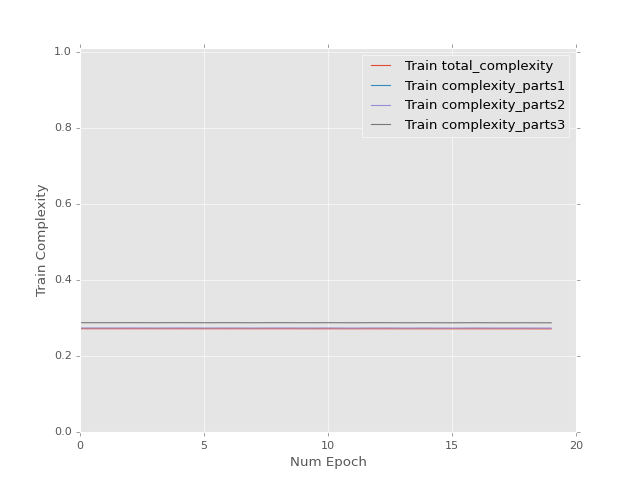

<IPython.core.display.Javascript object>


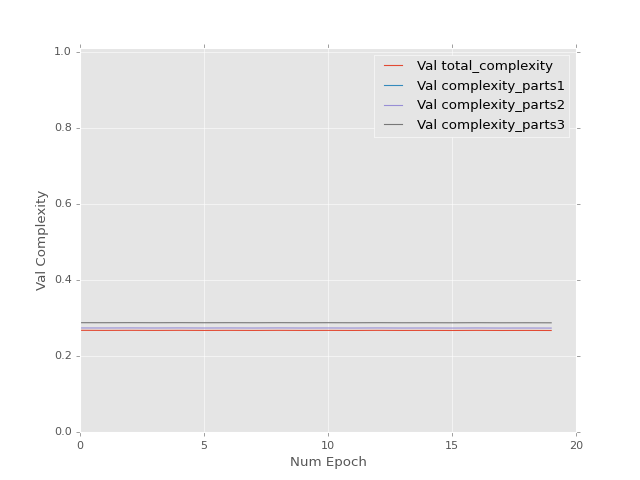

Epoch 1 of 20 took 5.672s
Epoch 2 of 20 took 5.919s
Epoch 3 of 20 took 5.694s
Epoch 4 of 20 took 5.675s
Epoch 5 of 20 took 5.470s
Epoch 6 of 20 took 5.679s
Epoch 7 of 20 took 5.767s
Epoch 8 of 20 took 5.651s
Epoch 9 of 20 took 5.716s
Epoch 10 of 20 took 5.701s
Epoch 11 of 20 took 5.640s
Epoch 12 of 20 took 5.432s
Epoch 13 of 20 took 5.512s
Epoch 14 of 20 took 5.653s
Epoch 15 of 20 took 5.478s
Epoch 16 of 20 took 5.438s
Epoch 17 of 20 took 5.595s
Epoch 18 of 20 took 5.649s
Epoch 19 of 20 took 5.920s
Epoch 20 of 20 took 6.046s
0.700121432543 [[ 1.18053305  0.39078993  0.56091446  1.21729779  0.45730227  0.6731227 ]]


<IPython.core.display.Javascript object>


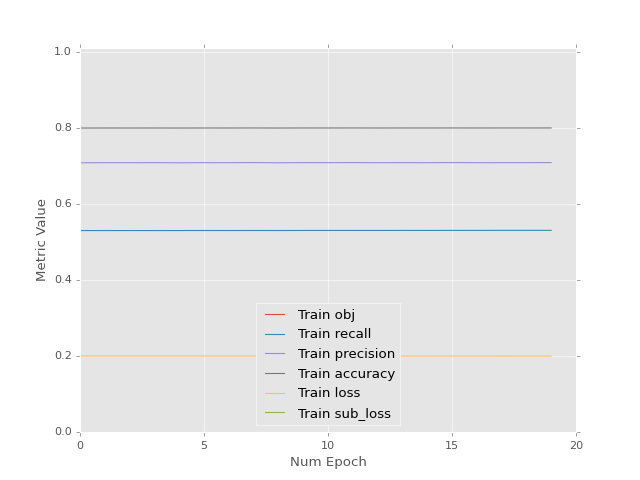

<IPython.core.display.Javascript object>


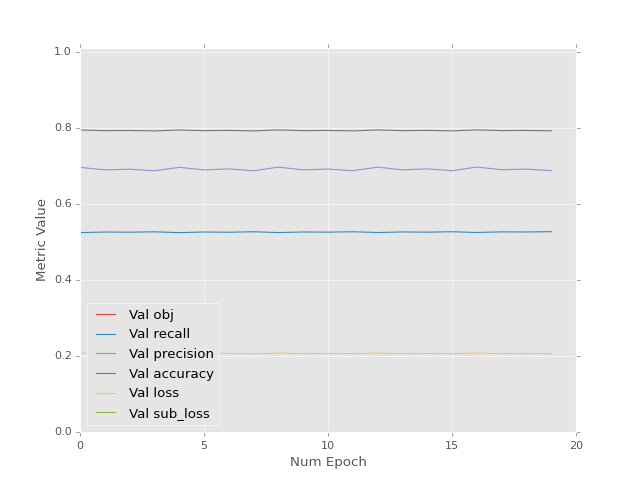

<IPython.core.display.Javascript object>


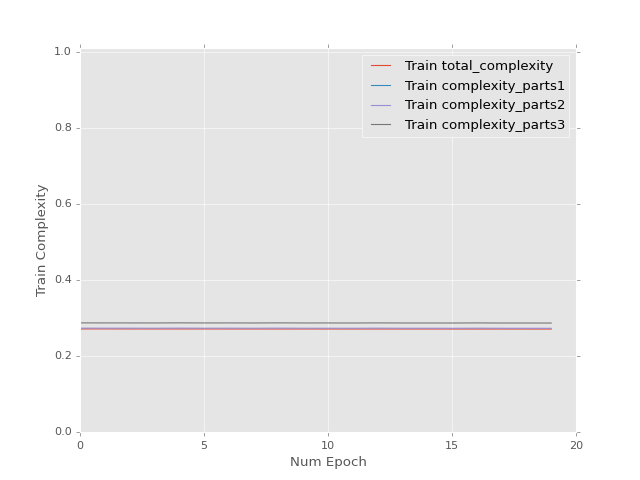

<IPython.core.display.Javascript object>


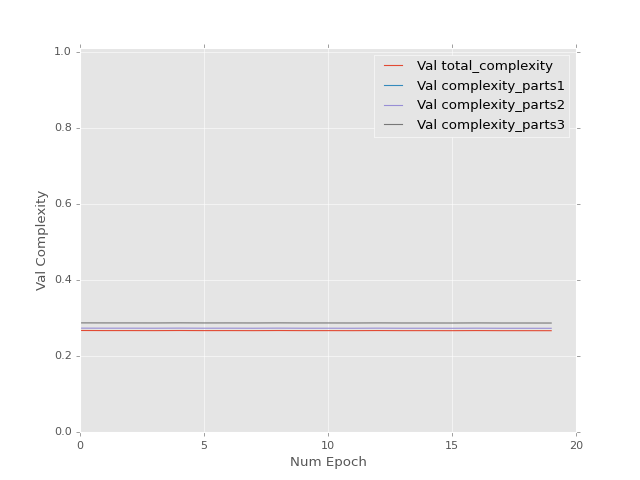

Epoch 1 of 20 took 5.818s
Epoch 2 of 20 took 5.878s
Epoch 3 of 20 took 5.665s
Epoch 4 of 20 took 5.856s
Epoch 5 of 20 took 5.708s
Epoch 6 of 20 took 5.964s
Epoch 7 of 20 took 5.827s
Epoch 8 of 20 took 5.818s
Epoch 9 of 20 took 6.051s
Epoch 10 of 20 took 5.900s
Epoch 11 of 20 took 5.653s
Epoch 12 of 20 took 5.831s
Epoch 13 of 20 took 5.712s
Epoch 14 of 20 took 5.820s
Epoch 15 of 20 took 6.065s
Epoch 16 of 20 took 5.518s
Epoch 17 of 20 took 5.883s
Epoch 18 of 20 took 5.743s
Epoch 19 of 20 took 5.863s
Epoch 20 of 20 took 5.437s
0.699247092009 [[ 1.18176723  0.39212325  0.56281483  1.21830499  0.45819575  0.67234492]]


<IPython.core.display.Javascript object>


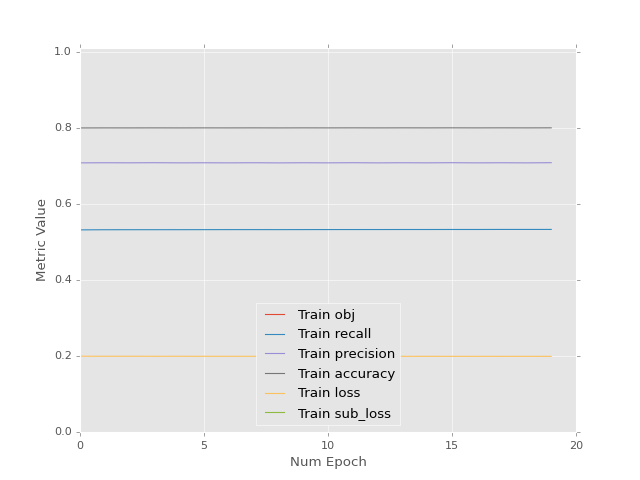

<IPython.core.display.Javascript object>


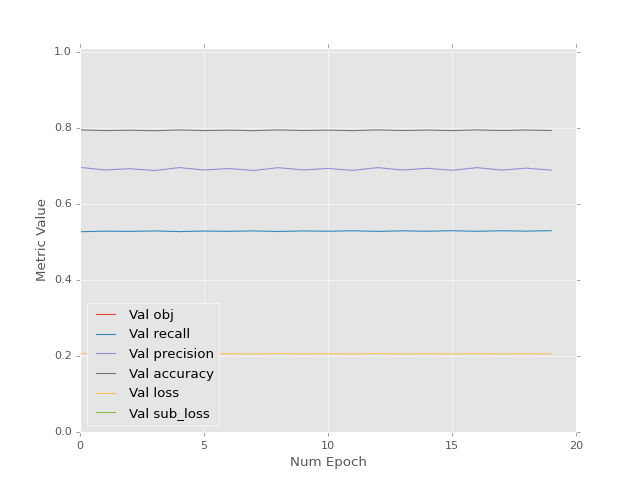

<IPython.core.display.Javascript object>


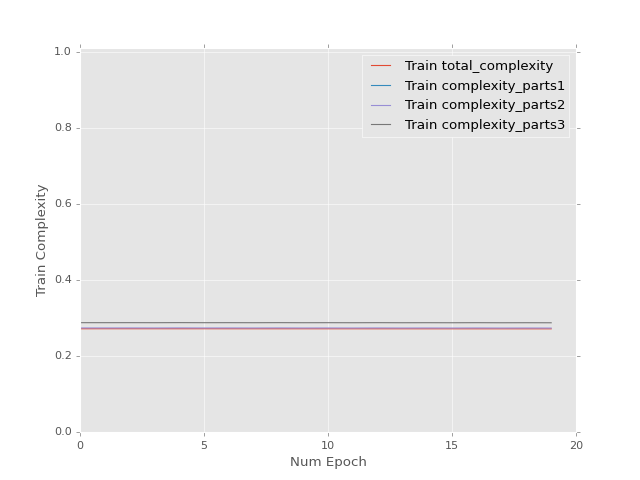

<IPython.core.display.Javascript object>


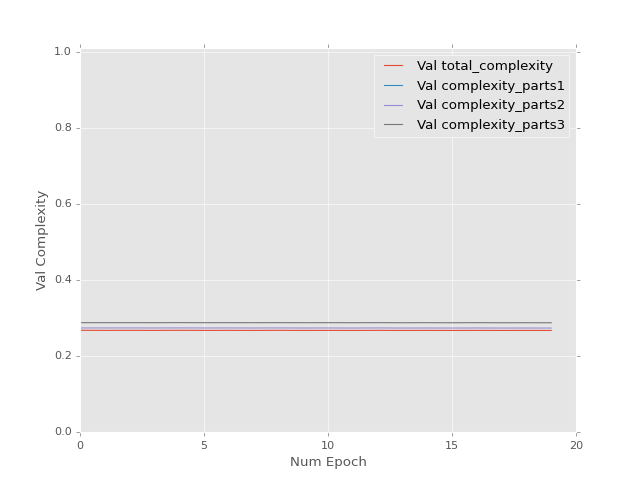

Epoch 1 of 20 took 5.922s
Epoch 2 of 20 took 5.807s
Epoch 3 of 20 took 5.513s
Epoch 4 of 20 took 5.969s
Epoch 5 of 20 took 5.854s
Epoch 6 of 20 took 5.432s
Epoch 7 of 20 took 5.868s
Epoch 8 of 20 took 5.941s
Epoch 9 of 20 took 5.902s
Epoch 10 of 20 took 5.737s
Epoch 11 of 20 took 5.853s
Epoch 12 of 20 took 6.090s
Epoch 13 of 20 took 5.947s
Epoch 14 of 20 took 5.720s
Epoch 15 of 20 took 6.028s
Epoch 16 of 20 took 5.605s
Epoch 17 of 20 took 5.578s
Epoch 18 of 20 took 5.978s
Epoch 19 of 20 took 5.656s
Epoch 20 of 20 took 5.499s
0.70173740387 [[ 1.17851734  0.38897002  0.56019932  1.21483278  0.45461076  0.67604399]]


<IPython.core.display.Javascript object>


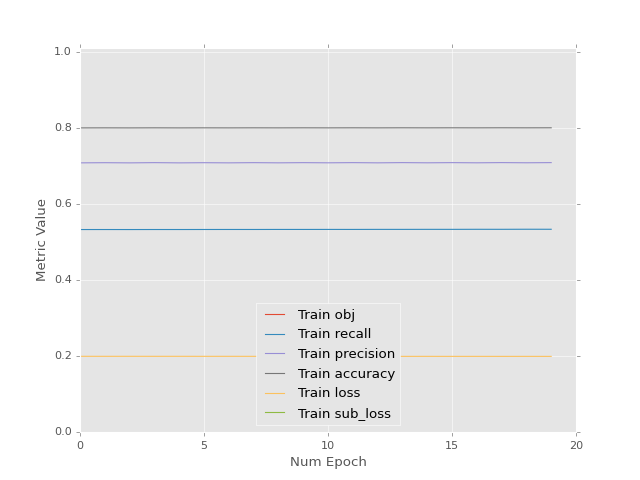

<IPython.core.display.Javascript object>


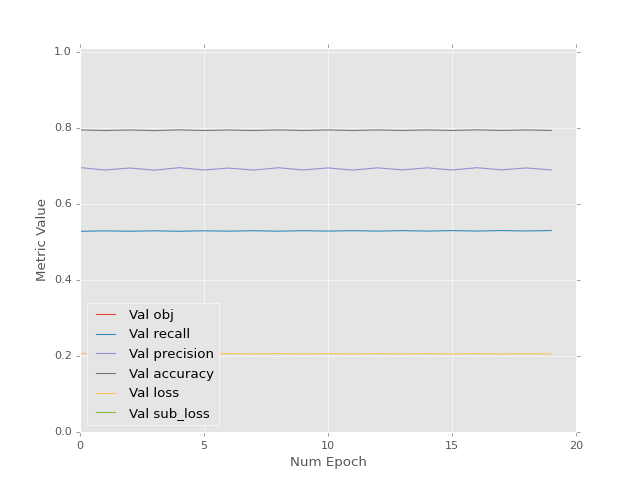

<IPython.core.display.Javascript object>


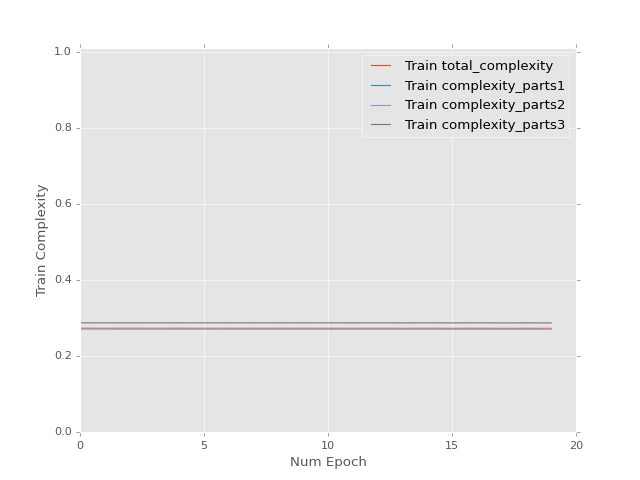

<IPython.core.display.Javascript object>


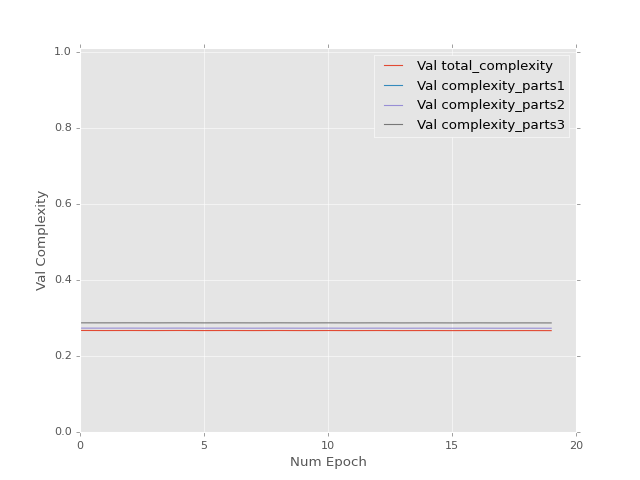

Epoch 1 of 20 took 6.061s
Epoch 2 of 20 took 5.654s
Epoch 3 of 20 took 5.727s
Epoch 4 of 20 took 5.720s
Epoch 5 of 20 took 5.917s
Epoch 6 of 20 took 5.760s
Epoch 7 of 20 took 5.434s
Epoch 8 of 20 took 5.769s
Epoch 9 of 20 took 6.011s
Epoch 10 of 20 took 5.990s
Epoch 11 of 20 took 5.604s
Epoch 12 of 20 took 6.088s
Epoch 13 of 20 took 5.450s
Epoch 14 of 20 took 5.874s
Epoch 15 of 20 took 5.894s
Epoch 16 of 20 took 5.949s
Epoch 17 of 20 took 5.785s
Epoch 18 of 20 took 5.713s
Epoch 19 of 20 took 5.448s
Epoch 20 of 20 took 5.797s
0.701135158539 [[ 1.17935026  0.38987076  0.56148344  1.21551239  0.45521325  0.67551941]]


<IPython.core.display.Javascript object>


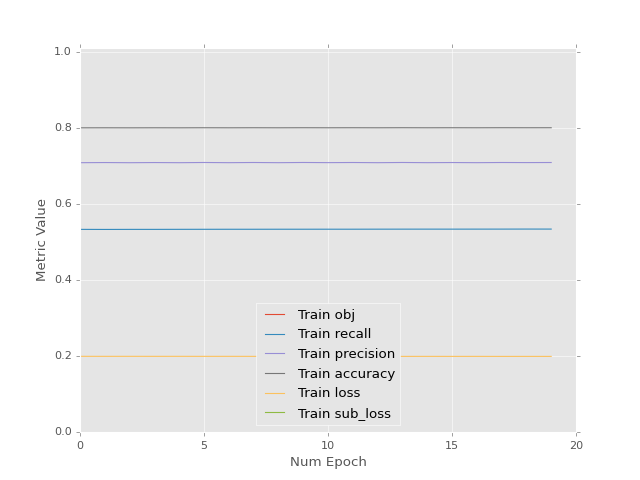

<IPython.core.display.Javascript object>


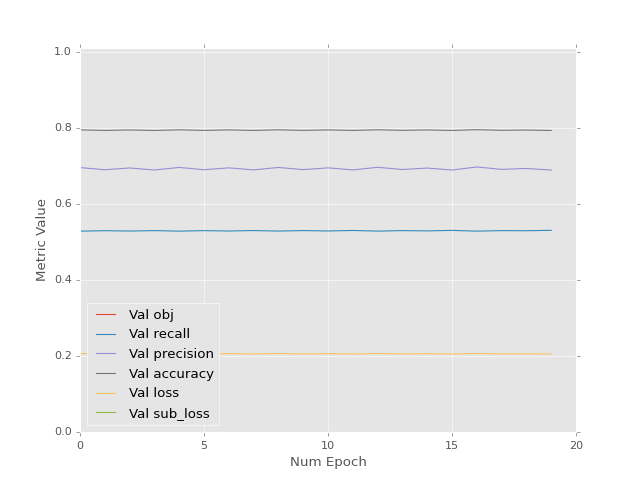

<IPython.core.display.Javascript object>


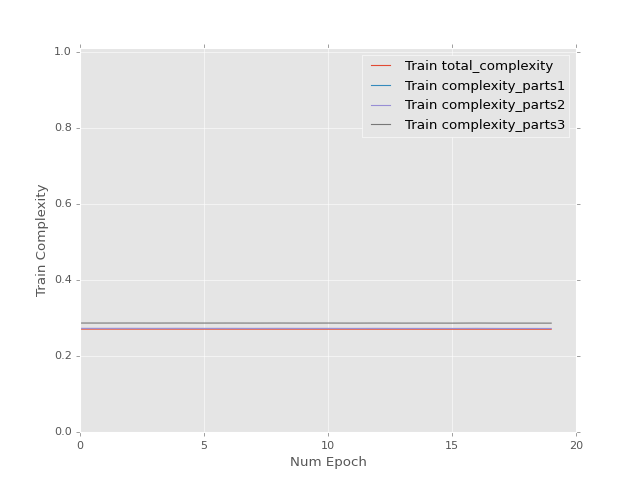

<IPython.core.display.Javascript object>


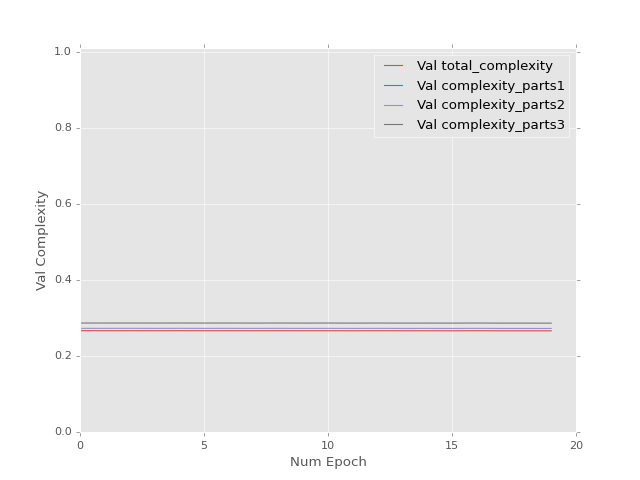

Epoch 1 of 20 took 5.660s
Epoch 2 of 20 took 5.663s
Epoch 3 of 20 took 5.828s
Epoch 4 of 20 took 5.440s
Epoch 5 of 20 took 5.947s
Epoch 6 of 20 took 5.533s
Epoch 7 of 20 took 5.814s
Epoch 8 of 20 took 5.654s
Epoch 9 of 20 took 5.873s
Epoch 10 of 20 took 5.842s
Epoch 11 of 20 took 5.804s
Epoch 12 of 20 took 5.903s
Epoch 13 of 20 took 5.953s
Epoch 14 of 20 took 5.824s
Epoch 15 of 20 took 5.735s
Epoch 16 of 20 took 5.695s
Epoch 17 of 20 took 5.920s
Epoch 18 of 20 took 5.785s
Epoch 19 of 20 took 5.806s
Epoch 20 of 20 took 6.094s
0.700440764427 [[ 1.18031955  0.39091888  0.56297368  1.21630371  0.4559145   0.67490911]]


<IPython.core.display.Javascript object>


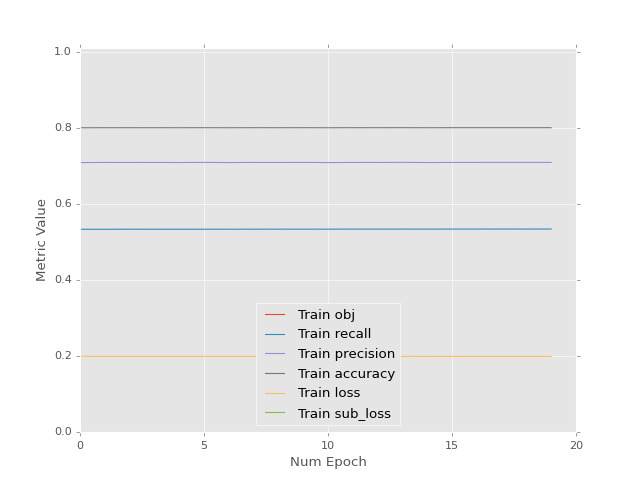

<IPython.core.display.Javascript object>


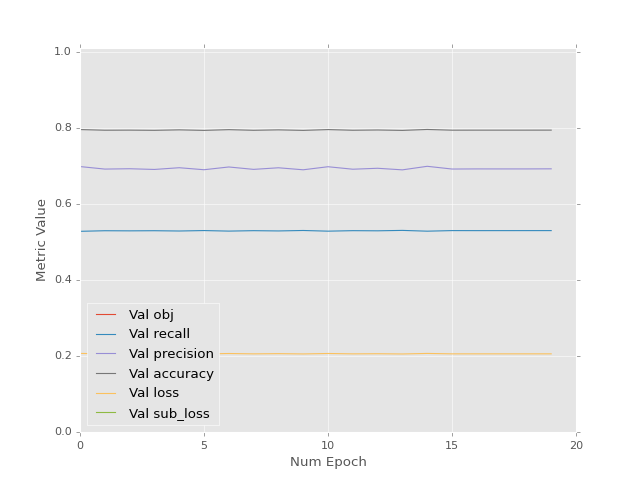

<IPython.core.display.Javascript object>


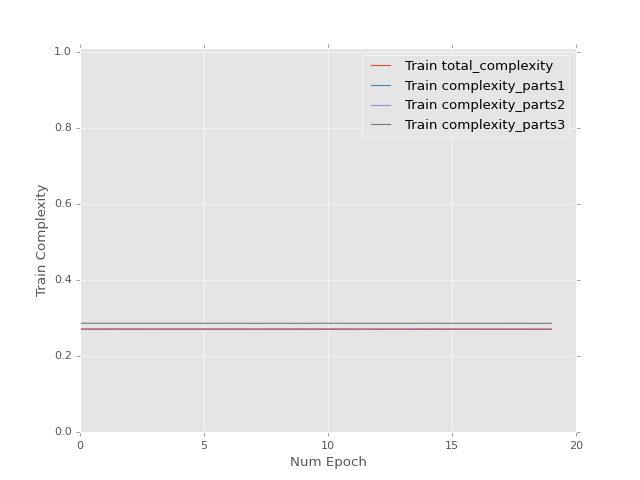

<IPython.core.display.Javascript object>


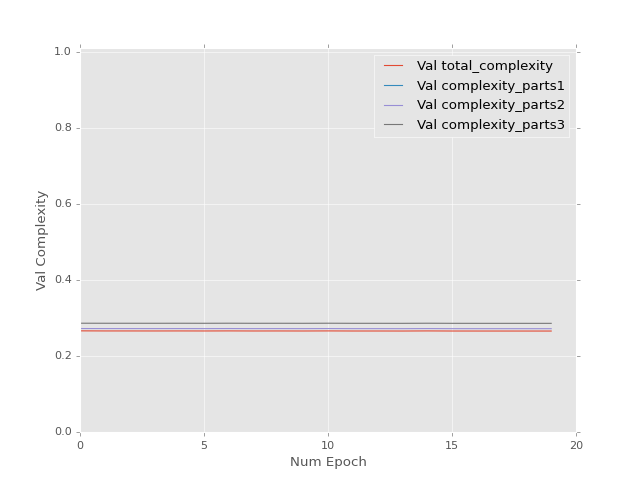

Epoch 1 of 20 took 5.960s
Epoch 2 of 20 took 5.470s
Epoch 3 of 20 took 5.639s
Epoch 4 of 20 took 5.551s
Epoch 5 of 20 took 5.813s
Epoch 6 of 20 took 5.937s
Epoch 7 of 20 took 5.766s
Epoch 8 of 20 took 5.535s
Epoch 9 of 20 took 5.436s
Epoch 10 of 20 took 5.978s
Epoch 11 of 20 took 5.701s
Epoch 12 of 20 took 6.067s
Epoch 13 of 20 took 5.732s
Epoch 14 of 20 took 5.595s
Epoch 15 of 20 took 5.854s
Epoch 16 of 20 took 5.954s
Epoch 17 of 20 took 5.779s
Epoch 18 of 20 took 5.847s
Epoch 19 of 20 took 5.960s
Epoch 20 of 20 took 6.013s
0.699616134167 [[ 1.18148041  0.39217401  0.56475294  1.21725154  0.4567546   0.6741783 ]]


<IPython.core.display.Javascript object>


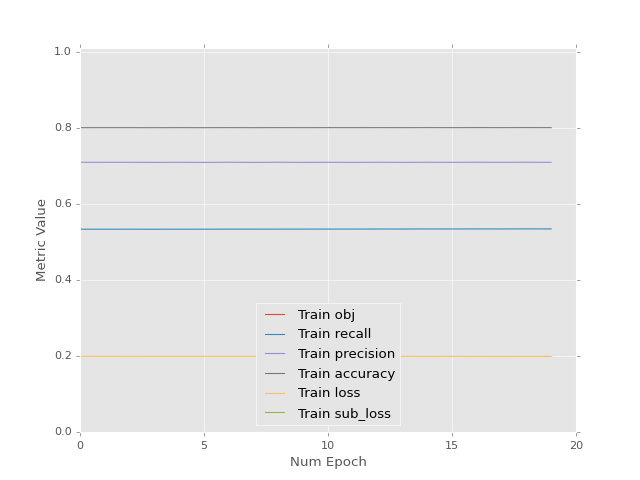

<IPython.core.display.Javascript object>


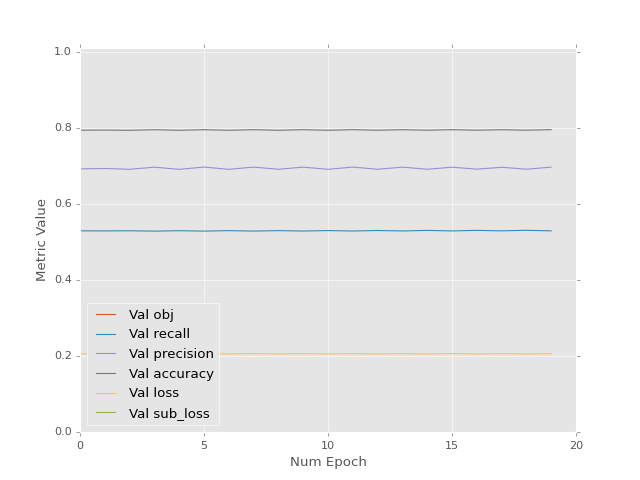

<IPython.core.display.Javascript object>


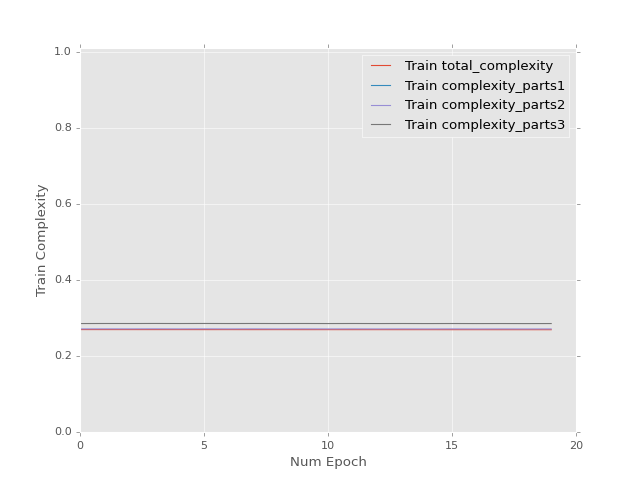

<IPython.core.display.Javascript object>


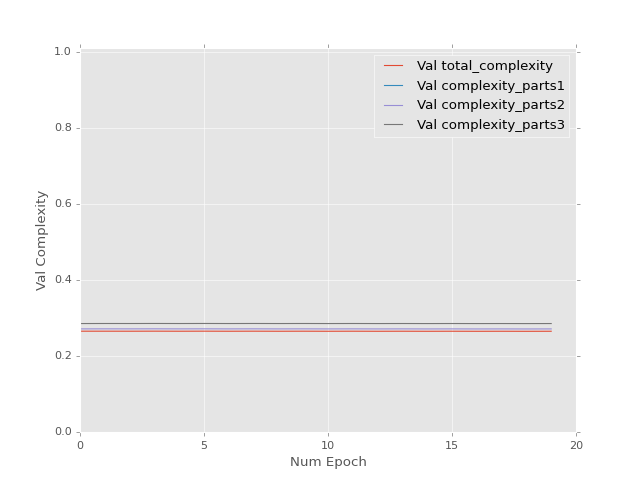

Epoch 1 of 20 took 6.010s
Epoch 2 of 20 took 5.971s
Epoch 3 of 20 took 5.639s
Epoch 4 of 20 took 6.007s
Epoch 5 of 20 took 6.156s
Epoch 6 of 20 took 5.766s
Epoch 7 of 20 took 5.624s
Epoch 8 of 20 took 5.748s
Epoch 9 of 20 took 5.630s
Epoch 10 of 20 took 5.500s
Epoch 11 of 20 took 5.431s
Epoch 12 of 20 took 5.754s
Epoch 13 of 20 took 5.953s
Epoch 14 of 20 took 5.560s
Epoch 15 of 20 took 5.507s
Epoch 16 of 20 took 5.445s
Epoch 17 of 20 took 5.730s
Epoch 18 of 20 took 5.432s
Epoch 19 of 20 took 5.954s
Epoch 20 of 20 took 5.979s
0.698615729809 [[ 1.18290281  0.39371145  0.56692475  1.21841311  0.45778435  0.67328286]]


<IPython.core.display.Javascript object>


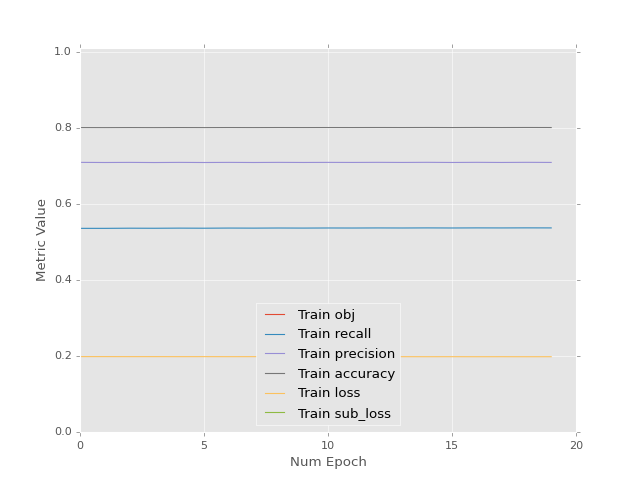

<IPython.core.display.Javascript object>


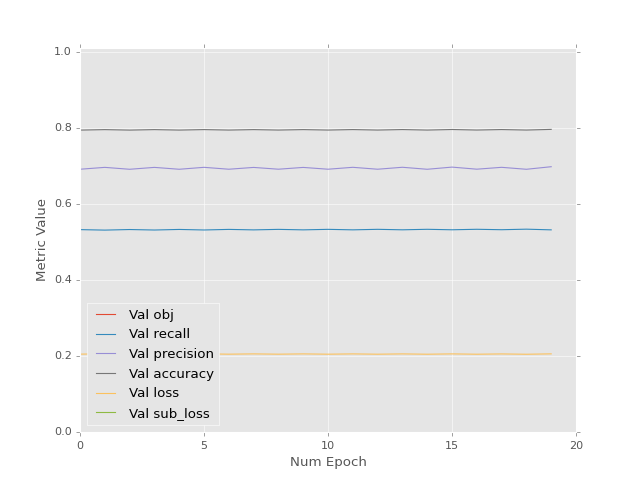

<IPython.core.display.Javascript object>


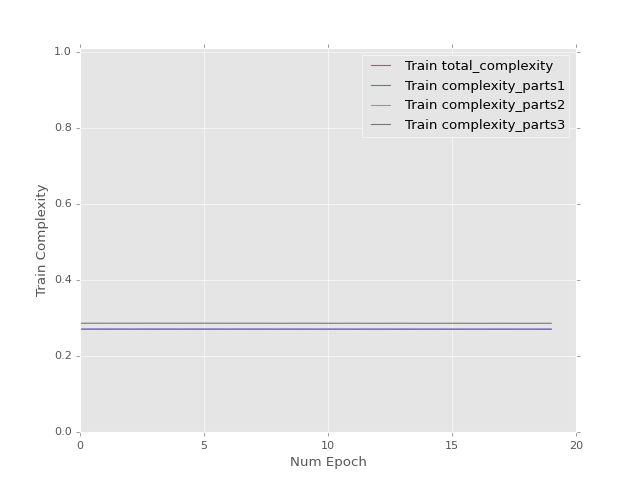

<IPython.core.display.Javascript object>


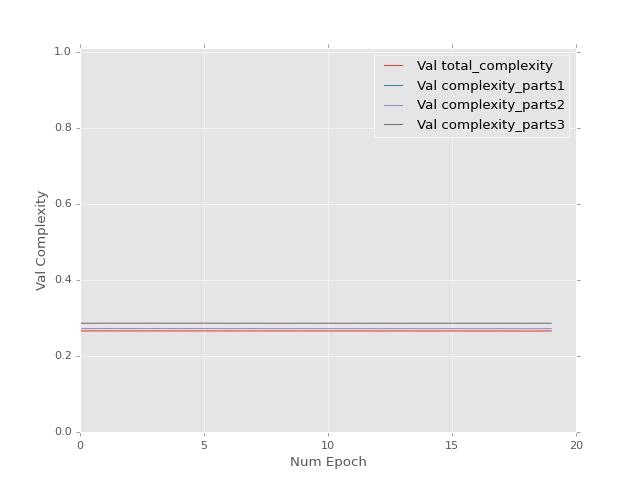

Epoch 1 of 20 took 5.756s
Epoch 2 of 20 took 5.517s
Epoch 3 of 20 took 5.664s
Epoch 4 of 20 took 5.430s
Epoch 5 of 20 took 5.533s
Epoch 6 of 20 took 5.422s
Epoch 7 of 20 took 5.600s
Epoch 8 of 20 took 5.697s
Epoch 9 of 20 took 5.675s
Epoch 10 of 20 took 5.783s
Epoch 11 of 20 took 5.765s
Epoch 12 of 20 took 5.593s
Epoch 13 of 20 took 5.835s
Epoch 14 of 20 took 5.991s
Epoch 15 of 20 took 5.591s
Epoch 16 of 20 took 5.664s
Epoch 17 of 20 took 6.035s
Epoch 18 of 20 took 5.580s
Epoch 19 of 20 took 6.174s
Epoch 20 of 20 took 5.864s
0.701420664787 [[ 1.17919362  0.39006373  0.56360126  1.21456623  0.45386624  0.67727178]]


<IPython.core.display.Javascript object>


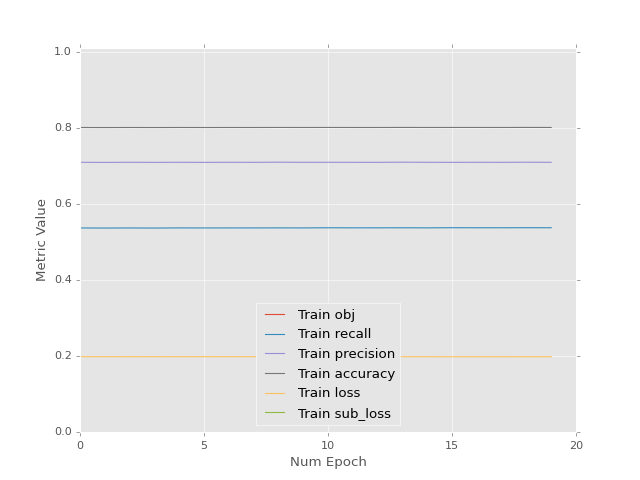

<IPython.core.display.Javascript object>


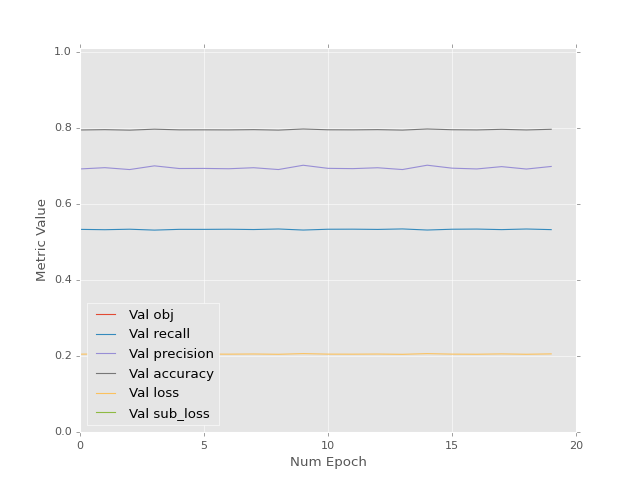

<IPython.core.display.Javascript object>


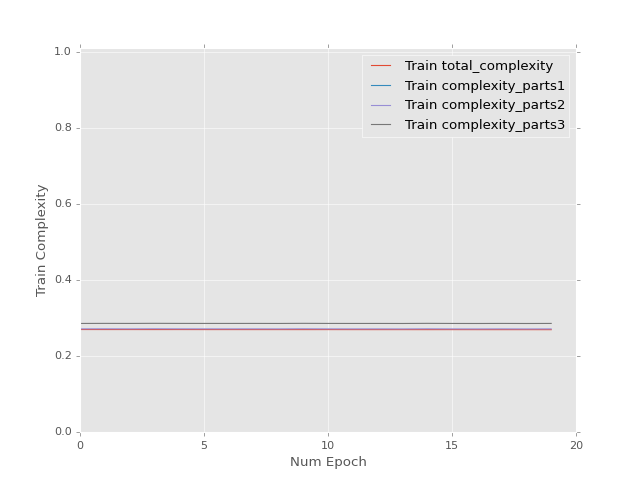

<IPython.core.display.Javascript object>


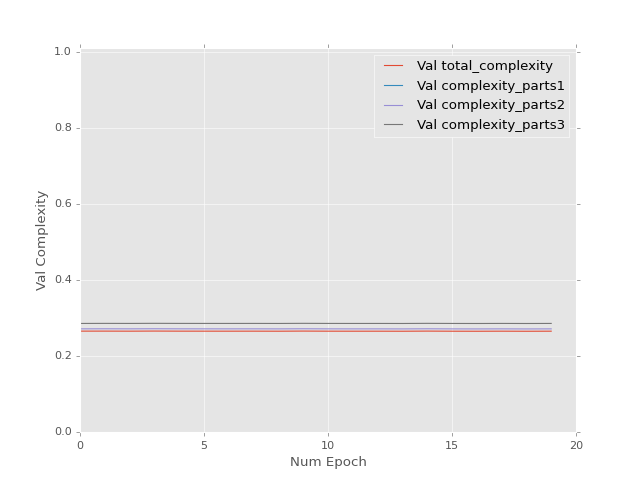

Epoch 1 of 20 took 5.586s
Epoch 2 of 20 took 5.695s
Epoch 3 of 20 took 5.600s
Epoch 4 of 20 took 5.451s
Epoch 5 of 20 took 5.736s
Epoch 6 of 20 took 5.590s
Epoch 7 of 20 took 5.975s
Epoch 8 of 20 took 5.599s
Epoch 9 of 20 took 5.717s
Epoch 10 of 20 took 6.066s
Epoch 11 of 20 took 6.015s
Epoch 12 of 20 took 5.487s
Epoch 13 of 20 took 5.746s
Epoch 14 of 20 took 5.786s
Epoch 15 of 20 took 6.055s
Epoch 16 of 20 took 5.691s
Epoch 17 of 20 took 5.591s
Epoch 18 of 20 took 5.448s
Epoch 19 of 20 took 5.600s
Epoch 20 of 20 took 5.911s
0.700759589672 [[ 1.18011594  0.39106205  0.56501126  1.21531963  0.45453364  0.67669123]]


<IPython.core.display.Javascript object>


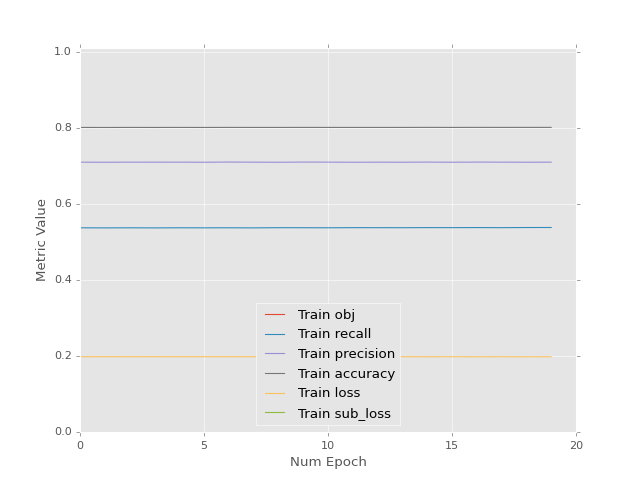

<IPython.core.display.Javascript object>


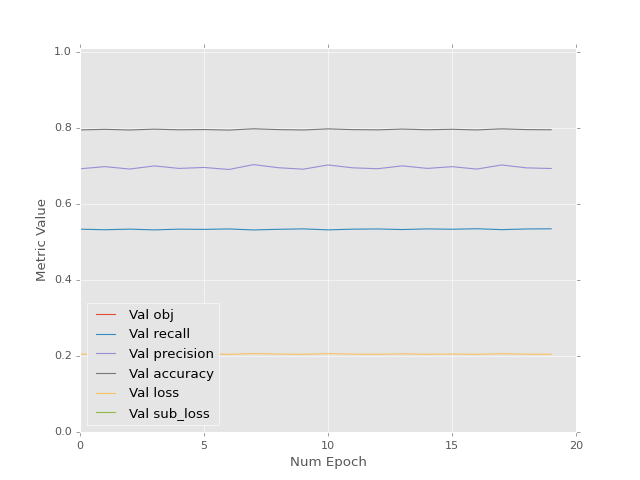

<IPython.core.display.Javascript object>


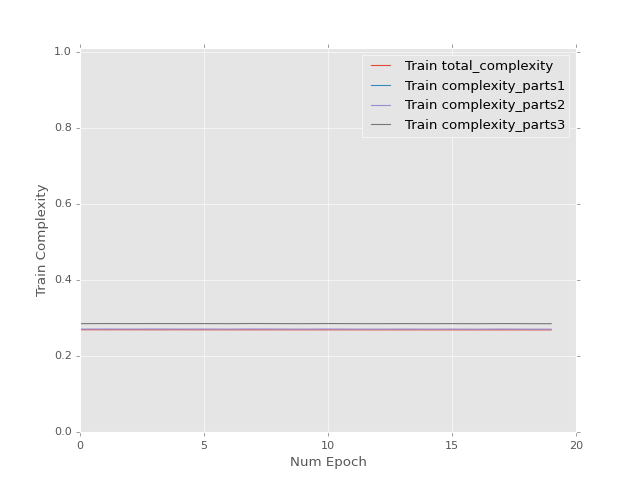

<IPython.core.display.Javascript object>


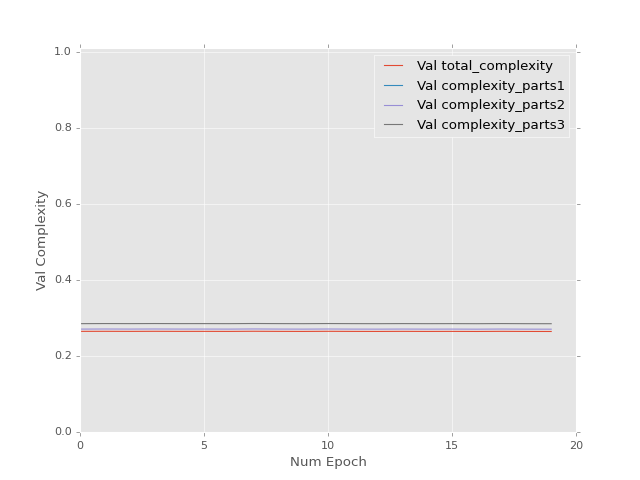

Epoch 1 of 20 took 5.932s
Epoch 2 of 20 took 5.486s
Epoch 3 of 20 took 5.861s
Epoch 4 of 20 took 5.989s
Epoch 5 of 20 took 6.042s
Epoch 6 of 20 took 5.554s
Epoch 7 of 20 took 5.888s
Epoch 8 of 20 took 5.739s
Epoch 9 of 20 took 5.435s
Epoch 10 of 20 took 6.119s
Epoch 11 of 20 took 5.773s
Epoch 12 of 20 took 5.432s
Epoch 13 of 20 took 5.653s
Epoch 14 of 20 took 5.991s
Epoch 15 of 20 took 5.668s
Epoch 16 of 20 took 5.948s
Epoch 17 of 20 took 5.748s
Epoch 18 of 20 took 5.470s
Epoch 19 of 20 took 6.062s
Epoch 20 of 20 took 5.804s
0.699981153011 [[ 1.18121183  0.39224797  0.56668144  1.21621478  0.45532665  0.67600167]]


<IPython.core.display.Javascript object>


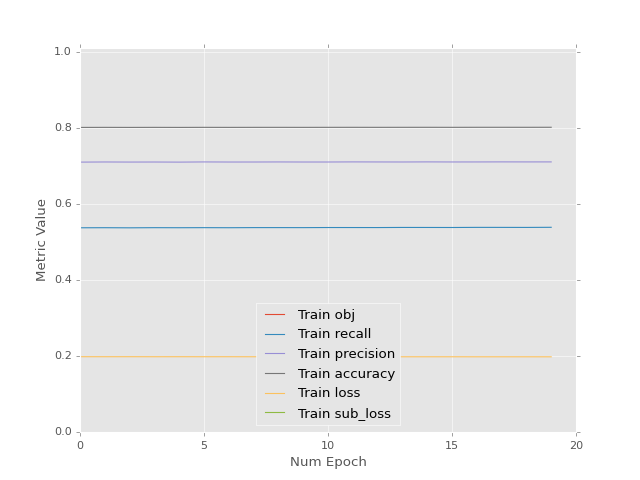

<IPython.core.display.Javascript object>


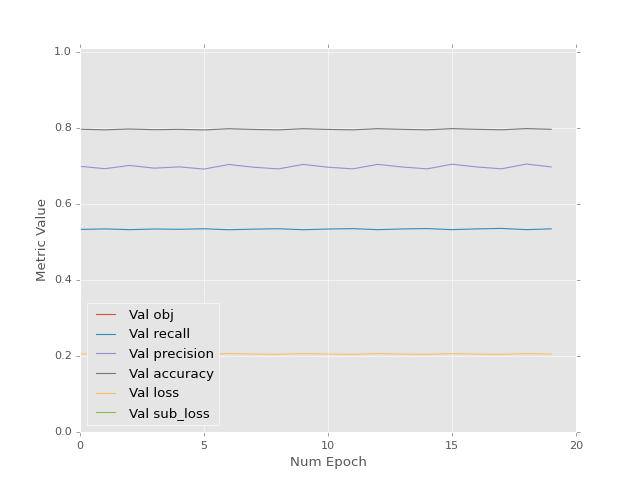

<IPython.core.display.Javascript object>


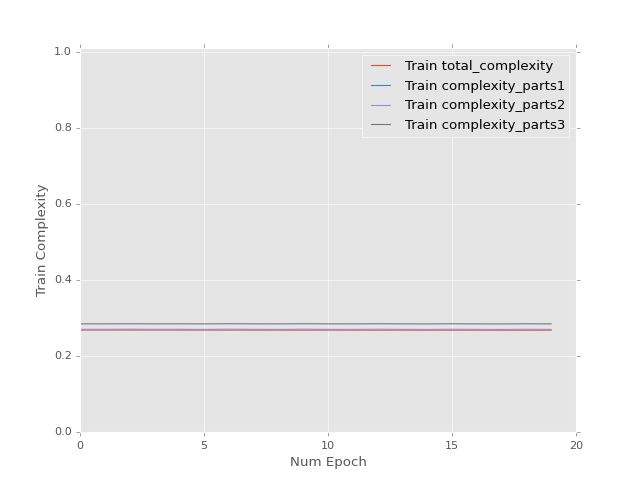

<IPython.core.display.Javascript object>


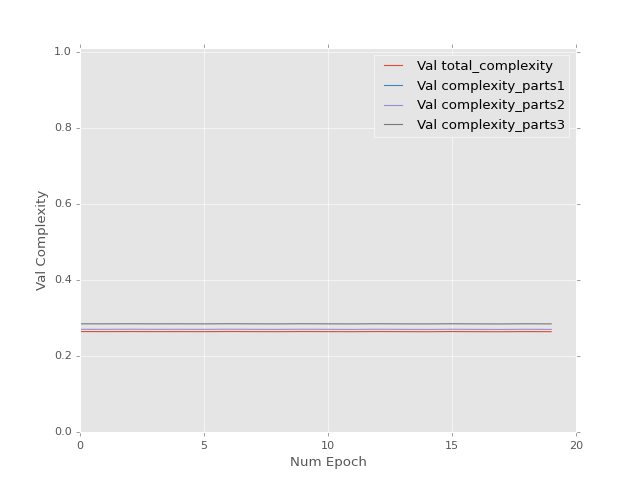

Epoch 1 of 20 took 5.433s
Epoch 2 of 20 took 5.835s
Epoch 3 of 20 took 5.740s
Epoch 4 of 20 took 5.492s
Epoch 5 of 20 took 5.610s
Epoch 6 of 20 took 5.432s
Epoch 7 of 20 took 6.012s
Epoch 8 of 20 took 5.450s
Epoch 9 of 20 took 5.956s
Epoch 10 of 20 took 5.725s
Epoch 11 of 20 took 5.825s
Epoch 12 of 20 took 5.876s
Epoch 13 of 20 took 5.988s
Epoch 14 of 20 took 6.005s
Epoch 15 of 20 took 6.089s
Epoch 16 of 20 took 5.732s
Epoch 17 of 20 took 5.923s
Epoch 18 of 20 took 5.662s
Epoch 19 of 20 took 5.828s
Epoch 20 of 20 took 5.649s
0.699038594961 [[ 1.18254638  0.39369178  0.56870824  1.21730506  0.45629263  0.67516196]]


<IPython.core.display.Javascript object>


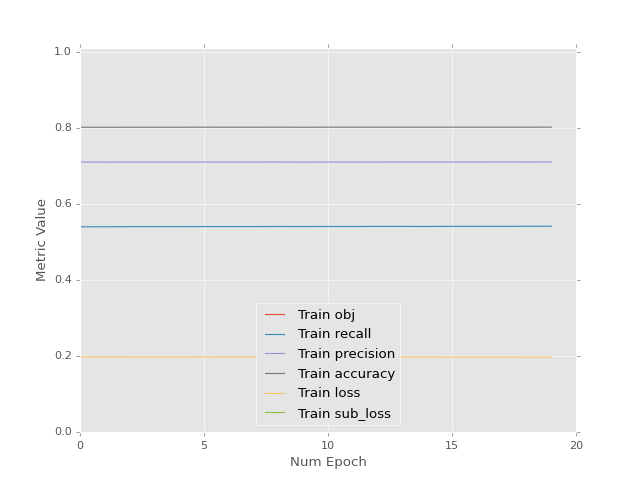

<IPython.core.display.Javascript object>


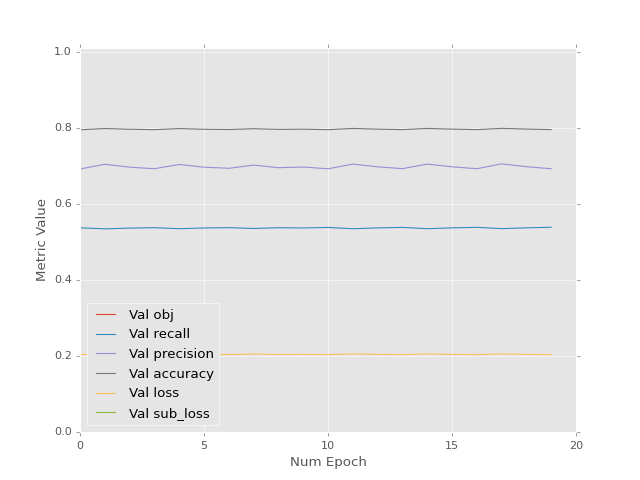

<IPython.core.display.Javascript object>


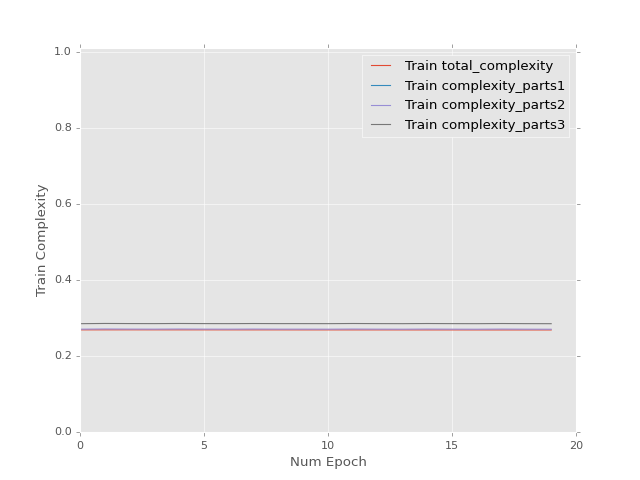

<IPython.core.display.Javascript object>


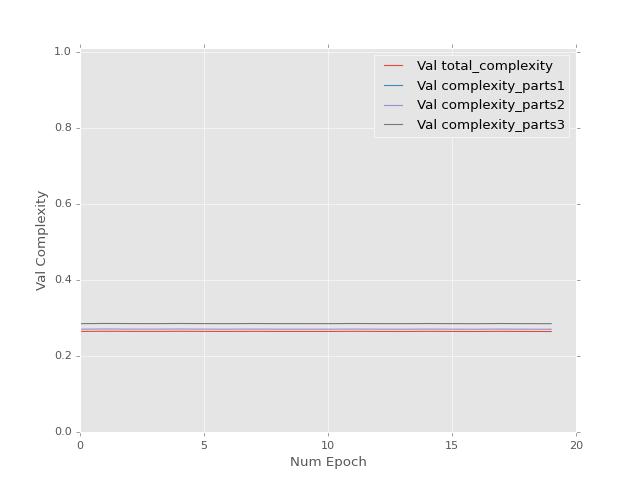

Epoch 1 of 20 took 5.813s
Epoch 2 of 20 took 5.876s
Epoch 3 of 20 took 6.053s
Epoch 4 of 20 took 5.741s
Epoch 5 of 20 took 5.844s
Epoch 6 of 20 took 5.885s
Epoch 7 of 20 took 5.844s
Epoch 8 of 20 took 6.107s
Epoch 9 of 20 took 5.598s
Epoch 10 of 20 took 5.859s
Epoch 11 of 20 took 5.869s
Epoch 12 of 20 took 5.829s
Epoch 13 of 20 took 6.023s
Epoch 14 of 20 took 5.884s
Epoch 15 of 20 took 5.833s
Epoch 16 of 20 took 5.683s
Epoch 17 of 20 took 5.672s
Epoch 18 of 20 took 5.462s
Epoch 19 of 20 took 5.832s
Epoch 20 of 20 took 5.671s
0.701645433903 [[ 1.1791265   0.39035723  0.56581396  1.21369541  0.45258471  0.67896885]]


<IPython.core.display.Javascript object>


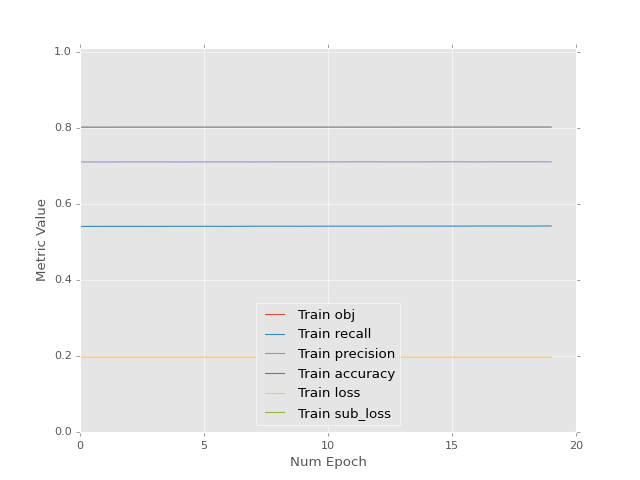

<IPython.core.display.Javascript object>


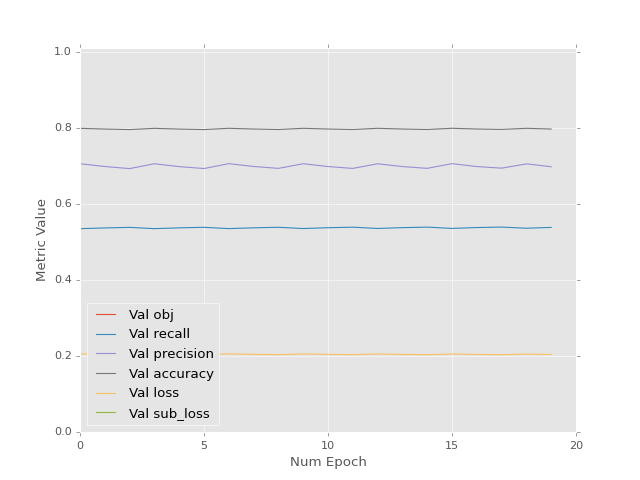

<IPython.core.display.Javascript object>


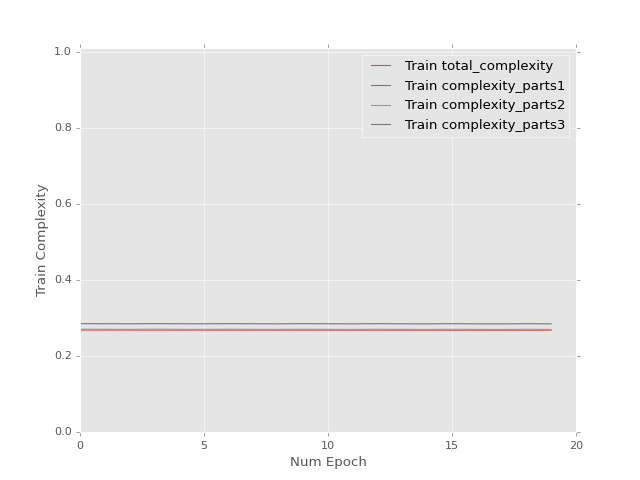

<IPython.core.display.Javascript object>


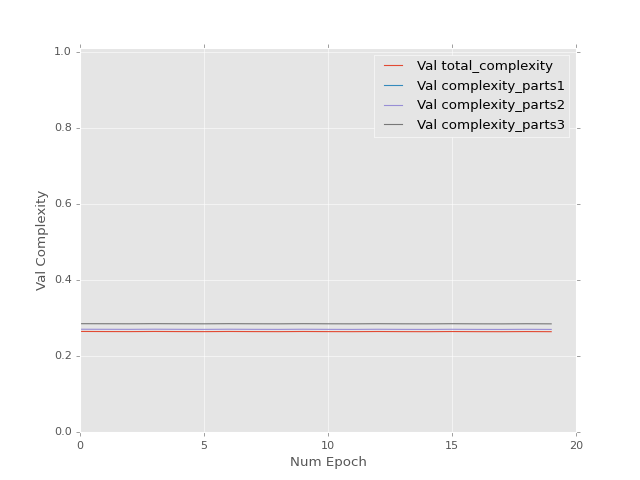

Epoch 1 of 20 took 5.433s
Epoch 2 of 20 took 5.678s
Epoch 3 of 20 took 5.951s
Epoch 4 of 20 took 5.498s
Epoch 5 of 20 took 5.873s
Epoch 6 of 20 took 5.798s
Epoch 7 of 20 took 5.750s
Epoch 8 of 20 took 5.492s
Epoch 9 of 20 took 5.515s
Epoch 10 of 20 took 5.748s
Epoch 11 of 20 took 5.632s
Epoch 12 of 20 took 6.002s
Epoch 13 of 20 took 5.549s
Epoch 14 of 20 took 5.922s
Epoch 15 of 20 took 5.820s
Epoch 16 of 20 took 5.948s
Epoch 17 of 20 took 5.747s
Epoch 18 of 20 took 6.206s
Epoch 19 of 20 took 5.759s
Epoch 20 of 20 took 5.779s
0.70101749897 [[ 1.17999566  0.3912988   0.56713676  1.21440566  0.45321327  0.67842245]]


<IPython.core.display.Javascript object>


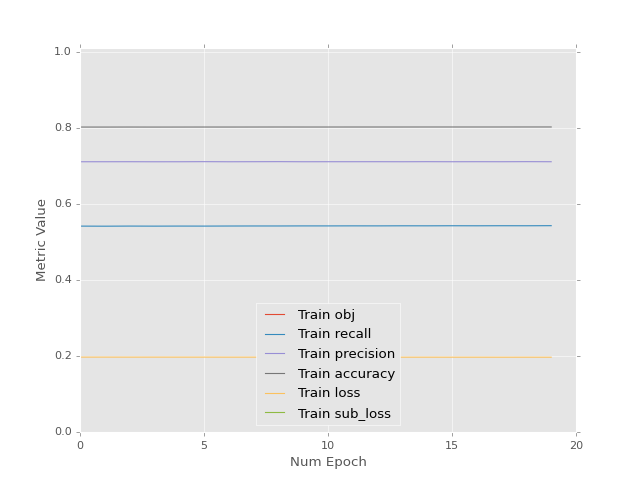

<IPython.core.display.Javascript object>


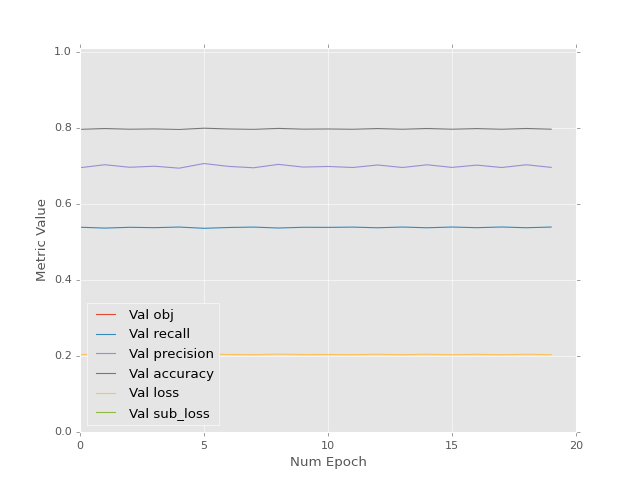

<IPython.core.display.Javascript object>


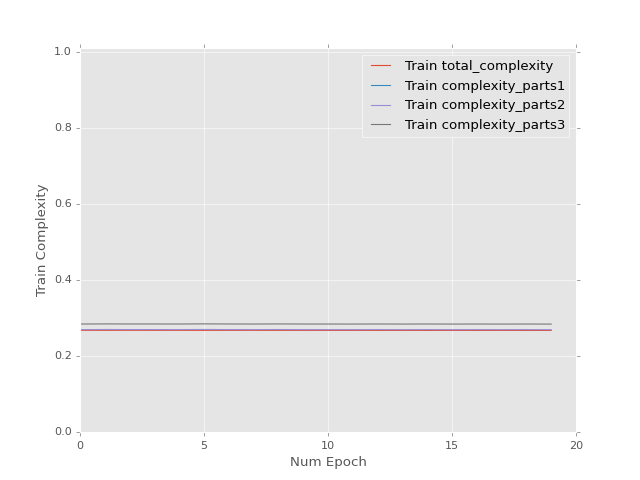

<IPython.core.display.Javascript object>


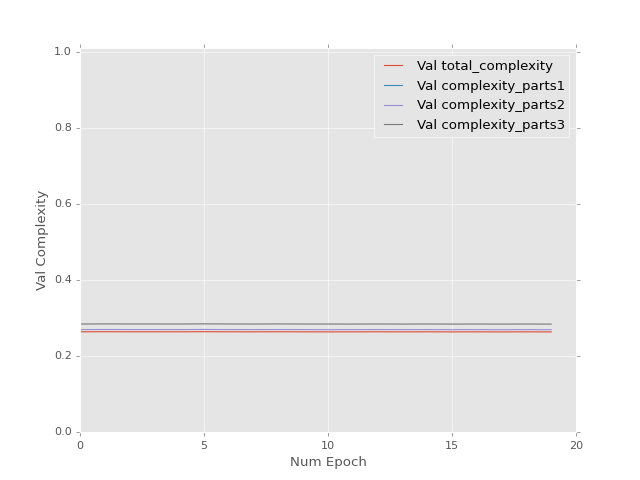

Epoch 1 of 20 took 5.868s
Epoch 2 of 20 took 5.803s
Epoch 3 of 20 took 6.023s
Epoch 4 of 20 took 5.686s
Epoch 5 of 20 took 5.767s
Epoch 6 of 20 took 5.777s
Epoch 7 of 20 took 5.804s
Epoch 8 of 20 took 5.689s
Epoch 9 of 20 took 6.012s
Epoch 10 of 20 took 6.096s
Epoch 11 of 20 took 5.948s
Epoch 12 of 20 took 5.868s
Epoch 13 of 20 took 5.684s
Epoch 14 of 20 took 5.948s
Epoch 15 of 20 took 6.014s
Epoch 16 of 20 took 5.923s
Epoch 17 of 20 took 5.904s
Epoch 18 of 20 took 5.851s
Epoch 19 of 20 took 5.727s
Epoch 20 of 20 took 5.704s
0.700290888548 [[ 1.18101645  0.39240474  0.56868643  1.21524     0.4539519   0.67778057]]


<IPython.core.display.Javascript object>


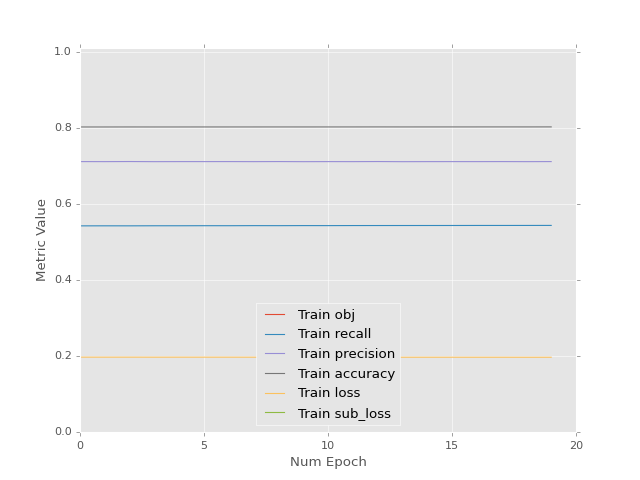

<IPython.core.display.Javascript object>


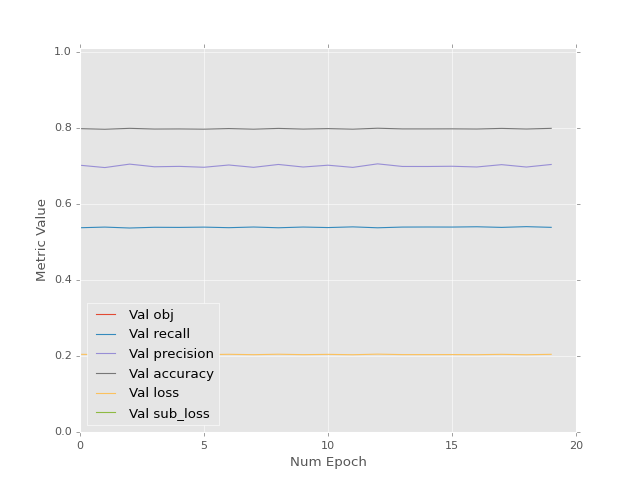

<IPython.core.display.Javascript object>


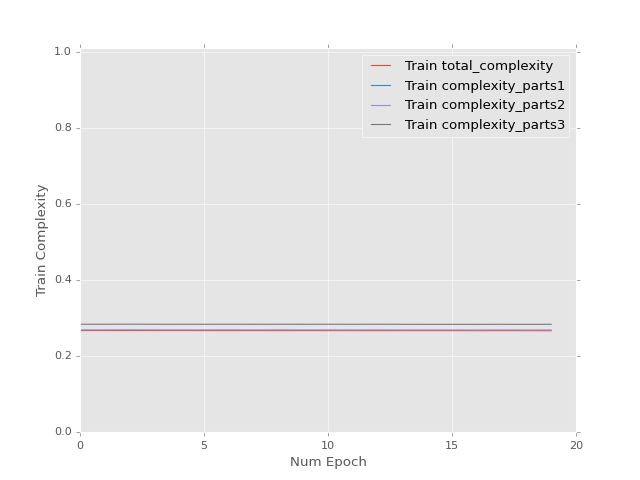

<IPython.core.display.Javascript object>


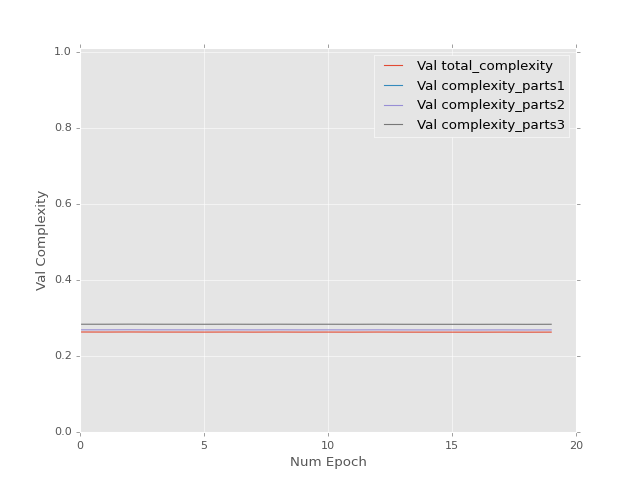

Epoch 1 of 20 took 5.672s
Epoch 2 of 20 took 5.957s
Epoch 3 of 20 took 5.948s
Epoch 4 of 20 took 5.786s
Epoch 5 of 20 took 5.706s
Epoch 6 of 20 took 5.718s
Epoch 7 of 20 took 5.979s
Epoch 8 of 20 took 5.738s
Epoch 9 of 20 took 5.734s
Epoch 10 of 20 took 5.808s
Epoch 11 of 20 took 5.798s
Epoch 12 of 20 took 5.728s
Epoch 13 of 20 took 5.762s
Epoch 14 of 20 took 5.643s
Epoch 15 of 20 took 5.786s
Epoch 16 of 20 took 5.905s
Epoch 17 of 20 took 5.836s
Epoch 18 of 20 took 5.708s
Epoch 19 of 20 took 39.730s
Epoch 20 of 20 took 5.154s
0.699417859316 [[ 1.18224883  0.39373928  0.5705508   1.2162472   0.45484361  0.67700607]]


<IPython.core.display.Javascript object>


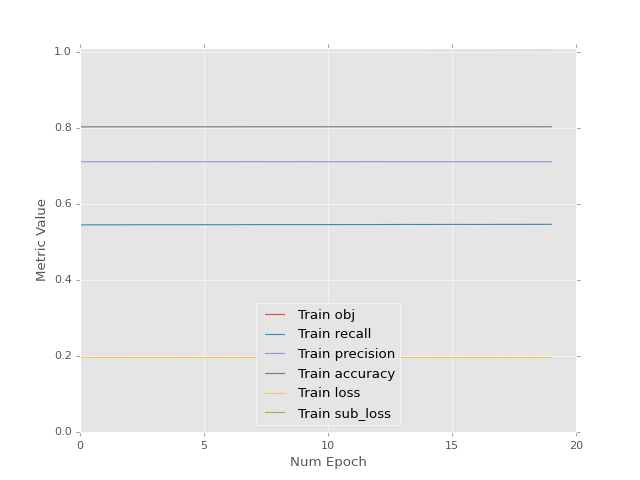

<IPython.core.display.Javascript object>


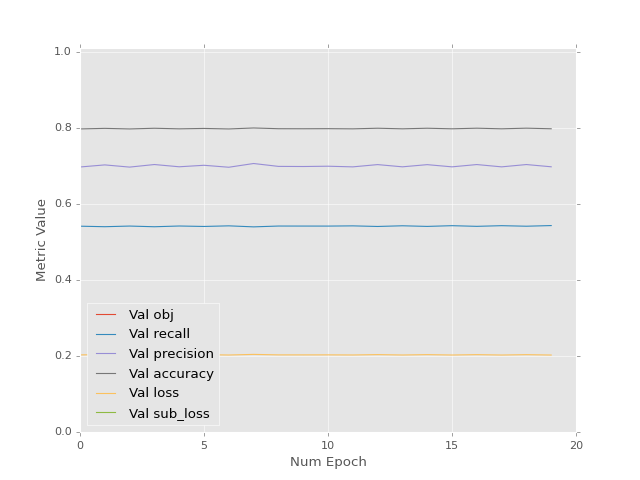

<IPython.core.display.Javascript object>


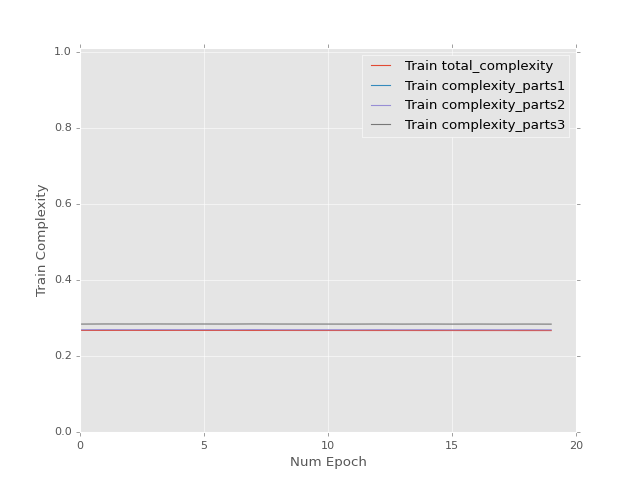

<IPython.core.display.Javascript object>


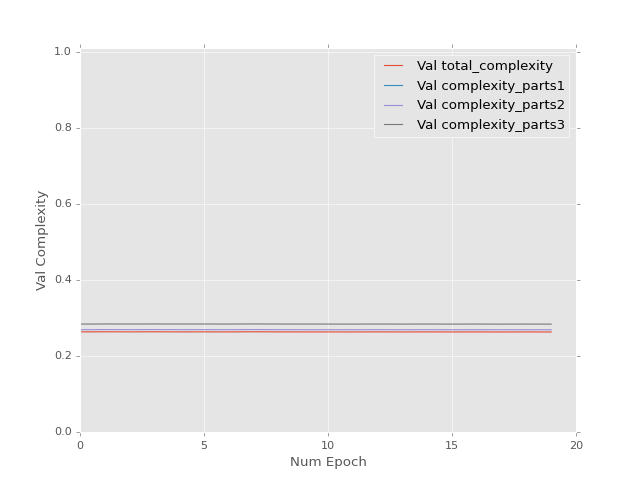

Epoch 1 of 20 took 5.242s
Epoch 2 of 20 took 4.968s
Epoch 3 of 20 took 5.170s
Epoch 4 of 20 took 5.453s
Epoch 5 of 20 took 5.586s
Epoch 6 of 20 took 4.986s
Epoch 7 of 20 took 5.390s
Epoch 8 of 20 took 5.447s
Epoch 9 of 20 took 5.504s
Epoch 10 of 20 took 5.639s
Epoch 11 of 20 took 5.332s
Epoch 12 of 20 took 5.136s
Epoch 13 of 20 took 5.263s
Epoch 14 of 20 took 5.378s
Epoch 15 of 20 took 5.368s
Epoch 16 of 20 took 5.329s
Epoch 17 of 20 took 5.365s
Epoch 18 of 20 took 5.242s
Epoch 19 of 20 took 5.303s
Epoch 20 of 20 took 5.093s
0.406772941351 [[ 1.17908287  0.39067993  0.56802899  1.21284544  0.45131952  0.68065393]]


<IPython.core.display.Javascript object>


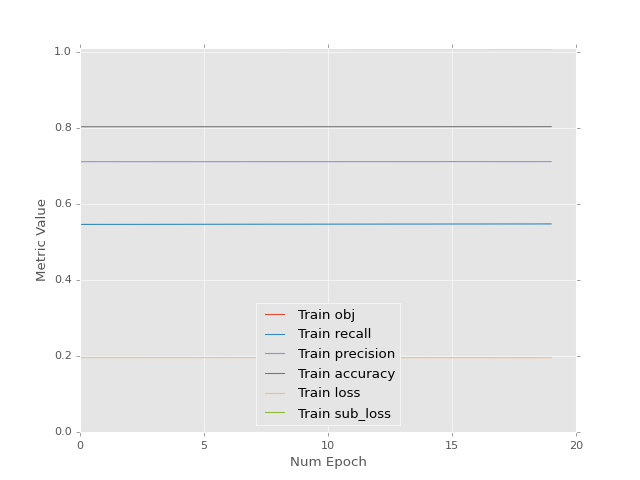

<IPython.core.display.Javascript object>


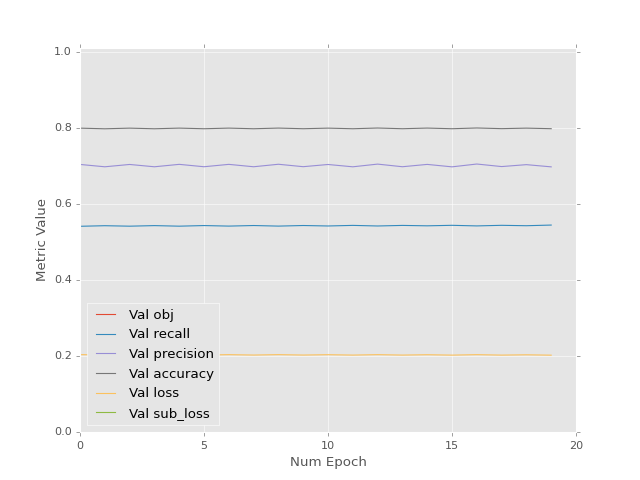

<IPython.core.display.Javascript object>


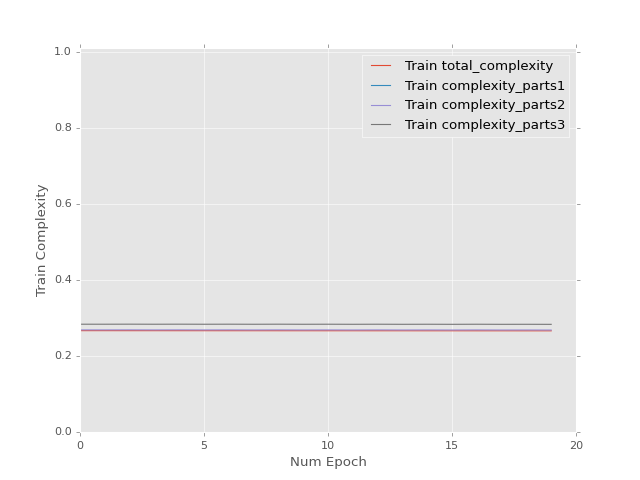

<IPython.core.display.Javascript object>


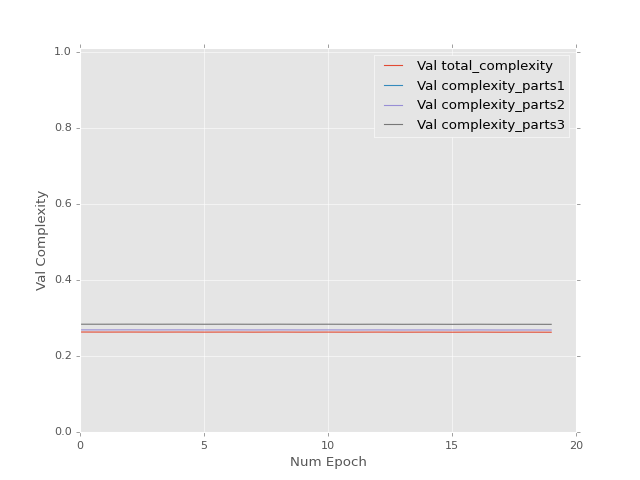

Epoch 1 of 20 took 5.251s
Epoch 2 of 20 took 5.248s
Epoch 3 of 20 took 5.367s
Epoch 4 of 20 took 5.611s
Epoch 5 of 20 took 5.292s
Epoch 6 of 20 took 5.387s
Epoch 7 of 20 took 5.430s
Epoch 8 of 20 took 5.133s
Epoch 9 of 20 took 5.339s
Epoch 10 of 20 took 5.380s
Epoch 11 of 20 took 5.235s
Epoch 12 of 20 took 4.970s
Epoch 13 of 20 took 5.357s
Epoch 14 of 20 took 5.452s
Epoch 15 of 20 took 5.497s
Epoch 16 of 20 took 5.390s
Epoch 17 of 20 took 5.411s
Epoch 18 of 20 took 5.284s
Epoch 19 of 20 took 5.304s
Epoch 20 of 20 took 5.417s
0.701258808374 [[ 1.17990458  0.39157093  0.5692746   1.21351695  0.4519136   0.68013787]]


<IPython.core.display.Javascript object>


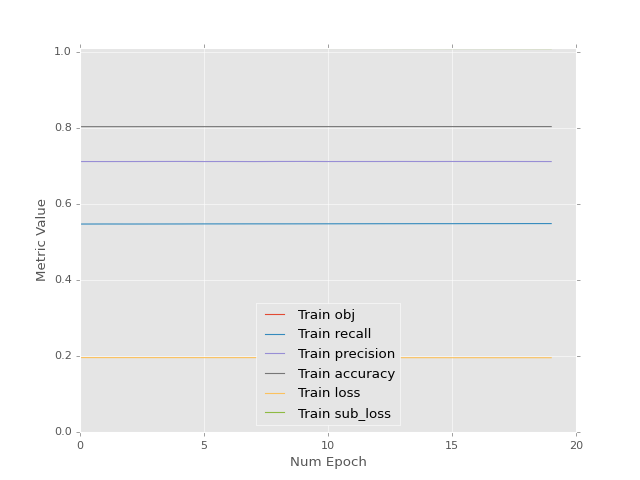

<IPython.core.display.Javascript object>


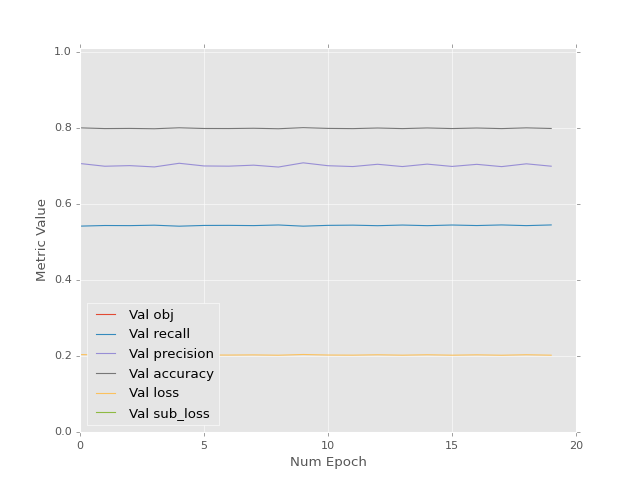

<IPython.core.display.Javascript object>


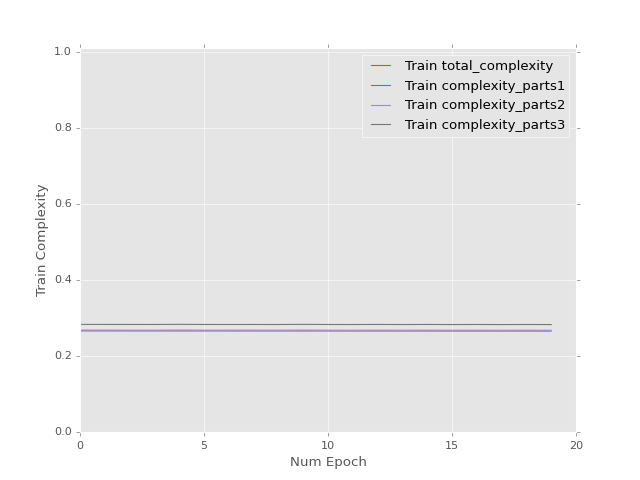

<IPython.core.display.Javascript object>


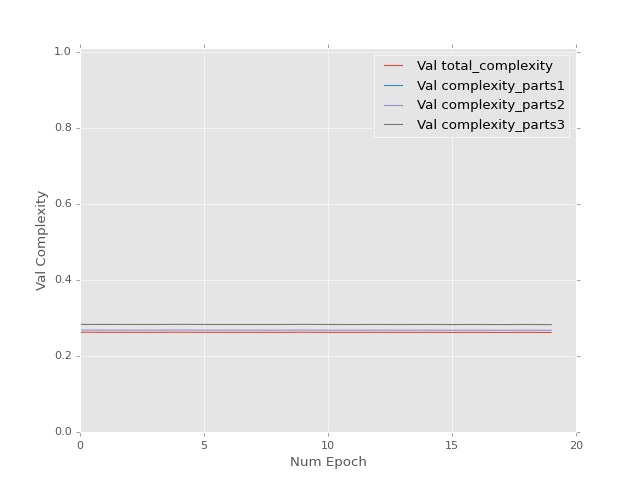

Epoch 1 of 20 took 5.314s
Epoch 2 of 20 took 5.432s
Epoch 3 of 20 took 5.152s
Epoch 4 of 20 took 5.305s
Epoch 5 of 20 took 5.357s
Epoch 6 of 20 took 5.341s
Epoch 7 of 20 took 5.464s
Epoch 8 of 20 took 5.362s
Epoch 9 of 20 took 5.119s
Epoch 10 of 20 took 5.421s
Epoch 11 of 20 took 5.520s
Epoch 12 of 20 took 5.429s
Epoch 13 of 20 took 5.748s
Epoch 14 of 20 took 5.931s
Epoch 15 of 20 took 5.936s
Epoch 16 of 20 took 5.829s
Epoch 17 of 20 took 5.745s
Epoch 18 of 20 took 5.931s
Epoch 19 of 20 took 5.946s
Epoch 20 of 20 took 5.957s
0.700576901436 [[ 1.18085837  0.39260486  0.57071626  1.21429646  0.45260322  0.67953897]]


<IPython.core.display.Javascript object>


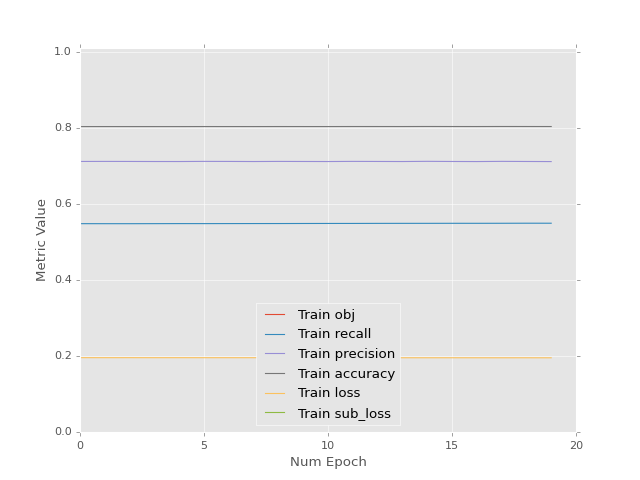

<IPython.core.display.Javascript object>


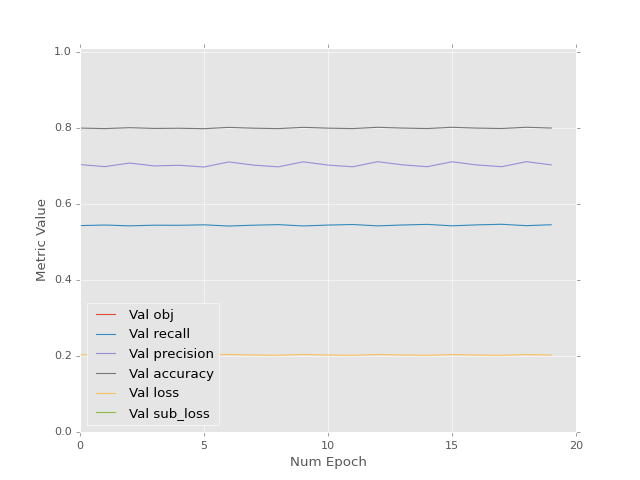

<IPython.core.display.Javascript object>


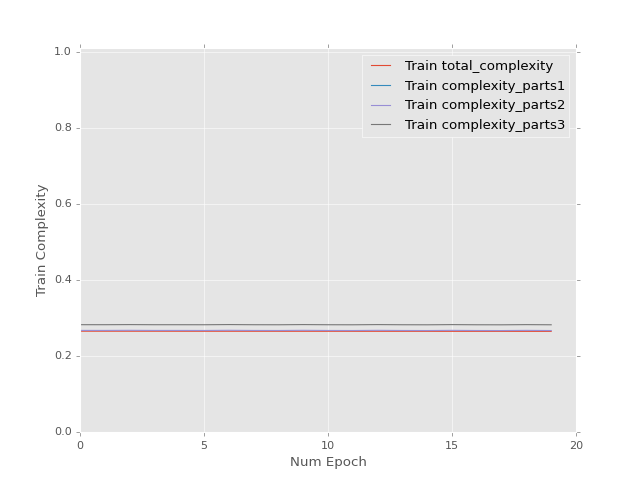

<IPython.core.display.Javascript object>


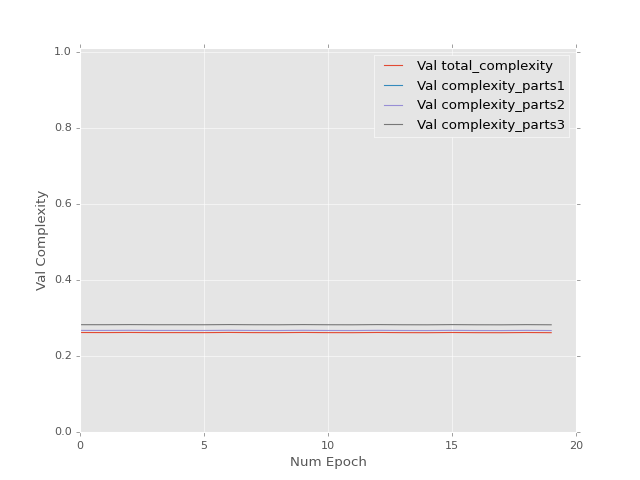

Epoch 1 of 20 took 5.868s
Epoch 2 of 20 took 5.777s
Epoch 3 of 20 took 5.952s
Epoch 4 of 20 took 5.936s
Epoch 5 of 20 took 5.879s
Epoch 6 of 20 took 5.993s
Epoch 7 of 20 took 5.940s
Epoch 8 of 20 took 5.871s
Epoch 9 of 20 took 5.711s
Epoch 10 of 20 took 5.867s
Epoch 11 of 20 took 5.836s
Epoch 12 of 20 took 5.715s
Epoch 13 of 20 took 5.833s
Epoch 14 of 20 took 5.925s
Epoch 15 of 20 took 5.849s
Epoch 16 of 20 took 5.764s
Epoch 17 of 20 took 5.844s
Epoch 18 of 20 took 5.849s
Epoch 19 of 20 took 5.794s
Epoch 20 of 20 took 5.685s
0.699768304825 [[ 1.18199778  0.39383999  0.57243383  1.21522796  0.45342743  0.67882353]]


<IPython.core.display.Javascript object>


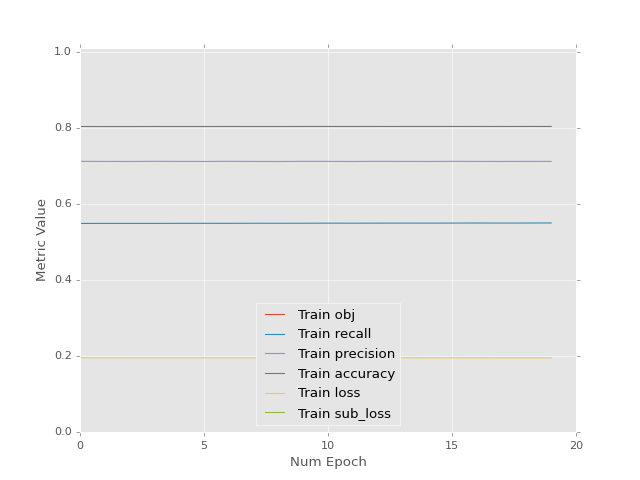

<IPython.core.display.Javascript object>


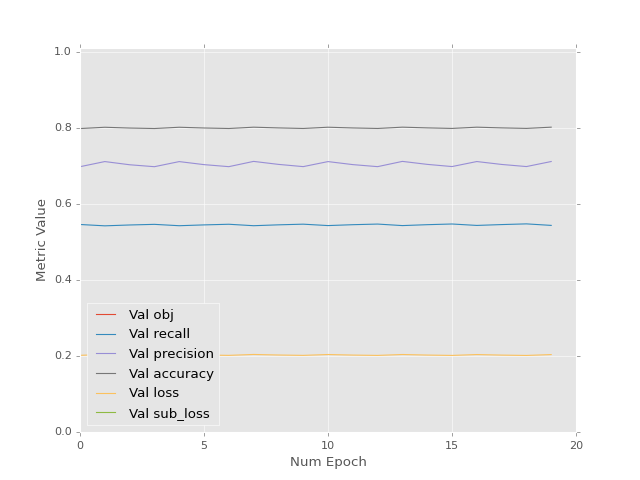

<IPython.core.display.Javascript object>


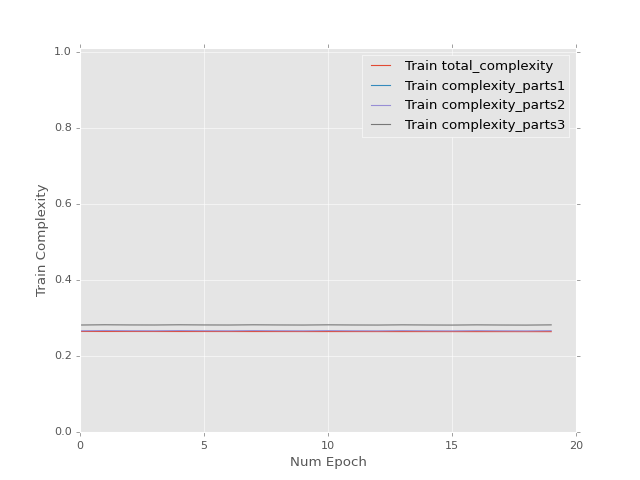

<IPython.core.display.Javascript object>


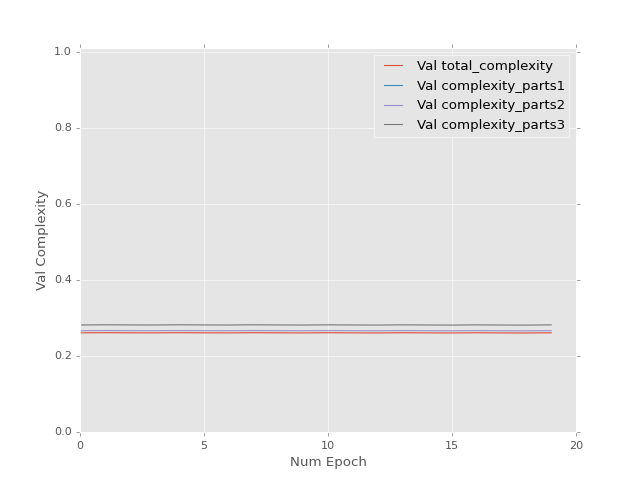

Epoch 1 of 20 took 6.193s
Epoch 2 of 20 took 6.045s
Epoch 3 of 20 took 5.607s
Epoch 4 of 20 took 5.757s
Epoch 5 of 20 took 5.918s
Epoch 6 of 20 took 5.606s
Epoch 7 of 20 took 6.020s
Epoch 8 of 20 took 5.786s
Epoch 9 of 20 took 5.919s
Epoch 10 of 20 took 5.868s
Epoch 11 of 20 took 5.657s
Epoch 12 of 20 took 5.846s
Epoch 13 of 20 took 6.016s
Epoch 14 of 20 took 5.828s
Epoch 15 of 20 took 6.076s
Epoch 16 of 20 took 5.891s
Epoch 17 of 20 took 5.716s
Epoch 18 of 20 took 5.861s
Epoch 19 of 20 took 5.700s
Epoch 20 of 20 took 5.741s
0.698788762093 [[ 1.18339121  0.39535022  0.5745272   1.21636772  0.45443586  0.67794842]]


<IPython.core.display.Javascript object>


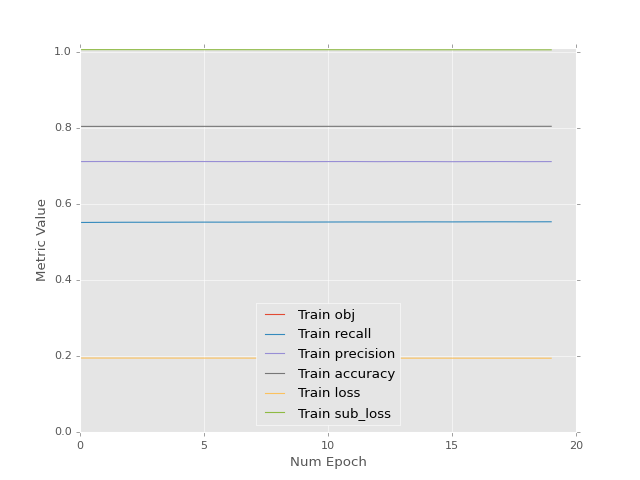

<IPython.core.display.Javascript object>


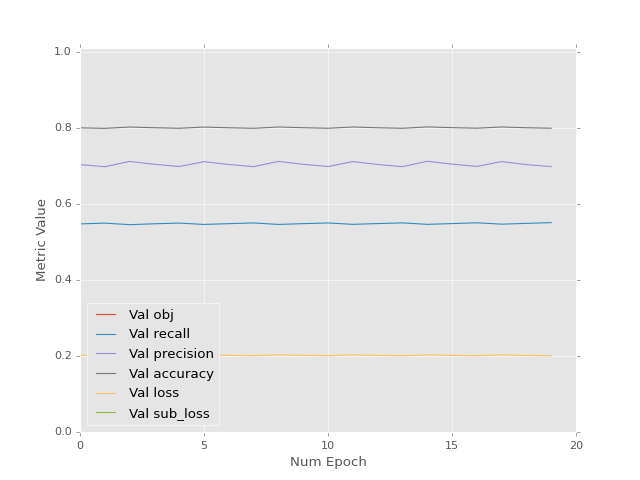

<IPython.core.display.Javascript object>


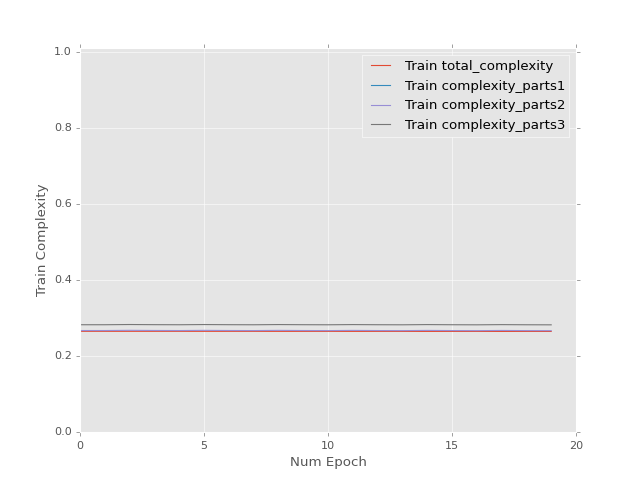

<IPython.core.display.Javascript object>


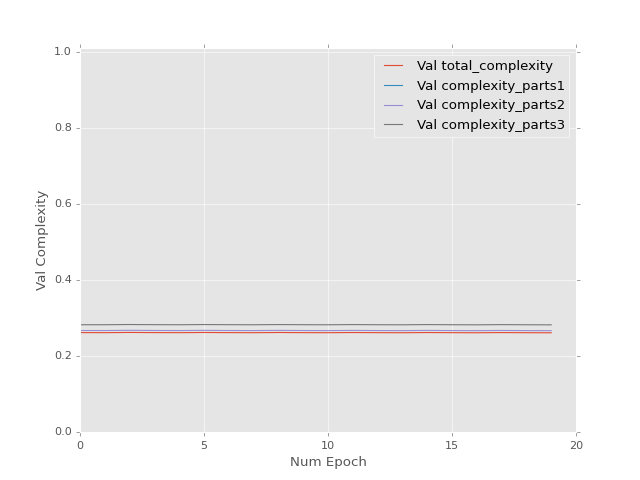

Epoch 1 of 20 took 5.726s
Epoch 2 of 20 took 5.938s
Epoch 3 of 20 took 5.879s
Epoch 4 of 20 took 5.880s
Epoch 5 of 20 took 5.992s
Epoch 6 of 20 took 5.976s
Epoch 7 of 20 took 5.942s
Epoch 8 of 20 took 5.954s
Epoch 9 of 20 took 6.018s
Epoch 10 of 20 took 5.885s
Epoch 11 of 20 took 5.903s
Epoch 12 of 20 took 5.952s
Epoch 13 of 20 took 5.908s
Epoch 14 of 20 took 5.785s
Epoch 15 of 20 took 5.807s
Epoch 16 of 20 took 5.872s
Epoch 17 of 20 took 5.892s
Epoch 18 of 20 took 5.939s
Epoch 19 of 20 took 5.935s
Epoch 20 of 20 took 5.963s
0.701549887657 [[ 1.17975271  0.39178142  0.57129121  1.21257985  0.450569    0.68189383]]


<IPython.core.display.Javascript object>


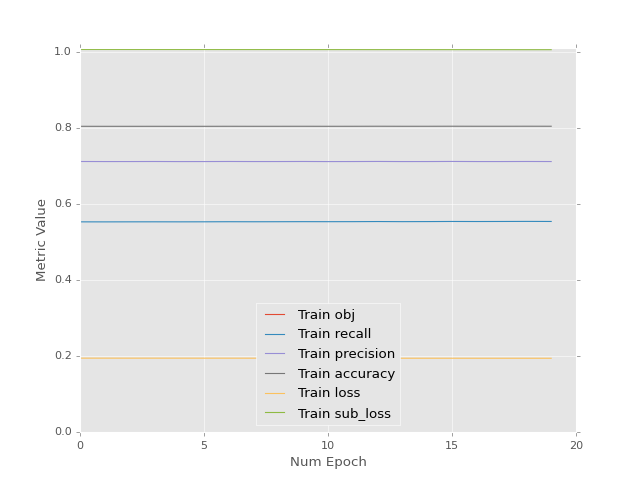

<IPython.core.display.Javascript object>


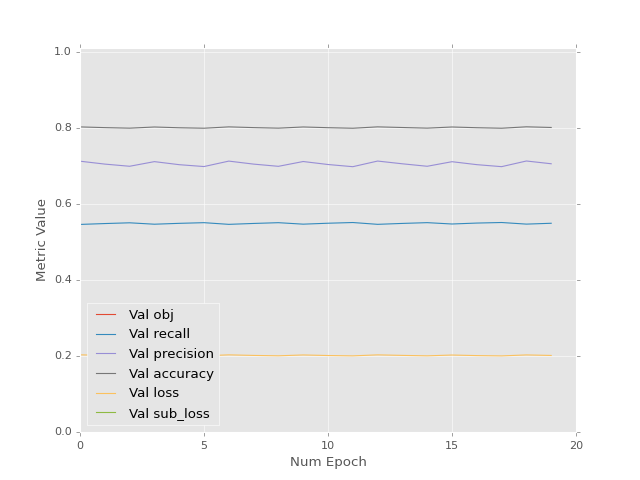

<IPython.core.display.Javascript object>


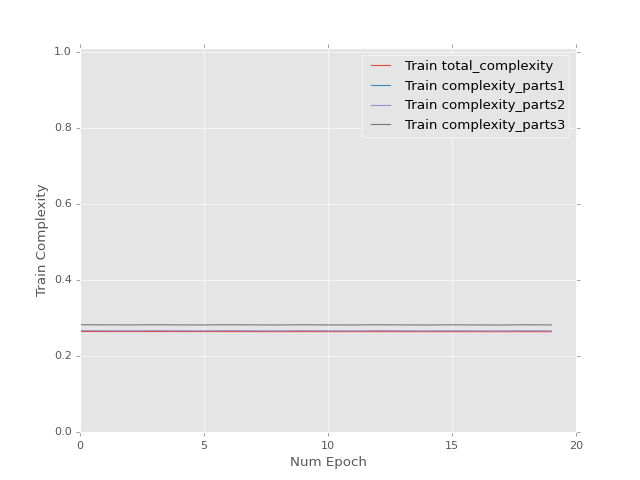

<IPython.core.display.Javascript object>


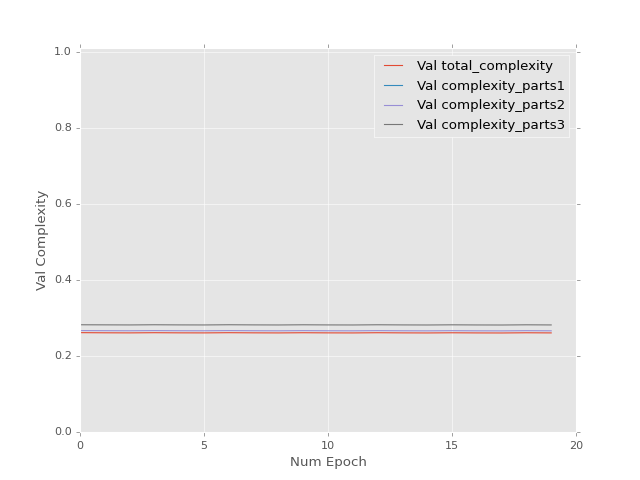

Epoch 1 of 20 took 5.938s
Epoch 2 of 20 took 6.003s
Epoch 3 of 20 took 5.850s
Epoch 4 of 20 took 5.726s
Epoch 5 of 20 took 5.807s
Epoch 6 of 20 took 5.964s
Epoch 7 of 20 took 5.878s
Epoch 8 of 20 took 5.633s
Epoch 9 of 20 took 5.946s
Epoch 10 of 20 took 6.001s
Epoch 11 of 20 took 5.976s
Epoch 12 of 20 took 5.915s
Epoch 13 of 20 took 6.038s
Epoch 14 of 20 took 5.574s
Epoch 15 of 20 took 5.812s
Epoch 16 of 20 took 5.530s
Epoch 17 of 20 took 5.703s
Epoch 18 of 20 took 6.188s
Epoch 19 of 20 took 5.750s
Epoch 20 of 20 took 5.947s
0.700896203518 [[ 1.18065953  0.39276561  0.57265472  1.21332181  0.45122483  0.68132442]]


<IPython.core.display.Javascript object>


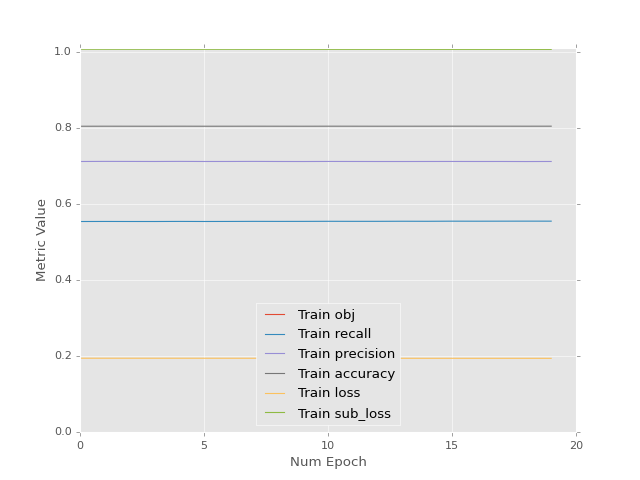

<IPython.core.display.Javascript object>


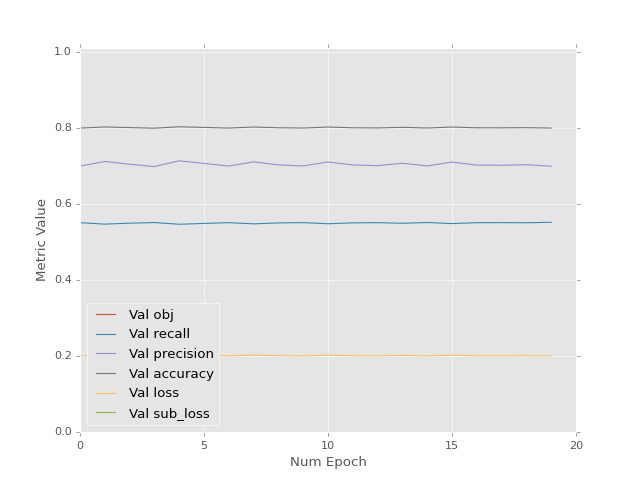

<IPython.core.display.Javascript object>


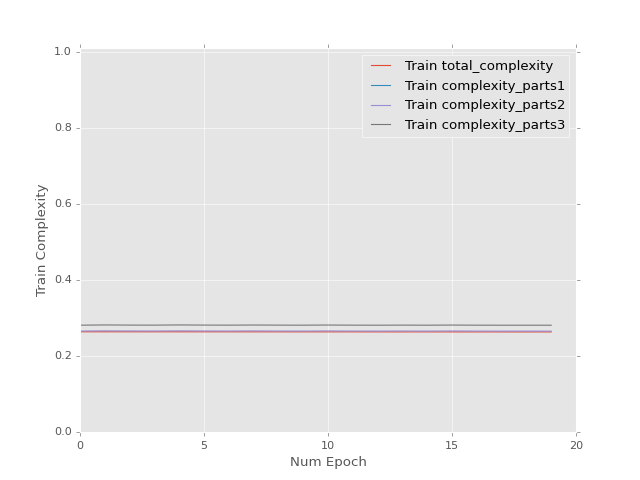

<IPython.core.display.Javascript object>


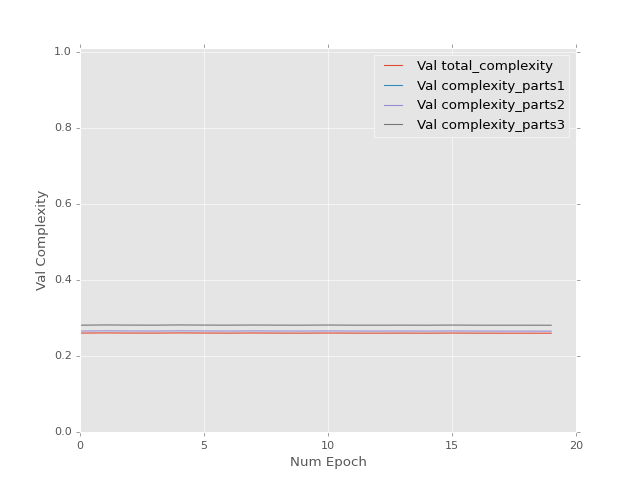

Epoch 1 of 20 took 5.891s
Epoch 2 of 20 took 5.817s
Epoch 3 of 20 took 5.965s
Epoch 4 of 20 took 5.948s
Epoch 5 of 20 took 5.907s
Epoch 6 of 20 took 5.976s
Epoch 7 of 20 took 5.927s
Epoch 8 of 20 took 5.599s
Epoch 9 of 20 took 5.873s
Epoch 10 of 20 took 5.681s
Epoch 11 of 20 took 5.867s
Epoch 12 of 20 took 5.883s
Epoch 13 of 20 took 5.607s
Epoch 14 of 20 took 5.621s
Epoch 15 of 20 took 5.752s
Epoch 16 of 20 took 5.714s
Epoch 17 of 20 took 6.026s
Epoch 18 of 20 took 5.831s
Epoch 19 of 20 took 5.840s
Epoch 20 of 20 took 5.846s
0.700135558844 [[ 1.18173385  0.39393139  0.57426572  1.21420074  0.45200196  0.68065   ]]


<IPython.core.display.Javascript object>


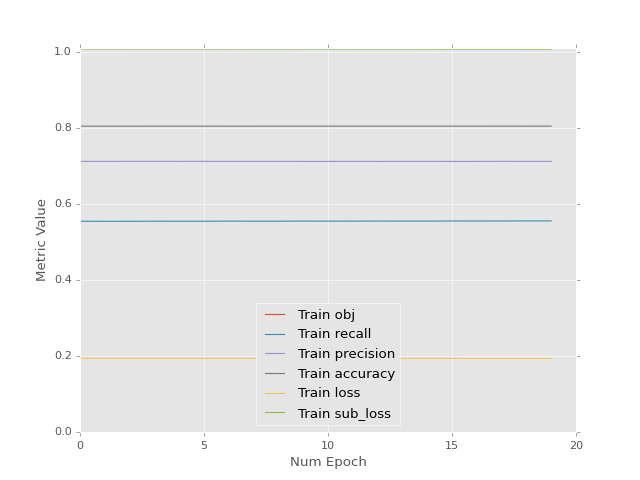

<IPython.core.display.Javascript object>


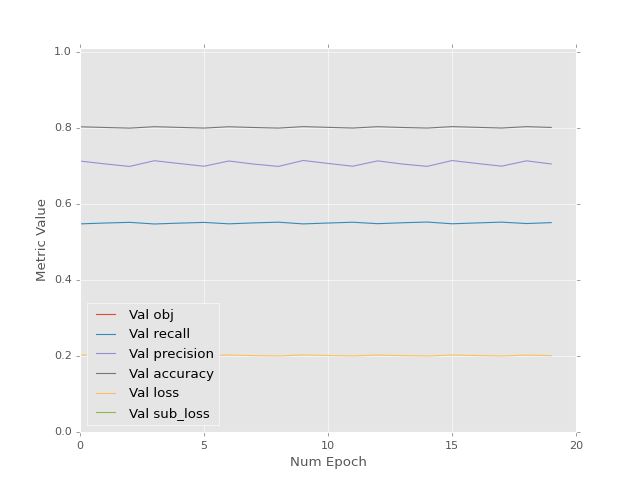

<IPython.core.display.Javascript object>


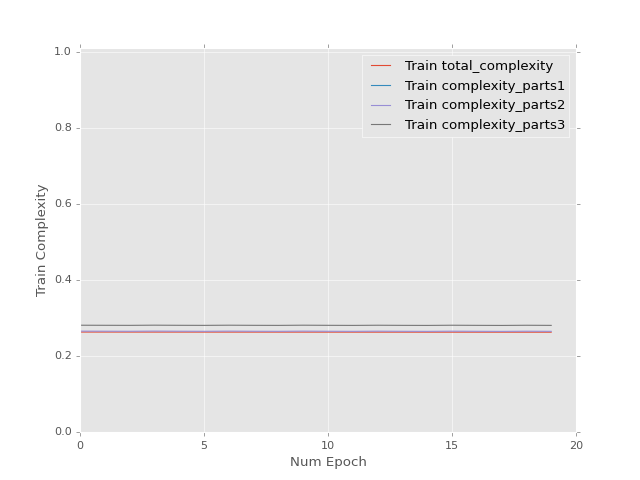

<IPython.core.display.Javascript object>


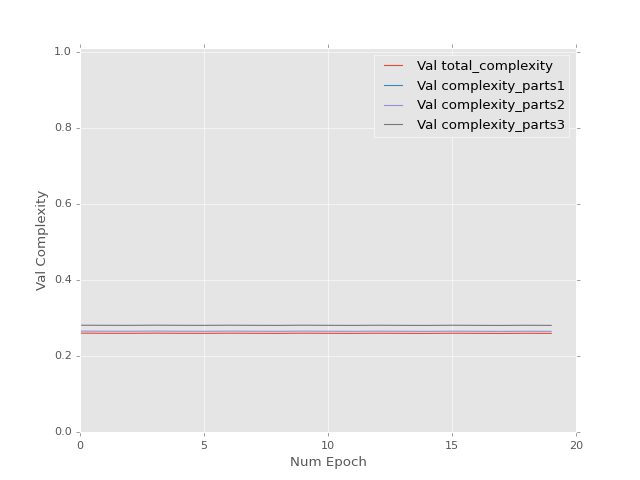

Epoch 1 of 20 took 5.873s
Epoch 2 of 20 took 5.473s
Epoch 3 of 20 took 5.903s
Epoch 4 of 20 took 5.809s
Epoch 5 of 20 took 5.510s
Epoch 6 of 20 took 5.733s
Epoch 7 of 20 took 5.659s
Epoch 8 of 20 took 5.825s
Epoch 9 of 20 took 5.831s
Epoch 10 of 20 took 5.709s
Epoch 11 of 20 took 5.442s
Epoch 12 of 20 took 5.695s
Epoch 13 of 20 took 5.721s
Epoch 14 of 20 took 6.090s
Epoch 15 of 20 took 5.805s
Epoch 16 of 20 took 5.639s
Epoch 17 of 20 took 5.501s
Epoch 18 of 20 took 5.736s
Epoch 19 of 20 took 5.756s
Epoch 20 of 20 took 5.882s
0.699211835861 [[ 1.18303919  0.39534757  0.576217    1.21526909  0.45294654  0.67983055]]


<IPython.core.display.Javascript object>


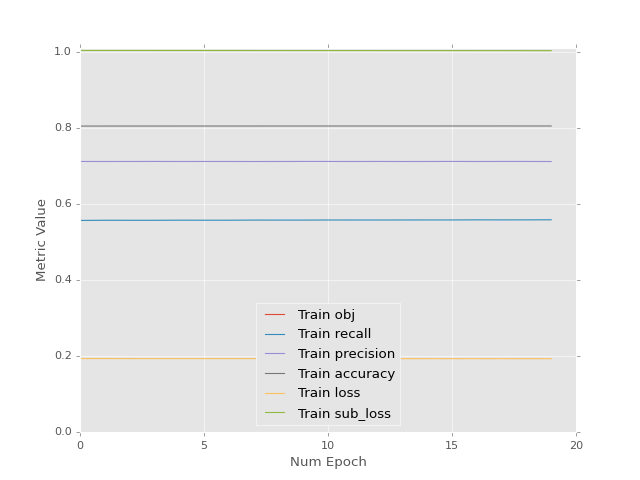

<IPython.core.display.Javascript object>


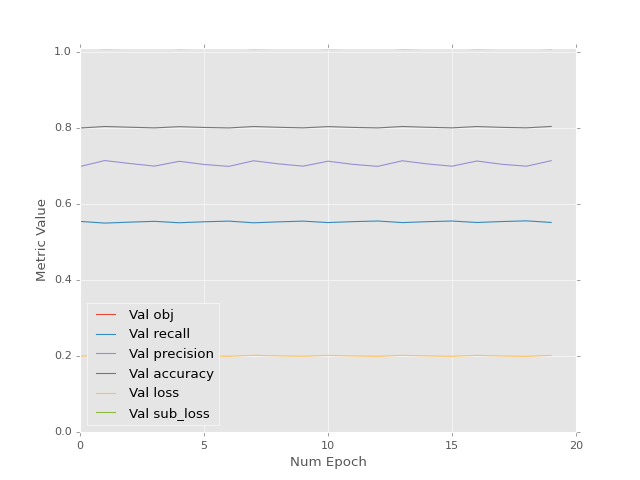

<IPython.core.display.Javascript object>


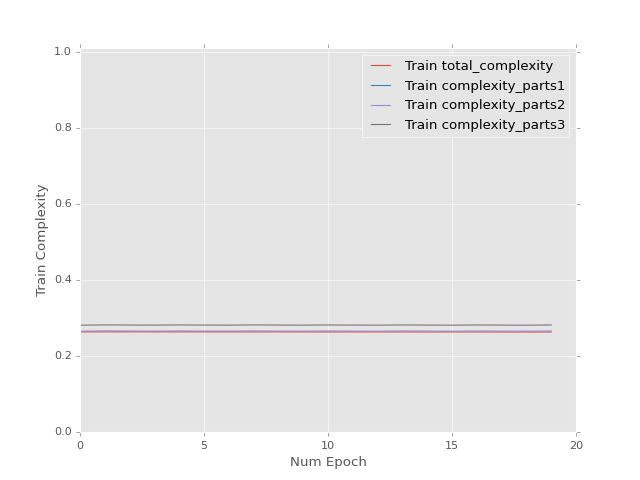

<IPython.core.display.Javascript object>


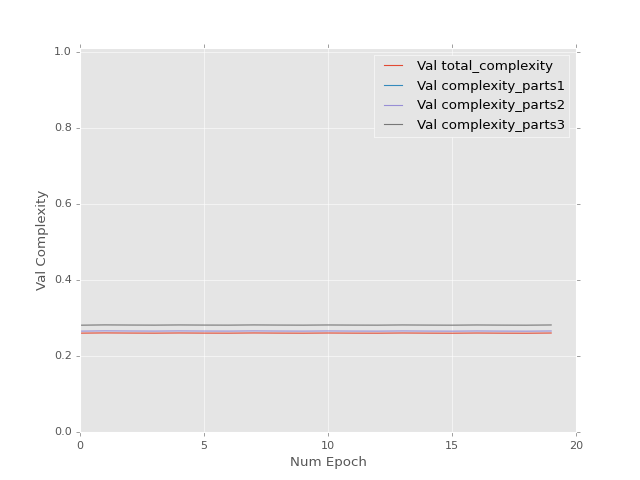

Epoch 1 of 20 took 5.515s
Epoch 2 of 20 took 5.437s
Epoch 3 of 20 took 5.501s
Epoch 4 of 20 took 5.451s
Epoch 5 of 20 took 5.620s
Epoch 6 of 20 took 5.437s
Epoch 7 of 20 took 5.492s
Epoch 8 of 20 took 5.433s
Epoch 9 of 20 took 5.723s
Epoch 10 of 20 took 6.001s
Epoch 11 of 20 took 5.779s
Epoch 12 of 20 took 5.502s
Epoch 13 of 20 took 5.770s
Epoch 14 of 20 took 5.750s
Epoch 15 of 20 took 5.812s
Epoch 16 of 20 took 6.000s
Epoch 17 of 20 took 5.844s
Epoch 18 of 20 took 5.757s
Epoch 19 of 20 took 5.736s
Epoch 20 of 20 took 5.788s
0.701837420464 [[ 1.1796006   0.39199612  0.57327187  1.21164513  0.44922453  0.68365103]]


<IPython.core.display.Javascript object>


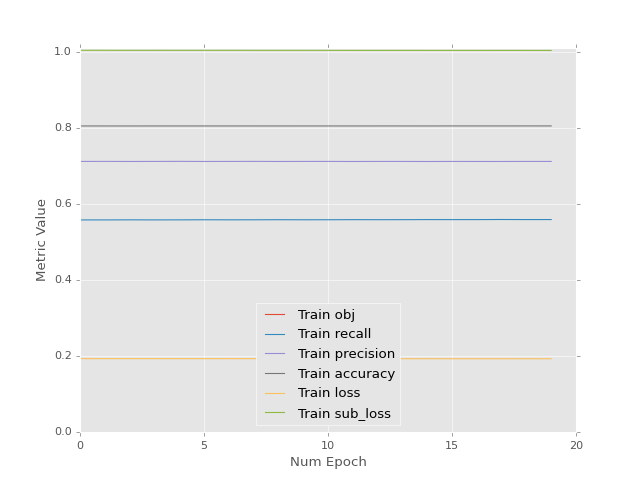

<IPython.core.display.Javascript object>


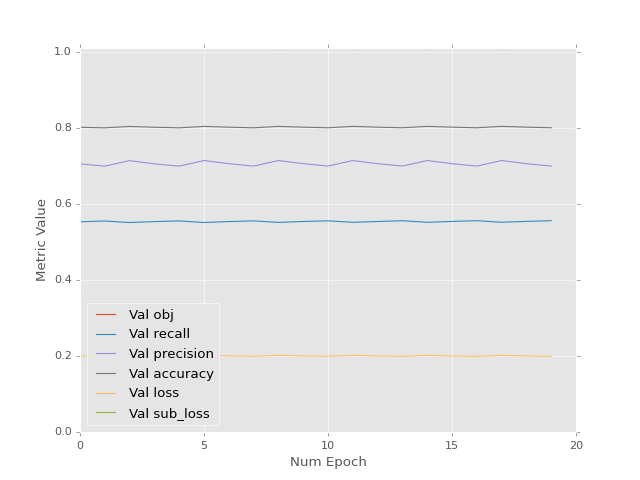

<IPython.core.display.Javascript object>


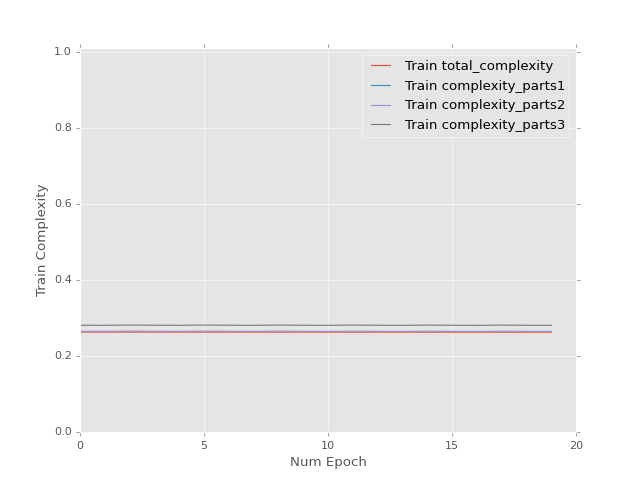

<IPython.core.display.Javascript object>


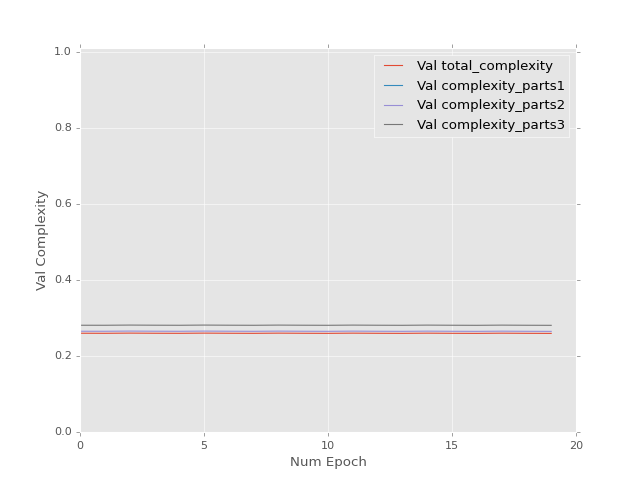

Epoch 1 of 20 took 6.024s
Epoch 2 of 20 took 5.736s
Epoch 3 of 20 took 5.841s
Epoch 4 of 20 took 6.019s
Epoch 5 of 20 took 5.511s
Epoch 6 of 20 took 5.438s
Epoch 7 of 20 took 5.592s
Epoch 8 of 20 took 5.716s
Epoch 9 of 20 took 5.688s
Epoch 10 of 20 took 5.804s
Epoch 11 of 20 took 6.038s
Epoch 12 of 20 took 6.132s
Epoch 13 of 20 took 5.939s
Epoch 14 of 20 took 5.765s
Epoch 15 of 20 took 5.941s
Epoch 16 of 20 took 5.938s
Epoch 17 of 20 took 5.584s
Epoch 18 of 20 took 5.643s
Epoch 19 of 20 took 5.703s
Epoch 20 of 20 took 6.038s
0.701217144728 [[ 1.18046665  0.39293703  0.57456869  1.21235394  0.44985083  0.68310755]]


<IPython.core.display.Javascript object>


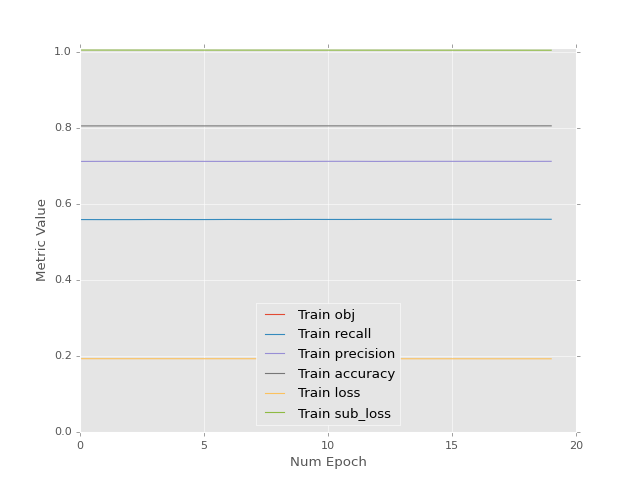

<IPython.core.display.Javascript object>


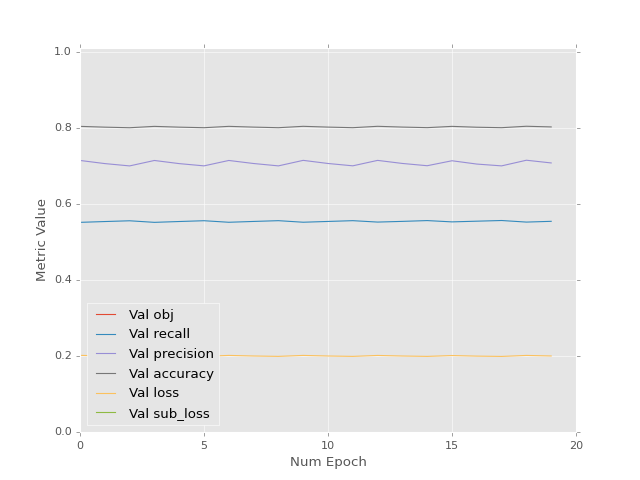

<IPython.core.display.Javascript object>


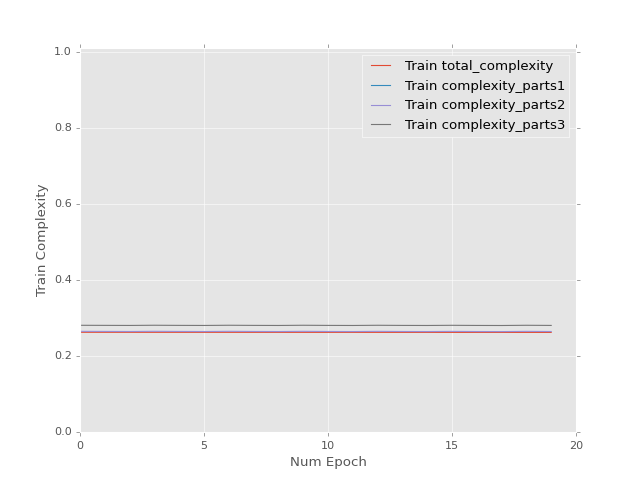

<IPython.core.display.Javascript object>


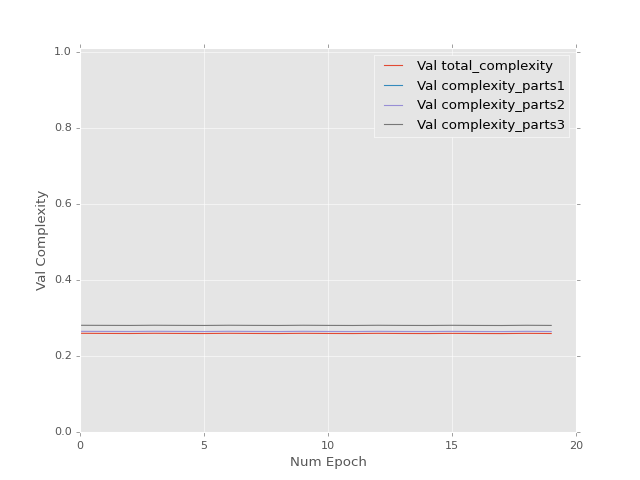

Epoch 1 of 20 took 5.490s
Epoch 2 of 20 took 5.584s
Epoch 3 of 20 took 5.949s
Epoch 4 of 20 took 5.984s
Epoch 5 of 20 took 5.689s
Epoch 6 of 20 took 5.649s
Epoch 7 of 20 took 5.657s
Epoch 8 of 20 took 5.756s
Epoch 9 of 20 took 5.791s
Epoch 10 of 20 took 5.802s
Epoch 11 of 20 took 5.624s
Epoch 12 of 20 took 5.732s
Epoch 13 of 20 took 5.475s
Epoch 14 of 20 took 5.729s
Epoch 15 of 20 took 5.609s
Epoch 16 of 20 took 5.813s
Epoch 17 of 20 took 5.802s
Epoch 18 of 20 took 5.731s
Epoch 19 of 20 took 5.852s
Epoch 20 of 20 took 5.990s
0.70048892498 [[ 1.1814841   0.3940419   0.57608771  1.21318662  0.45058659  0.68246931]]


<IPython.core.display.Javascript object>


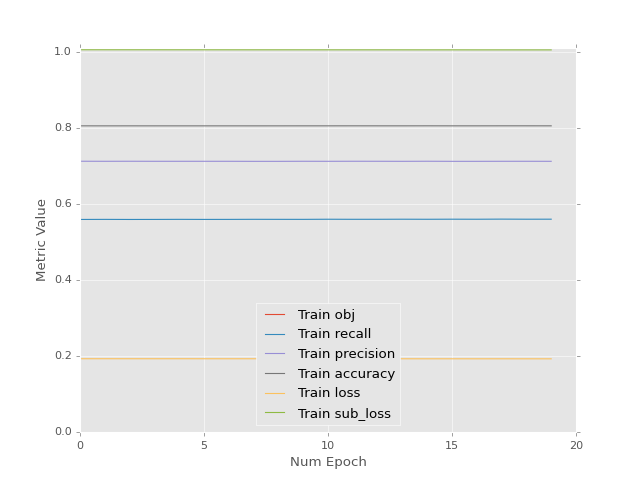

<IPython.core.display.Javascript object>


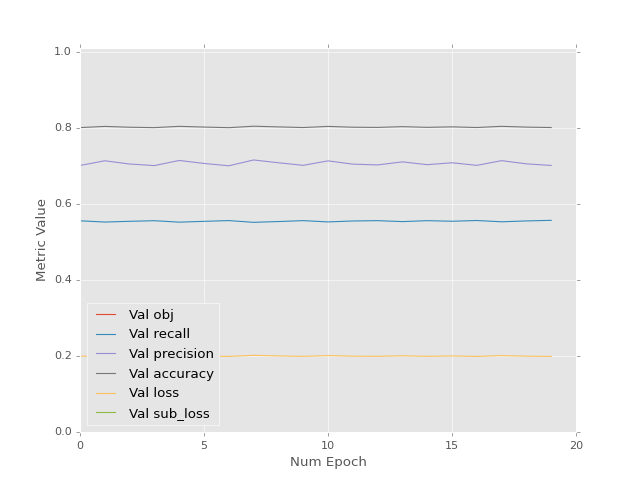

<IPython.core.display.Javascript object>


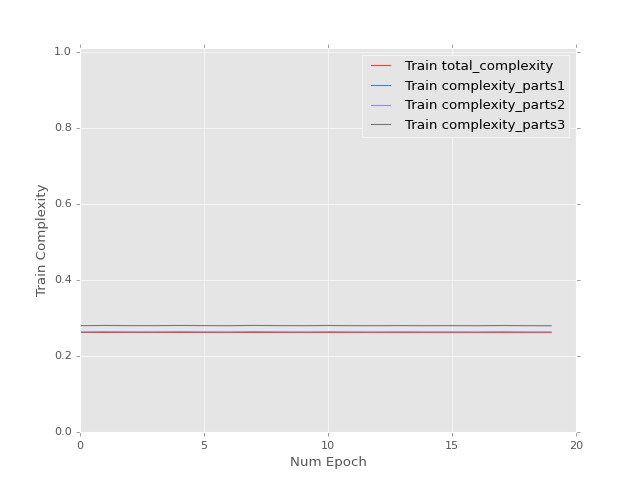

<IPython.core.display.Javascript object>


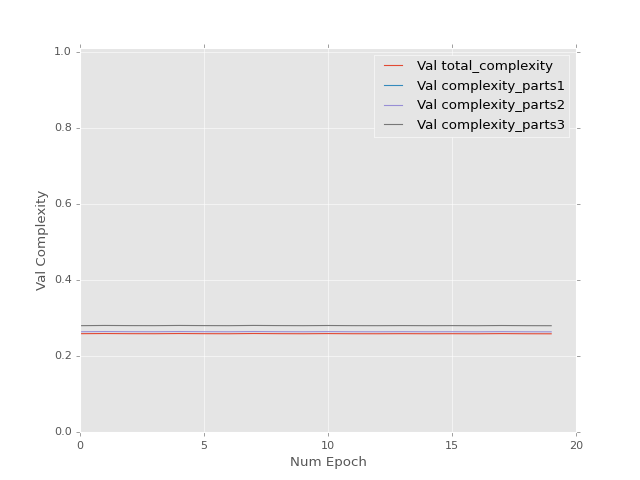

Epoch 1 of 20 took 5.857s
Epoch 2 of 20 took 5.889s
Epoch 3 of 20 took 5.888s
Epoch 4 of 20 took 6.007s
Epoch 5 of 20 took 5.914s
Epoch 6 of 20 took 5.795s
Epoch 7 of 20 took 6.041s
Epoch 8 of 20 took 5.812s
Epoch 9 of 20 took 5.790s
Epoch 10 of 20 took 5.824s
Epoch 11 of 20 took 5.709s
Epoch 12 of 20 took 5.907s
Epoch 13 of 20 took 6.270s
Epoch 14 of 20 took 5.863s
Epoch 15 of 20 took 5.996s
Epoch 16 of 20 took 5.769s
Epoch 17 of 20 took 5.672s
Epoch 18 of 20 took 5.758s
Epoch 19 of 20 took 5.869s
Epoch 20 of 20 took 5.780s
0.699623674154 [[ 1.1827116   0.39537486  0.57791525  1.21419156  0.45147467  0.68169922]]


<IPython.core.display.Javascript object>


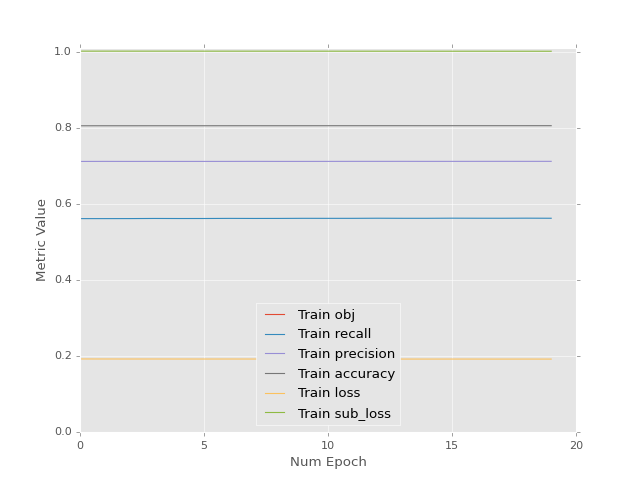

<IPython.core.display.Javascript object>


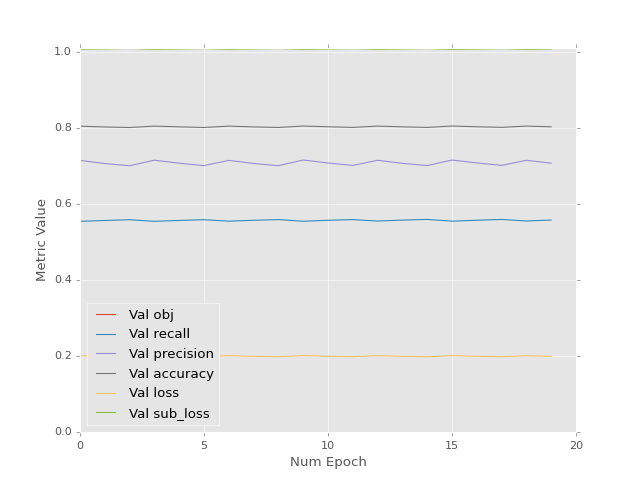

<IPython.core.display.Javascript object>


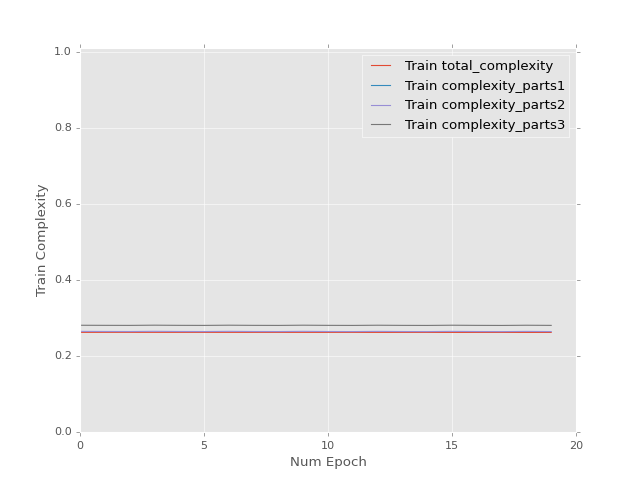

<IPython.core.display.Javascript object>


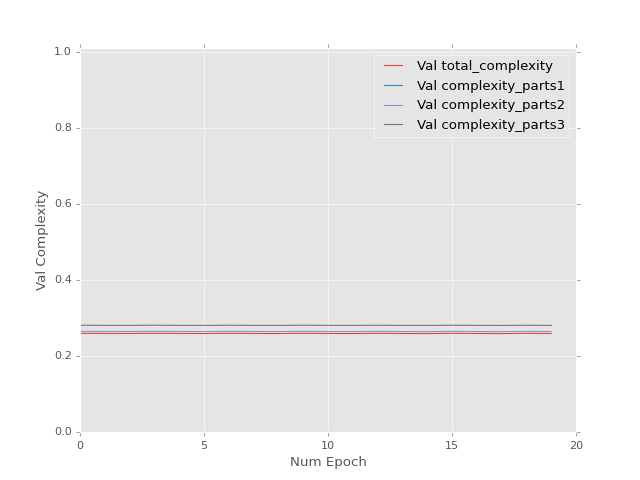

Epoch 1 of 20 took 5.910s
Epoch 2 of 20 took 5.631s
Epoch 3 of 20 took 5.646s
Epoch 4 of 20 took 5.705s
Epoch 5 of 20 took 5.997s
Epoch 6 of 20 took 5.585s
Epoch 7 of 20 took 5.738s
Epoch 8 of 20 took 5.517s
Epoch 9 of 20 took 5.856s
Epoch 10 of 20 took 5.474s
Epoch 11 of 20 took 5.443s
Epoch 12 of 20 took 5.783s
Epoch 13 of 20 took 5.592s
Epoch 14 of 20 took 5.702s
Epoch 15 of 20 took 5.942s
Epoch 16 of 20 took 5.694s
Epoch 17 of 20 took 5.923s
Epoch 18 of 20 took 5.973s
Epoch 19 of 20 took 5.864s
Epoch 20 of 20 took 5.947s
0.405074775219 [[ 1.17954028  0.39231375  0.57535636  1.2107873   0.44794649  0.68535203]]


<IPython.core.display.Javascript object>


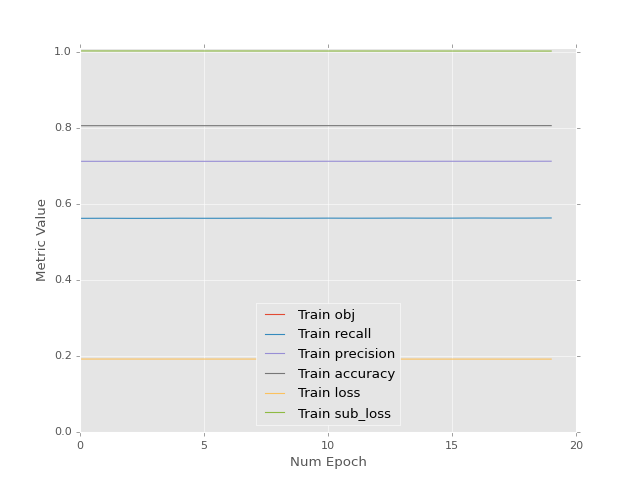

<IPython.core.display.Javascript object>


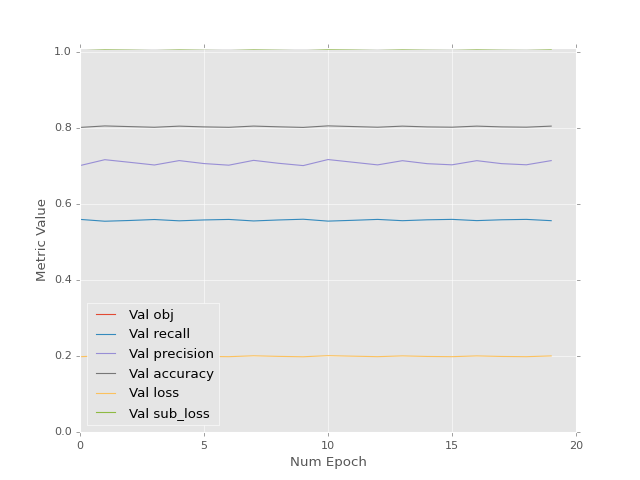

<IPython.core.display.Javascript object>


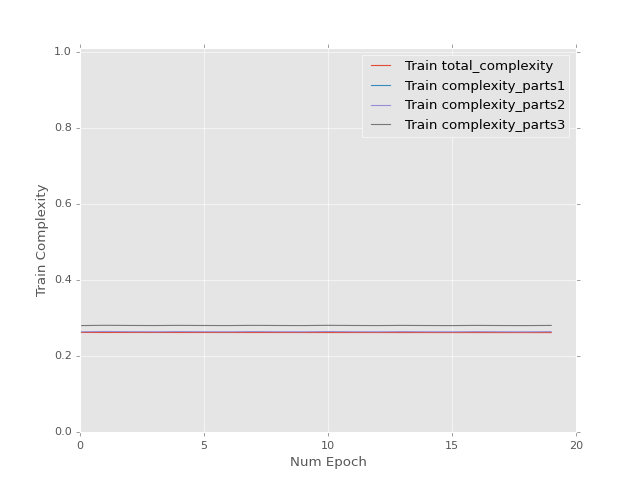

<IPython.core.display.Javascript object>


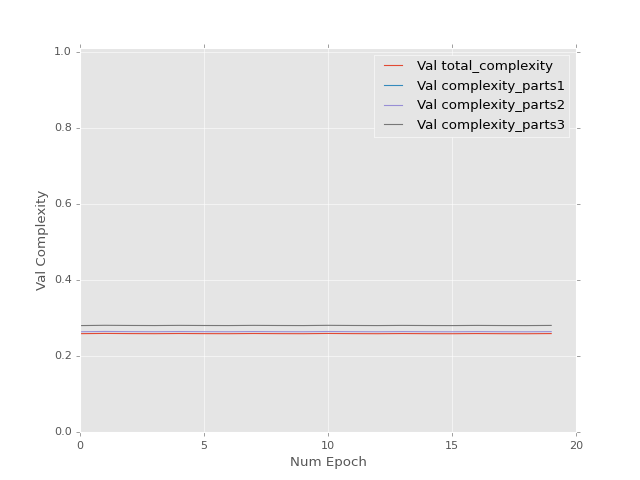

Epoch 1 of 20 took 5.675s
Epoch 2 of 20 took 5.936s
Epoch 3 of 20 took 5.510s
Epoch 4 of 20 took 6.005s
Epoch 5 of 20 took 5.877s
Epoch 6 of 20 took 5.846s
Epoch 7 of 20 took 5.665s
Epoch 8 of 20 took 5.659s
Epoch 9 of 20 took 5.990s
Epoch 10 of 20 took 5.975s
Epoch 11 of 20 took 5.932s
Epoch 12 of 20 took 5.735s
Epoch 13 of 20 took 5.435s
Epoch 14 of 20 took 5.590s
Epoch 15 of 20 took 5.661s
Epoch 16 of 20 took 5.739s
Epoch 17 of 20 took 5.837s
Epoch 18 of 20 took 5.920s
Epoch 19 of 20 took 6.040s
Epoch 20 of 20 took 5.821s
0.701470017433 [[ 1.18036044  0.39320558  0.57657969  1.21145856  0.44853929  0.68483794]]


<IPython.core.display.Javascript object>


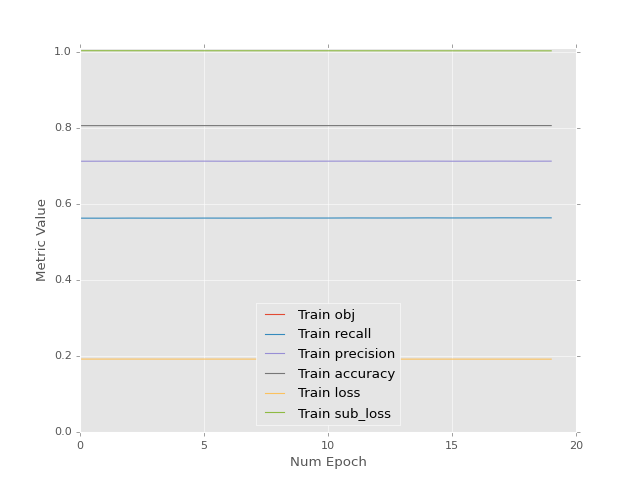

<IPython.core.display.Javascript object>


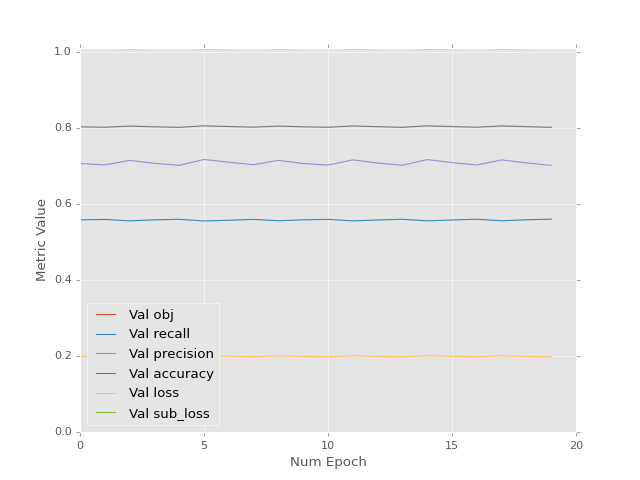

<IPython.core.display.Javascript object>


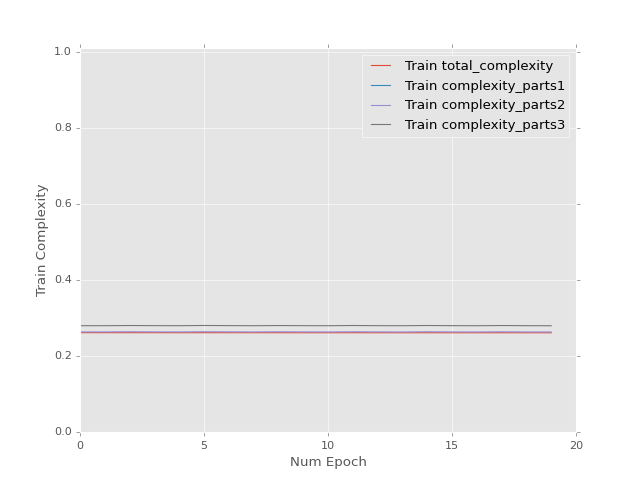

<IPython.core.display.Javascript object>


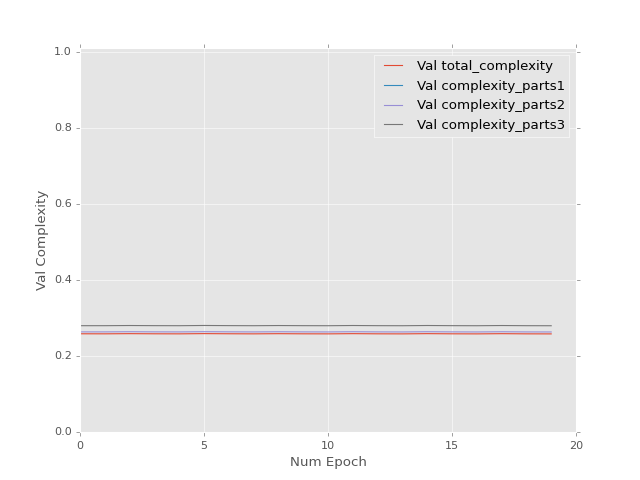

Epoch 1 of 20 took 5.645s
Epoch 2 of 20 took 5.645s
Epoch 3 of 20 took 5.539s
Epoch 4 of 20 took 5.634s
Epoch 5 of 20 took 5.885s
Epoch 6 of 20 took 5.716s
Epoch 7 of 20 took 5.868s
Epoch 8 of 20 took 5.769s
Epoch 9 of 20 took 5.770s
Epoch 10 of 20 took 5.640s
Epoch 11 of 20 took 5.987s
Epoch 12 of 20 took 5.922s
Epoch 13 of 20 took 5.874s
Epoch 14 of 20 took 5.539s
Epoch 15 of 20 took 6.142s
Epoch 16 of 20 took 5.839s
Epoch 17 of 20 took 5.980s
Epoch 18 of 20 took 5.758s
Epoch 19 of 20 took 5.898s
Epoch 20 of 20 took 5.939s
0.700791567564 [[ 1.1813122   0.39424035  0.57799584  1.21223772  0.44922745  0.68424147]]


<IPython.core.display.Javascript object>


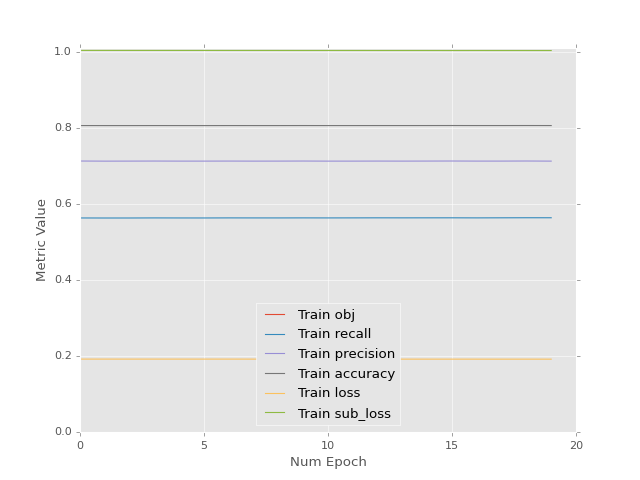

<IPython.core.display.Javascript object>


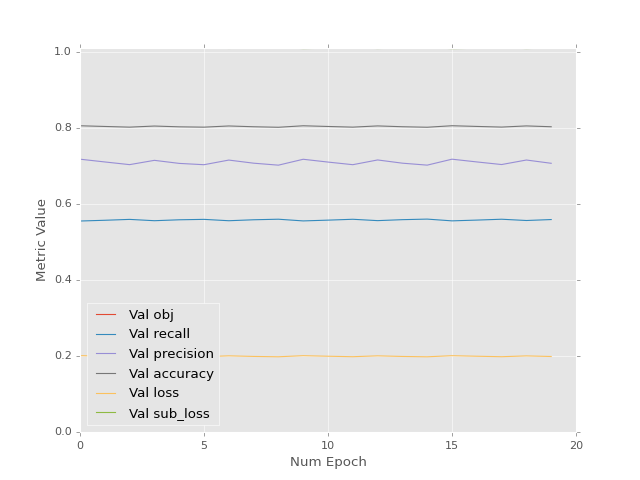

<IPython.core.display.Javascript object>


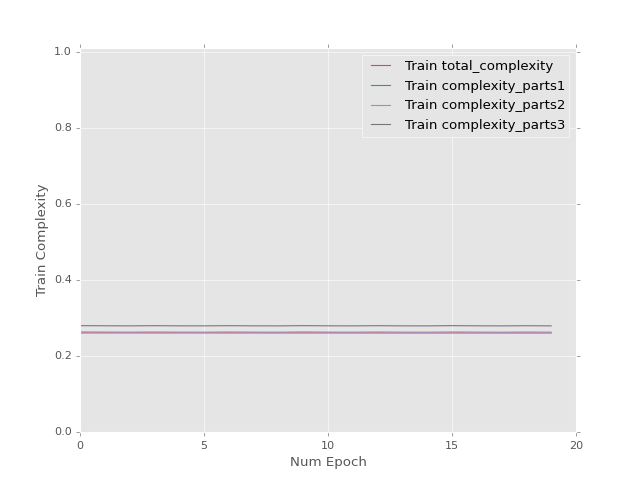

<IPython.core.display.Javascript object>


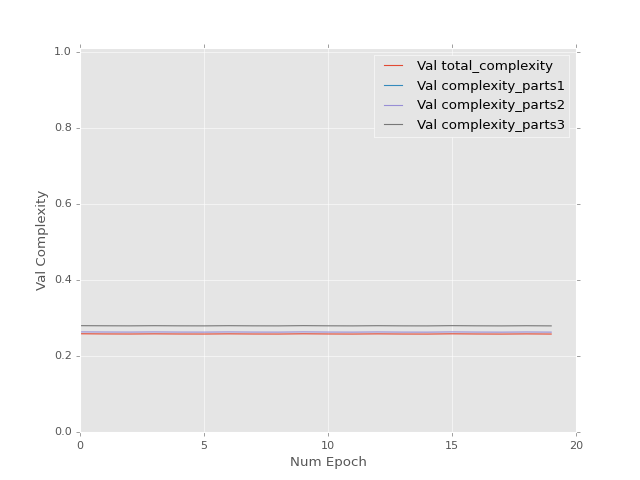

Epoch 1 of 20 took 5.931s
Epoch 2 of 20 took 5.869s
Epoch 3 of 20 took 5.697s
Epoch 4 of 20 took 5.865s
Epoch 5 of 20 took 5.730s
Epoch 6 of 20 took 5.452s
Epoch 7 of 20 took 5.860s
Epoch 8 of 20 took 5.734s
Epoch 9 of 20 took 5.773s
Epoch 10 of 20 took 5.442s
Epoch 11 of 20 took 5.645s
Epoch 12 of 20 took 5.544s
Epoch 13 of 20 took 5.434s
Epoch 14 of 20 took 6.016s
Epoch 15 of 20 took 5.721s
Epoch 16 of 20 took 5.435s
Epoch 17 of 20 took 5.641s
Epoch 18 of 20 took 5.640s
Epoch 19 of 20 took 5.742s
Epoch 20 of 20 took 5.805s
0.699981898069 [[ 1.18244946  0.39547646  0.5796833   1.21316886  0.45004988  0.68352884]]


<IPython.core.display.Javascript object>


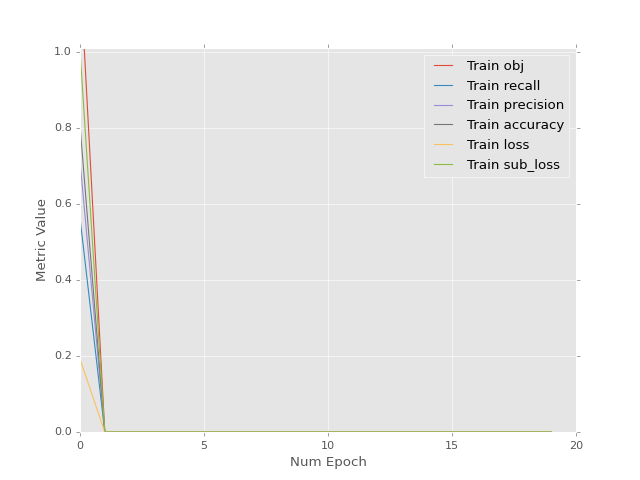

<IPython.core.display.Javascript object>


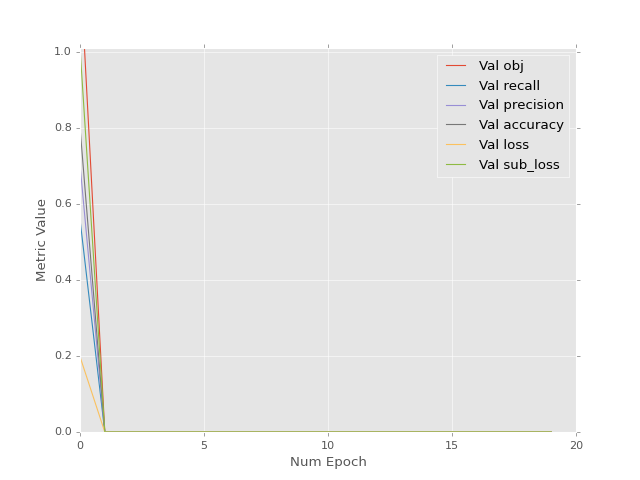

<IPython.core.display.Javascript object>


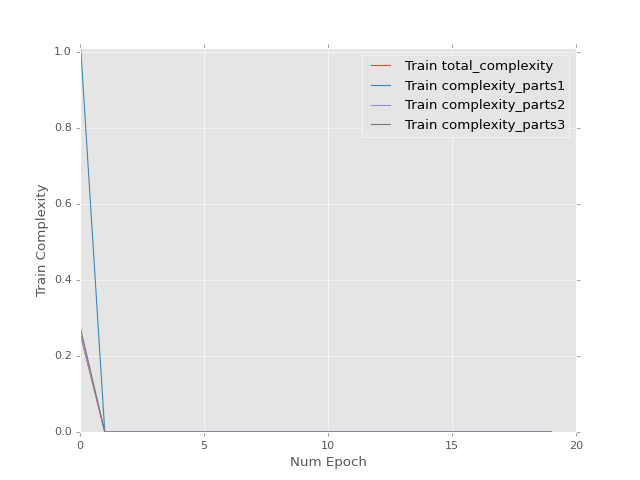

<IPython.core.display.Javascript object>


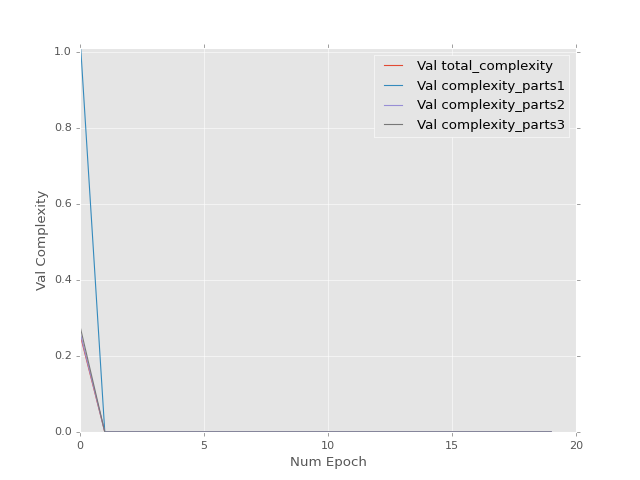

Epoch 1 of 20 took 5.958s


In [ ]:
last_val = np.inf

for v in np.linspace(0.3, 0.99, 20):
    for i in range(100):
        if i % 10 == 0:
            make_new_point(point.get_value()[0], X_y_digits, num_epochs=20, use_pretrained=False)

            predictor = build_predictor(network, X_y_digits)

            X_y[0] = np.vstack((X_y[0], point.get_value())).astype(np.float32)
            X_y[-2] = np.vstack((X_y[-2], predictor(point.get_value()[0]))).astype(np.float32)

            train(X_y[0], X_y[-2])

            print last_val, point.get_value()

        last_val = train_fun(point.get_value()) 
        i += 1

In [521]:
X_y[-2] = np.vstack((X_y[-2], predictor(point.get_value()[0]))).astype(np.float32)
X_y[-2] 

array([[ 0.29993781,  0.0940577 ],
       [ 0.43246084,  0.52502799],
       [ 0.31450495,  0.1739798 ],
       ..., 
       [ 0.47952208,  0.81097221],
       [ 0.47952208,  0.81097221],
       [ 0.47952208,  0.81097221]], dtype=float32)

In [510]:
point.get_value()[0]

In [474]:
point.get_value()

array([[ 0.72974873,  0.51715338,  0.24265958,  0.07748212,  0.25691241,
         0.22897384]], dtype=float32)

In [501]:
np.vstack((X_y[0], point.get_value()))

array([[ 0.20403521,  0.59437823,  0.12474255,  0.70841926,  0.71521968,
         0.21624729],
       [ 0.87128007,  0.0373433 ,  0.24041635,  0.68145084,  0.31189752,
         0.16555616],
       [ 0.43320361,  0.54717869,  0.02488141,  0.33521909,  0.65524638,
         0.60337812],
       ..., 
       [ 0.99191946,  0.8340798 ,  0.61628318,  0.51591468,  0.33770752,
         0.34193054],
       [ 0.10648968,  0.59575427,  0.60403174,  0.63173246,  0.01052946,
         0.81385803],
       [ 0.10648968,  0.59575427,  0.60403174,  0.63173246,  0.01052946,
         0.81385803]], dtype=float32)

In [515]:
predictor(point.get_value()[0])

(0.46033261242449103, array(0.8098905911654097))

In [504]:
point.get_value()[0]

array([ 0.10648968,  0.59575427,  0.60403174,  0.63173246,  0.01052946,
        0.81385803], dtype=float32)

In [514]:
predictor = build_predictor(network, X_y_digits)

In [529]:
last_val

array(0.9337000846862793, dtype=float32)

In [23]:
np.asarray(labels).shape

(4438, 2)

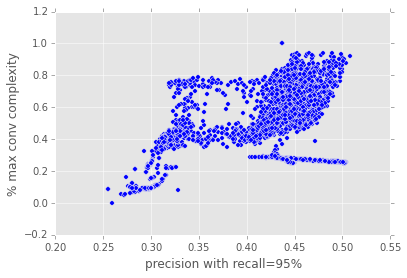

In [39]:
%matplotlib inline

plt.xlabel('precision with recall=95%')
plt.ylabel('% max conv complexity')
plt.scatter(labels[:, 0], labels[:, 1])
plt.show()

In [19]:
print 1

1


In [20]:
print 1

1


In [21]:
print 2

2


In [22]:
print 3

3


In [23]:
print 4

4


In [18]:
print 5

5


In [24]:
dataset.shape

(4438, 6)

In [28]:
thr

<TensorType(float64, scalar)>

In [31]:
np.linspace(0.31, 0.99, 20)

array([ 0.31      ,  0.34578947,  0.38157895,  0.41736842,  0.45315789,
        0.48894737,  0.52473684,  0.56052632,  0.59631579,  0.63210526,
        0.66789474,  0.70368421,  0.73947368,  0.77526316,  0.81105263,
        0.84684211,  0.88263158,  0.91842105,  0.95421053,  0.99      ])

In [33]:
print 1

1
